<center><h1>1-cd: Convolutional Neural Networks (ConvNets)</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>

# Warning :
# Do "File -> Save a copy in Drive" before you start modifying the notebook, otherwise your modifications will not be saved.


In [ ]:
#!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git
! wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py

--2023-10-15 11:30:42--  https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py [following]
--2023-10-15 11:30:43--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2627 (2.6K) [text/plain]
Saving to: ‘utils.py.3’

utils.py.3          100%[===================>]   2.57K  --.-KB/s    in 0s      

2023-10-15 11:30:43 (54.8 MB/s) - ‘utils.py.3’ saved [2627/2627]



In [ ]:
%run 'utils.py'

In [ ]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from utils import *

PRINT_INTERVAL = 200
PATH="datasets"

 # MNIST

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(1, 6, (5, 5), stride=1, padding=2),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(6, 16, (5, 5), stride=1, padding=0),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(400, 120),
            nn.Tanh(),
            nn.Linear(120, 84),
            nn.Tanh(),
            nn.Linear(84, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.MNIST(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.MNIST(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):


        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


=== EPOCH 1 =====

[TRAIN Batch 000/235]	Time 0.724s (0.724s)	Loss 2.3161 (2.3161)	Prec@1  10.9 ( 10.9)	Prec@5  45.7 ( 45.7)


<Figure size 640x480 with 0 Axes>

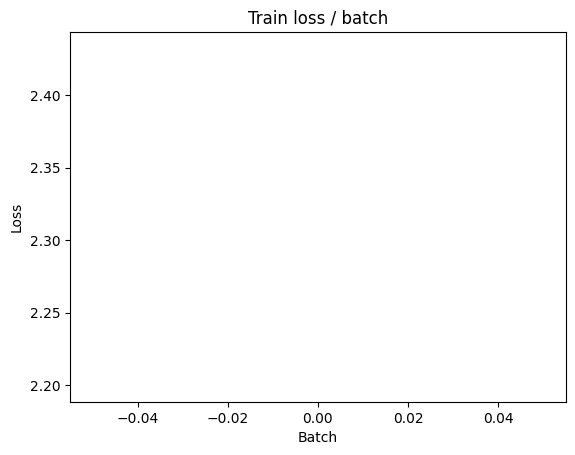

[TRAIN Batch 200/235]	Time 0.005s (0.034s)	Loss 0.3847 (1.1327)	Prec@1  87.5 ( 70.7)	Prec@5 100.0 ( 91.7)


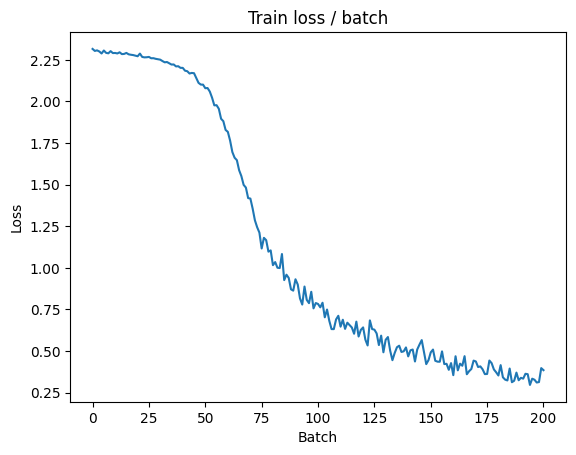


===============> Total time 8s	Avg loss 1.0157	Avg Prec@1 73.69 %	Avg Prec@5 92.83 %

[EVAL Batch 000/040]	Time 0.111s (0.111s)	Loss 0.2553 (0.2553)	Prec@1  93.4 ( 93.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.2794	Avg Prec@1 92.54 %	Avg Prec@5 99.72 %



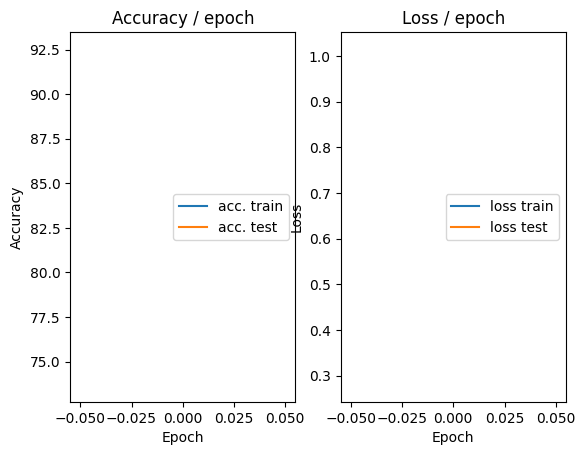

=== EPOCH 2 =====

[TRAIN Batch 000/235]	Time 0.141s (0.141s)	Loss 0.2728 (0.2728)	Prec@1  92.6 ( 92.6)	Prec@5  99.6 ( 99.6)


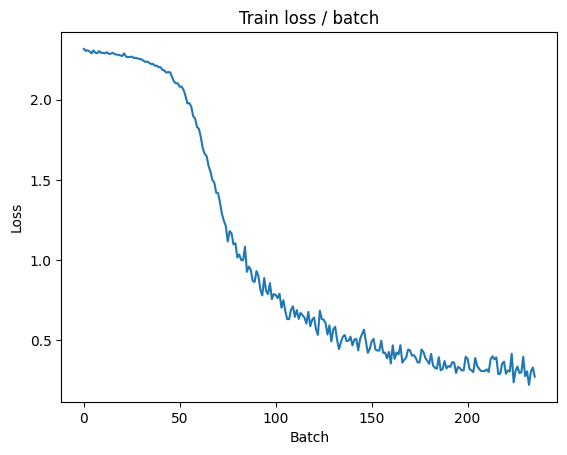

[TRAIN Batch 200/235]	Time 0.065s (0.033s)	Loss 0.1552 (0.2185)	Prec@1  95.3 ( 93.9)	Prec@5 100.0 ( 99.8)


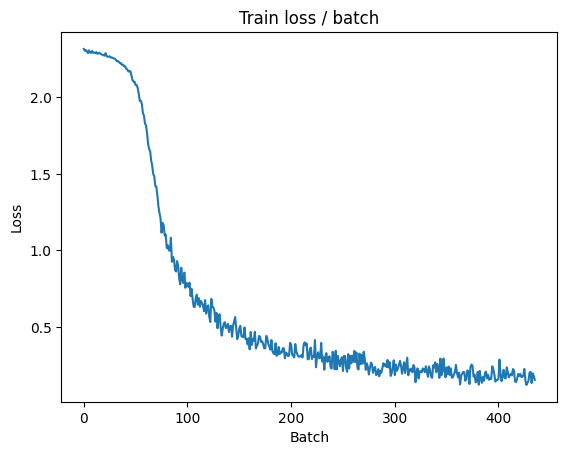


===============> Total time 7s	Avg loss 0.2109	Avg Prec@1 94.11 %	Avg Prec@5 99.78 %

[EVAL Batch 000/040]	Time 0.118s (0.118s)	Loss 0.1100 (0.1100)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.1446	Avg Prec@1 95.87 %	Avg Prec@5 99.93 %



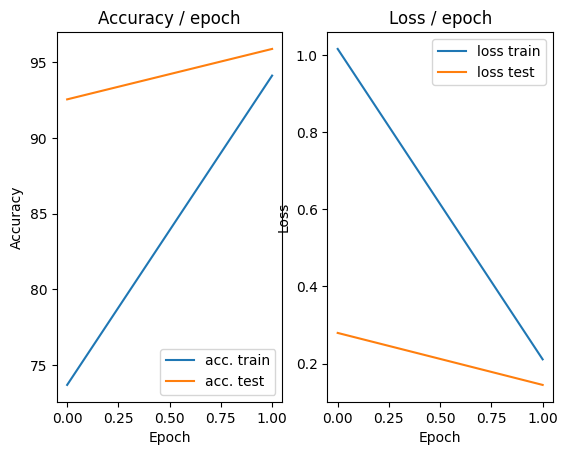

=== EPOCH 3 =====

[TRAIN Batch 000/235]	Time 0.144s (0.144s)	Loss 0.1155 (0.1155)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


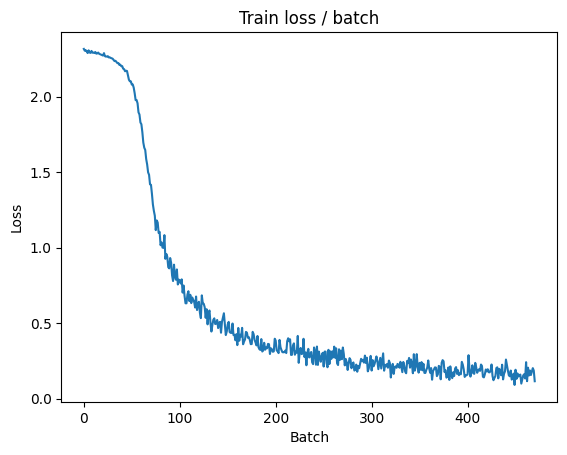

[TRAIN Batch 200/235]	Time 0.004s (0.028s)	Loss 0.1713 (0.1313)	Prec@1  93.4 ( 96.2)	Prec@5 100.0 ( 99.9)


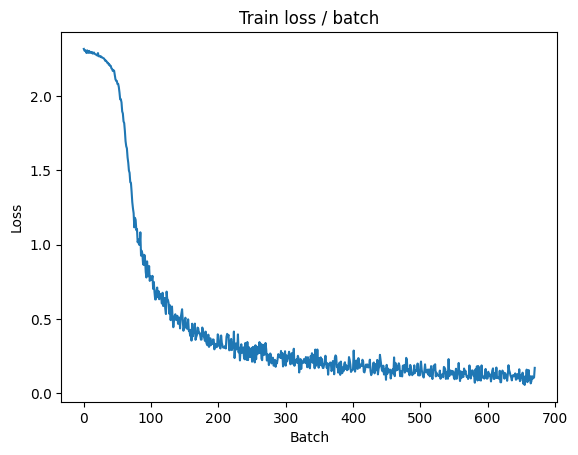


===============> Total time 6s	Avg loss 0.1277	Avg Prec@1 96.33 %	Avg Prec@5 99.90 %

[EVAL Batch 000/040]	Time 0.133s (0.133s)	Loss 0.0677 (0.0677)	Prec@1  98.0 ( 98.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0929	Avg Prec@1 97.23 %	Avg Prec@5 99.97 %



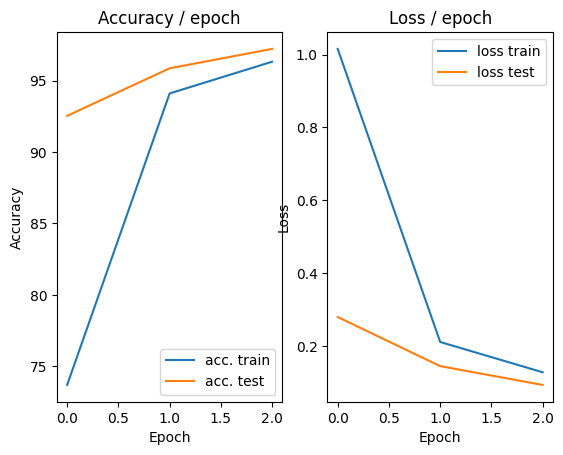

=== EPOCH 4 =====

[TRAIN Batch 000/235]	Time 0.129s (0.129s)	Loss 0.0741 (0.0741)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


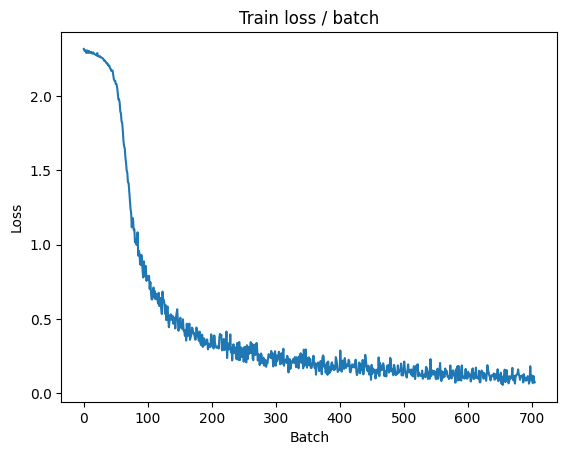

[TRAIN Batch 200/235]	Time 0.031s (0.028s)	Loss 0.0980 (0.0964)	Prec@1  97.7 ( 97.2)	Prec@5  99.6 ( 99.9)


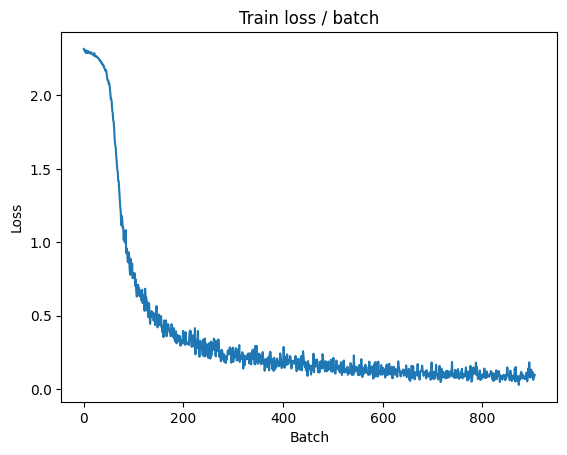


===============> Total time 6s	Avg loss 0.0961	Avg Prec@1 97.23 %	Avg Prec@5 99.94 %

[EVAL Batch 000/040]	Time 0.124s (0.124s)	Loss 0.0569 (0.0569)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0756	Avg Prec@1 97.90 %	Avg Prec@5 99.98 %



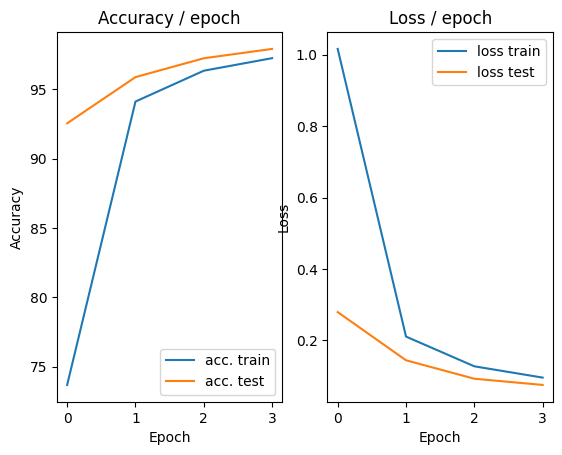

=== EPOCH 5 =====

[TRAIN Batch 000/235]	Time 0.133s (0.133s)	Loss 0.0808 (0.0808)	Prec@1  97.3 ( 97.3)	Prec@5 100.0 (100.0)


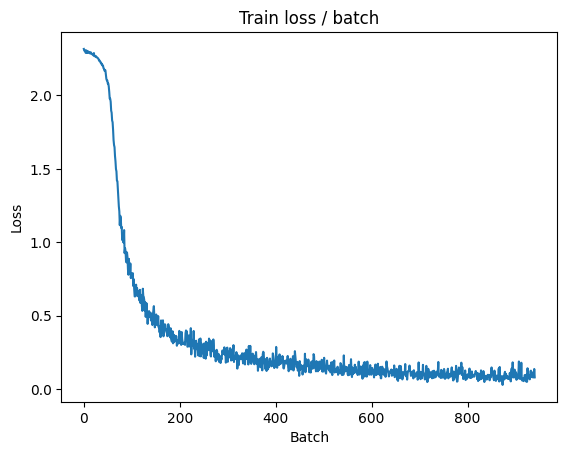

[TRAIN Batch 200/235]	Time 0.029s (0.032s)	Loss 0.0580 (0.0797)	Prec@1  98.4 ( 97.7)	Prec@5 100.0 ( 99.9)


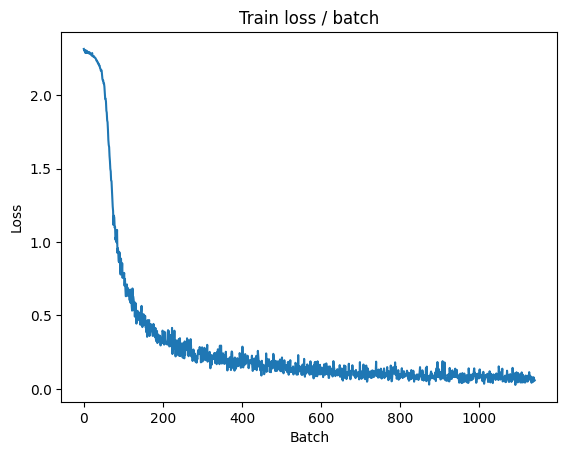


===============> Total time 7s	Avg loss 0.0792	Avg Prec@1 97.72 %	Avg Prec@5 99.95 %

[EVAL Batch 000/040]	Time 0.160s (0.160s)	Loss 0.0570 (0.0570)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0790	Avg Prec@1 97.53 %	Avg Prec@5 99.99 %



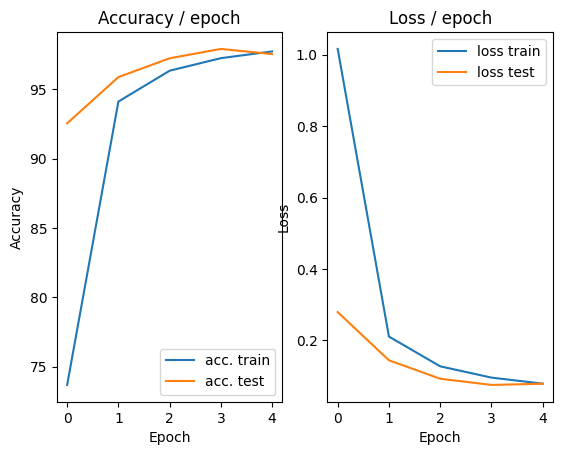

=== EPOCH 6 =====

[TRAIN Batch 000/235]	Time 0.141s (0.141s)	Loss 0.0769 (0.0769)	Prec@1  97.3 ( 97.3)	Prec@5 100.0 (100.0)


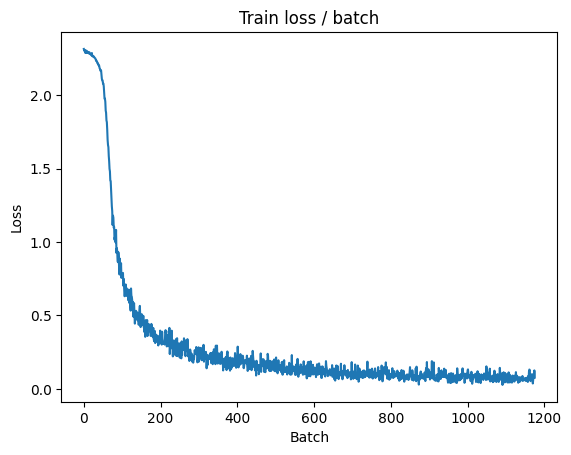

[TRAIN Batch 200/235]	Time 0.003s (0.031s)	Loss 0.0716 (0.0698)	Prec@1  98.4 ( 97.9)	Prec@5 100.0 (100.0)


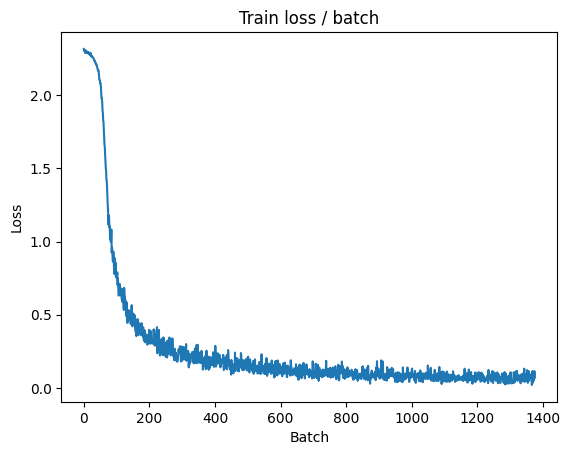


===============> Total time 7s	Avg loss 0.0687	Avg Prec@1 97.96 %	Avg Prec@5 99.96 %

[EVAL Batch 000/040]	Time 0.125s (0.125s)	Loss 0.0309 (0.0309)	Prec@1  99.6 ( 99.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0583	Avg Prec@1 98.15 %	Avg Prec@5 99.99 %



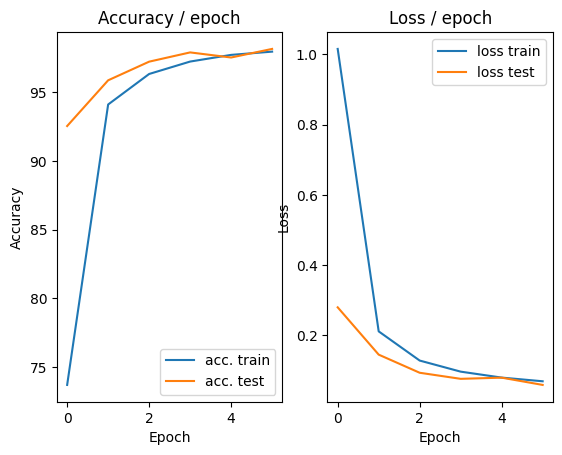

=== EPOCH 7 =====

[TRAIN Batch 000/235]	Time 0.145s (0.145s)	Loss 0.0572 (0.0572)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


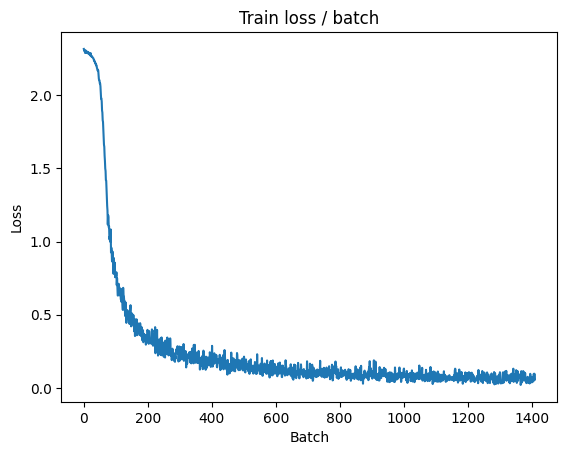

[TRAIN Batch 200/235]	Time 0.004s (0.028s)	Loss 0.0380 (0.0603)	Prec@1  98.8 ( 98.2)	Prec@5 100.0 (100.0)


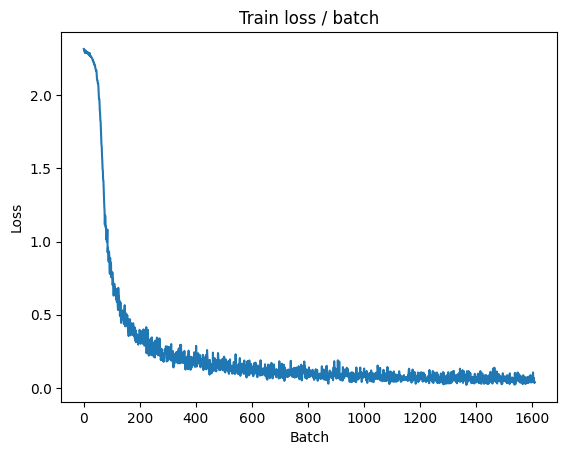


===============> Total time 6s	Avg loss 0.0604	Avg Prec@1 98.22 %	Avg Prec@5 99.97 %

[EVAL Batch 000/040]	Time 0.136s (0.136s)	Loss 0.0622 (0.0622)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0693	Avg Prec@1 97.90 %	Avg Prec@5 99.98 %



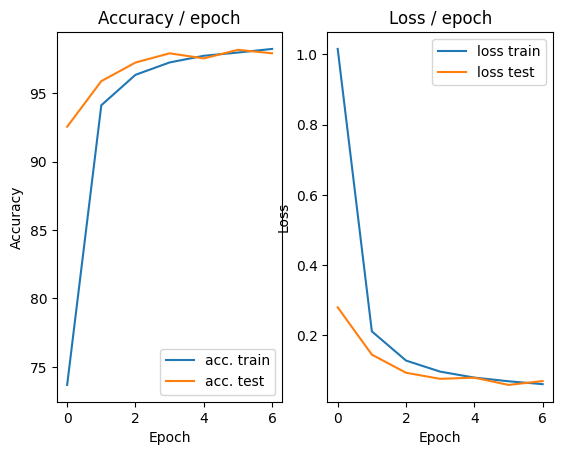

=== EPOCH 8 =====

[TRAIN Batch 000/235]	Time 0.143s (0.143s)	Loss 0.1332 (0.1332)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


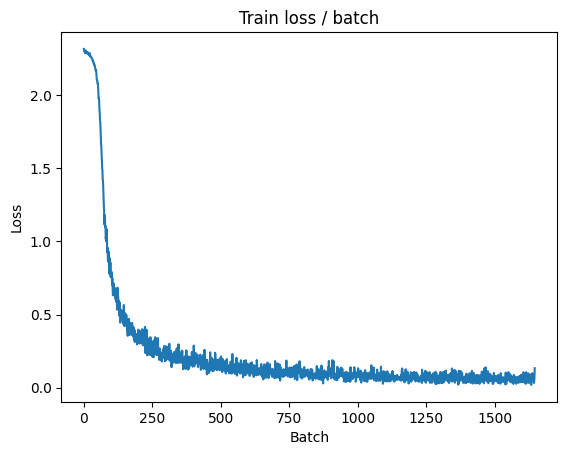

[TRAIN Batch 200/235]	Time 0.004s (0.033s)	Loss 0.0618 (0.0555)	Prec@1  98.0 ( 98.4)	Prec@5 100.0 (100.0)


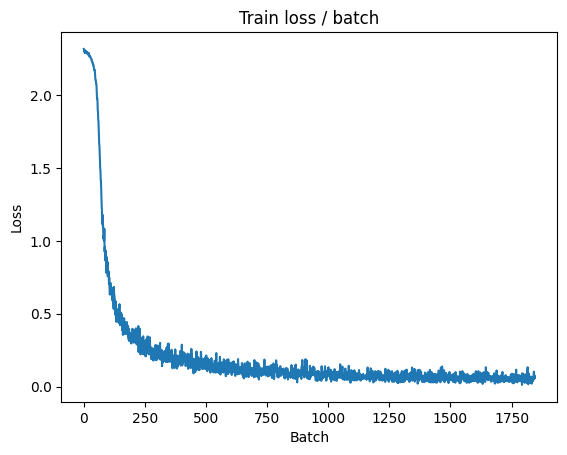


===============> Total time 7s	Avg loss 0.0544	Avg Prec@1 98.42 %	Avg Prec@5 99.98 %

[EVAL Batch 000/040]	Time 0.142s (0.142s)	Loss 0.0372 (0.0372)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0503	Avg Prec@1 98.31 %	Avg Prec@5 100.00 %



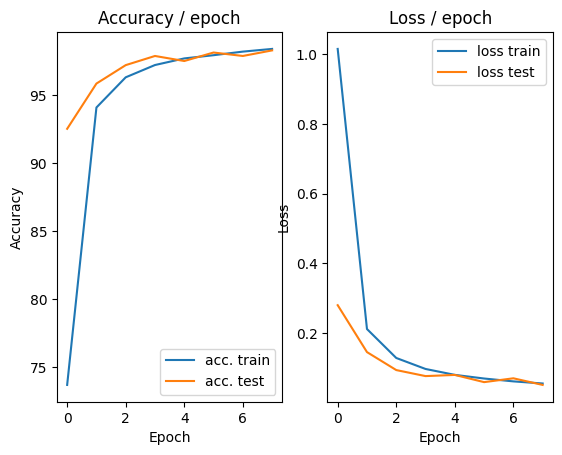

=== EPOCH 9 =====

[TRAIN Batch 000/235]	Time 0.143s (0.143s)	Loss 0.0604 (0.0604)	Prec@1  97.3 ( 97.3)	Prec@5 100.0 (100.0)


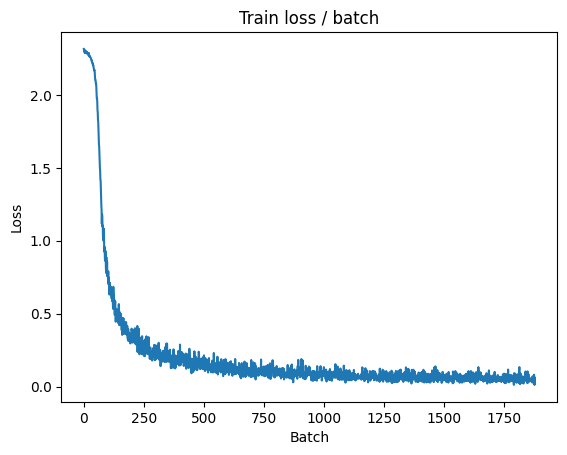

[TRAIN Batch 200/235]	Time 0.007s (0.034s)	Loss 0.0381 (0.0495)	Prec@1  98.8 ( 98.6)	Prec@5 100.0 (100.0)


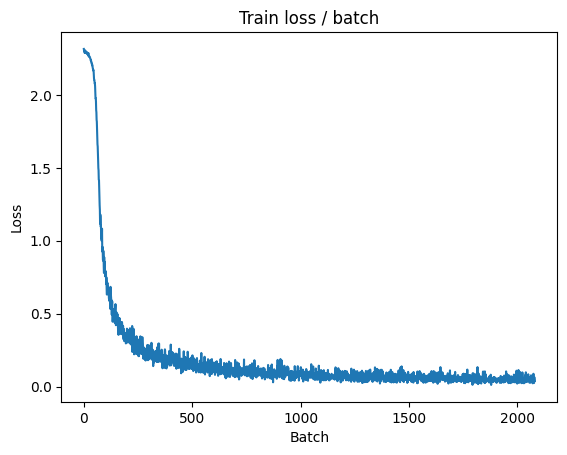


===============> Total time 7s	Avg loss 0.0493	Avg Prec@1 98.57 %	Avg Prec@5 99.98 %

[EVAL Batch 000/040]	Time 0.119s (0.119s)	Loss 0.0272 (0.0272)	Prec@1  99.6 ( 99.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0458	Avg Prec@1 98.55 %	Avg Prec@5 99.99 %



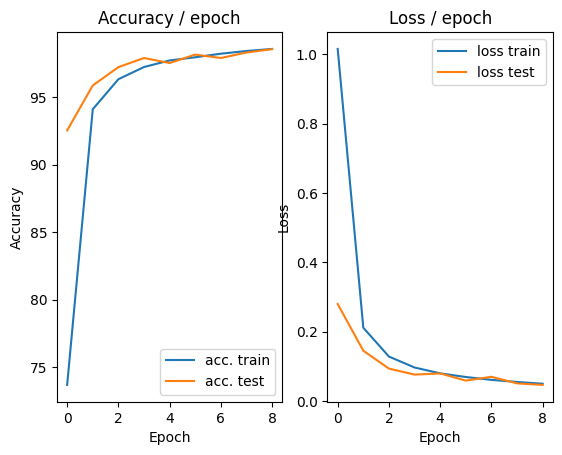

=== EPOCH 10 =====

[TRAIN Batch 000/235]	Time 0.146s (0.146s)	Loss 0.0373 (0.0373)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


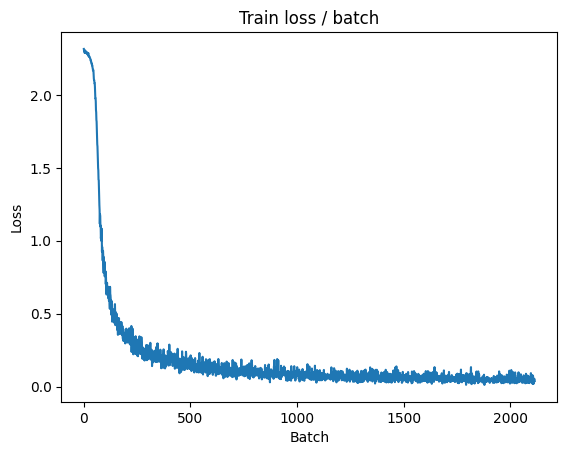

[TRAIN Batch 200/235]	Time 0.044s (0.028s)	Loss 0.0851 (0.0451)	Prec@1  98.0 ( 98.7)	Prec@5 100.0 (100.0)


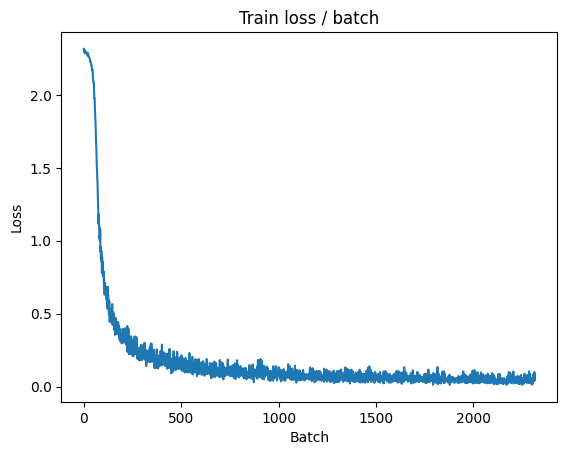


===============> Total time 6s	Avg loss 0.0459	Avg Prec@1 98.69 %	Avg Prec@5 99.98 %

[EVAL Batch 000/040]	Time 0.118s (0.118s)	Loss 0.0320 (0.0320)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0453	Avg Prec@1 98.52 %	Avg Prec@5 99.99 %



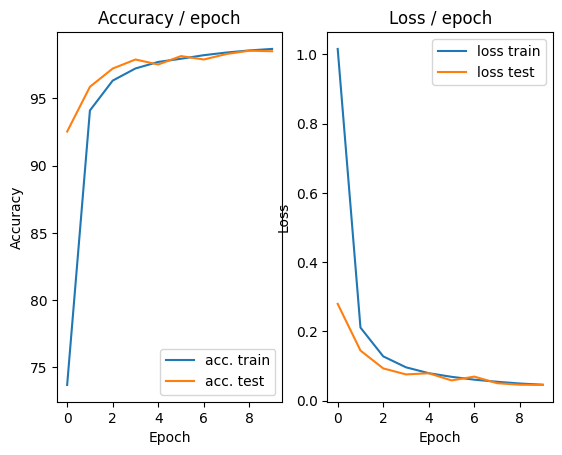

=== EPOCH 11 =====

[TRAIN Batch 000/235]	Time 0.177s (0.177s)	Loss 0.0282 (0.0282)	Prec@1  98.8 ( 98.8)	Prec@5 100.0 (100.0)


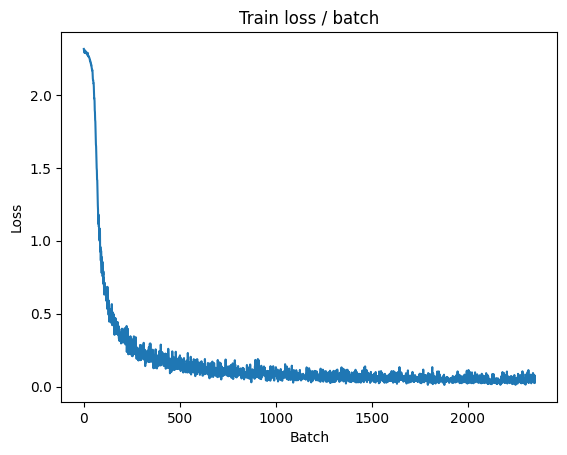

[TRAIN Batch 200/235]	Time 0.004s (0.030s)	Loss 0.0483 (0.0430)	Prec@1  98.0 ( 98.8)	Prec@5 100.0 (100.0)


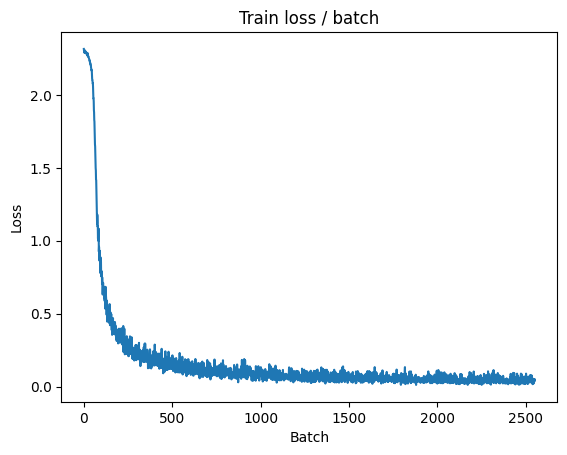


===============> Total time 7s	Avg loss 0.0424	Avg Prec@1 98.78 %	Avg Prec@5 99.99 %

[EVAL Batch 000/040]	Time 0.136s (0.136s)	Loss 0.0270 (0.0270)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0458	Avg Prec@1 98.39 %	Avg Prec@5 99.99 %



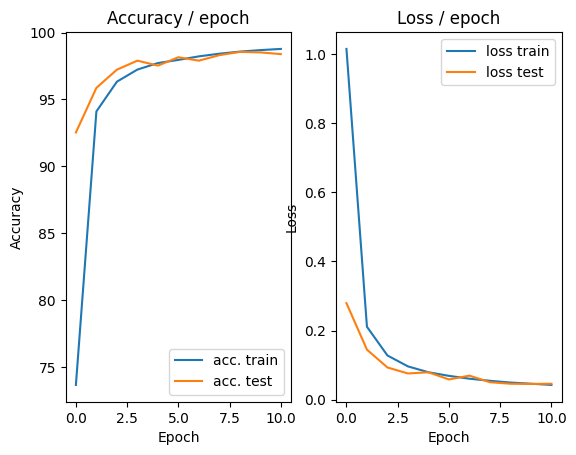

=== EPOCH 12 =====

[TRAIN Batch 000/235]	Time 0.144s (0.144s)	Loss 0.0559 (0.0559)	Prec@1  98.0 ( 98.0)	Prec@5 100.0 (100.0)


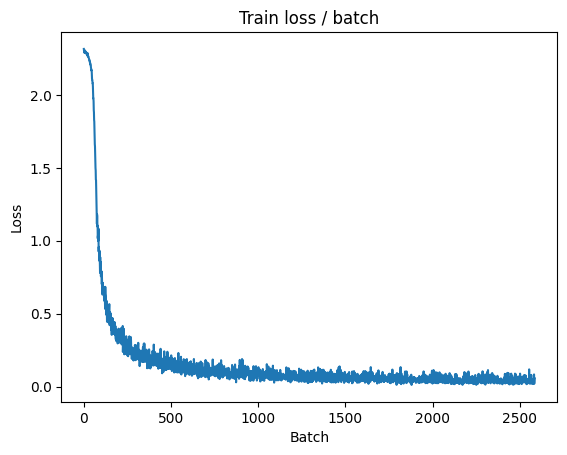

[TRAIN Batch 200/235]	Time 0.003s (0.036s)	Loss 0.0203 (0.0397)	Prec@1  99.2 ( 98.9)	Prec@5 100.0 (100.0)


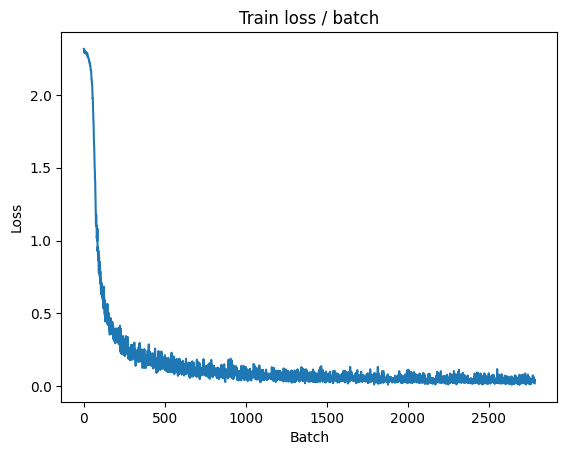


===============> Total time 8s	Avg loss 0.0393	Avg Prec@1 98.88 %	Avg Prec@5 99.99 %

[EVAL Batch 000/040]	Time 0.113s (0.113s)	Loss 0.0242 (0.0242)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0385	Avg Prec@1 98.68 %	Avg Prec@5 99.99 %



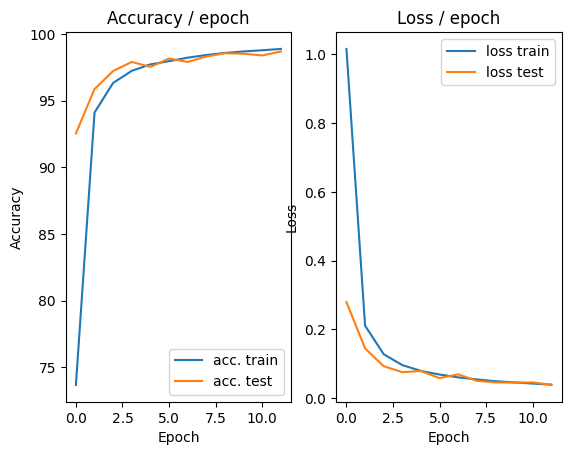

=== EPOCH 13 =====

[TRAIN Batch 000/235]	Time 0.141s (0.141s)	Loss 0.0290 (0.0290)	Prec@1  99.6 ( 99.6)	Prec@5 100.0 (100.0)


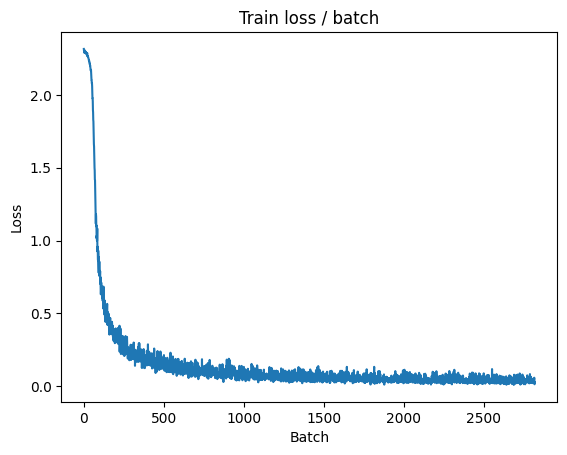

[TRAIN Batch 200/235]	Time 0.004s (0.034s)	Loss 0.0900 (0.0365)	Prec@1  98.0 ( 99.0)	Prec@5  99.6 (100.0)


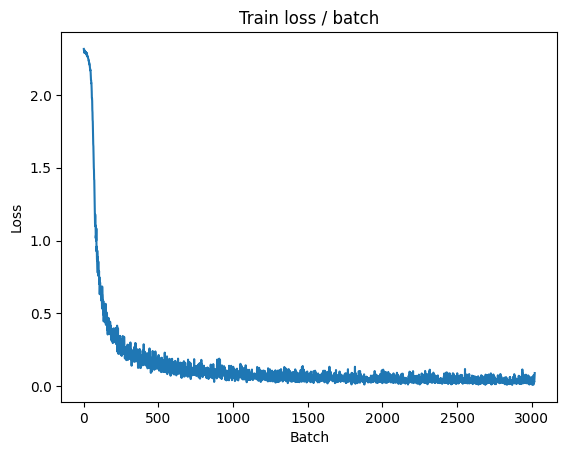


===============> Total time 8s	Avg loss 0.0368	Avg Prec@1 98.95 %	Avg Prec@5 99.99 %

[EVAL Batch 000/040]	Time 0.129s (0.129s)	Loss 0.0285 (0.0285)	Prec@1  99.6 ( 99.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0416	Avg Prec@1 98.60 %	Avg Prec@5 99.98 %



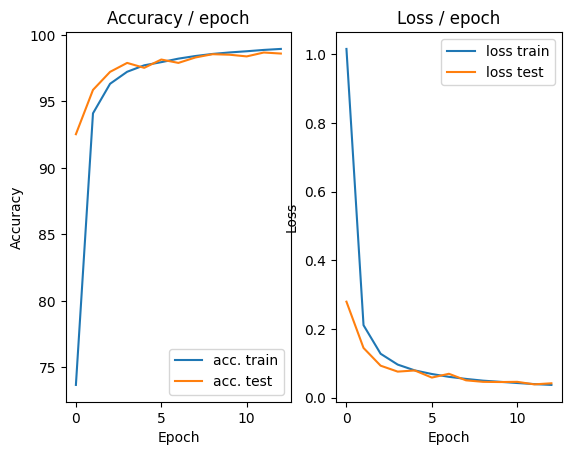

=== EPOCH 14 =====

[TRAIN Batch 000/235]	Time 0.155s (0.155s)	Loss 0.0295 (0.0295)	Prec@1  98.8 ( 98.8)	Prec@5 100.0 (100.0)


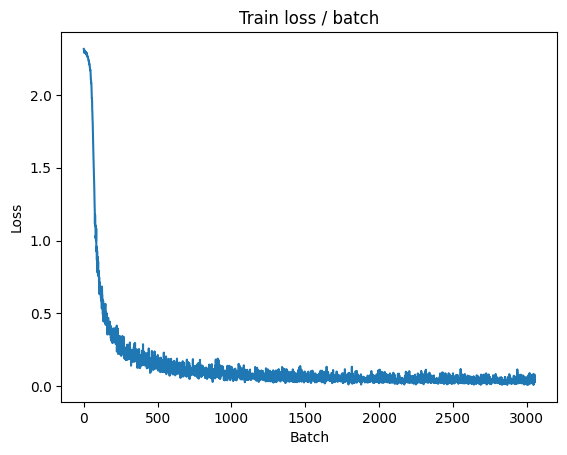

[TRAIN Batch 200/235]	Time 0.004s (0.030s)	Loss 0.0186 (0.0346)	Prec@1  99.6 ( 99.0)	Prec@5 100.0 (100.0)


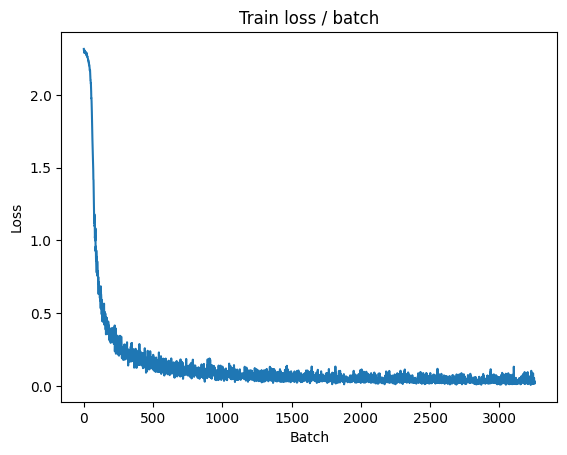


===============> Total time 7s	Avg loss 0.0348	Avg Prec@1 98.99 %	Avg Prec@5 99.99 %

[EVAL Batch 000/040]	Time 0.241s (0.241s)	Loss 0.0275 (0.0275)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0403	Avg Prec@1 98.67 %	Avg Prec@5 99.99 %



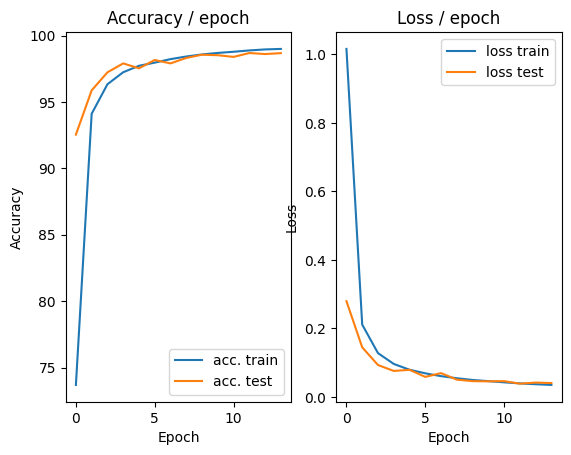

=== EPOCH 15 =====

[TRAIN Batch 000/235]	Time 0.155s (0.155s)	Loss 0.0682 (0.0682)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


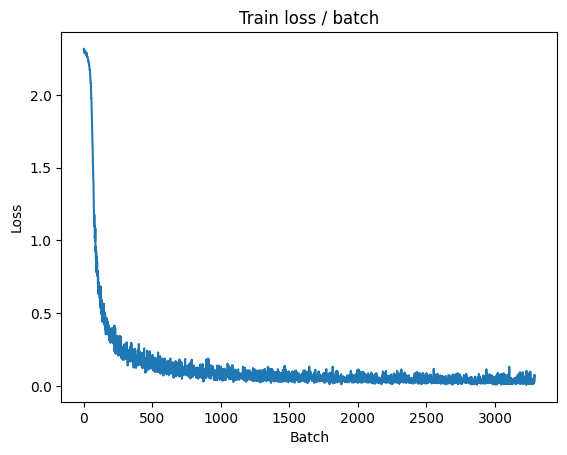

[TRAIN Batch 200/235]	Time 0.048s (0.029s)	Loss 0.0308 (0.0320)	Prec@1  98.8 ( 99.1)	Prec@5 100.0 (100.0)


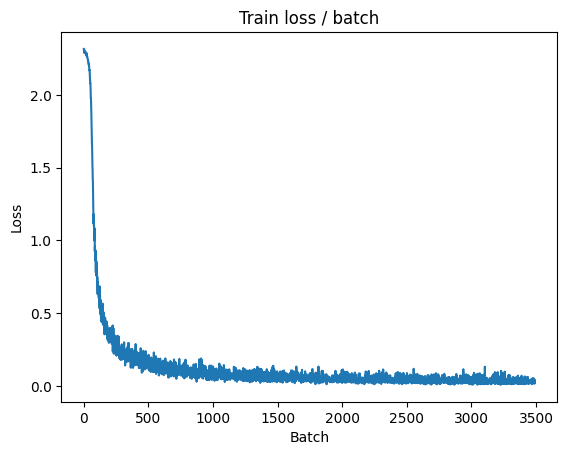


===============> Total time 7s	Avg loss 0.0324	Avg Prec@1 99.08 %	Avg Prec@5 99.99 %

[EVAL Batch 000/040]	Time 0.135s (0.135s)	Loss 0.0277 (0.0277)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0411	Avg Prec@1 98.54 %	Avg Prec@5 100.00 %



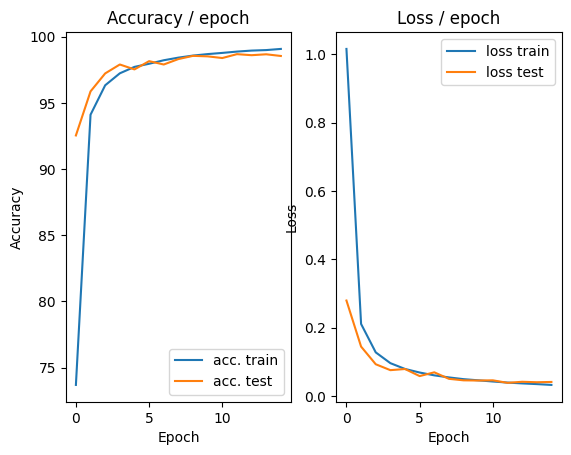

=== EPOCH 16 =====

[TRAIN Batch 000/235]	Time 0.146s (0.146s)	Loss 0.0308 (0.0308)	Prec@1  98.8 ( 98.8)	Prec@5 100.0 (100.0)


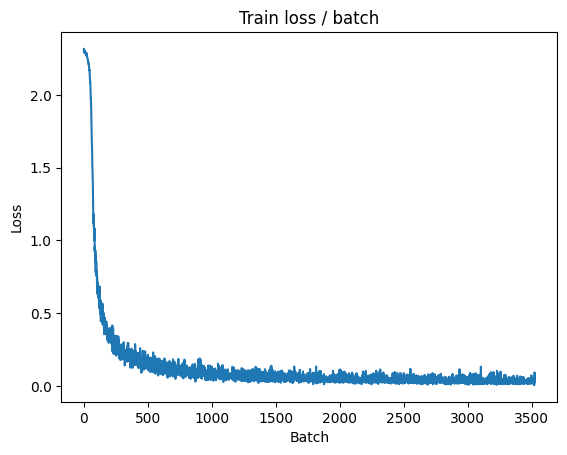

[TRAIN Batch 200/235]	Time 0.054s (0.034s)	Loss 0.0215 (0.0297)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


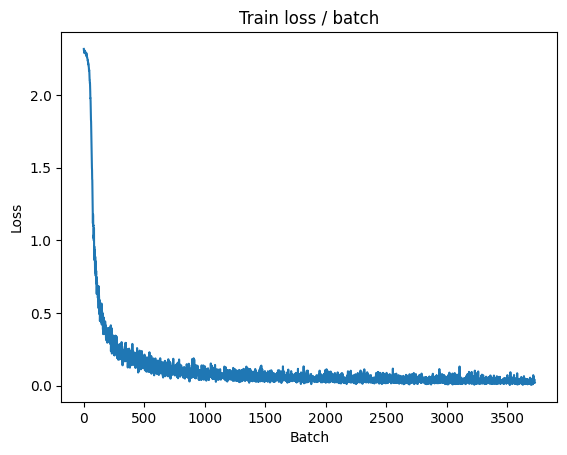


===============> Total time 7s	Avg loss 0.0305	Avg Prec@1 99.12 %	Avg Prec@5 99.99 %

[EVAL Batch 000/040]	Time 0.135s (0.135s)	Loss 0.0299 (0.0299)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0377	Avg Prec@1 98.71 %	Avg Prec@5 99.98 %



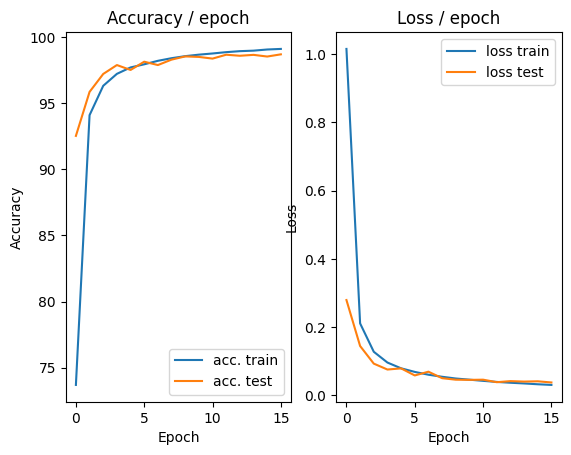

=== EPOCH 17 =====

[TRAIN Batch 000/235]	Time 0.165s (0.165s)	Loss 0.0224 (0.0224)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


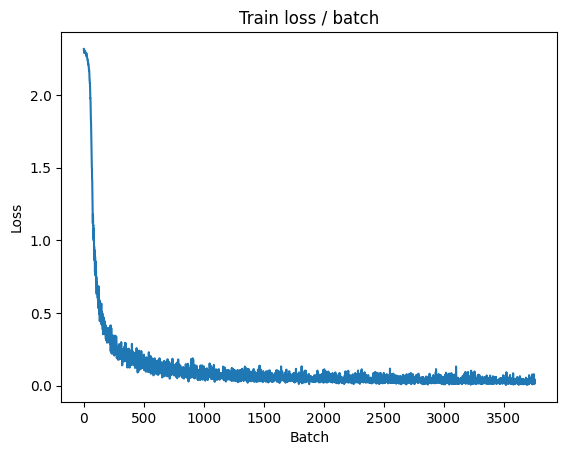

[TRAIN Batch 200/235]	Time 0.055s (0.034s)	Loss 0.0170 (0.0287)	Prec@1  99.6 ( 99.2)	Prec@5 100.0 (100.0)


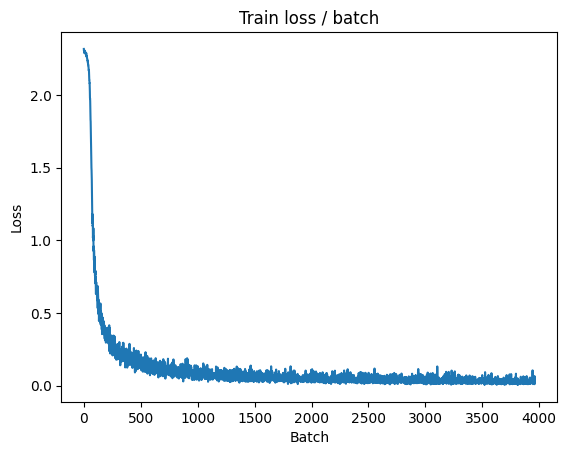


===============> Total time 7s	Avg loss 0.0289	Avg Prec@1 99.18 %	Avg Prec@5 99.99 %

[EVAL Batch 000/040]	Time 0.144s (0.144s)	Loss 0.0239 (0.0239)	Prec@1  99.6 ( 99.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0362	Avg Prec@1 98.59 %	Avg Prec@5 100.00 %



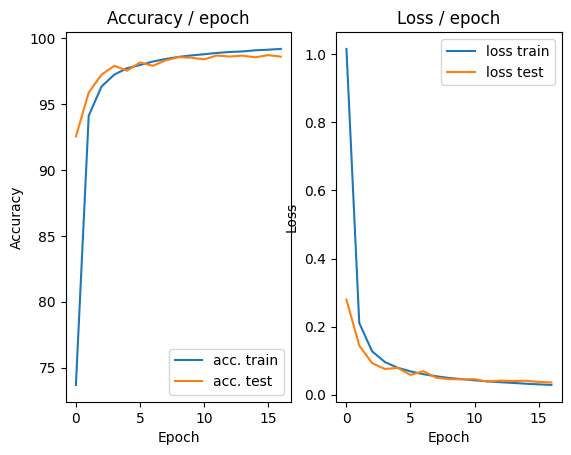

=== EPOCH 18 =====

[TRAIN Batch 000/235]	Time 0.162s (0.162s)	Loss 0.0281 (0.0281)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


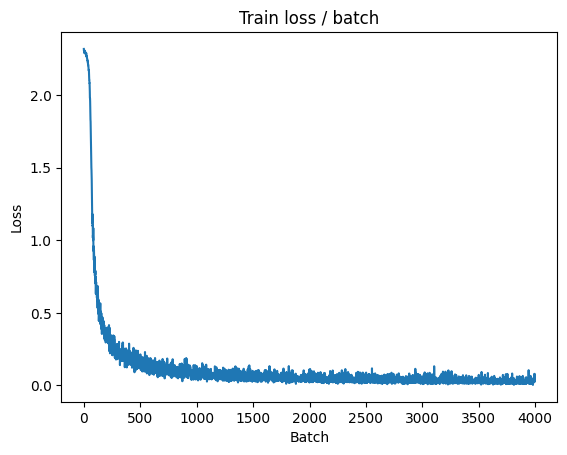

[TRAIN Batch 200/235]	Time 0.004s (0.031s)	Loss 0.0500 (0.0273)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


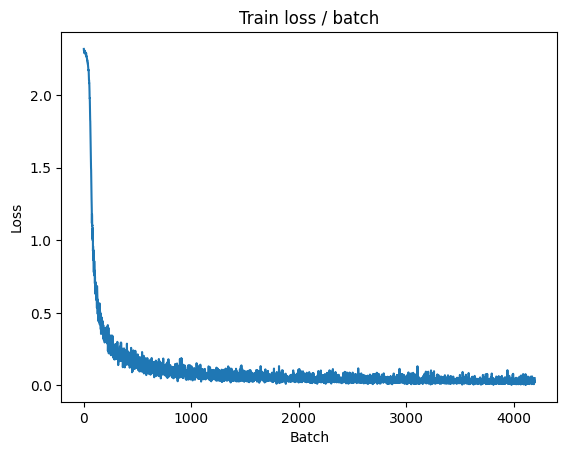


===============> Total time 7s	Avg loss 0.0273	Avg Prec@1 99.19 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.254s (0.254s)	Loss 0.0228 (0.0228)	Prec@1  99.6 ( 99.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0393	Avg Prec@1 98.64 %	Avg Prec@5 99.99 %



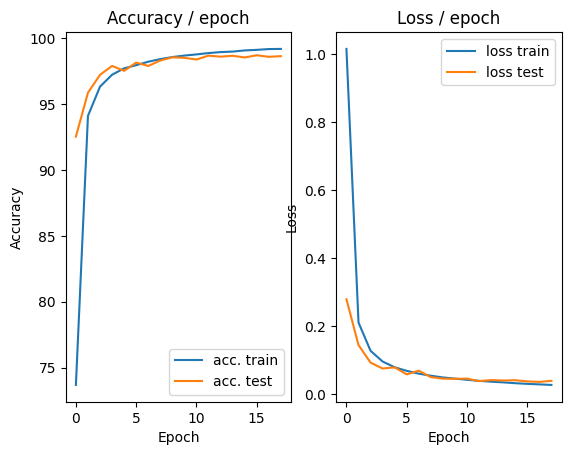

=== EPOCH 19 =====

[TRAIN Batch 000/235]	Time 0.184s (0.184s)	Loss 0.0458 (0.0458)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


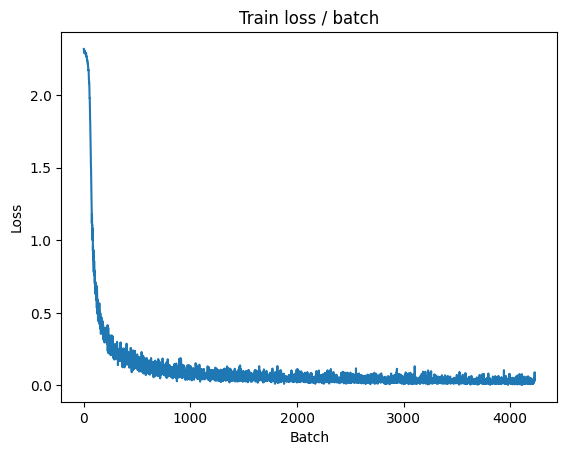

[TRAIN Batch 200/235]	Time 0.053s (0.029s)	Loss 0.0175 (0.0255)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)


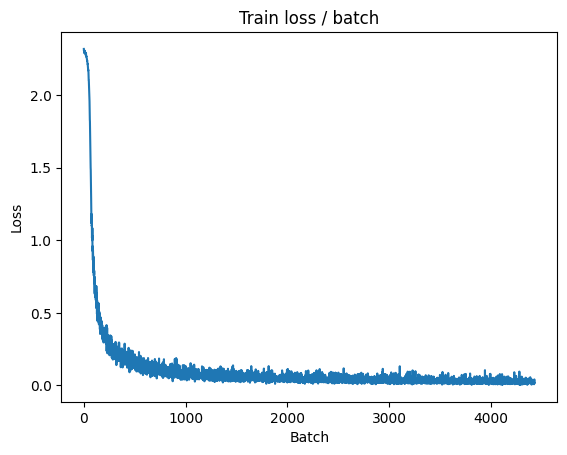


===============> Total time 6s	Avg loss 0.0255	Avg Prec@1 99.24 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.132s (0.132s)	Loss 0.0241 (0.0241)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0358	Avg Prec@1 98.74 %	Avg Prec@5 99.98 %



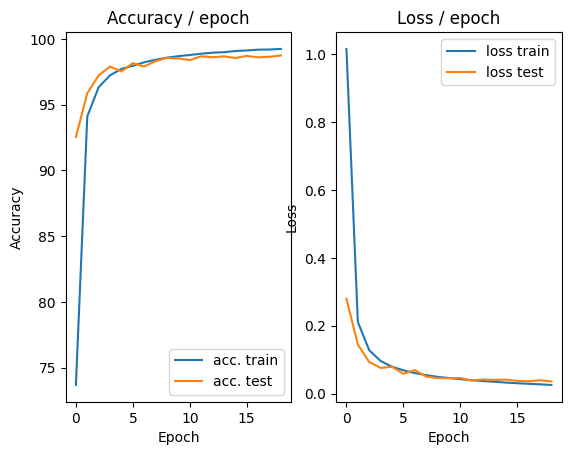

=== EPOCH 20 =====

[TRAIN Batch 000/235]	Time 0.155s (0.155s)	Loss 0.0087 (0.0087)	Prec@1  99.6 ( 99.6)	Prec@5 100.0 (100.0)


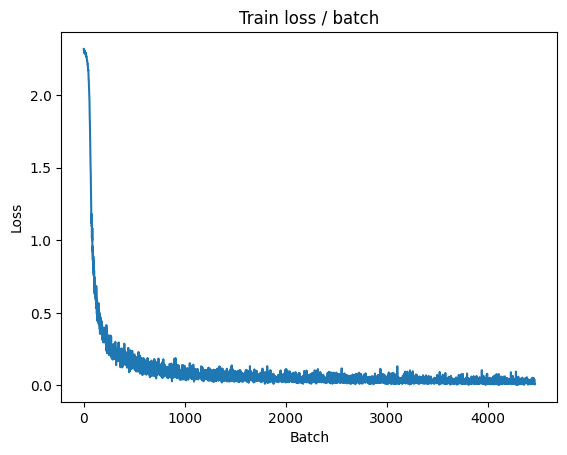

[TRAIN Batch 200/235]	Time 0.044s (0.034s)	Loss 0.0283 (0.0247)	Prec@1  99.6 ( 99.3)	Prec@5 100.0 (100.0)


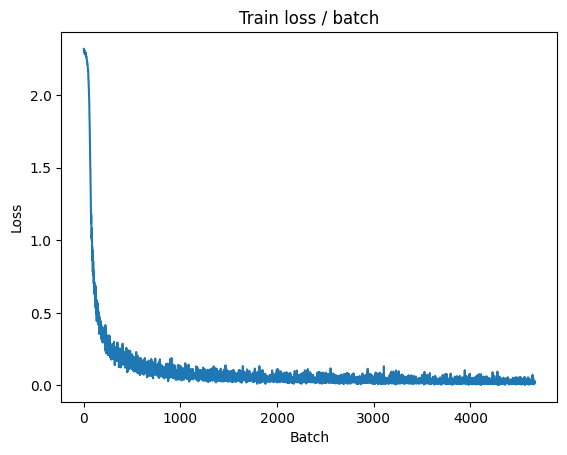


===============> Total time 7s	Avg loss 0.0245	Avg Prec@1 99.31 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.136s (0.136s)	Loss 0.0170 (0.0170)	Prec@1  99.6 ( 99.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0358	Avg Prec@1 98.75 %	Avg Prec@5 99.98 %



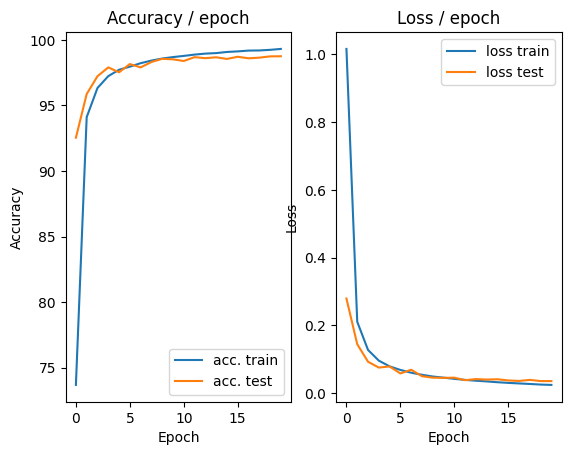

In [ ]:
main(256, 0.1, 20, cuda=True) #50 epoch, lr 0.1, batch size 128

# CIFAR10

In [ ]:
def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network with a style close to the AlexNet architecture
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64,64, (5,5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2,2), stride=2, padding=0)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10),
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output


In [ ]:

def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):


        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/196]	Time 0.612s (0.612s)	Loss 2.3022 (2.3022)	Prec@1  11.3 ( 11.3)	Prec@5  50.4 ( 50.4)


<Figure size 640x480 with 0 Axes>

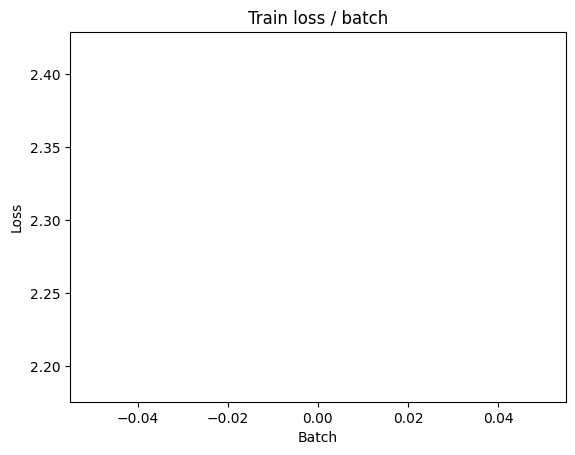


===============> Total time 13s	Avg loss 2.2245	Avg Prec@1 16.92 %	Avg Prec@5 63.52 %

[EVAL Batch 000/040]	Time 0.347s (0.347s)	Loss 2.0675 (2.0675)	Prec@1  21.5 ( 21.5)	Prec@5  78.9 ( 78.9)

===============> Total time 2s	Avg loss 2.0406	Avg Prec@1 25.62 %	Avg Prec@5 78.31 %



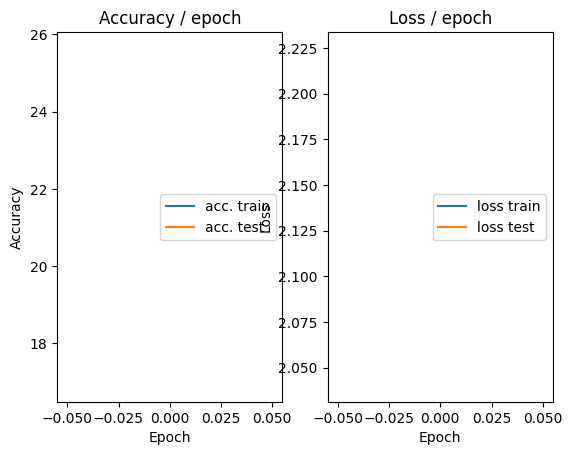

=== EPOCH 2 =====

[TRAIN Batch 000/196]	Time 0.188s (0.188s)	Loss 2.0435 (2.0435)	Prec@1  25.8 ( 25.8)	Prec@5  80.1 ( 80.1)


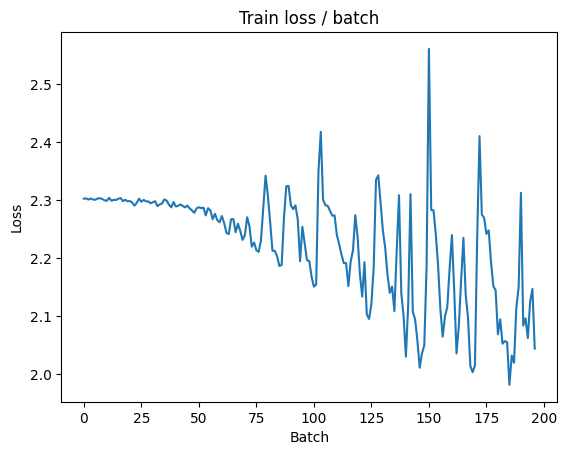


===============> Total time 9s	Avg loss 1.9449	Avg Prec@1 30.51 %	Avg Prec@5 80.15 %

[EVAL Batch 000/040]	Time 0.174s (0.174s)	Loss 1.7924 (1.7924)	Prec@1  36.3 ( 36.3)	Prec@5  86.7 ( 86.7)

===============> Total time 1s	Avg loss 1.7710	Avg Prec@1 35.97 %	Avg Prec@5 87.25 %



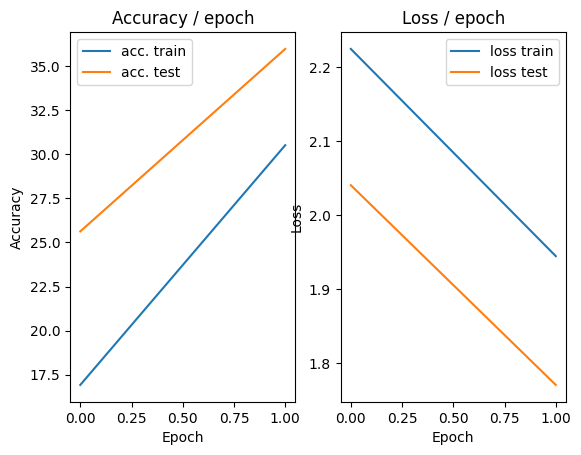

=== EPOCH 3 =====

[TRAIN Batch 000/196]	Time 0.195s (0.195s)	Loss 1.8079 (1.8079)	Prec@1  36.3 ( 36.3)	Prec@5  84.8 ( 84.8)


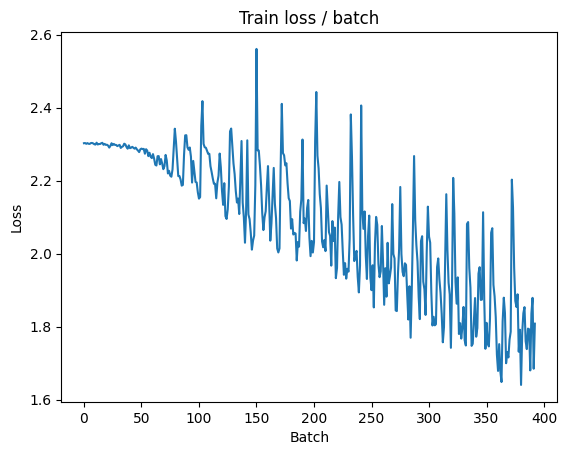


===============> Total time 9s	Avg loss 1.6924	Avg Prec@1 39.68 %	Avg Prec@5 87.62 %

[EVAL Batch 000/040]	Time 0.153s (0.153s)	Loss 1.6582 (1.6582)	Prec@1  37.1 ( 37.1)	Prec@5  91.0 ( 91.0)

===============> Total time 1s	Avg loss 1.5744	Avg Prec@1 42.99 %	Avg Prec@5 90.78 %



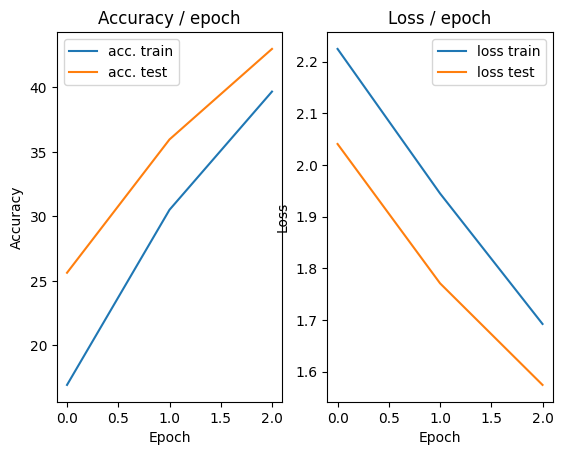

=== EPOCH 4 =====

[TRAIN Batch 000/196]	Time 0.188s (0.188s)	Loss 1.5765 (1.5765)	Prec@1  42.2 ( 42.2)	Prec@5  91.4 ( 91.4)


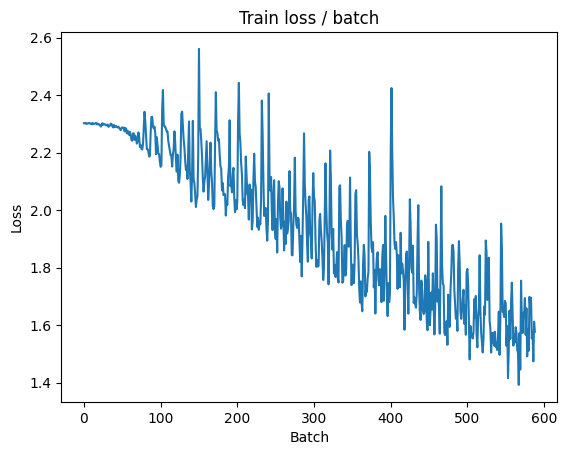


===============> Total time 9s	Avg loss 1.5059	Avg Prec@1 46.01 %	Avg Prec@5 91.39 %

[EVAL Batch 000/040]	Time 0.162s (0.162s)	Loss 1.5594 (1.5594)	Prec@1  41.4 ( 41.4)	Prec@5  91.8 ( 91.8)

===============> Total time 1s	Avg loss 1.5341	Avg Prec@1 43.48 %	Avg Prec@5 91.64 %



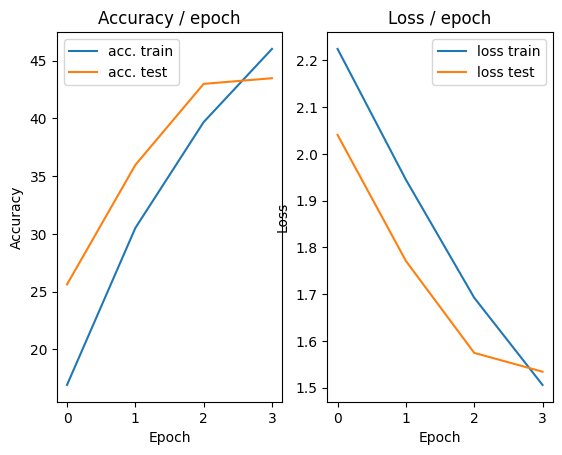

=== EPOCH 5 =====

[TRAIN Batch 000/196]	Time 0.179s (0.179s)	Loss 1.4812 (1.4812)	Prec@1  41.0 ( 41.0)	Prec@5  93.8 ( 93.8)


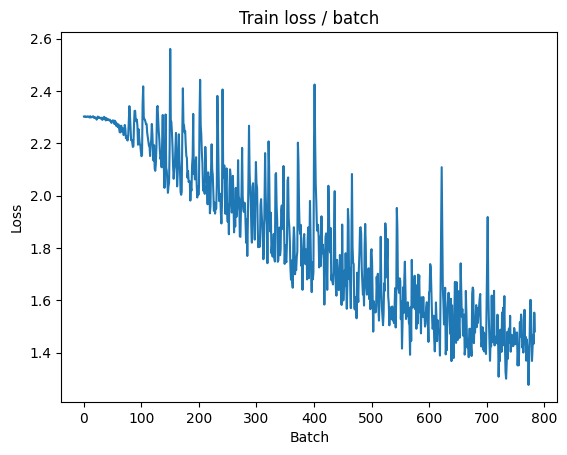


===============> Total time 9s	Avg loss 1.3893	Avg Prec@1 50.47 %	Avg Prec@5 93.01 %

[EVAL Batch 000/040]	Time 0.169s (0.169s)	Loss 1.4234 (1.4234)	Prec@1  50.8 ( 50.8)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.3893	Avg Prec@1 48.17 %	Avg Prec@5 93.76 %



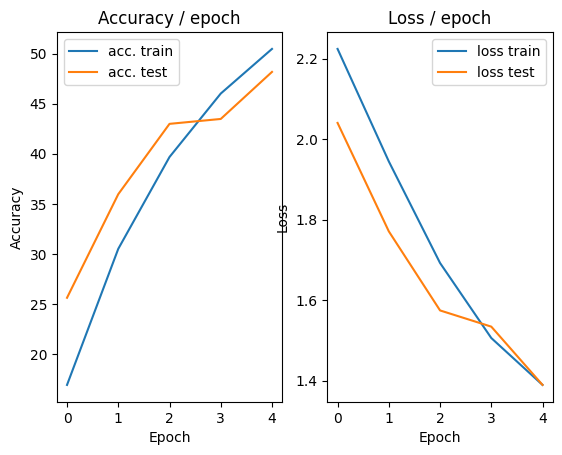

=== EPOCH 6 =====

[TRAIN Batch 000/196]	Time 0.195s (0.195s)	Loss 1.3830 (1.3830)	Prec@1  46.5 ( 46.5)	Prec@5  94.1 ( 94.1)


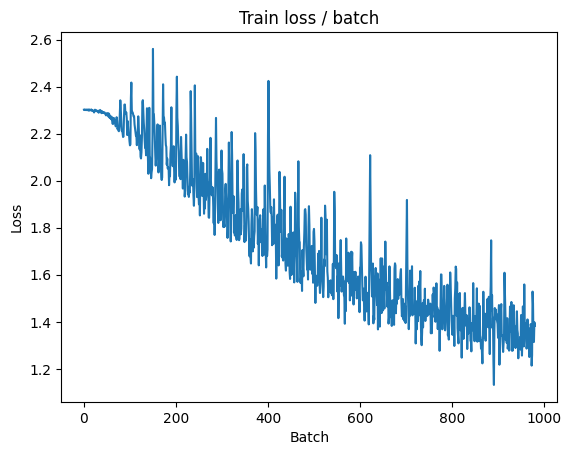


===============> Total time 8s	Avg loss 1.2996	Avg Prec@1 53.87 %	Avg Prec@5 94.07 %

[EVAL Batch 000/040]	Time 0.242s (0.242s)	Loss 1.3986 (1.3986)	Prec@1  53.1 ( 53.1)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.2990	Avg Prec@1 53.83 %	Avg Prec@5 93.92 %



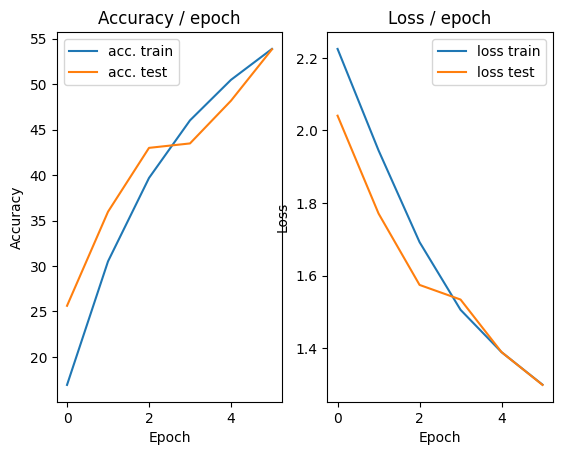

=== EPOCH 7 =====

[TRAIN Batch 000/196]	Time 0.213s (0.213s)	Loss 1.1942 (1.1942)	Prec@1  58.6 ( 58.6)	Prec@5  96.1 ( 96.1)


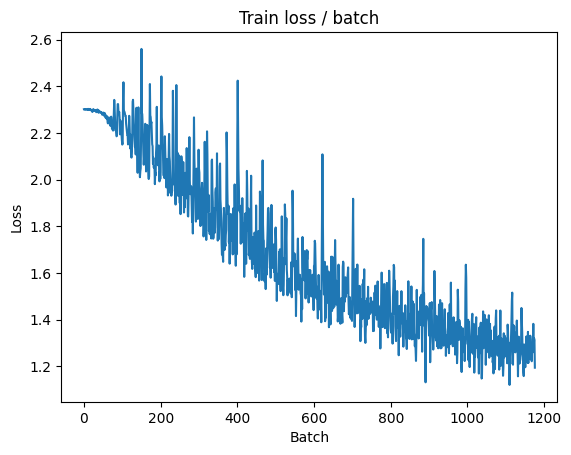


===============> Total time 8s	Avg loss 1.2146	Avg Prec@1 56.93 %	Avg Prec@5 95.05 %

[EVAL Batch 000/040]	Time 0.173s (0.173s)	Loss 1.2914 (1.2914)	Prec@1  57.4 ( 57.4)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.2331	Avg Prec@1 55.97 %	Avg Prec@5 94.55 %



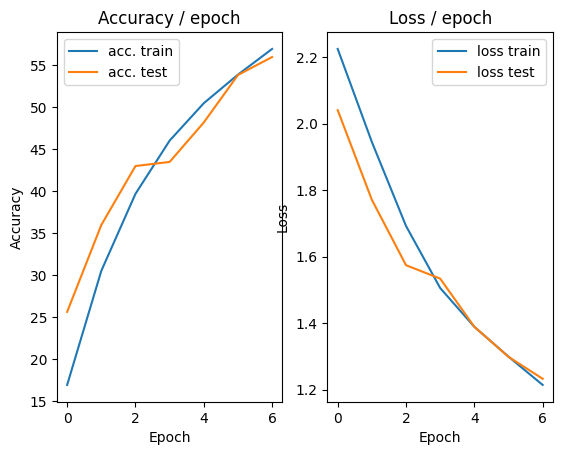

=== EPOCH 8 =====

[TRAIN Batch 000/196]	Time 0.255s (0.255s)	Loss 1.0764 (1.0764)	Prec@1  64.5 ( 64.5)	Prec@5  96.5 ( 96.5)


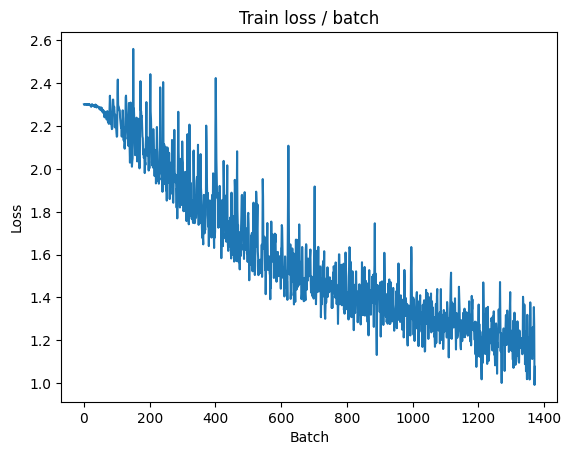


===============> Total time 8s	Avg loss 1.1383	Avg Prec@1 59.94 %	Avg Prec@5 95.69 %

[EVAL Batch 000/040]	Time 0.161s (0.161s)	Loss 1.3036 (1.3036)	Prec@1  53.9 ( 53.9)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2914	Avg Prec@1 54.07 %	Avg Prec@5 95.38 %



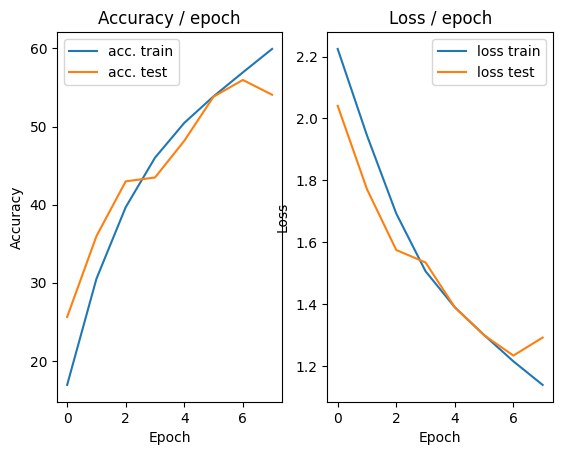

=== EPOCH 9 =====

[TRAIN Batch 000/196]	Time 0.211s (0.211s)	Loss 1.3538 (1.3538)	Prec@1  49.2 ( 49.2)	Prec@5  96.1 ( 96.1)


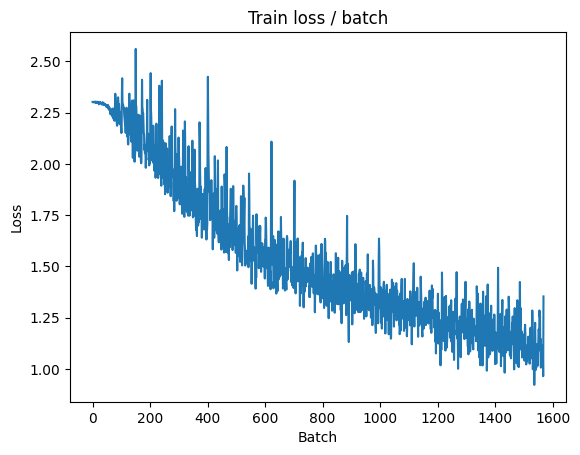


===============> Total time 9s	Avg loss 1.0705	Avg Prec@1 62.32 %	Avg Prec@5 96.23 %

[EVAL Batch 000/040]	Time 0.161s (0.161s)	Loss 1.1721 (1.1721)	Prec@1  59.8 ( 59.8)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.1264	Avg Prec@1 59.94 %	Avg Prec@5 95.65 %



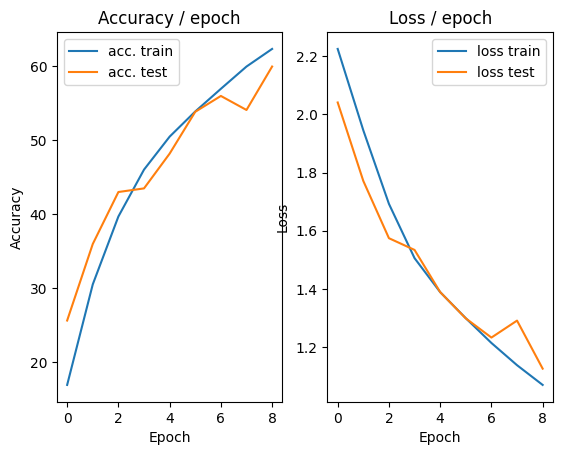

=== EPOCH 10 =====

[TRAIN Batch 000/196]	Time 0.205s (0.205s)	Loss 0.9581 (0.9581)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)


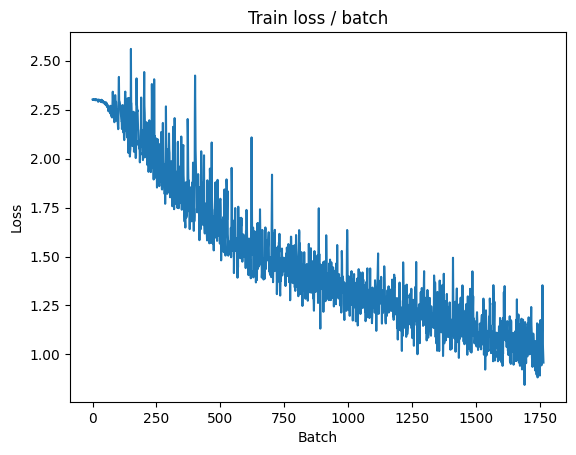


===============> Total time 9s	Avg loss 0.9905	Avg Prec@1 65.13 %	Avg Prec@5 96.79 %

[EVAL Batch 000/040]	Time 0.179s (0.179s)	Loss 1.2542 (1.2542)	Prec@1  56.6 ( 56.6)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.1122	Avg Prec@1 60.64 %	Avg Prec@5 96.06 %



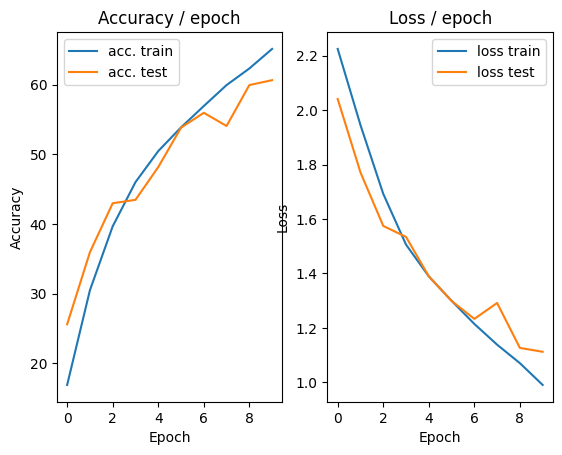

=== EPOCH 11 =====

[TRAIN Batch 000/196]	Time 0.194s (0.194s)	Loss 0.8951 (0.8951)	Prec@1  68.8 ( 68.8)	Prec@5  97.3 ( 97.3)


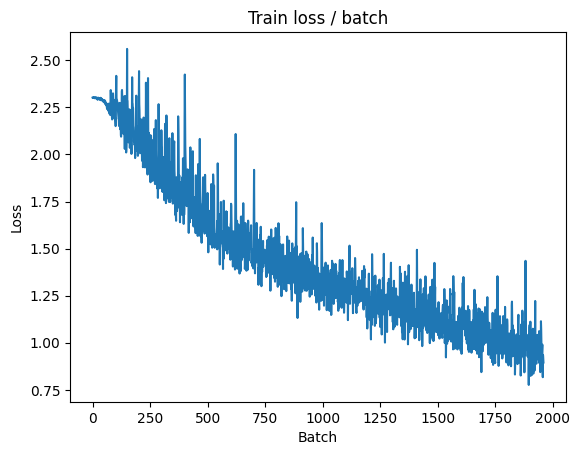


===============> Total time 9s	Avg loss 0.9268	Avg Prec@1 67.46 %	Avg Prec@5 97.29 %

[EVAL Batch 000/040]	Time 0.181s (0.181s)	Loss 1.4435 (1.4435)	Prec@1  51.6 ( 51.6)	Prec@5  93.4 ( 93.4)

===============> Total time 1s	Avg loss 1.3798	Avg Prec@1 52.87 %	Avg Prec@5 93.85 %



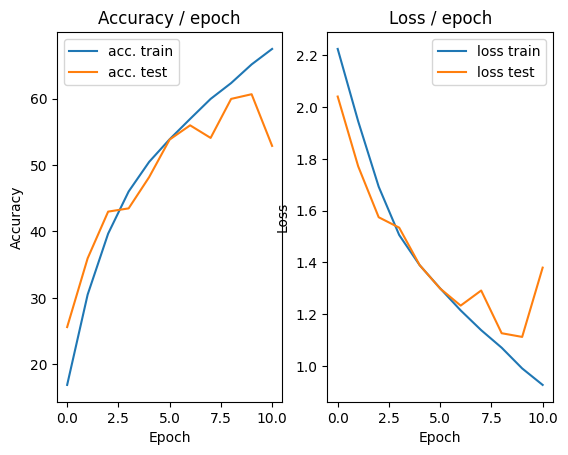

=== EPOCH 12 =====

[TRAIN Batch 000/196]	Time 0.187s (0.187s)	Loss 1.1176 (1.1176)	Prec@1  57.4 ( 57.4)	Prec@5  97.3 ( 97.3)


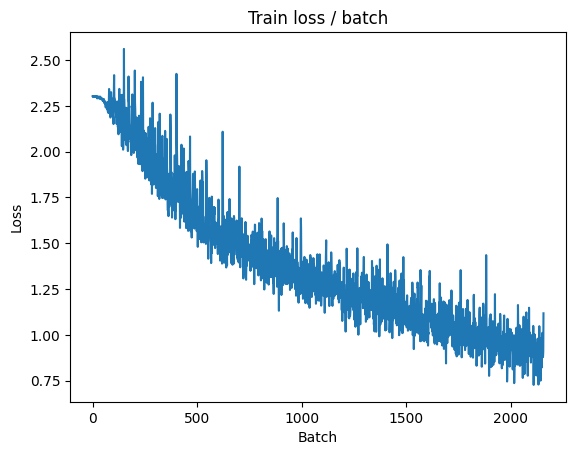


===============> Total time 9s	Avg loss 0.8599	Avg Prec@1 69.79 %	Avg Prec@5 97.85 %

[EVAL Batch 000/040]	Time 0.179s (0.179s)	Loss 1.1501 (1.1501)	Prec@1  59.8 ( 59.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0978	Avg Prec@1 61.69 %	Avg Prec@5 96.47 %



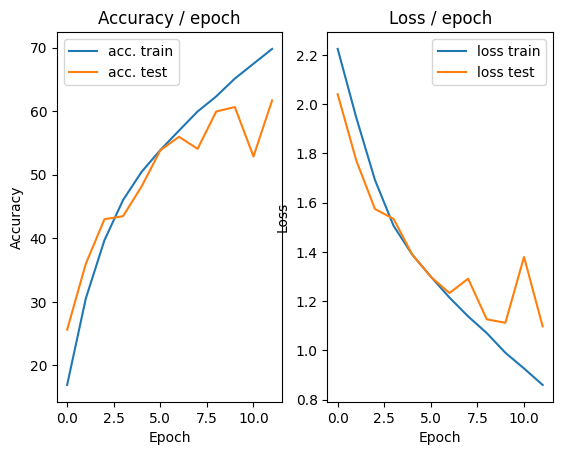

=== EPOCH 13 =====

[TRAIN Batch 000/196]	Time 0.213s (0.213s)	Loss 0.8728 (0.8728)	Prec@1  71.5 ( 71.5)	Prec@5  97.3 ( 97.3)


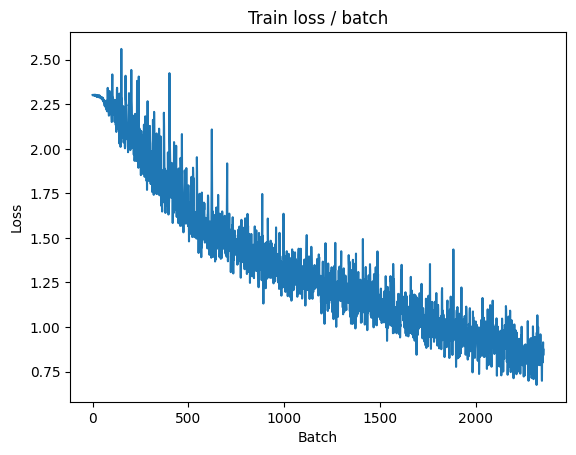


===============> Total time 9s	Avg loss 0.7871	Avg Prec@1 72.26 %	Avg Prec@5 98.16 %

[EVAL Batch 000/040]	Time 0.170s (0.170s)	Loss 1.1764 (1.1764)	Prec@1  60.5 ( 60.5)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.0544	Avg Prec@1 63.55 %	Avg Prec@5 96.42 %



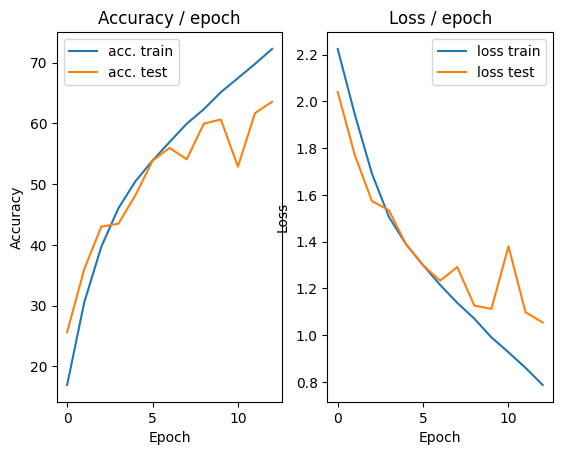

=== EPOCH 14 =====

[TRAIN Batch 000/196]	Time 0.197s (0.197s)	Loss 0.8280 (0.8280)	Prec@1  70.7 ( 70.7)	Prec@5 100.0 (100.0)


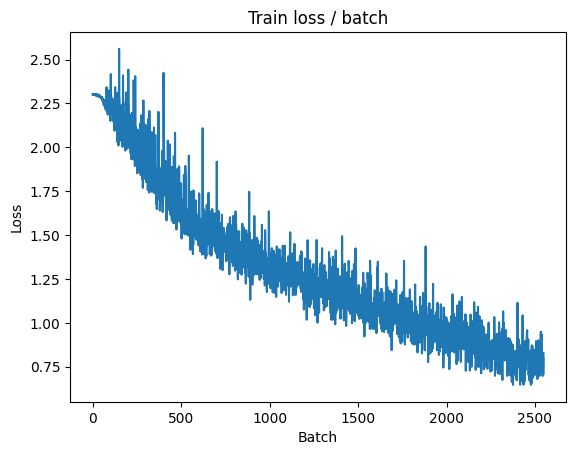


===============> Total time 8s	Avg loss 0.7308	Avg Prec@1 74.65 %	Avg Prec@5 98.51 %

[EVAL Batch 000/040]	Time 0.271s (0.271s)	Loss 1.1315 (1.1315)	Prec@1  62.9 ( 62.9)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.0621	Avg Prec@1 63.94 %	Avg Prec@5 96.52 %



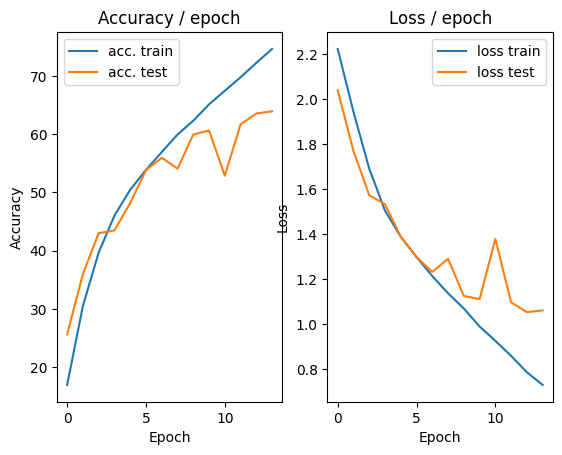

=== EPOCH 15 =====

[TRAIN Batch 000/196]	Time 0.224s (0.224s)	Loss 0.7750 (0.7750)	Prec@1  70.7 ( 70.7)	Prec@5  96.9 ( 96.9)


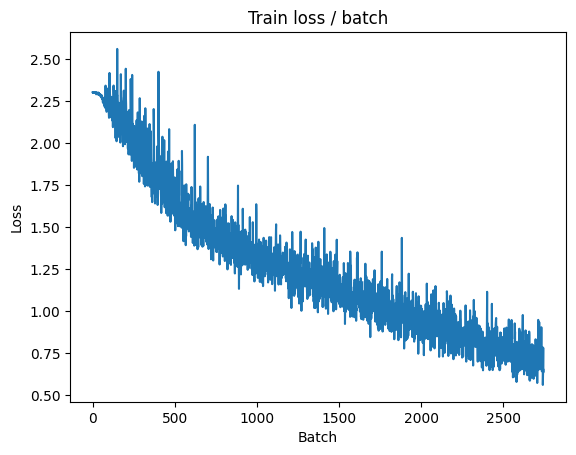


===============> Total time 8s	Avg loss 0.6654	Avg Prec@1 76.81 %	Avg Prec@5 98.75 %

[EVAL Batch 000/040]	Time 0.168s (0.168s)	Loss 1.2167 (1.2167)	Prec@1  59.4 ( 59.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0740	Avg Prec@1 64.34 %	Avg Prec@5 96.77 %



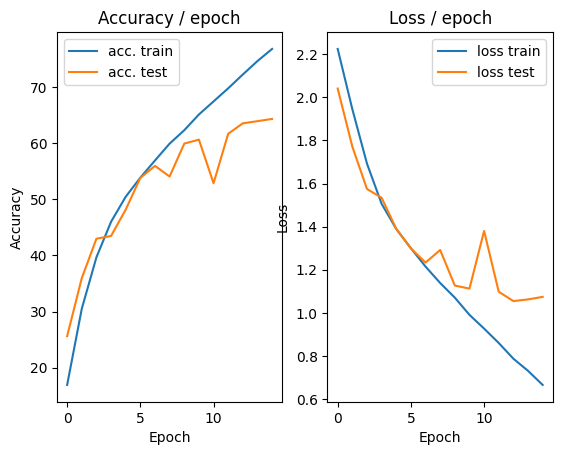

=== EPOCH 16 =====

[TRAIN Batch 000/196]	Time 0.222s (0.222s)	Loss 0.6630 (0.6630)	Prec@1  76.2 ( 76.2)	Prec@5  98.4 ( 98.4)


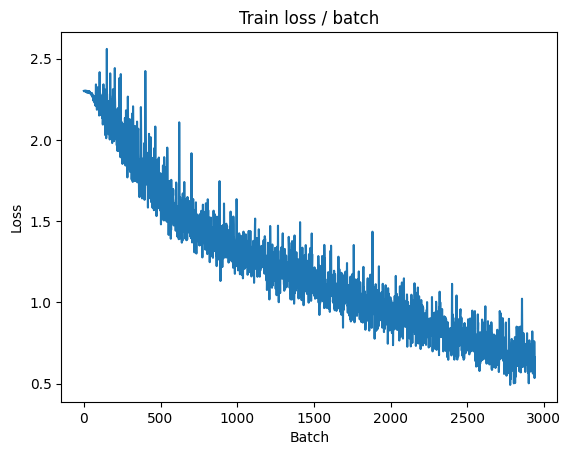


===============> Total time 8s	Avg loss 0.5940	Avg Prec@1 79.27 %	Avg Prec@5 99.12 %

[EVAL Batch 000/040]	Time 0.168s (0.168s)	Loss 1.3893 (1.3893)	Prec@1  56.6 ( 56.6)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.2547	Avg Prec@1 60.57 %	Avg Prec@5 96.80 %



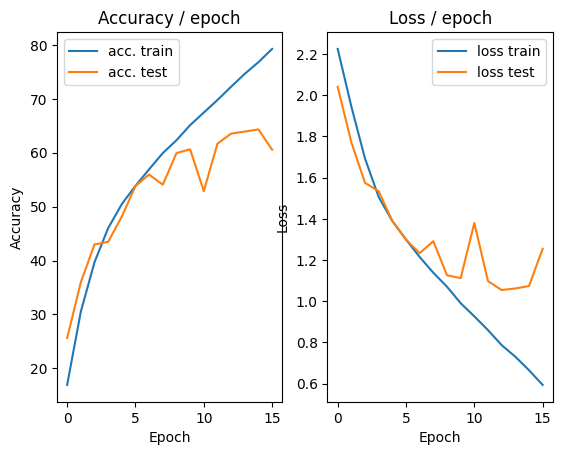

=== EPOCH 17 =====

[TRAIN Batch 000/196]	Time 0.297s (0.297s)	Loss 0.8902 (0.8902)	Prec@1  67.2 ( 67.2)	Prec@5  98.8 ( 98.8)


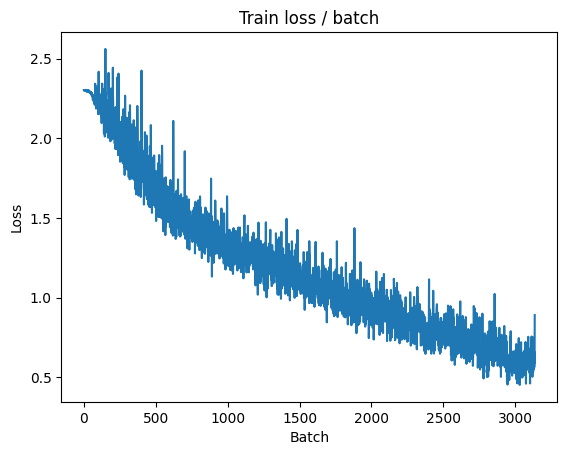


===============> Total time 9s	Avg loss 0.5337	Avg Prec@1 81.47 %	Avg Prec@5 99.30 %

[EVAL Batch 000/040]	Time 0.167s (0.167s)	Loss 1.3094 (1.3094)	Prec@1  63.7 ( 63.7)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1644	Avg Prec@1 63.90 %	Avg Prec@5 96.16 %



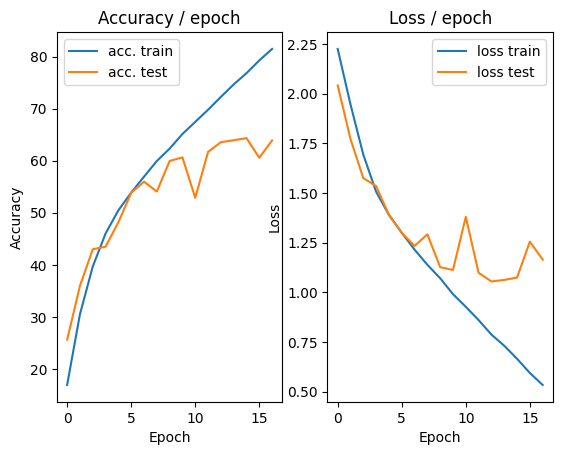

=== EPOCH 18 =====

[TRAIN Batch 000/196]	Time 0.193s (0.193s)	Loss 0.6947 (0.6947)	Prec@1  74.6 ( 74.6)	Prec@5  99.2 ( 99.2)


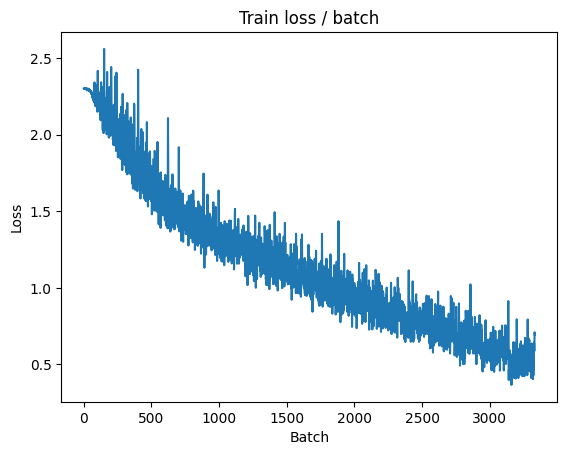


===============> Total time 9s	Avg loss 0.4667	Avg Prec@1 83.63 %	Avg Prec@5 99.55 %

[EVAL Batch 000/040]	Time 0.182s (0.182s)	Loss 1.3734 (1.3734)	Prec@1  65.6 ( 65.6)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2015	Avg Prec@1 64.18 %	Avg Prec@5 96.42 %



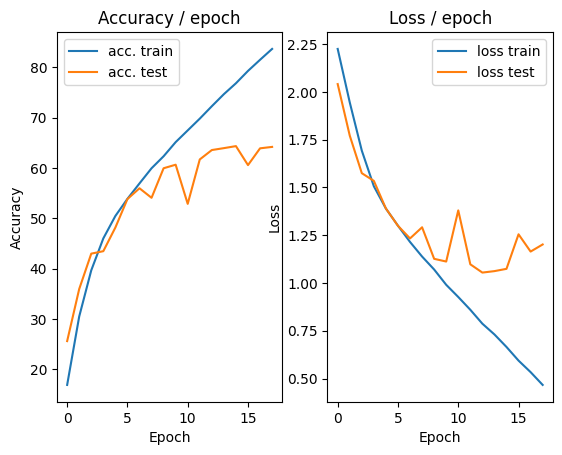

=== EPOCH 19 =====

[TRAIN Batch 000/196]	Time 0.205s (0.205s)	Loss 0.5102 (0.5102)	Prec@1  79.3 ( 79.3)	Prec@5 100.0 (100.0)


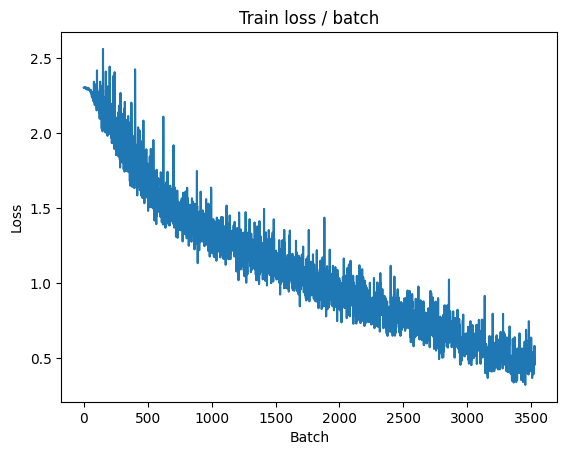


===============> Total time 9s	Avg loss 0.4003	Avg Prec@1 86.23 %	Avg Prec@5 99.66 %

[EVAL Batch 000/040]	Time 0.167s (0.167s)	Loss 1.7414 (1.7414)	Prec@1  60.9 ( 60.9)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.5667	Avg Prec@1 60.44 %	Avg Prec@5 95.35 %



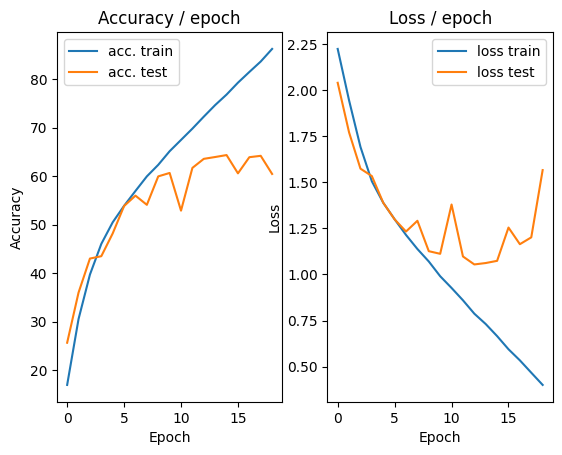

=== EPOCH 20 =====

[TRAIN Batch 000/196]	Time 0.216s (0.216s)	Loss 0.5437 (0.5437)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


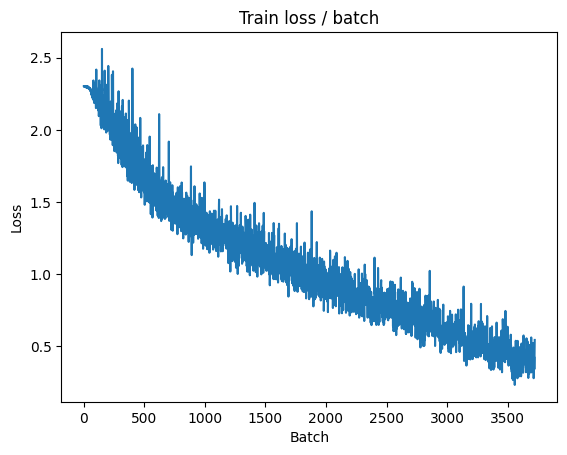


===============> Total time 9s	Avg loss 0.3309	Avg Prec@1 88.80 %	Avg Prec@5 99.76 %

[EVAL Batch 000/040]	Time 0.171s (0.171s)	Loss 1.4042 (1.4042)	Prec@1  66.8 ( 66.8)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.1519	Avg Prec@1 67.47 %	Avg Prec@5 97.00 %



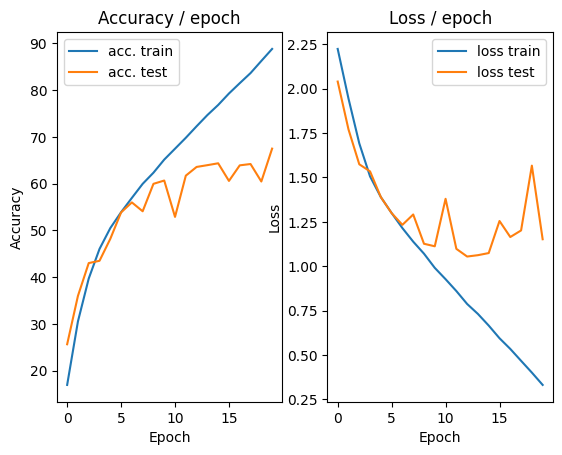

=== EPOCH 21 =====

[TRAIN Batch 000/196]	Time 0.224s (0.224s)	Loss 0.3774 (0.3774)	Prec@1  86.7 ( 86.7)	Prec@5  98.8 ( 98.8)


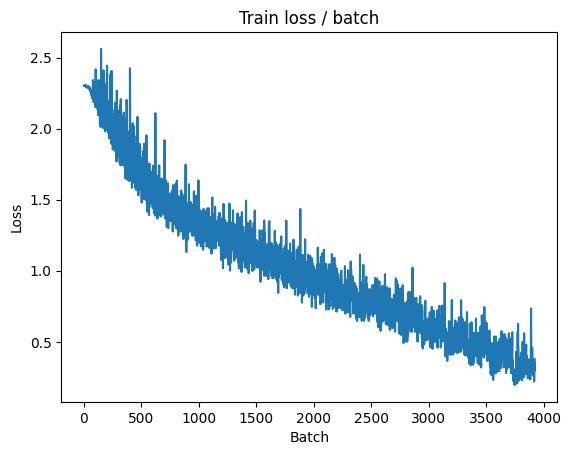


===============> Total time 9s	Avg loss 0.3166	Avg Prec@1 89.66 %	Avg Prec@5 99.70 %

[EVAL Batch 000/040]	Time 0.165s (0.165s)	Loss 1.5312 (1.5312)	Prec@1  62.5 ( 62.5)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.3047	Avg Prec@1 64.83 %	Avg Prec@5 95.85 %



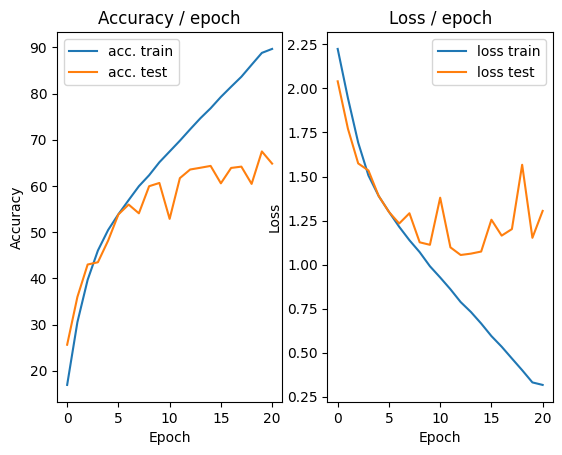

=== EPOCH 22 =====

[TRAIN Batch 000/196]	Time 0.222s (0.222s)	Loss 0.3374 (0.3374)	Prec@1  88.7 ( 88.7)	Prec@5  99.6 ( 99.6)


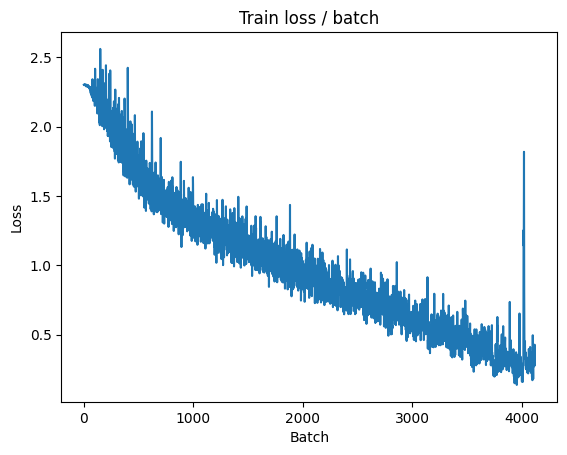


===============> Total time 9s	Avg loss 0.2247	Avg Prec@1 92.55 %	Avg Prec@5 99.91 %

[EVAL Batch 000/040]	Time 0.219s (0.219s)	Loss 1.7207 (1.7207)	Prec@1  59.8 ( 59.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.5018	Avg Prec@1 64.66 %	Avg Prec@5 96.25 %



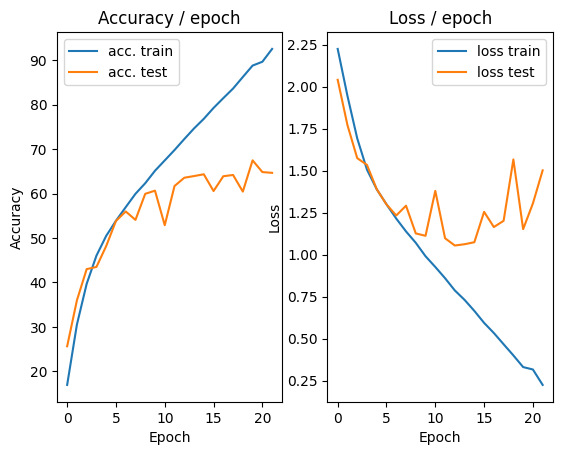

=== EPOCH 23 =====

[TRAIN Batch 000/196]	Time 0.208s (0.208s)	Loss 0.4047 (0.4047)	Prec@1  86.3 ( 86.3)	Prec@5  99.6 ( 99.6)


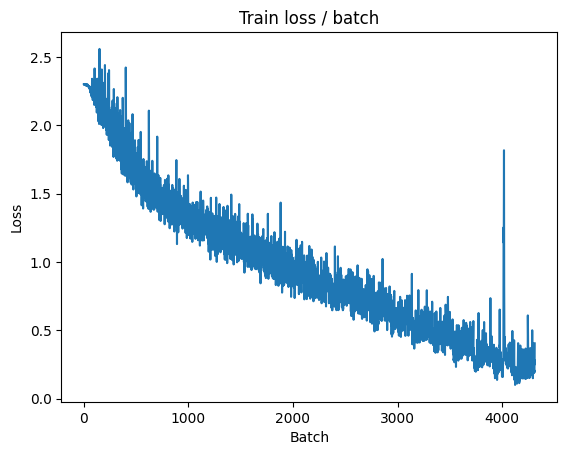


===============> Total time 8s	Avg loss 0.1838	Avg Prec@1 94.29 %	Avg Prec@5 99.91 %

[EVAL Batch 000/040]	Time 0.216s (0.216s)	Loss 1.6692 (1.6692)	Prec@1  66.0 ( 66.0)	Prec@5  94.9 ( 94.9)

===============> Total time 2s	Avg loss 1.5038	Avg Prec@1 65.52 %	Avg Prec@5 96.55 %



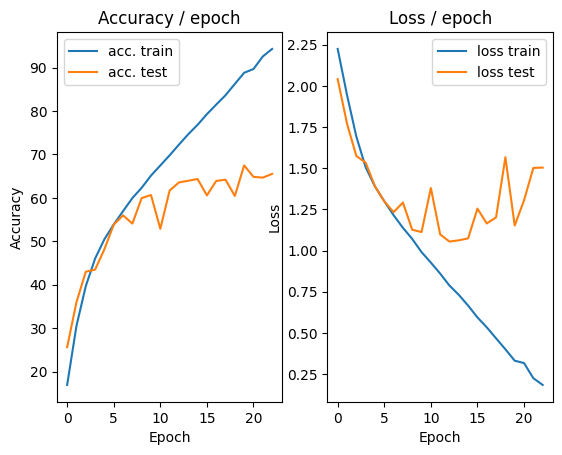

=== EPOCH 24 =====

[TRAIN Batch 000/196]	Time 0.207s (0.207s)	Loss 0.2400 (0.2400)	Prec@1  92.6 ( 92.6)	Prec@5 100.0 (100.0)


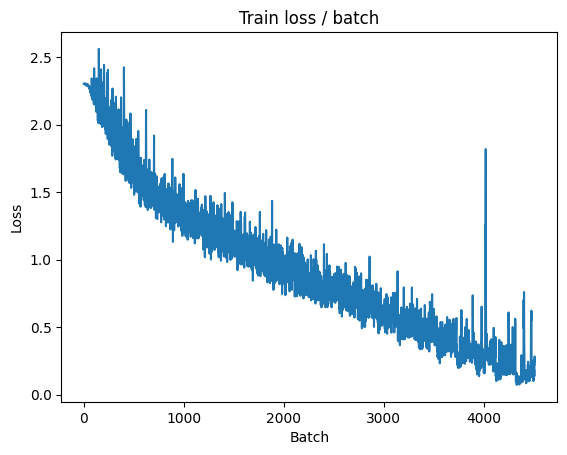


===============> Total time 8s	Avg loss 0.1249	Avg Prec@1 96.53 %	Avg Prec@5 99.91 %

[EVAL Batch 000/040]	Time 0.189s (0.189s)	Loss 1.9829 (1.9829)	Prec@1  63.3 ( 63.3)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.5044	Avg Prec@1 66.69 %	Avg Prec@5 96.59 %



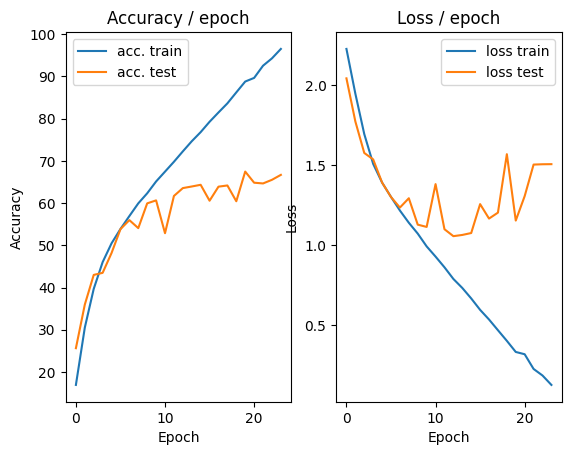

=== EPOCH 25 =====

[TRAIN Batch 000/196]	Time 0.236s (0.236s)	Loss 0.1879 (0.1879)	Prec@1  92.6 ( 92.6)	Prec@5 100.0 (100.0)


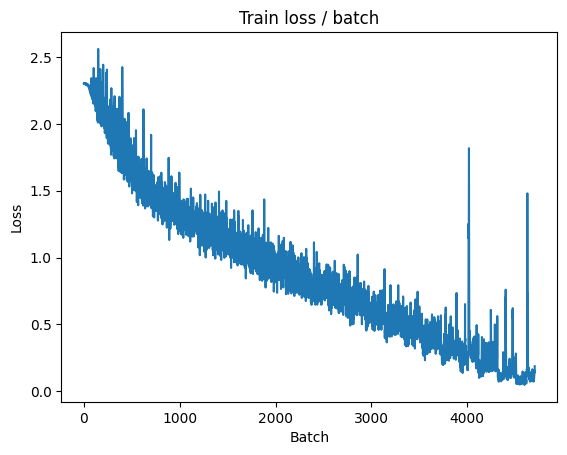


===============> Total time 8s	Avg loss 1.4403	Avg Prec@1 90.23 %	Avg Prec@5 95.41 %

[EVAL Batch 000/040]	Time 0.172s (0.172s)	Loss 2.3709 (2.3709)	Prec@1   7.4 (  7.4)	Prec@5  52.3 ( 52.3)

===============> Total time 1s	Avg loss 2.3787	Avg Prec@1  9.76 %	Avg Prec@5 49.93 %



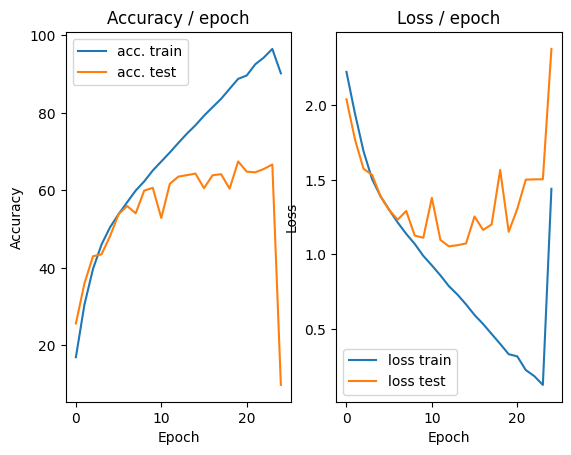

=== EPOCH 26 =====

[TRAIN Batch 000/196]	Time 0.206s (0.206s)	Loss 2.4130 (2.4130)	Prec@1   9.4 (  9.4)	Prec@5  45.3 ( 45.3)


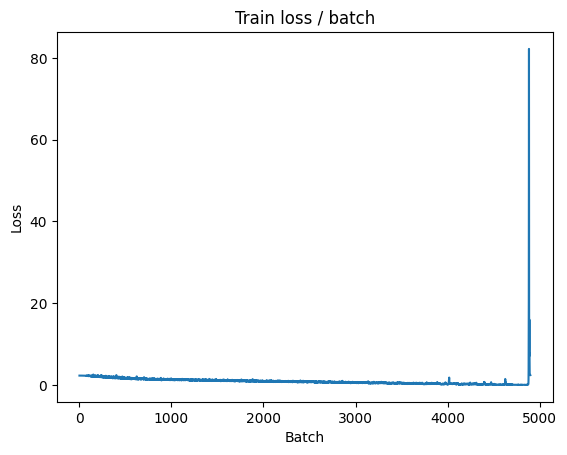


===============> Total time 9s	Avg loss 2.2774	Avg Prec@1 12.13 %	Avg Prec@5 54.45 %

[EVAL Batch 000/040]	Time 0.168s (0.168s)	Loss 2.2015 (2.2015)	Prec@1  15.2 ( 15.2)	Prec@5  57.4 ( 57.4)

===============> Total time 1s	Avg loss 2.1968	Avg Prec@1 16.13 %	Avg Prec@5 62.15 %



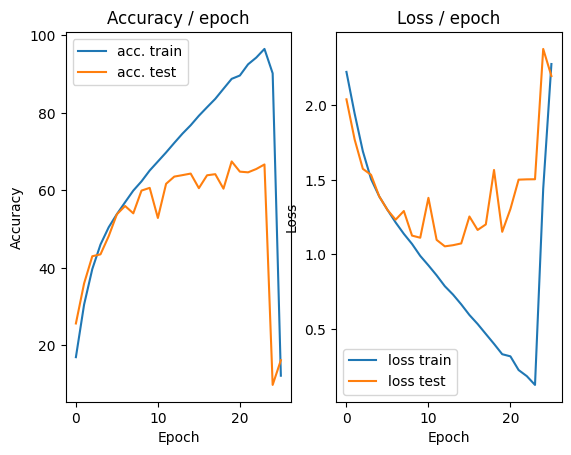

=== EPOCH 27 =====

[TRAIN Batch 000/196]	Time 0.230s (0.230s)	Loss 2.2076 (2.2076)	Prec@1  12.1 ( 12.1)	Prec@5  60.9 ( 60.9)


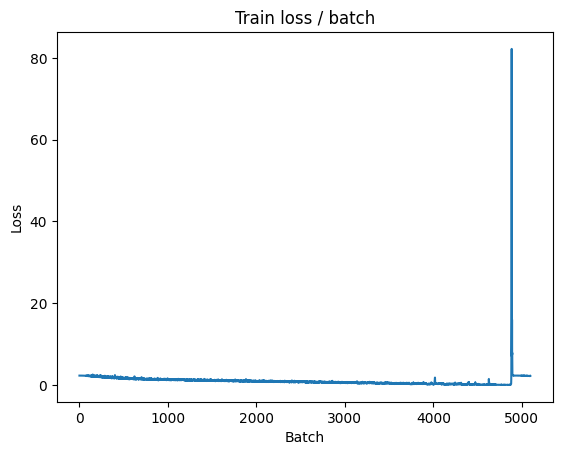


===============> Total time 9s	Avg loss 1.9824	Avg Prec@1 27.43 %	Avg Prec@5 77.83 %

[EVAL Batch 000/040]	Time 0.185s (0.185s)	Loss 1.8307 (1.8307)	Prec@1  31.2 ( 31.2)	Prec@5  83.6 ( 83.6)

===============> Total time 1s	Avg loss 1.7708	Avg Prec@1 35.70 %	Avg Prec@5 85.71 %



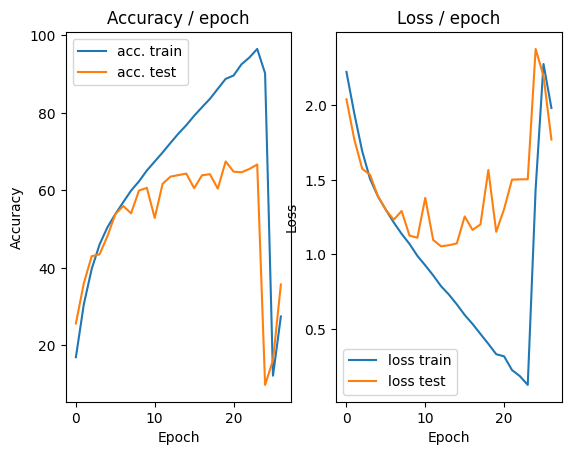

=== EPOCH 28 =====

[TRAIN Batch 000/196]	Time 0.185s (0.185s)	Loss 1.7652 (1.7652)	Prec@1  37.9 ( 37.9)	Prec@5  83.6 ( 83.6)


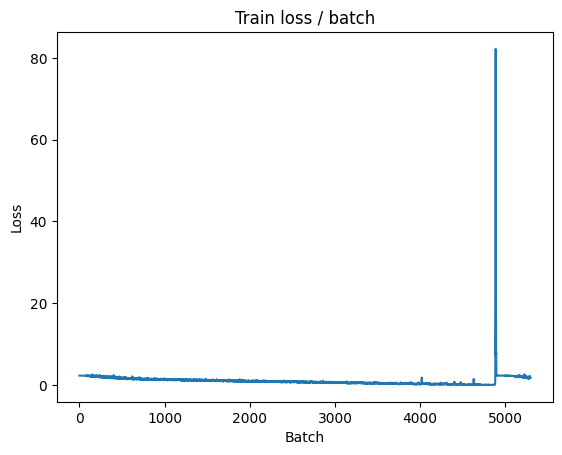


===============> Total time 9s	Avg loss 1.6106	Avg Prec@1 42.14 %	Avg Prec@5 89.00 %

[EVAL Batch 000/040]	Time 0.180s (0.180s)	Loss 1.6822 (1.6822)	Prec@1  38.3 ( 38.3)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.6623	Avg Prec@1 39.90 %	Avg Prec@5 89.92 %



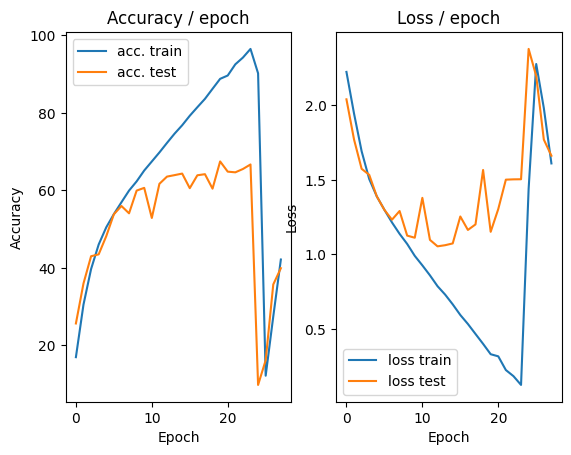

=== EPOCH 29 =====

[TRAIN Batch 000/196]	Time 0.209s (0.209s)	Loss 1.6143 (1.6143)	Prec@1  44.1 ( 44.1)	Prec@5  89.1 ( 89.1)


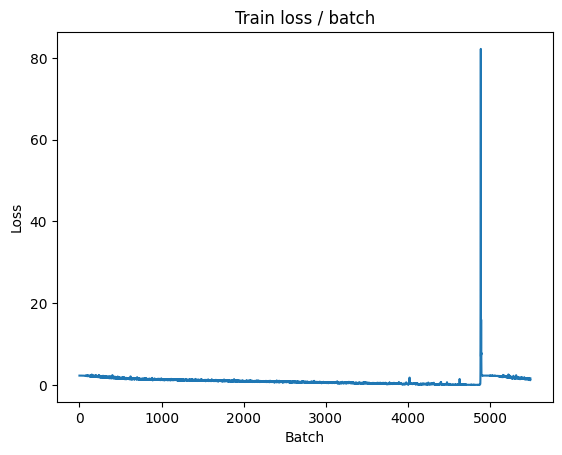


===============> Total time 9s	Avg loss 1.3100	Avg Prec@1 53.53 %	Avg Prec@5 93.75 %

[EVAL Batch 000/040]	Time 0.171s (0.171s)	Loss 1.4045 (1.4045)	Prec@1  49.6 ( 49.6)	Prec@5  94.1 ( 94.1)

===============> Total time 1s	Avg loss 1.4030	Avg Prec@1 48.54 %	Avg Prec@5 93.80 %



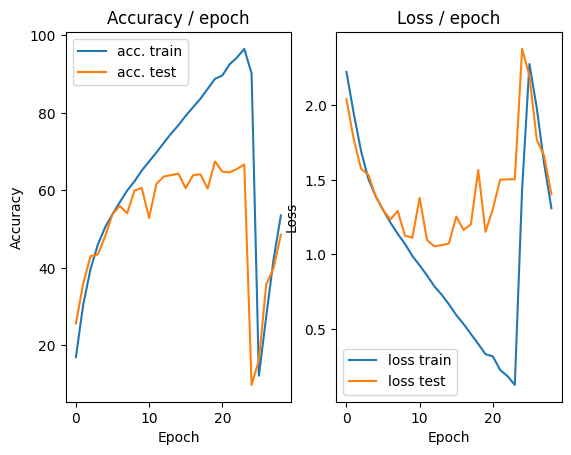

=== EPOCH 30 =====

[TRAIN Batch 000/196]	Time 0.213s (0.213s)	Loss 1.2781 (1.2781)	Prec@1  54.7 ( 54.7)	Prec@5  94.9 ( 94.9)


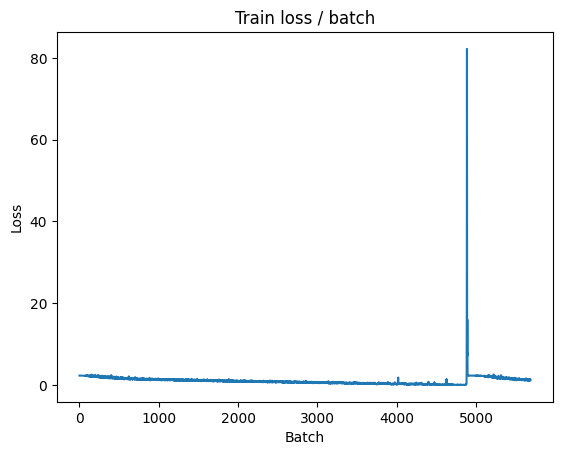


===============> Total time 9s	Avg loss 1.1244	Avg Prec@1 60.29 %	Avg Prec@5 95.79 %

[EVAL Batch 000/040]	Time 0.455s (0.455s)	Loss 1.4152 (1.4152)	Prec@1  53.9 ( 53.9)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.4439	Avg Prec@1 52.18 %	Avg Prec@5 92.94 %



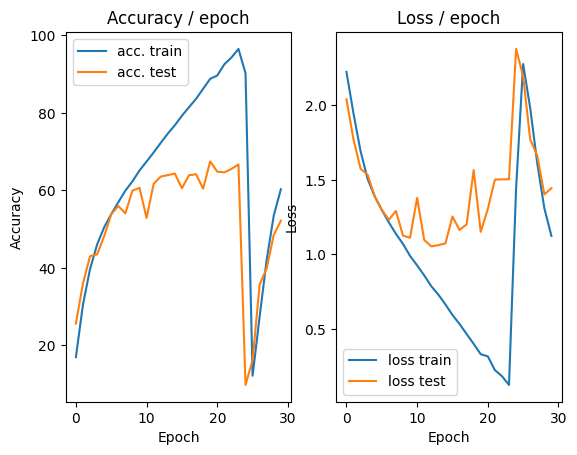

=== EPOCH 31 =====

[TRAIN Batch 000/196]	Time 0.218s (0.218s)	Loss 1.3615 (1.3615)	Prec@1  54.7 ( 54.7)	Prec@5  93.4 ( 93.4)


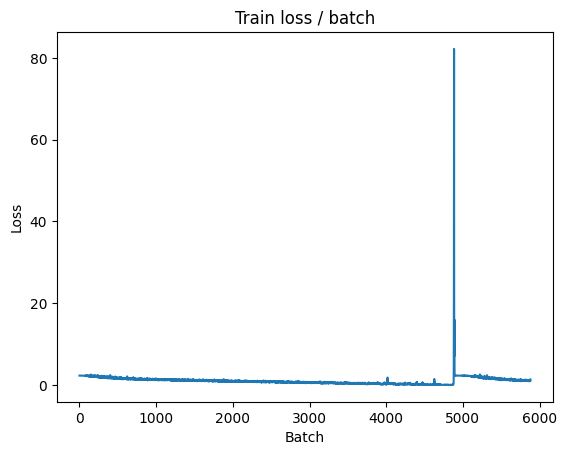


===============> Total time 8s	Avg loss 0.9871	Avg Prec@1 65.30 %	Avg Prec@5 96.85 %

[EVAL Batch 000/040]	Time 0.287s (0.287s)	Loss 1.3382 (1.3382)	Prec@1  54.7 ( 54.7)	Prec@5  94.1 ( 94.1)

===============> Total time 2s	Avg loss 1.2830	Avg Prec@1 54.96 %	Avg Prec@5 94.42 %



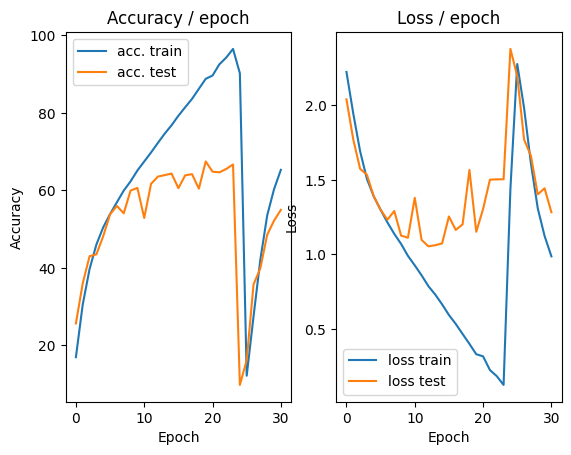

=== EPOCH 32 =====

[TRAIN Batch 000/196]	Time 0.240s (0.240s)	Loss 1.1192 (1.1192)	Prec@1  62.1 ( 62.1)	Prec@5  97.7 ( 97.7)


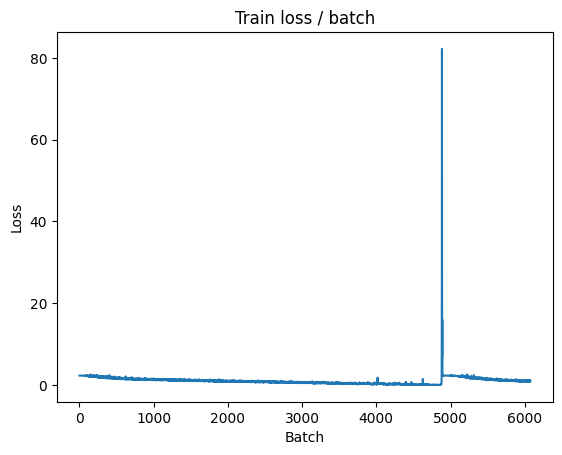


===============> Total time 8s	Avg loss 0.8551	Avg Prec@1 69.95 %	Avg Prec@5 97.82 %

[EVAL Batch 000/040]	Time 0.183s (0.183s)	Loss 1.0881 (1.0881)	Prec@1  61.3 ( 61.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0565	Avg Prec@1 63.45 %	Avg Prec@5 96.61 %



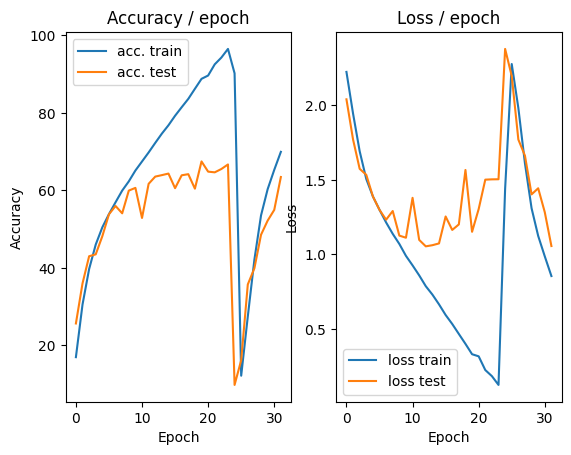

=== EPOCH 33 =====

[TRAIN Batch 000/196]	Time 0.371s (0.371s)	Loss 0.7716 (0.7716)	Prec@1  70.7 ( 70.7)	Prec@5  98.4 ( 98.4)


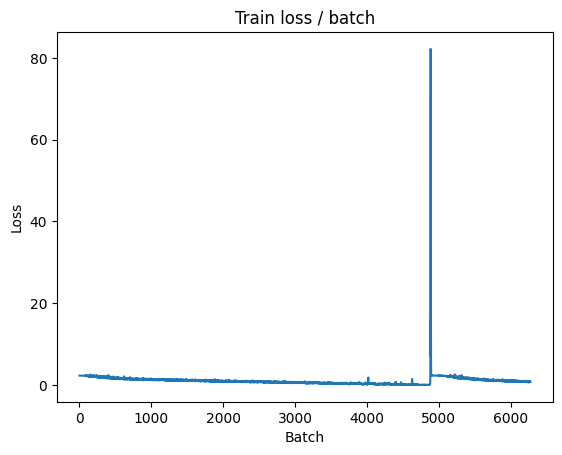


===============> Total time 8s	Avg loss 0.7555	Avg Prec@1 73.57 %	Avg Prec@5 98.42 %

[EVAL Batch 000/040]	Time 0.185s (0.185s)	Loss 1.4128 (1.4128)	Prec@1  59.4 ( 59.4)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.3776	Avg Prec@1 57.56 %	Avg Prec@5 93.26 %



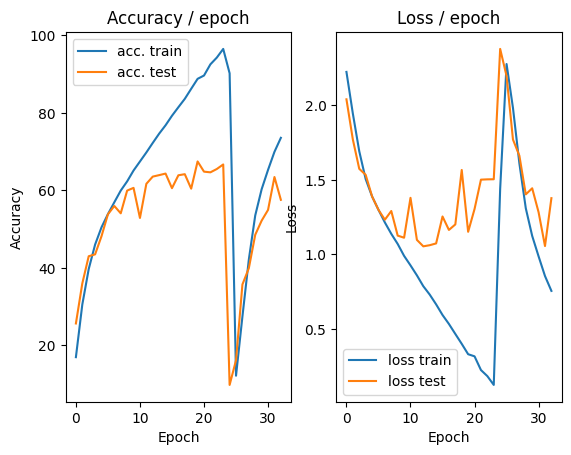

=== EPOCH 34 =====

[TRAIN Batch 000/196]	Time 0.218s (0.218s)	Loss 0.9948 (0.9948)	Prec@1  64.8 ( 64.8)	Prec@5  98.0 ( 98.0)


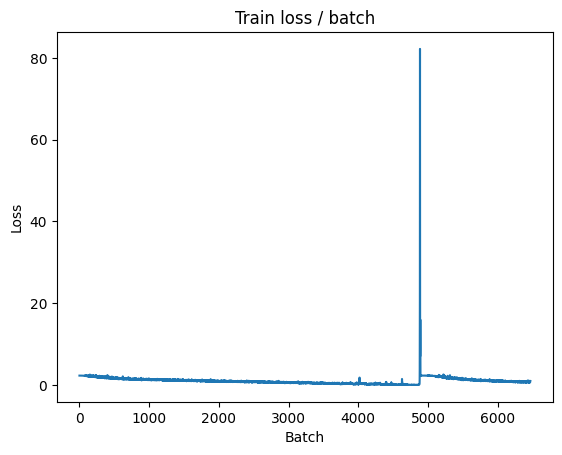


===============> Total time 9s	Avg loss 0.6608	Avg Prec@1 76.71 %	Avg Prec@5 98.89 %

[EVAL Batch 000/040]	Time 0.197s (0.197s)	Loss 1.2009 (1.2009)	Prec@1  62.1 ( 62.1)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 1.1657	Avg Prec@1 62.95 %	Avg Prec@5 96.46 %



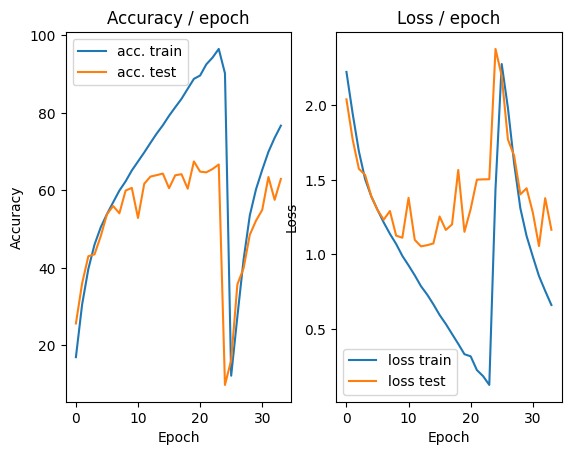

=== EPOCH 35 =====

[TRAIN Batch 000/196]	Time 0.254s (0.254s)	Loss 0.6669 (0.6669)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


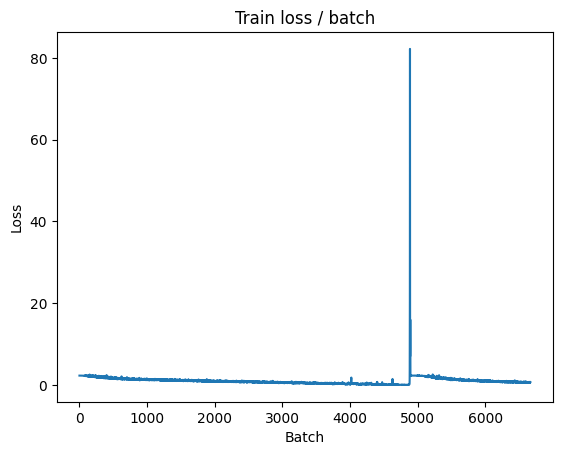


===============> Total time 9s	Avg loss 0.5763	Avg Prec@1 79.70 %	Avg Prec@5 99.23 %

[EVAL Batch 000/040]	Time 0.191s (0.191s)	Loss 1.1556 (1.1556)	Prec@1  63.7 ( 63.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0836	Avg Prec@1 65.90 %	Avg Prec@5 95.90 %



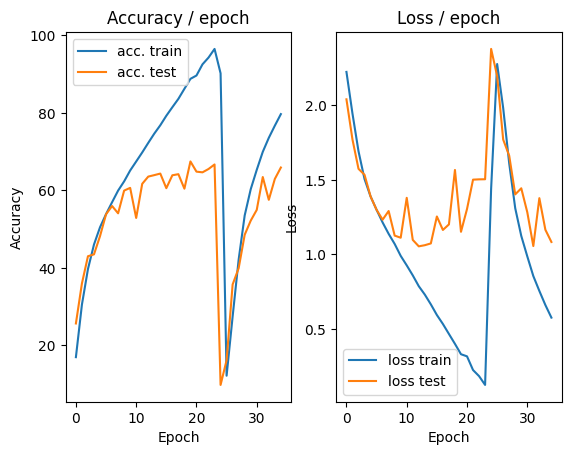

=== EPOCH 36 =====

[TRAIN Batch 000/196]	Time 0.222s (0.222s)	Loss 0.4557 (0.4557)	Prec@1  82.8 ( 82.8)	Prec@5  99.6 ( 99.6)


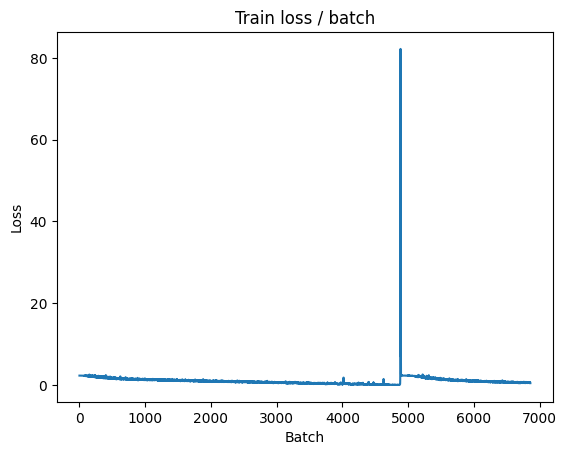


===============> Total time 9s	Avg loss 0.5009	Avg Prec@1 82.59 %	Avg Prec@5 99.39 %

[EVAL Batch 000/040]	Time 0.186s (0.186s)	Loss 1.2999 (1.2999)	Prec@1  62.1 ( 62.1)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.1814	Avg Prec@1 63.94 %	Avg Prec@5 95.61 %



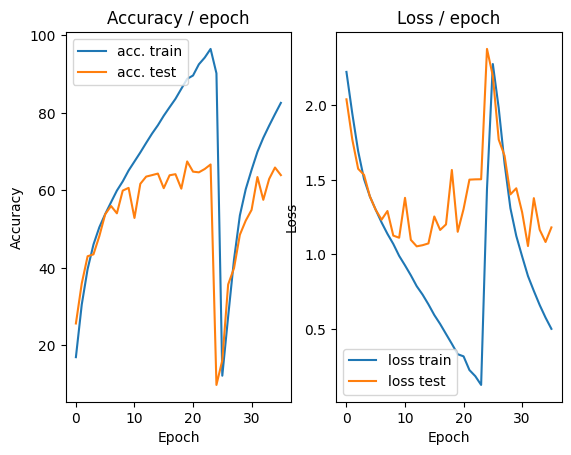

=== EPOCH 37 =====

[TRAIN Batch 000/196]	Time 0.248s (0.248s)	Loss 0.5218 (0.5218)	Prec@1  80.9 ( 80.9)	Prec@5  99.6 ( 99.6)


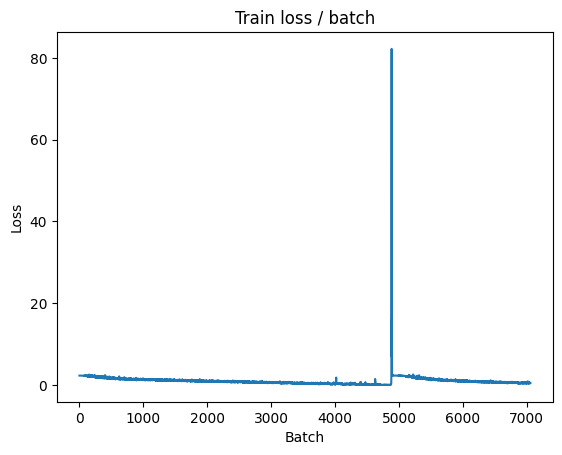


===============> Total time 9s	Avg loss 0.4224	Avg Prec@1 85.12 %	Avg Prec@5 99.66 %

[EVAL Batch 000/040]	Time 0.189s (0.189s)	Loss 1.3139 (1.3139)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.3455	Avg Prec@1 62.87 %	Avg Prec@5 96.01 %



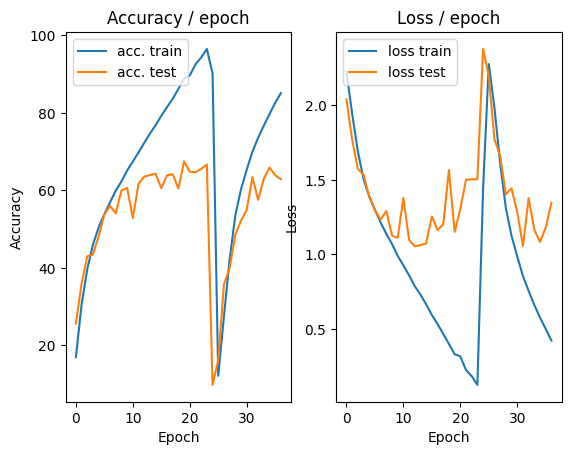

=== EPOCH 38 =====

[TRAIN Batch 000/196]	Time 0.198s (0.198s)	Loss 0.5229 (0.5229)	Prec@1  82.0 ( 82.0)	Prec@5  99.6 ( 99.6)


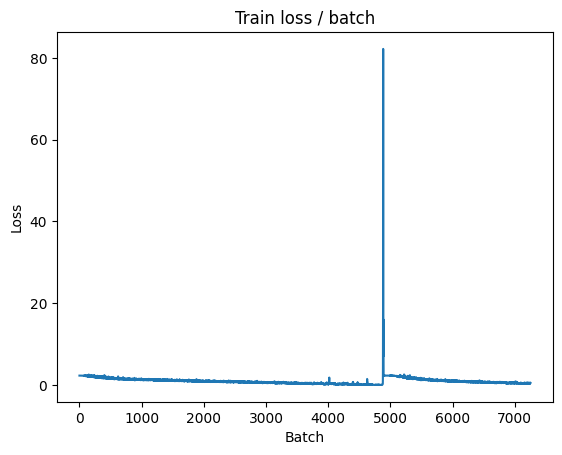


===============> Total time 9s	Avg loss 0.3610	Avg Prec@1 87.56 %	Avg Prec@5 99.74 %

[EVAL Batch 000/040]	Time 0.189s (0.189s)	Loss 1.3238 (1.3238)	Prec@1  63.3 ( 63.3)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 1.2163	Avg Prec@1 64.87 %	Avg Prec@5 96.31 %



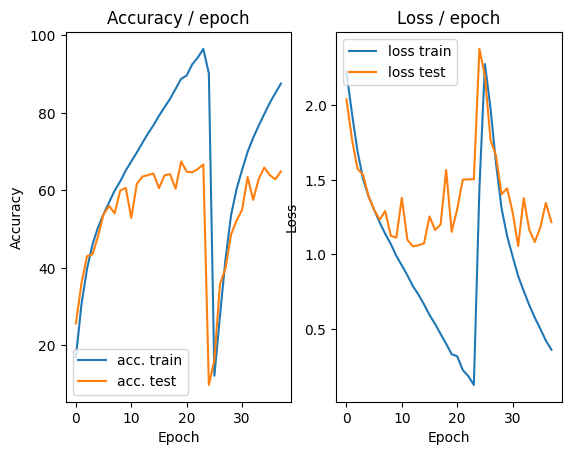

=== EPOCH 39 =====

[TRAIN Batch 000/196]	Time 0.209s (0.209s)	Loss 0.3343 (0.3343)	Prec@1  87.1 ( 87.1)	Prec@5 100.0 (100.0)


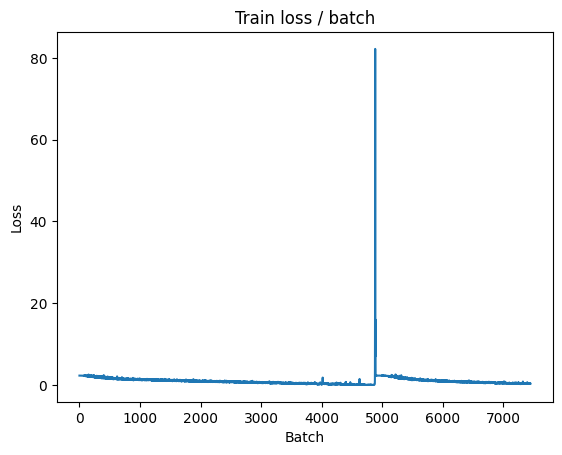


===============> Total time 8s	Avg loss 0.2957	Avg Prec@1 89.87 %	Avg Prec@5 99.85 %

[EVAL Batch 000/040]	Time 0.292s (0.292s)	Loss 1.6664 (1.6664)	Prec@1  62.5 ( 62.5)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.4519	Avg Prec@1 62.66 %	Avg Prec@5 95.84 %



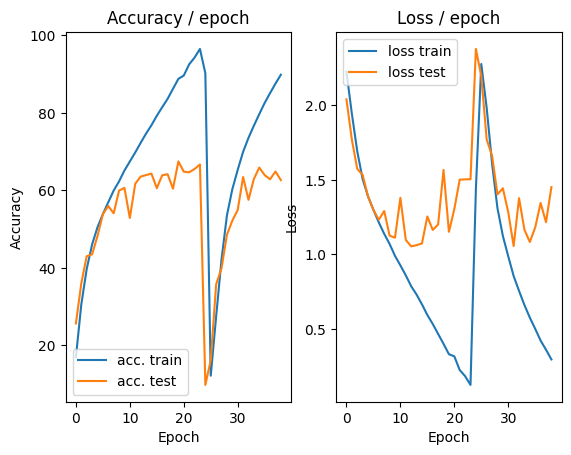

=== EPOCH 40 =====

[TRAIN Batch 000/196]	Time 0.210s (0.210s)	Loss 0.5146 (0.5146)	Prec@1  83.6 ( 83.6)	Prec@5  99.6 ( 99.6)


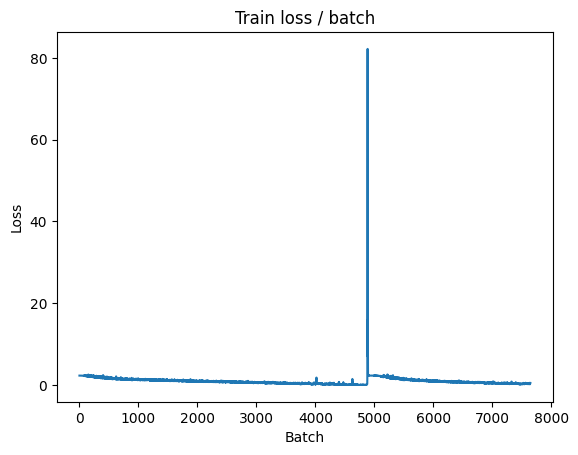


===============> Total time 8s	Avg loss 0.2367	Avg Prec@1 92.07 %	Avg Prec@5 99.91 %

[EVAL Batch 000/040]	Time 0.181s (0.181s)	Loss 1.8640 (1.8640)	Prec@1  54.7 ( 54.7)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.8767	Avg Prec@1 59.75 %	Avg Prec@5 95.47 %



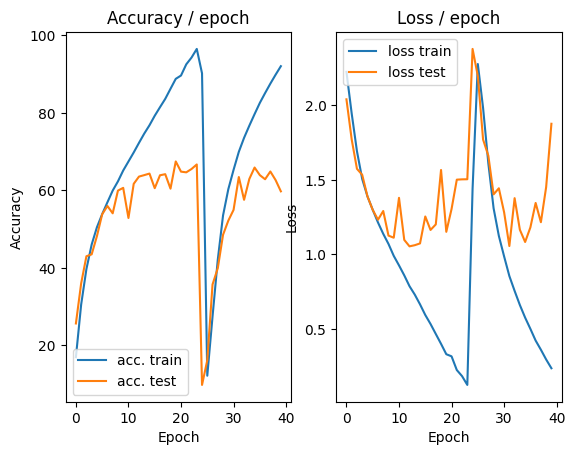

=== EPOCH 41 =====

[TRAIN Batch 000/196]	Time 0.334s (0.334s)	Loss 0.5884 (0.5884)	Prec@1  83.2 ( 83.2)	Prec@5  99.6 ( 99.6)


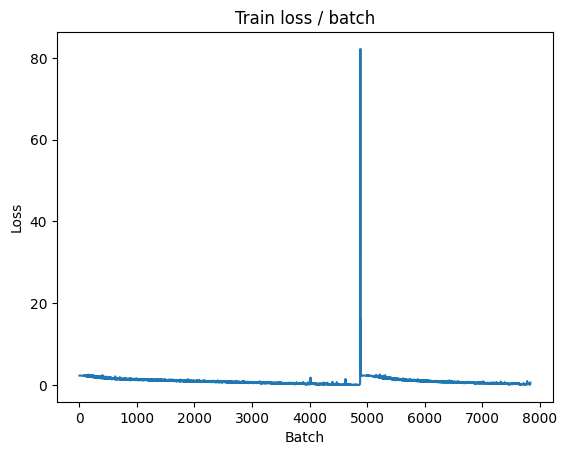


===============> Total time 8s	Avg loss 0.1872	Avg Prec@1 94.03 %	Avg Prec@5 99.93 %

[EVAL Batch 000/040]	Time 0.177s (0.177s)	Loss 1.5671 (1.5671)	Prec@1  66.4 ( 66.4)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.4781	Avg Prec@1 65.35 %	Avg Prec@5 96.30 %



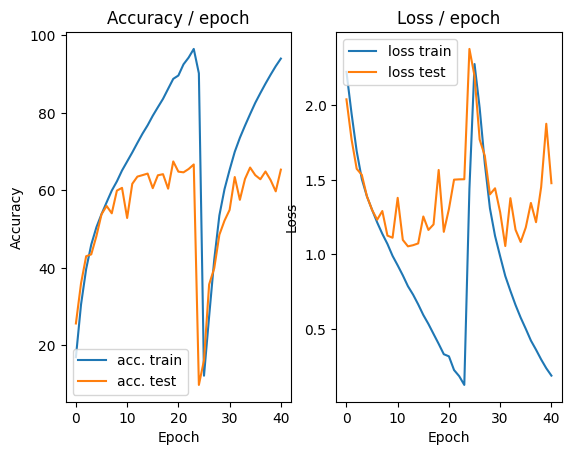

=== EPOCH 42 =====

[TRAIN Batch 000/196]	Time 0.241s (0.241s)	Loss 0.2565 (0.2565)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


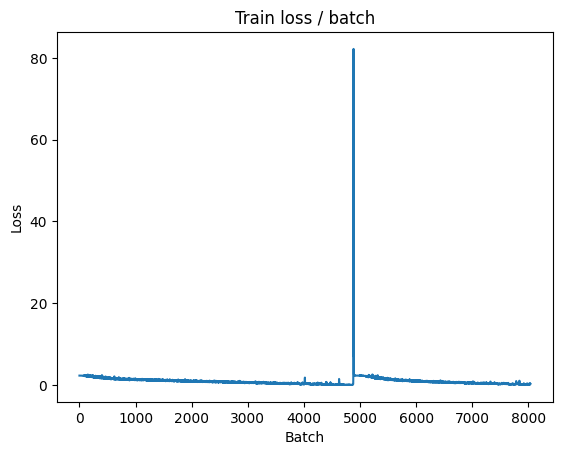


===============> Total time 9s	Avg loss 0.1140	Avg Prec@1 96.54 %	Avg Prec@5 99.99 %

[EVAL Batch 000/040]	Time 0.179s (0.179s)	Loss 1.6694 (1.6694)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.7330	Avg Prec@1 64.45 %	Avg Prec@5 96.47 %



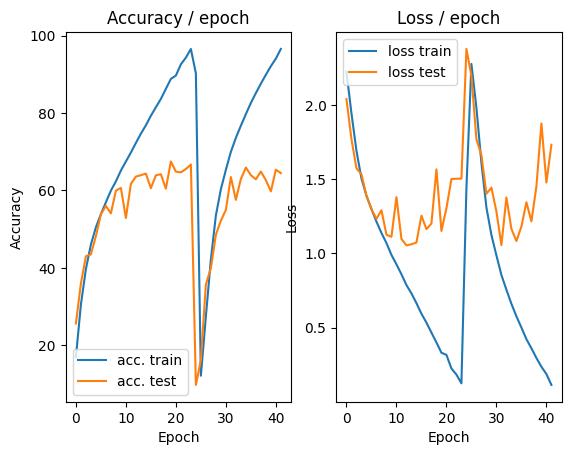

=== EPOCH 43 =====

[TRAIN Batch 000/196]	Time 0.228s (0.228s)	Loss 0.1949 (0.1949)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


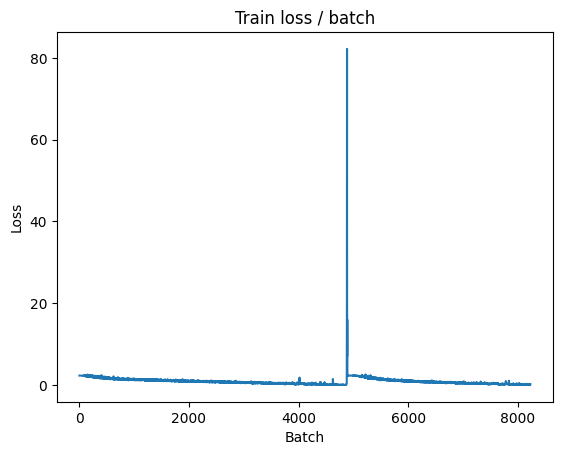


===============> Total time 9s	Avg loss 0.2601	Avg Prec@1 92.70 %	Avg Prec@5 99.55 %

[EVAL Batch 000/040]	Time 0.189s (0.189s)	Loss 1.4724 (1.4724)	Prec@1  65.6 ( 65.6)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.3482	Avg Prec@1 67.92 %	Avg Prec@5 96.46 %



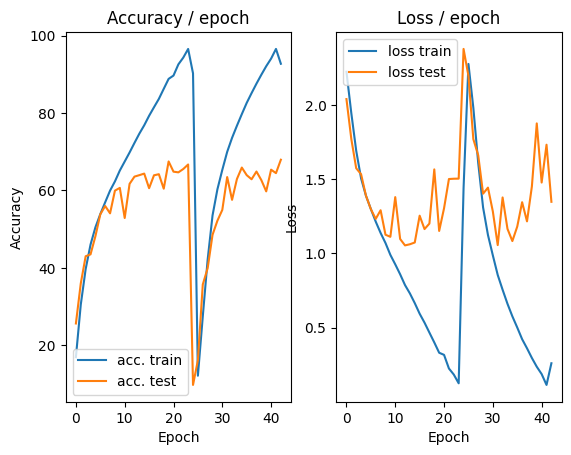

=== EPOCH 44 =====

[TRAIN Batch 000/196]	Time 0.240s (0.240s)	Loss 0.1487 (0.1487)	Prec@1  94.1 ( 94.1)	Prec@5 100.0 (100.0)


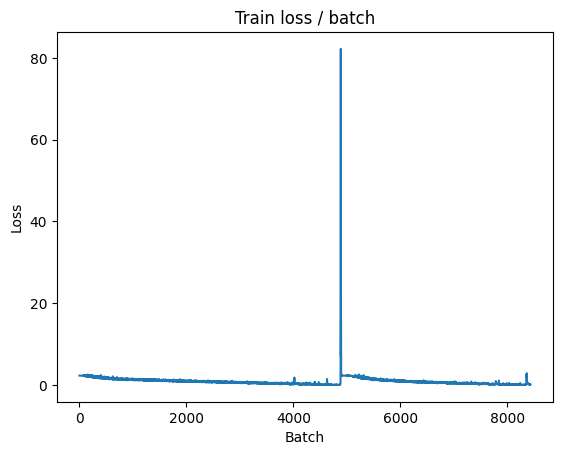


===============> Total time 9s	Avg loss 0.0984	Avg Prec@1 97.08 %	Avg Prec@5 99.98 %

[EVAL Batch 000/040]	Time 0.197s (0.197s)	Loss 3.0379 (3.0379)	Prec@1  56.2 ( 56.2)	Prec@5  92.6 ( 92.6)

===============> Total time 1s	Avg loss 3.0833	Avg Prec@1 52.64 %	Avg Prec@5 90.72 %



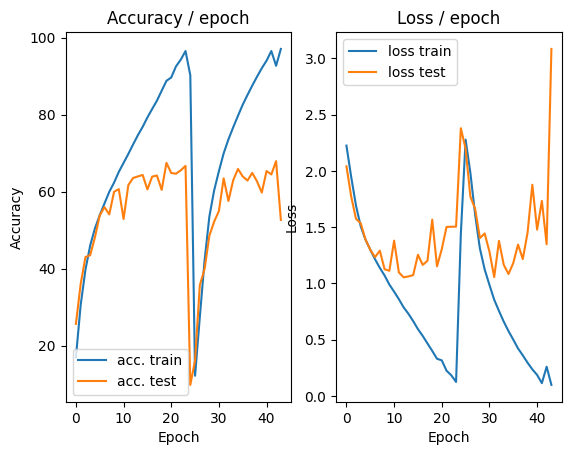

=== EPOCH 45 =====

[TRAIN Batch 000/196]	Time 0.213s (0.213s)	Loss 1.4946 (1.4946)	Prec@1  68.4 ( 68.4)	Prec@5  98.8 ( 98.8)


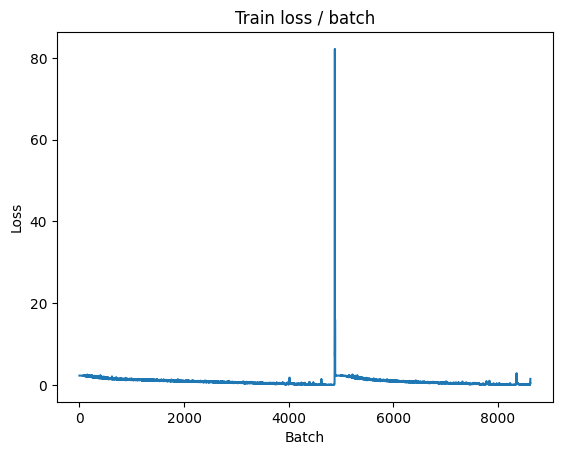


===============> Total time 9s	Avg loss 0.1933	Avg Prec@1 94.89 %	Avg Prec@5 99.68 %

[EVAL Batch 000/040]	Time 0.201s (0.201s)	Loss 1.6722 (1.6722)	Prec@1  66.4 ( 66.4)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.6216	Avg Prec@1 67.90 %	Avg Prec@5 96.53 %



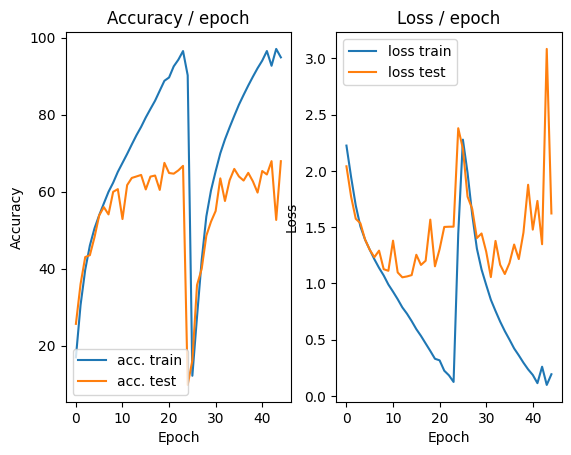

=== EPOCH 46 =====

[TRAIN Batch 000/196]	Time 0.221s (0.221s)	Loss 0.0953 (0.0953)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


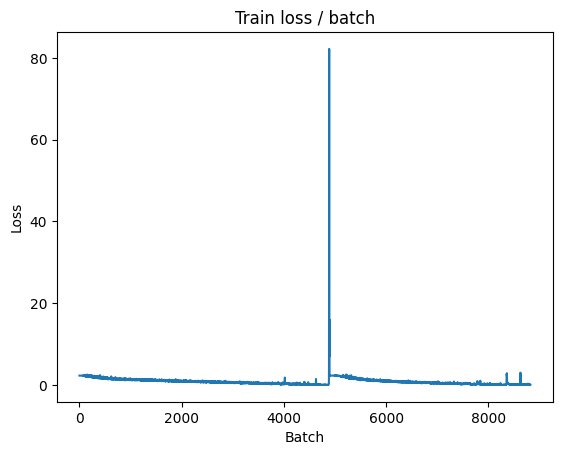


===============> Total time 9s	Avg loss 0.0267	Avg Prec@1 99.57 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.187s (0.187s)	Loss 1.9871 (1.9871)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.8656	Avg Prec@1 67.35 %	Avg Prec@5 96.59 %



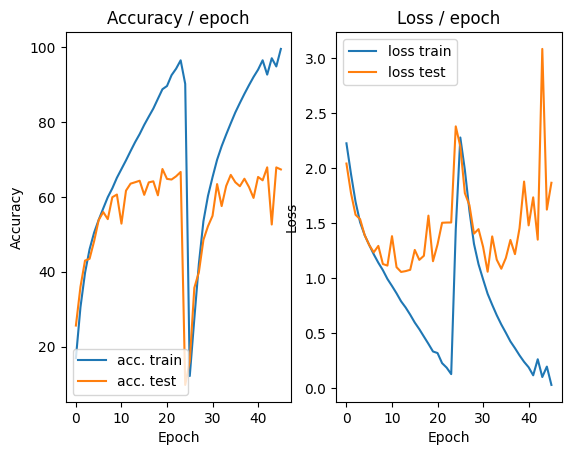

=== EPOCH 47 =====

[TRAIN Batch 000/196]	Time 0.231s (0.231s)	Loss 0.0664 (0.0664)	Prec@1  98.0 ( 98.0)	Prec@5 100.0 (100.0)


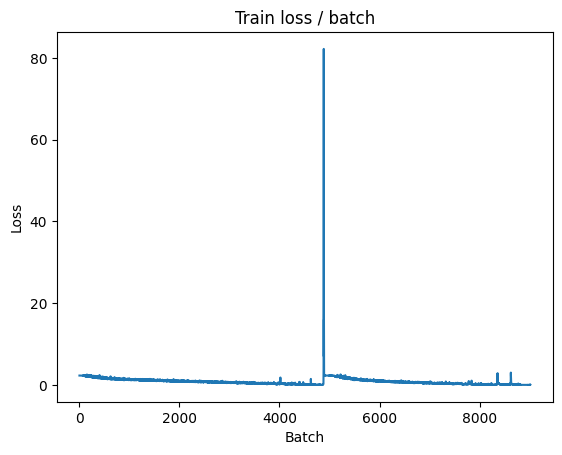


===============> Total time 8s	Avg loss 0.0123	Avg Prec@1 99.89 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.243s (0.243s)	Loss 1.9500 (1.9500)	Prec@1  67.6 ( 67.6)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.8210	Avg Prec@1 69.48 %	Avg Prec@5 96.63 %



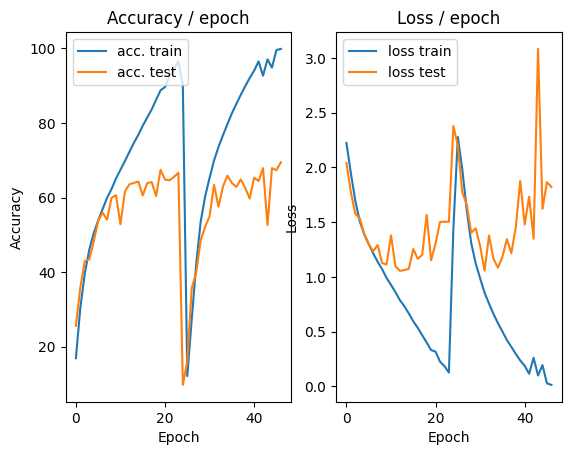

=== EPOCH 48 =====

[TRAIN Batch 000/196]	Time 0.262s (0.262s)	Loss 0.0052 (0.0052)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


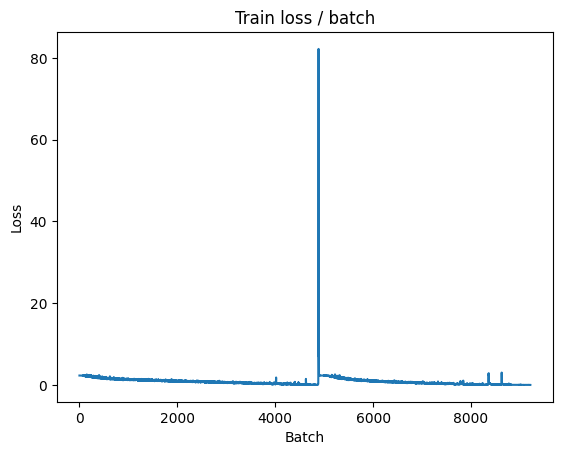


===============> Total time 8s	Avg loss 0.0056	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.189s (0.189s)	Loss 2.0555 (2.0555)	Prec@1  66.8 ( 66.8)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.9120	Avg Prec@1 69.79 %	Avg Prec@5 96.82 %



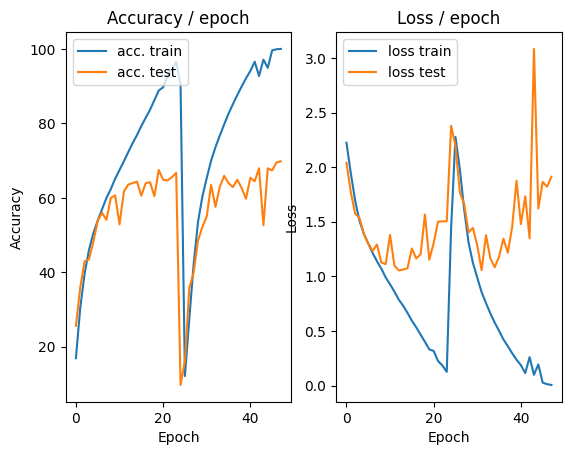

=== EPOCH 49 =====

[TRAIN Batch 000/196]	Time 0.262s (0.262s)	Loss 0.0032 (0.0032)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


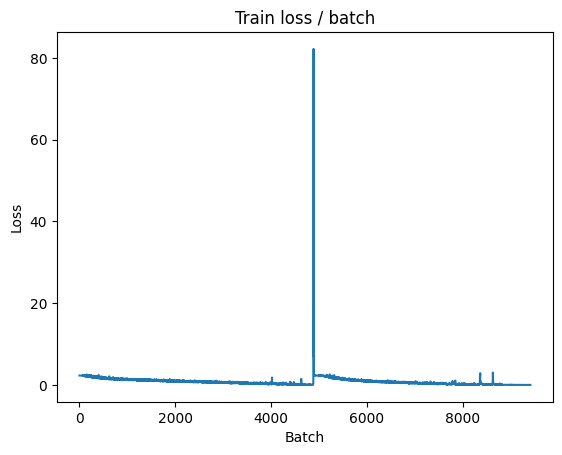


===============> Total time 8s	Avg loss 0.0035	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.183s (0.183s)	Loss 2.1093 (2.1093)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.9712	Avg Prec@1 70.05 %	Avg Prec@5 96.86 %



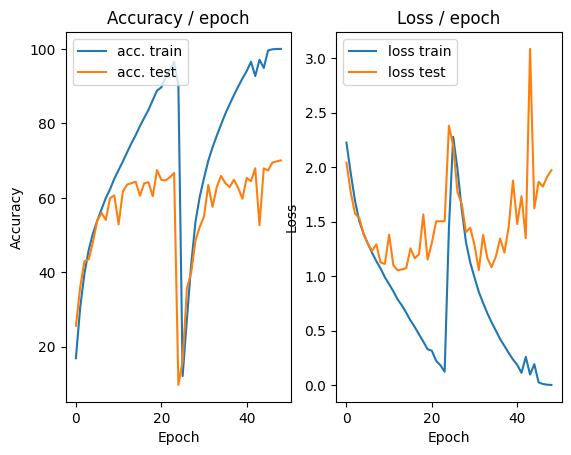

=== EPOCH 50 =====

[TRAIN Batch 000/196]	Time 0.242s (0.242s)	Loss 0.0020 (0.0020)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


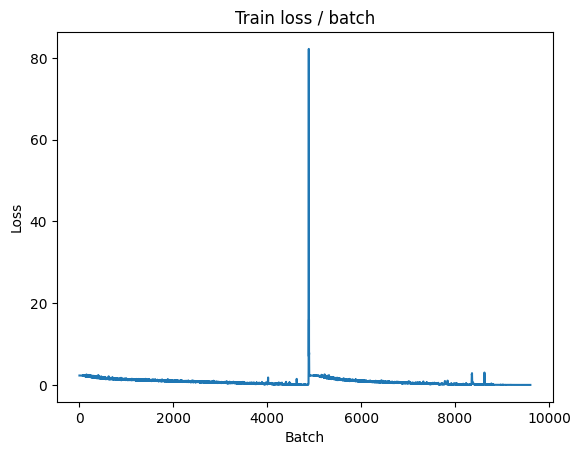


===============> Total time 9s	Avg loss 0.0027	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.196s (0.196s)	Loss 2.1759 (2.1759)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.0170	Avg Prec@1 69.93 %	Avg Prec@5 96.82 %



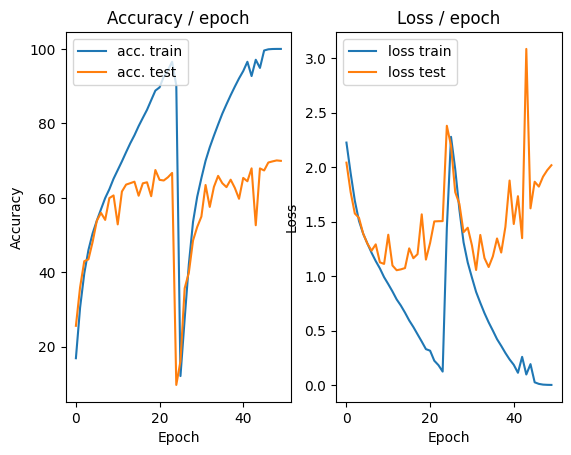

=== EPOCH 51 =====

[TRAIN Batch 000/196]	Time 0.268s (0.268s)	Loss 0.0022 (0.0022)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


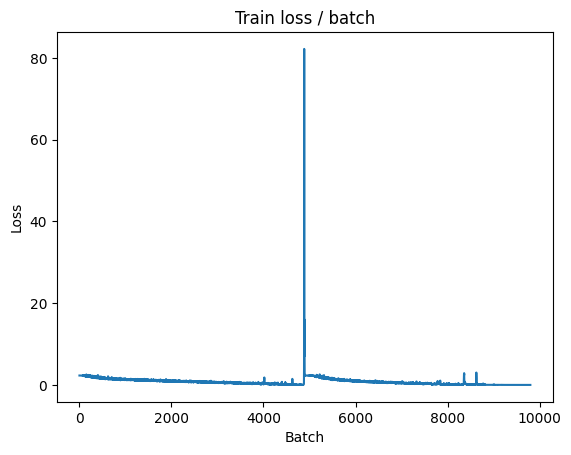


===============> Total time 9s	Avg loss 0.0021	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.208s (0.208s)	Loss 2.2385 (2.2385)	Prec@1  67.6 ( 67.6)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.0692	Avg Prec@1 70.09 %	Avg Prec@5 96.88 %



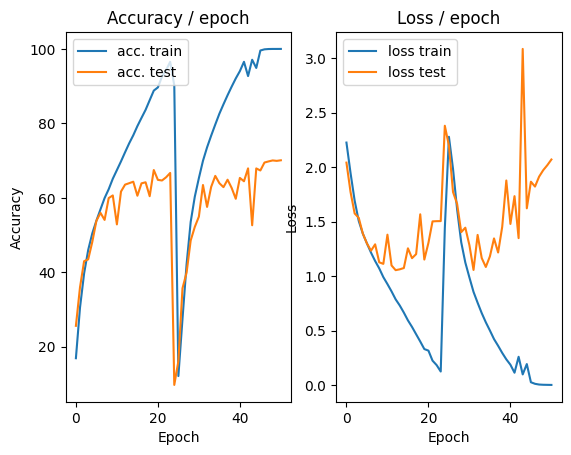

=== EPOCH 52 =====

[TRAIN Batch 000/196]	Time 0.253s (0.253s)	Loss 0.0015 (0.0015)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


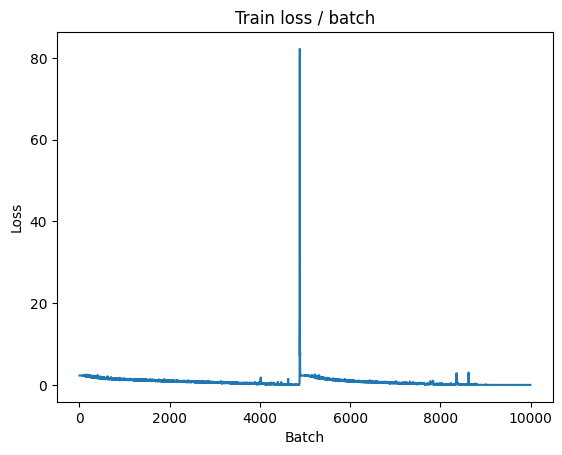


===============> Total time 9s	Avg loss 0.0018	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.199s (0.199s)	Loss 2.2721 (2.2721)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.1051	Avg Prec@1 70.06 %	Avg Prec@5 96.80 %



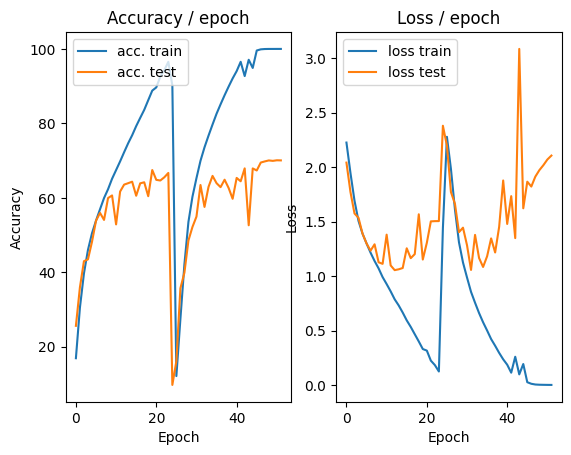

=== EPOCH 53 =====

[TRAIN Batch 000/196]	Time 0.267s (0.267s)	Loss 0.0016 (0.0016)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


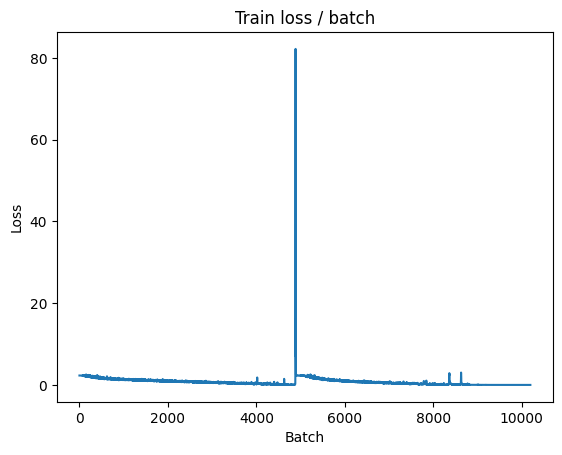


===============> Total time 9s	Avg loss 0.0015	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.195s (0.195s)	Loss 2.2923 (2.2923)	Prec@1  67.6 ( 67.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 2.1427	Avg Prec@1 70.04 %	Avg Prec@5 96.81 %



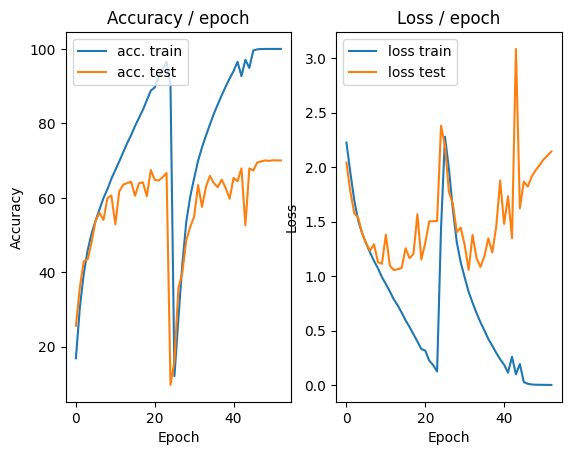

=== EPOCH 54 =====

[TRAIN Batch 000/196]	Time 0.280s (0.280s)	Loss 0.0049 (0.0049)	Prec@1  99.6 ( 99.6)	Prec@5 100.0 (100.0)


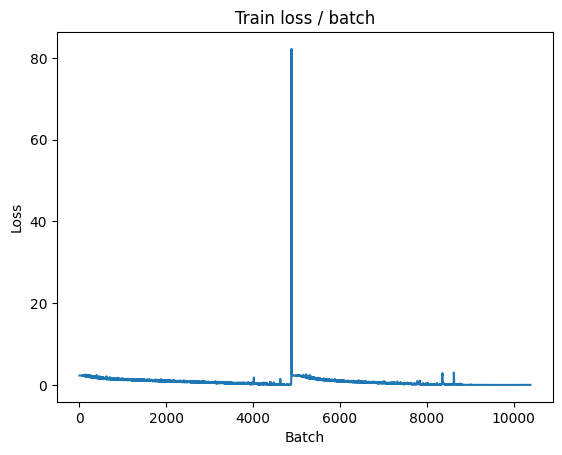


===============> Total time 8s	Avg loss 0.0014	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.216s (0.216s)	Loss 2.3421 (2.3421)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 2.1653	Avg Prec@1 70.04 %	Avg Prec@5 96.85 %



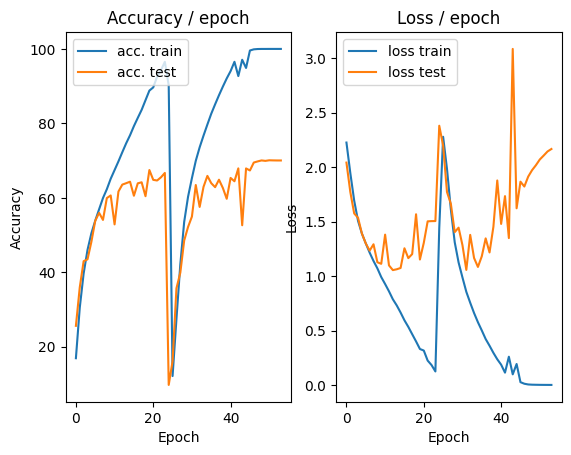

=== EPOCH 55 =====

[TRAIN Batch 000/196]	Time 0.251s (0.251s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


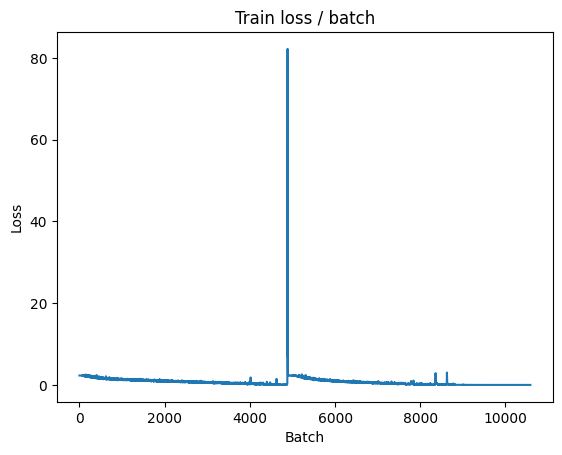


===============> Total time 7s	Avg loss 0.0012	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.190s (0.190s)	Loss 2.3720 (2.3720)	Prec@1  67.6 ( 67.6)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 2.1913	Avg Prec@1 70.03 %	Avg Prec@5 96.81 %



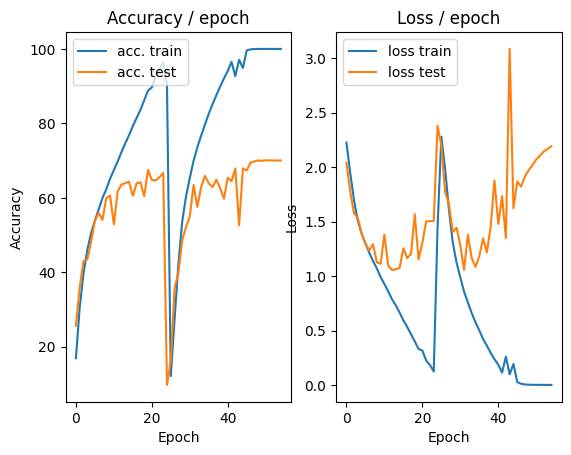

=== EPOCH 56 =====

[TRAIN Batch 000/196]	Time 0.208s (0.208s)	Loss 0.0011 (0.0011)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


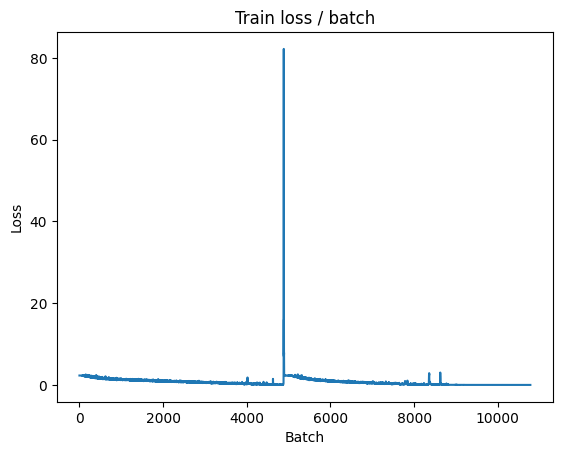


===============> Total time 8s	Avg loss 0.0011	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.206s (0.206s)	Loss 2.4008 (2.4008)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.2144	Avg Prec@1 70.08 %	Avg Prec@5 96.78 %



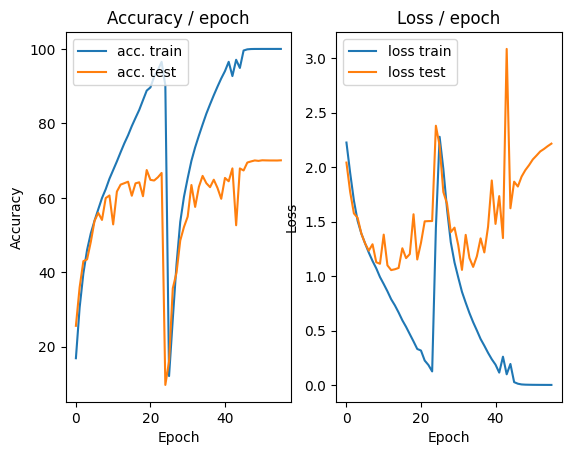

=== EPOCH 57 =====

[TRAIN Batch 000/196]	Time 0.313s (0.313s)	Loss 0.0008 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


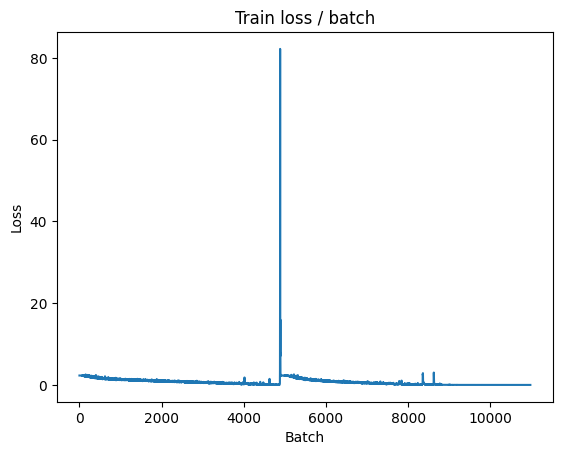


===============> Total time 8s	Avg loss 0.0011	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.185s (0.185s)	Loss 2.4207 (2.4207)	Prec@1  68.4 ( 68.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 2.2338	Avg Prec@1 69.73 %	Avg Prec@5 96.84 %



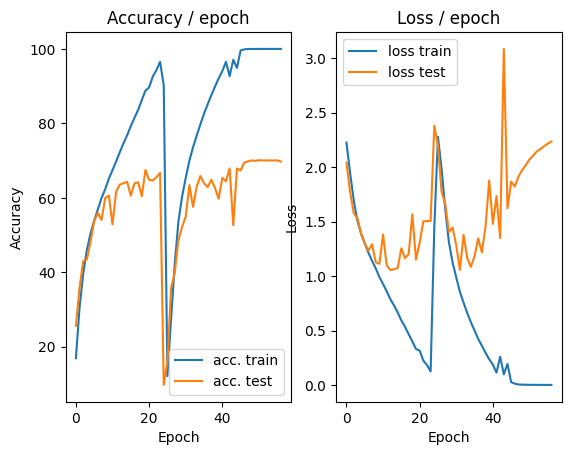

=== EPOCH 58 =====

[TRAIN Batch 000/196]	Time 0.278s (0.278s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


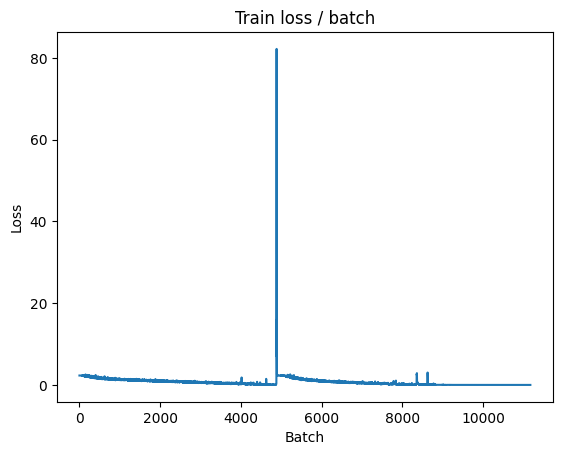


===============> Total time 9s	Avg loss 0.0009	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.185s (0.185s)	Loss 2.4433 (2.4433)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.2552	Avg Prec@1 69.83 %	Avg Prec@5 96.84 %



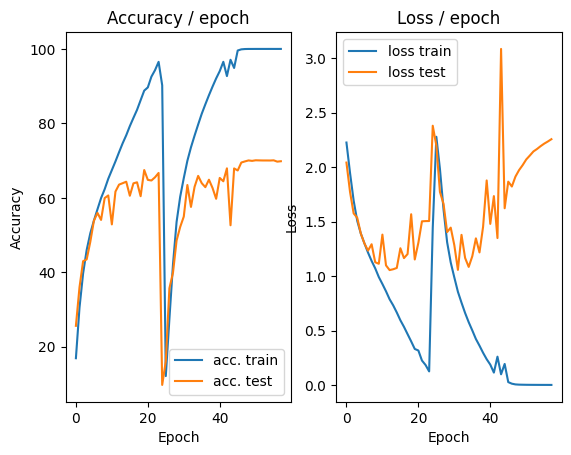

=== EPOCH 59 =====

[TRAIN Batch 000/196]	Time 0.285s (0.285s)	Loss 0.0009 (0.0009)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


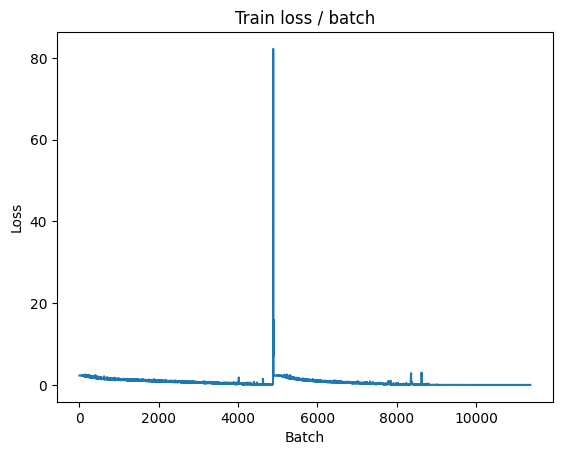


===============> Total time 9s	Avg loss 0.0008	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.177s (0.177s)	Loss 2.4608 (2.4608)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.2755	Avg Prec@1 69.89 %	Avg Prec@5 96.81 %



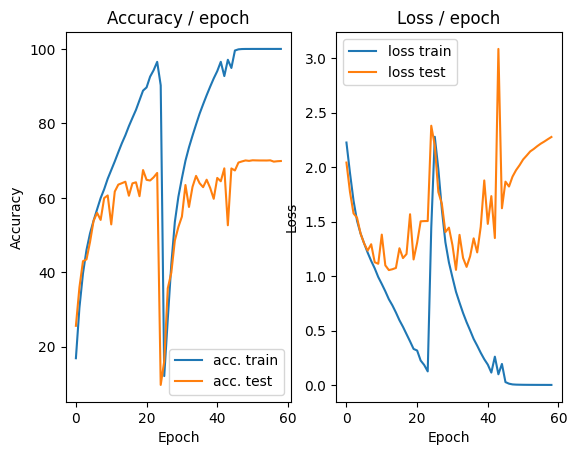

=== EPOCH 60 =====

[TRAIN Batch 000/196]	Time 0.258s (0.258s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


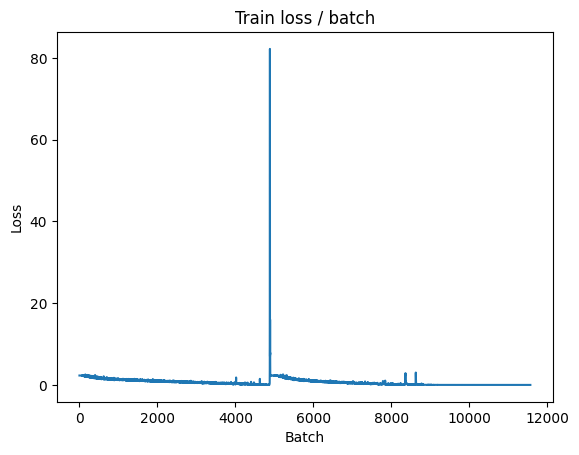


===============> Total time 9s	Avg loss 0.0008	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.195s (0.195s)	Loss 2.4852 (2.4852)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.2889	Avg Prec@1 70.03 %	Avg Prec@5 96.80 %



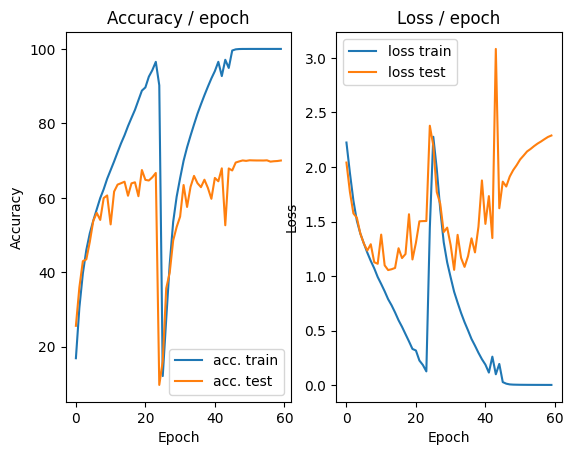

=== EPOCH 61 =====

[TRAIN Batch 000/196]	Time 0.272s (0.272s)	Loss 0.0008 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


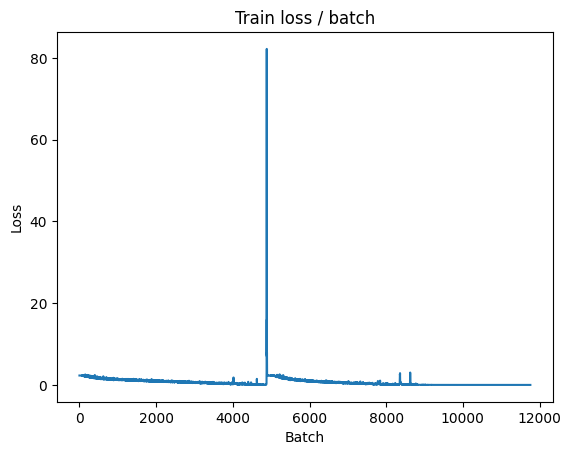


===============> Total time 9s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.196s (0.196s)	Loss 2.5018 (2.5018)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.3072	Avg Prec@1 69.90 %	Avg Prec@5 96.82 %



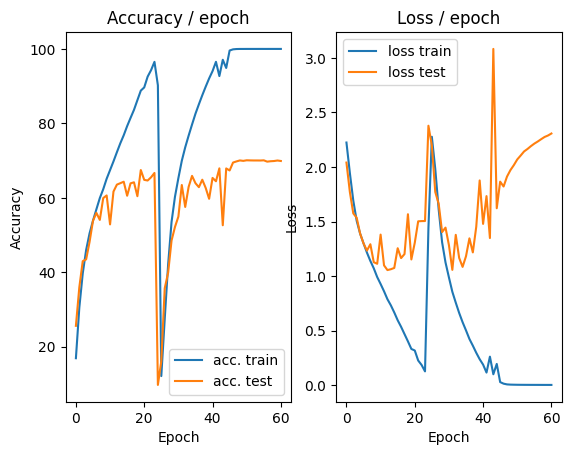

=== EPOCH 62 =====

[TRAIN Batch 000/196]	Time 0.252s (0.252s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


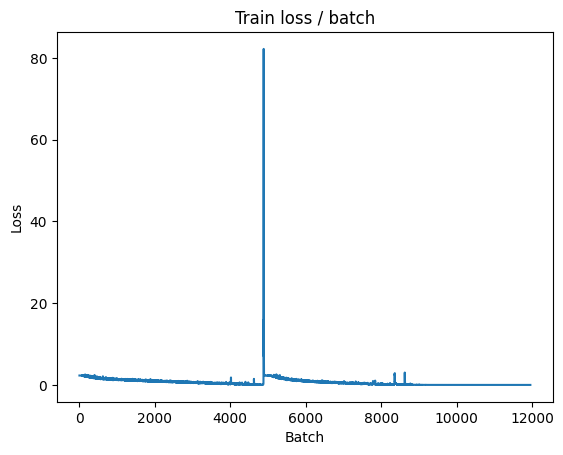


===============> Total time 9s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.186s (0.186s)	Loss 2.5148 (2.5148)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.3242	Avg Prec@1 69.70 %	Avg Prec@5 96.82 %



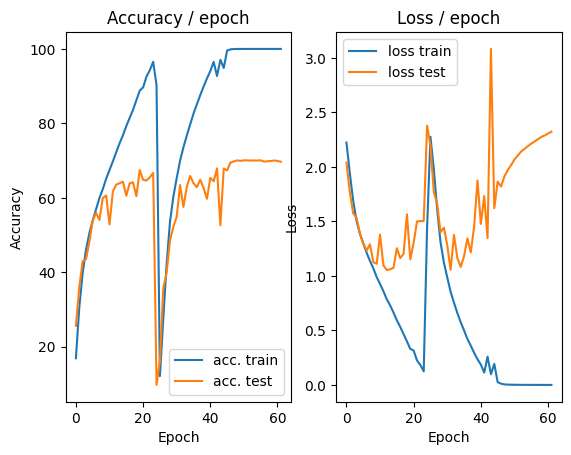

=== EPOCH 63 =====

[TRAIN Batch 000/196]	Time 0.282s (0.282s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


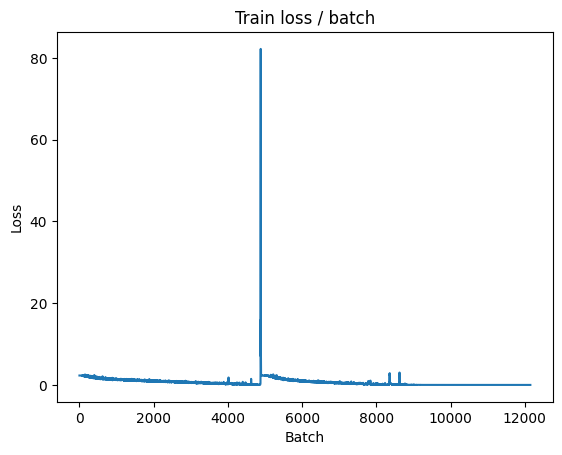


===============> Total time 8s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.303s (0.303s)	Loss 2.5442 (2.5442)	Prec@1  68.8 ( 68.8)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 2.3394	Avg Prec@1 69.92 %	Avg Prec@5 96.80 %



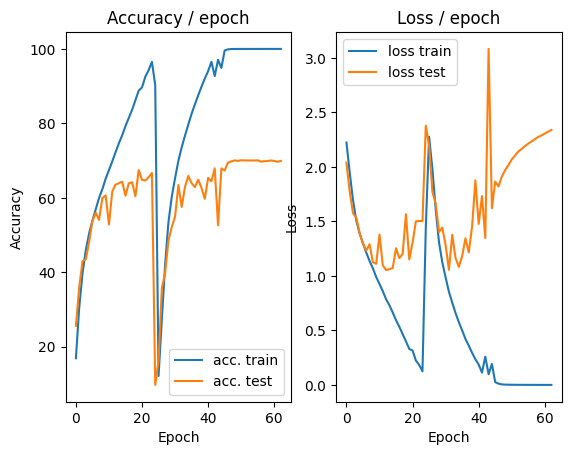

=== EPOCH 64 =====

[TRAIN Batch 000/196]	Time 0.751s (0.751s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


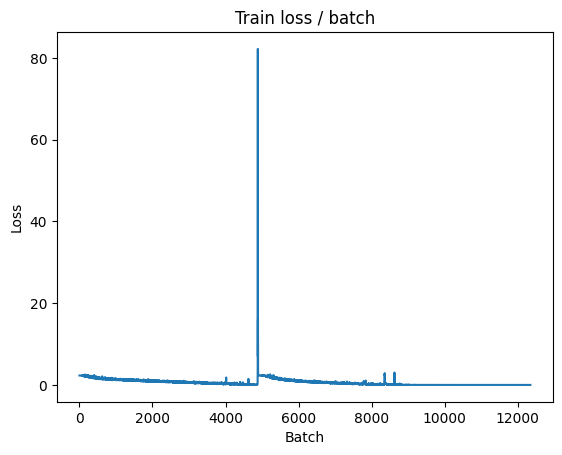


===============> Total time 8s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.206s (0.206s)	Loss 2.5544 (2.5544)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.3546	Avg Prec@1 69.86 %	Avg Prec@5 96.79 %



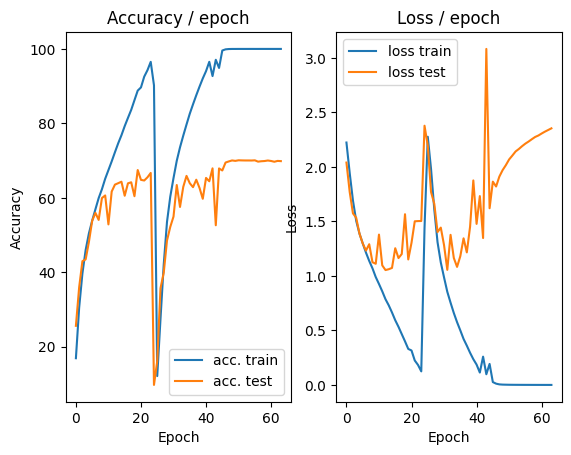

=== EPOCH 65 =====

[TRAIN Batch 000/196]	Time 0.337s (0.337s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


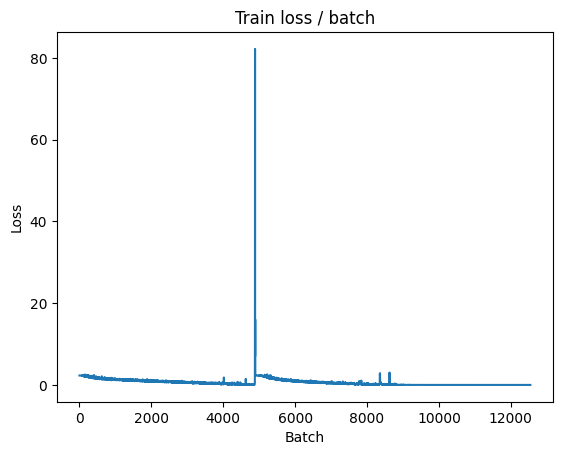


===============> Total time 8s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.188s (0.188s)	Loss 2.5712 (2.5712)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.3657	Avg Prec@1 70.05 %	Avg Prec@5 96.77 %



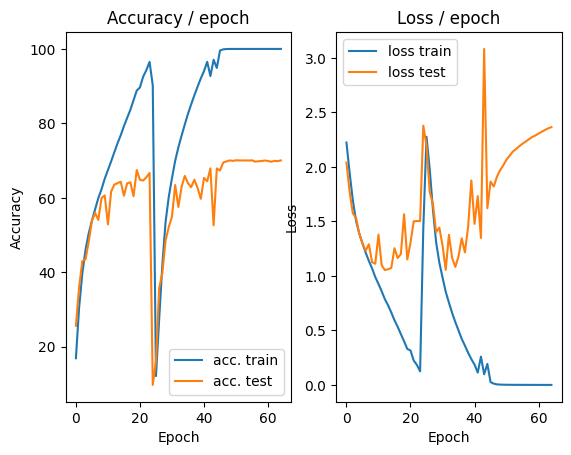

=== EPOCH 66 =====

[TRAIN Batch 000/196]	Time 0.275s (0.275s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


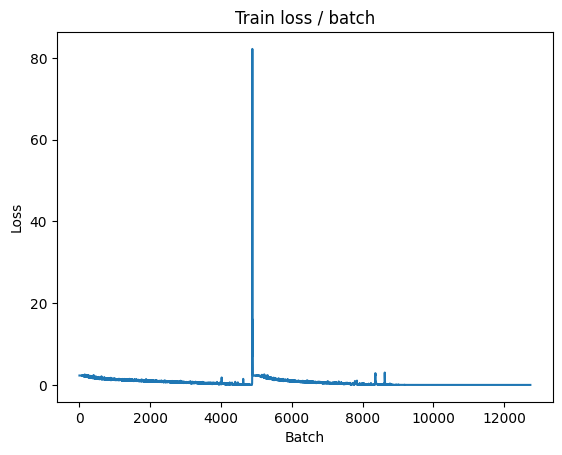


===============> Total time 9s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.196s (0.196s)	Loss 2.5909 (2.5909)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.3785	Avg Prec@1 69.95 %	Avg Prec@5 96.78 %



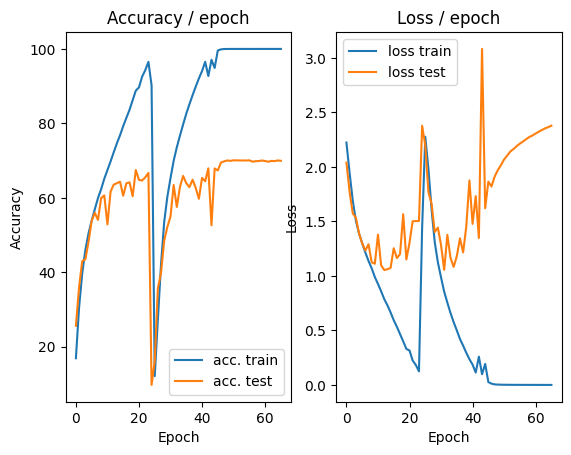

=== EPOCH 67 =====

[TRAIN Batch 000/196]	Time 0.295s (0.295s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


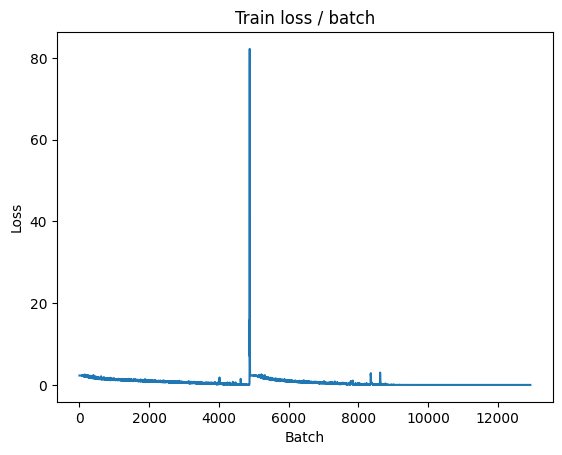


===============> Total time 9s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.185s (0.185s)	Loss 2.6016 (2.6016)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.3906	Avg Prec@1 69.76 %	Avg Prec@5 96.81 %



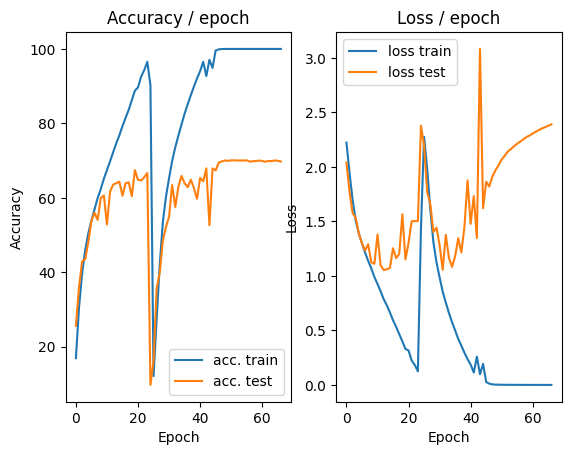

=== EPOCH 68 =====

[TRAIN Batch 000/196]	Time 0.260s (0.260s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


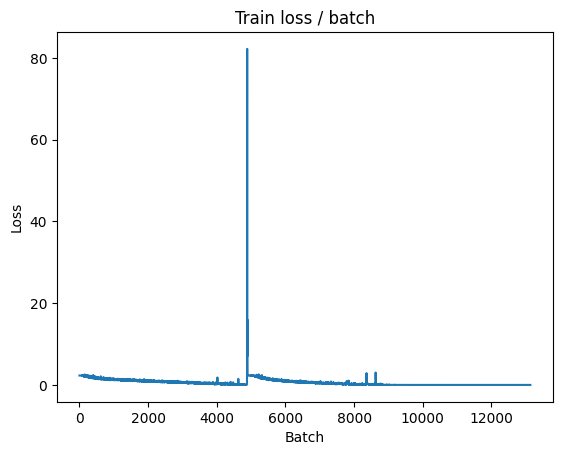


===============> Total time 9s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.191s (0.191s)	Loss 2.6137 (2.6137)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.4032	Avg Prec@1 69.78 %	Avg Prec@5 96.81 %



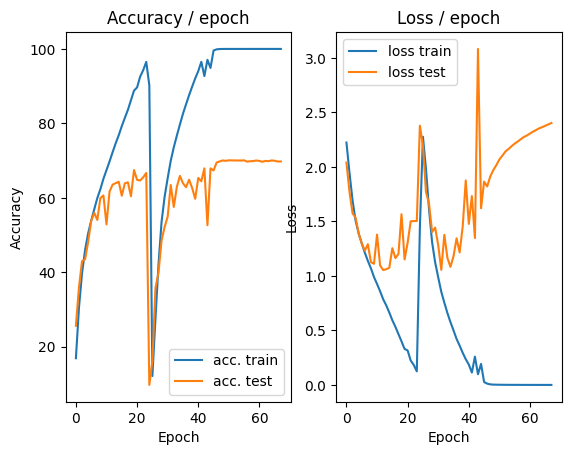

=== EPOCH 69 =====

[TRAIN Batch 000/196]	Time 0.264s (0.264s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


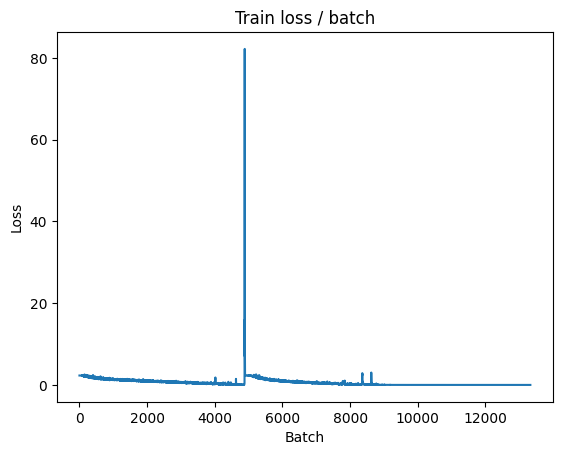


===============> Total time 9s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.207s (0.207s)	Loss 2.6266 (2.6266)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.4142	Avg Prec@1 69.85 %	Avg Prec@5 96.79 %



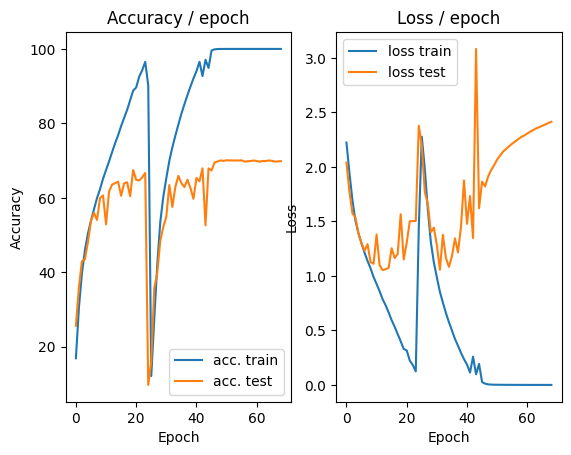

=== EPOCH 70 =====

[TRAIN Batch 000/196]	Time 0.241s (0.241s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


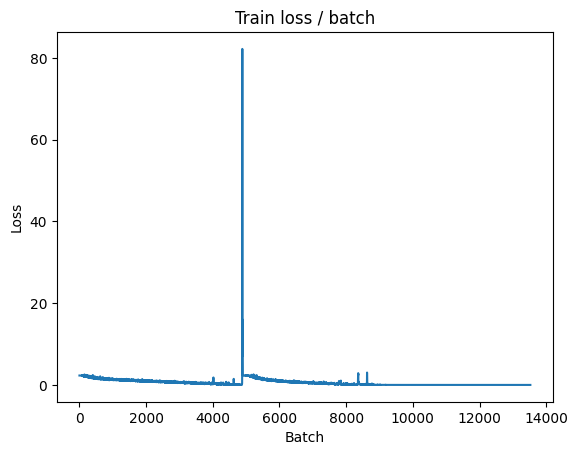


===============> Total time 9s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.187s (0.187s)	Loss 2.6346 (2.6346)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.4259	Avg Prec@1 69.78 %	Avg Prec@5 96.77 %



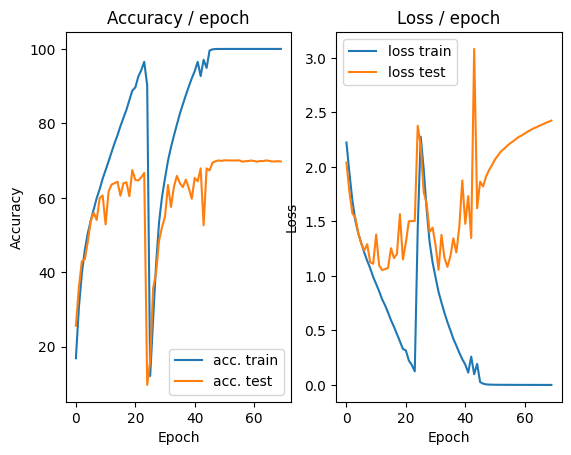

=== EPOCH 71 =====

[TRAIN Batch 000/196]	Time 0.265s (0.265s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


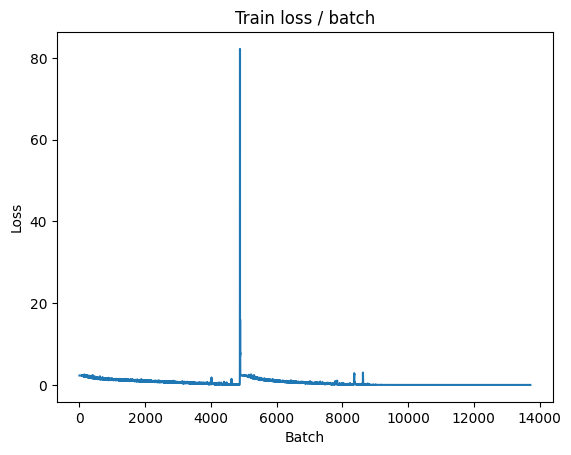


===============> Total time 8s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.304s (0.304s)	Loss 2.6512 (2.6512)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 2.4367	Avg Prec@1 69.66 %	Avg Prec@5 96.81 %



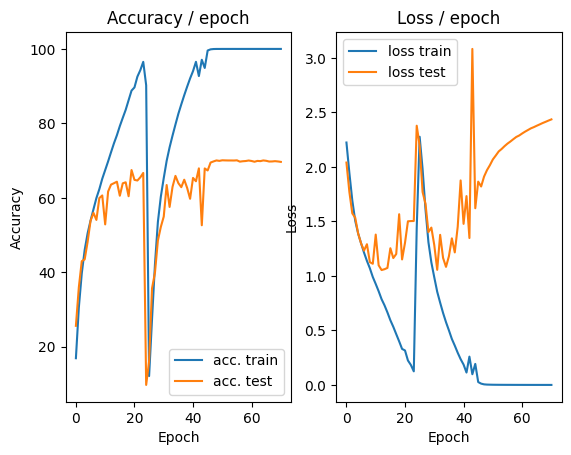

=== EPOCH 72 =====

[TRAIN Batch 000/196]	Time 0.311s (0.311s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


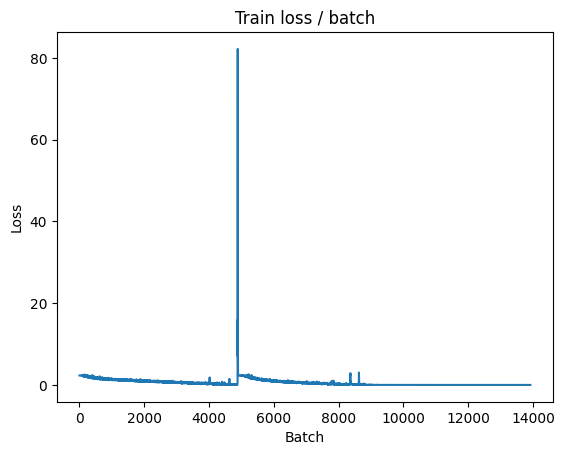


===============> Total time 8s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.187s (0.187s)	Loss 2.6584 (2.6584)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 2.4465	Avg Prec@1 69.72 %	Avg Prec@5 96.80 %



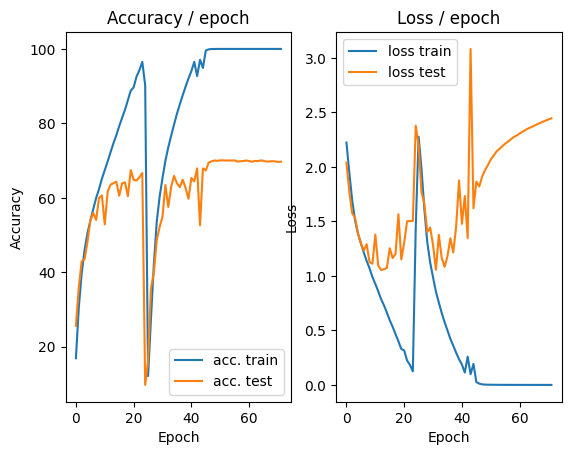

=== EPOCH 73 =====

[TRAIN Batch 000/196]	Time 0.284s (0.284s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


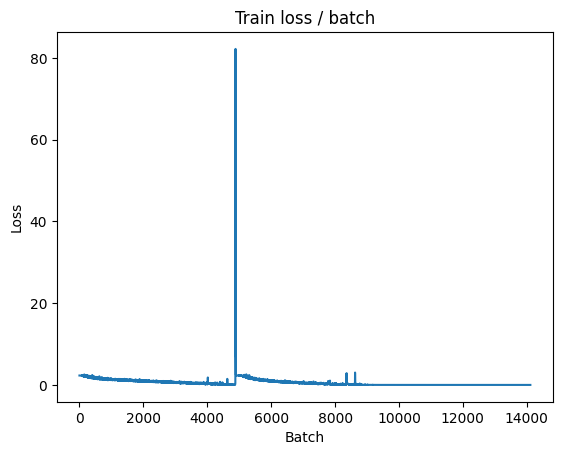


===============> Total time 8s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.197s (0.197s)	Loss 2.6774 (2.6774)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.4562	Avg Prec@1 69.74 %	Avg Prec@5 96.79 %



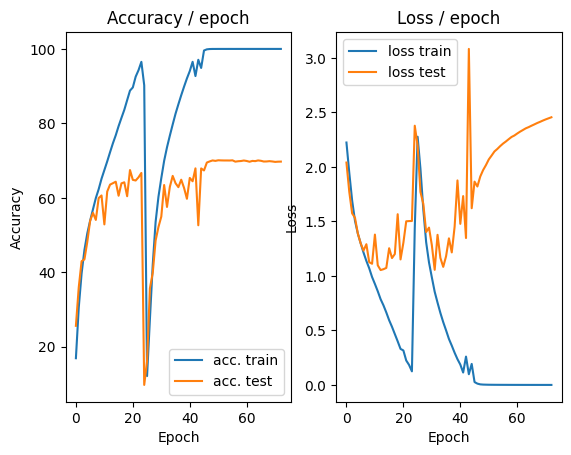

=== EPOCH 74 =====

[TRAIN Batch 000/196]	Time 0.255s (0.255s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


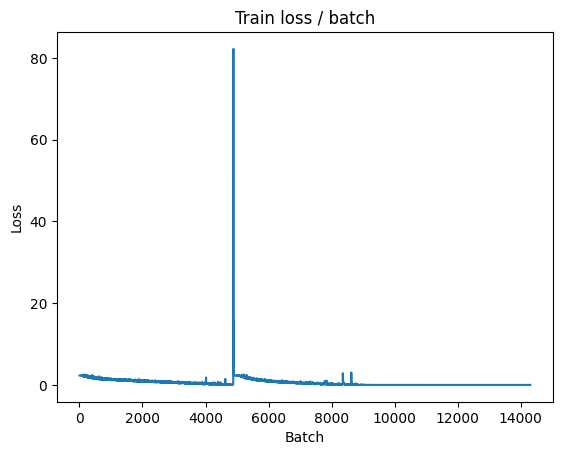


===============> Total time 8s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.182s (0.182s)	Loss 2.6832 (2.6832)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.4675	Avg Prec@1 69.81 %	Avg Prec@5 96.81 %



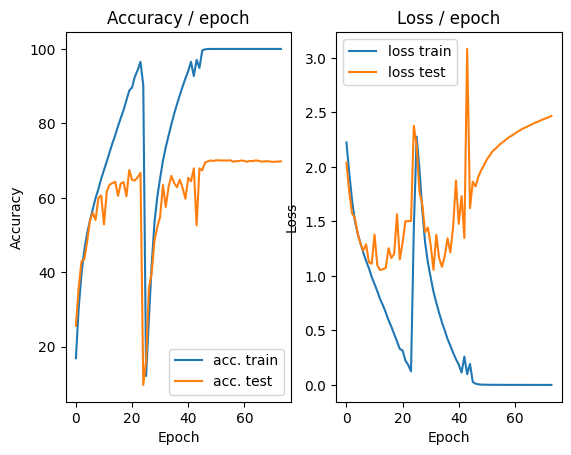

=== EPOCH 75 =====

[TRAIN Batch 000/196]	Time 0.227s (0.227s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


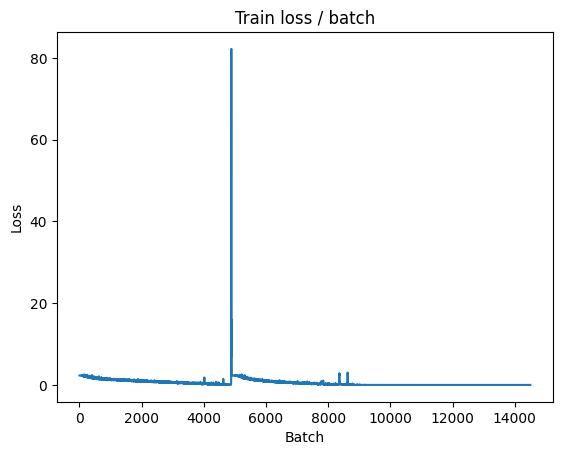


===============> Total time 9s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.199s (0.199s)	Loss 2.6927 (2.6927)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.4747	Avg Prec@1 69.74 %	Avg Prec@5 96.80 %



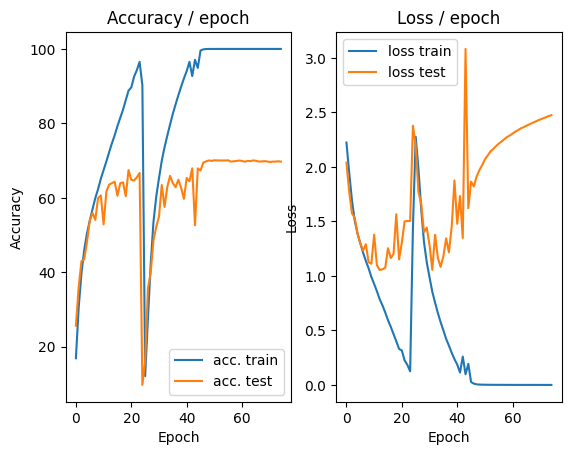

=== EPOCH 76 =====

[TRAIN Batch 000/196]	Time 0.284s (0.284s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


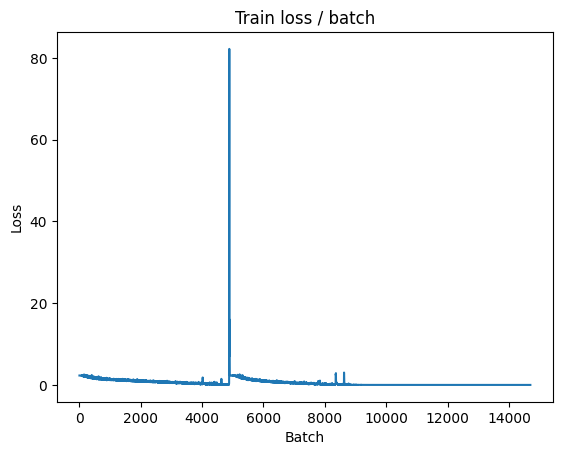


===============> Total time 9s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.214s (0.214s)	Loss 2.7045 (2.7045)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.4848	Avg Prec@1 69.79 %	Avg Prec@5 96.80 %



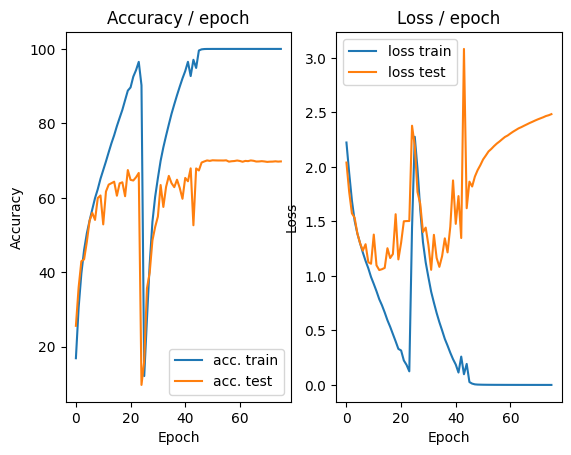

=== EPOCH 77 =====

[TRAIN Batch 000/196]	Time 0.295s (0.295s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


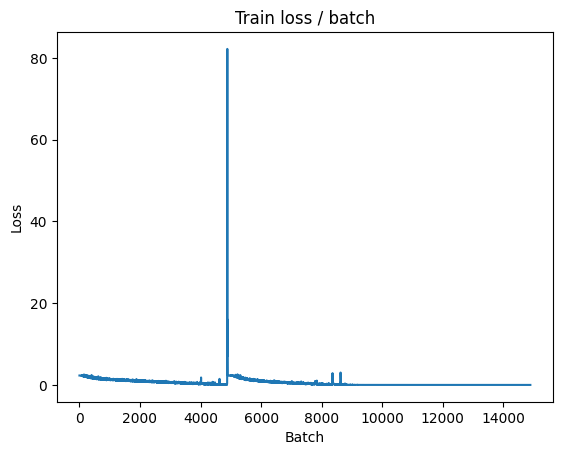


===============> Total time 9s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.205s (0.205s)	Loss 2.7135 (2.7135)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.4937	Avg Prec@1 69.71 %	Avg Prec@5 96.81 %



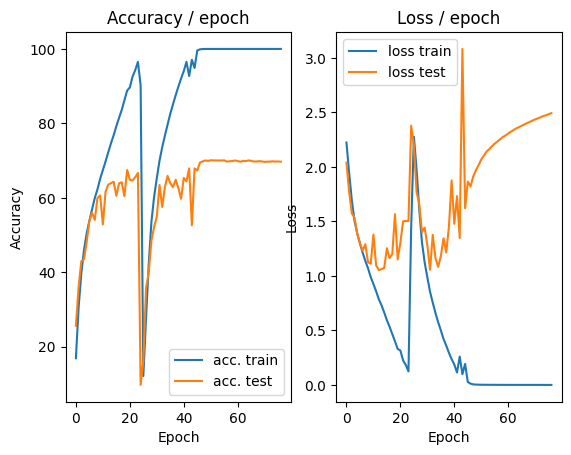

=== EPOCH 78 =====

[TRAIN Batch 000/196]	Time 0.233s (0.233s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


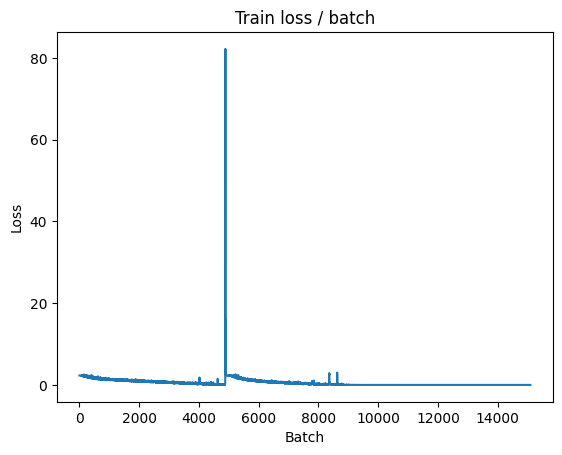


===============> Total time 9s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.184s (0.184s)	Loss 2.7218 (2.7218)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5000	Avg Prec@1 69.72 %	Avg Prec@5 96.83 %



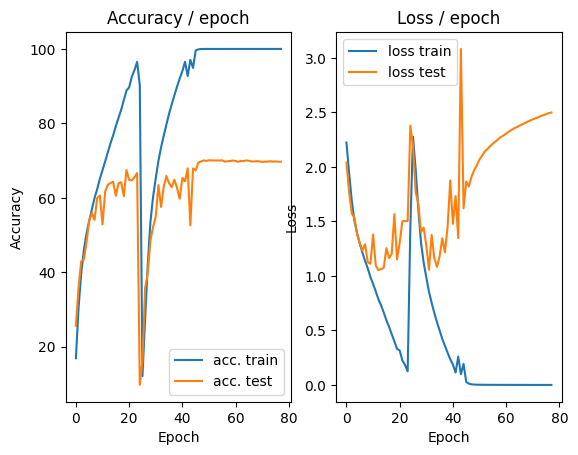

=== EPOCH 79 =====

[TRAIN Batch 000/196]	Time 0.276s (0.276s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


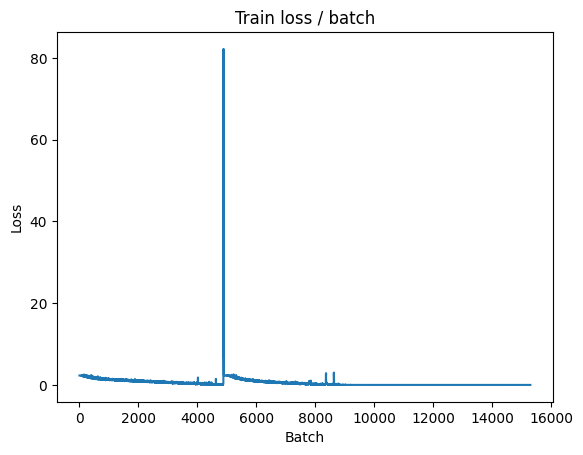


===============> Total time 8s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.266s (0.266s)	Loss 2.7295 (2.7295)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 2.5084	Avg Prec@1 69.67 %	Avg Prec@5 96.81 %



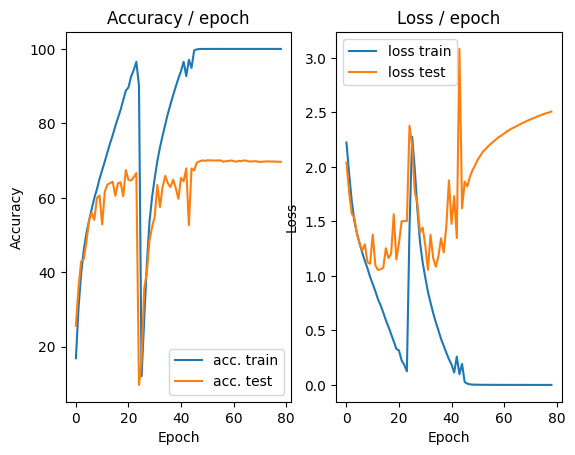

=== EPOCH 80 =====

[TRAIN Batch 000/196]	Time 0.283s (0.283s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


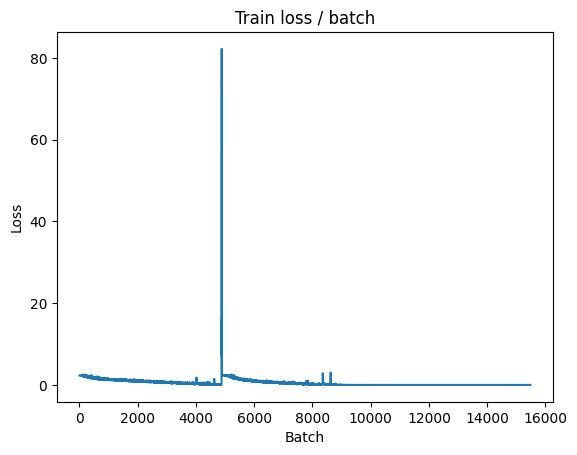


===============> Total time 8s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.181s (0.181s)	Loss 2.7412 (2.7412)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 2.5163	Avg Prec@1 69.71 %	Avg Prec@5 96.81 %



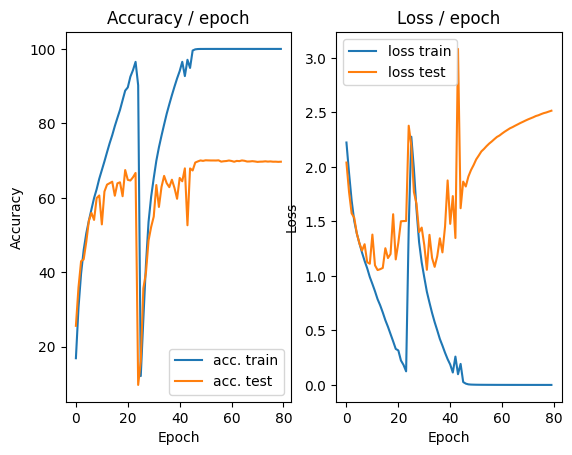

=== EPOCH 81 =====

[TRAIN Batch 000/196]	Time 0.350s (0.350s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


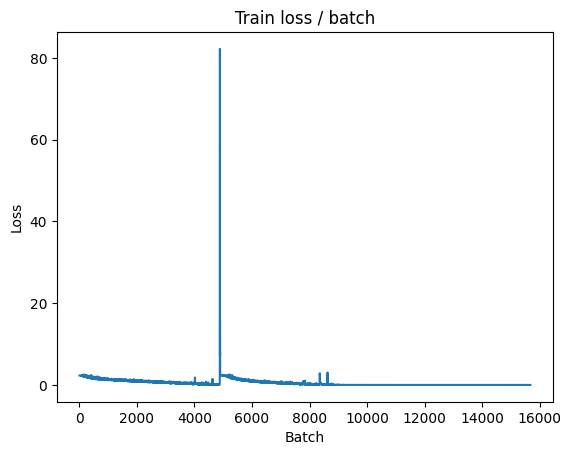


===============> Total time 8s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.203s (0.203s)	Loss 2.7525 (2.7525)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5249	Avg Prec@1 69.74 %	Avg Prec@5 96.82 %



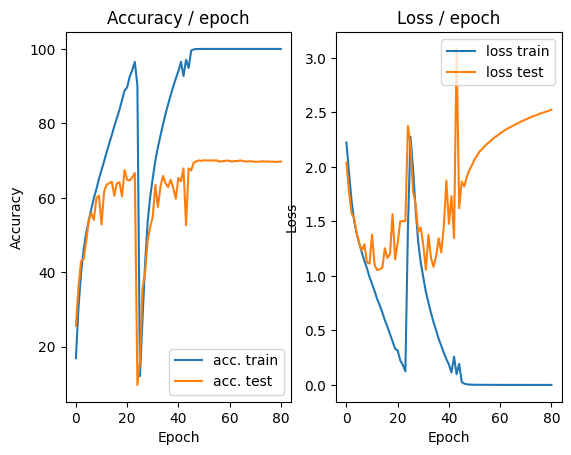

=== EPOCH 82 =====

[TRAIN Batch 000/196]	Time 0.298s (0.298s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


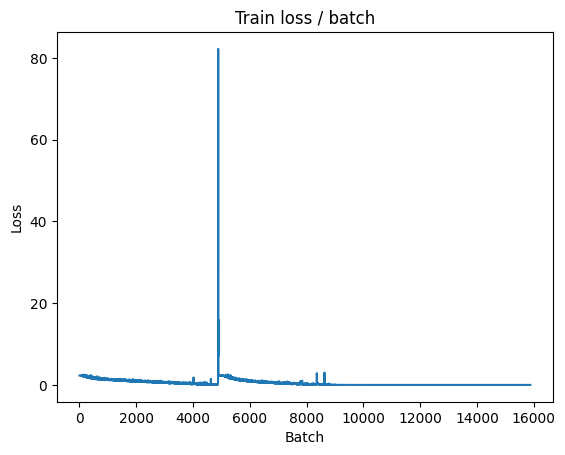


===============> Total time 9s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.199s (0.199s)	Loss 2.7607 (2.7607)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5332	Avg Prec@1 69.77 %	Avg Prec@5 96.82 %



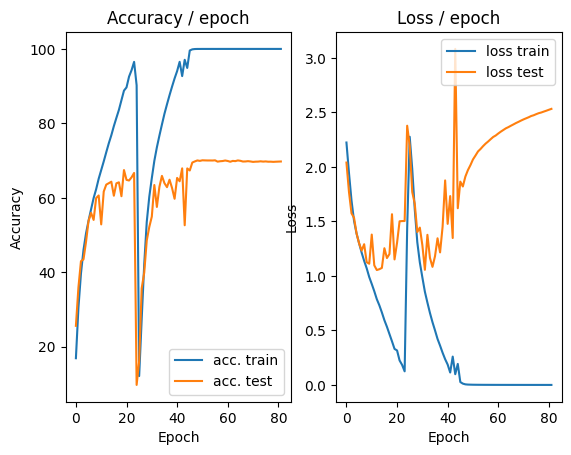

=== EPOCH 83 =====

[TRAIN Batch 000/196]	Time 0.263s (0.263s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


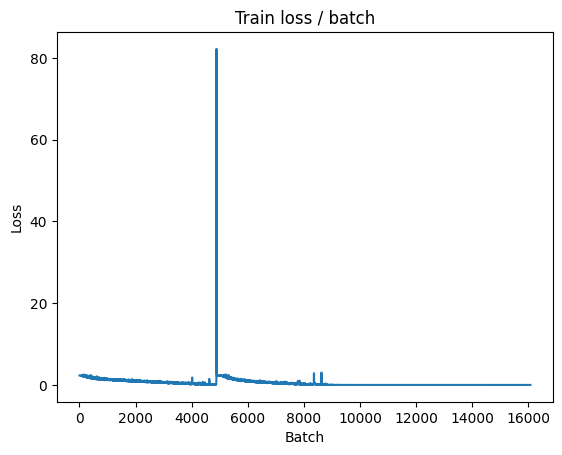


===============> Total time 9s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.210s (0.210s)	Loss 2.7657 (2.7657)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5410	Avg Prec@1 69.78 %	Avg Prec@5 96.80 %



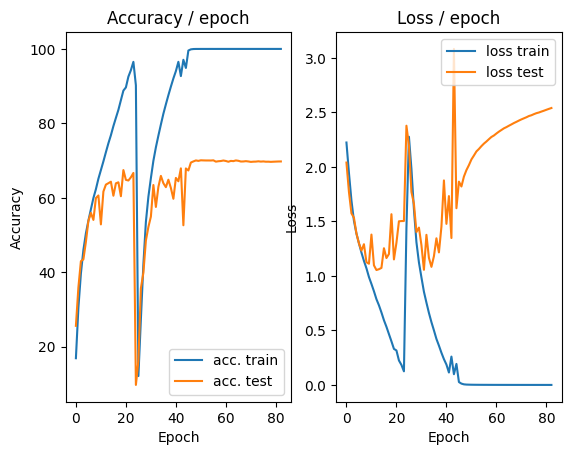

=== EPOCH 84 =====

[TRAIN Batch 000/196]	Time 0.283s (0.283s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


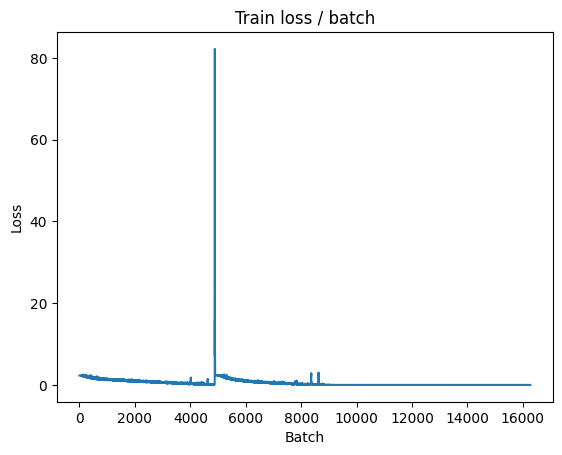


===============> Total time 9s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.194s (0.194s)	Loss 2.7790 (2.7790)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5490	Avg Prec@1 69.80 %	Avg Prec@5 96.79 %



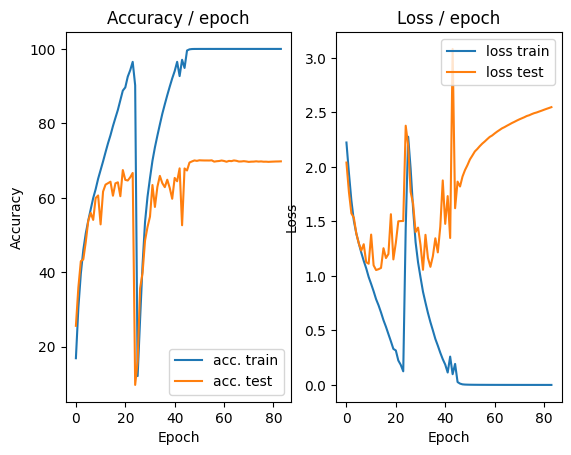

=== EPOCH 85 =====

[TRAIN Batch 000/196]	Time 0.270s (0.270s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


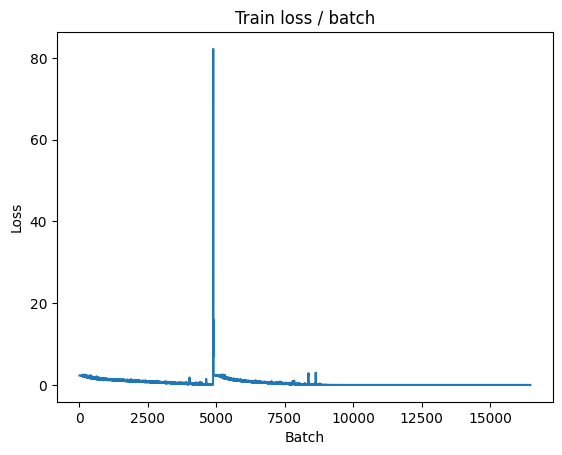


===============> Total time 9s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.188s (0.188s)	Loss 2.7831 (2.7831)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5550	Avg Prec@1 69.66 %	Avg Prec@5 96.84 %



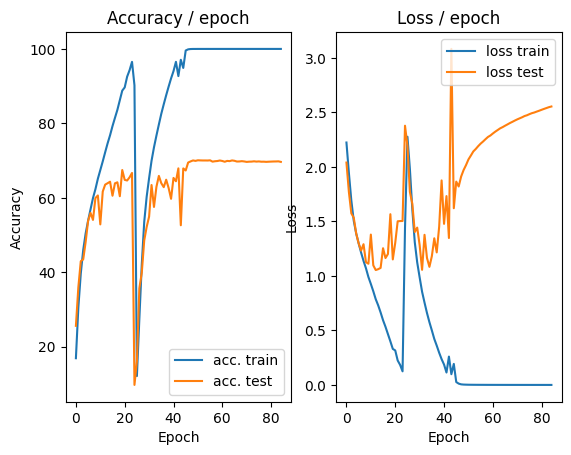

=== EPOCH 86 =====

[TRAIN Batch 000/196]	Time 0.291s (0.291s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


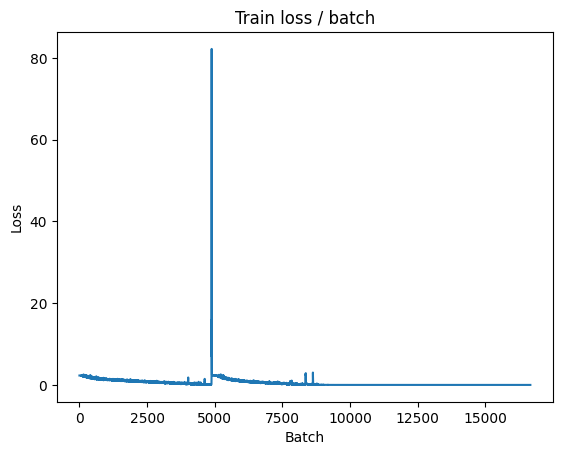


===============> Total time 9s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.189s (0.189s)	Loss 2.7894 (2.7894)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5605	Avg Prec@1 69.74 %	Avg Prec@5 96.80 %



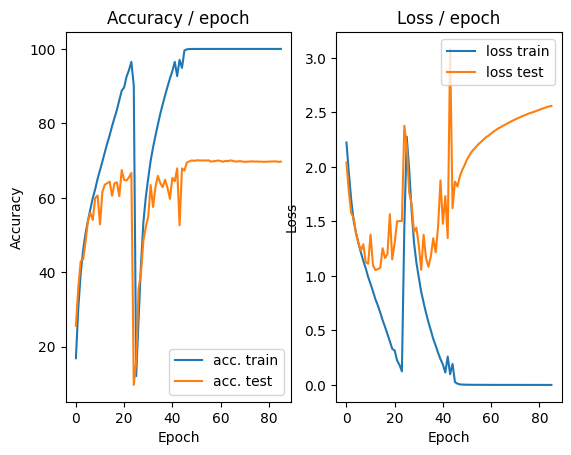

=== EPOCH 87 =====

[TRAIN Batch 000/196]	Time 0.304s (0.304s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


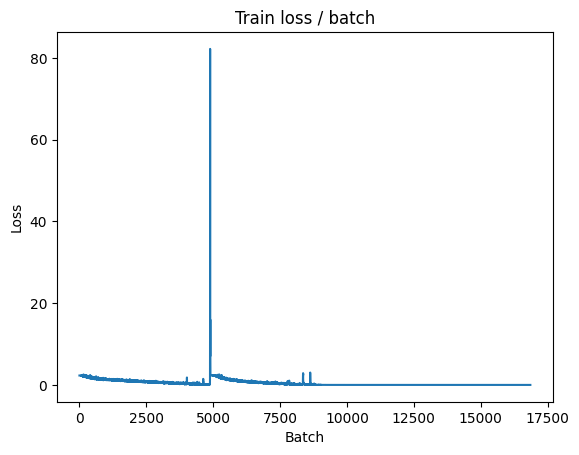


===============> Total time 8s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.323s (0.323s)	Loss 2.7997 (2.7997)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5672	Avg Prec@1 69.79 %	Avg Prec@5 96.80 %



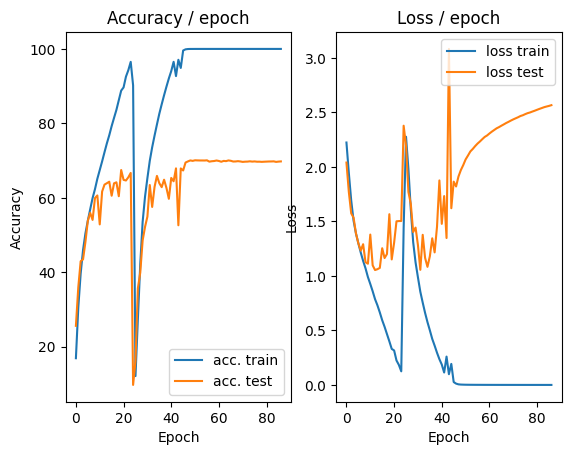

=== EPOCH 88 =====

[TRAIN Batch 000/196]	Time 0.296s (0.296s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


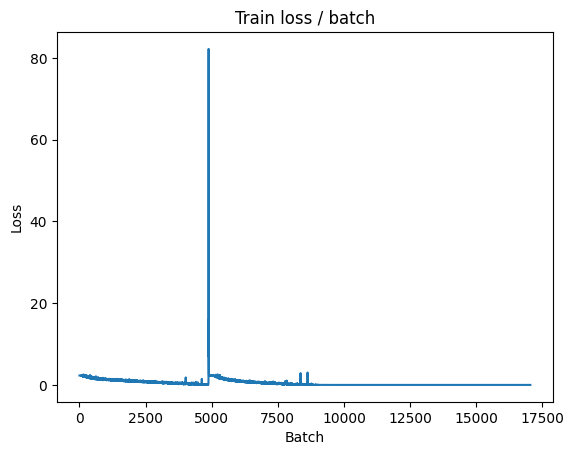


===============> Total time 9s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.276s (0.276s)	Loss 2.8051 (2.8051)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 2.5739	Avg Prec@1 69.73 %	Avg Prec@5 96.81 %



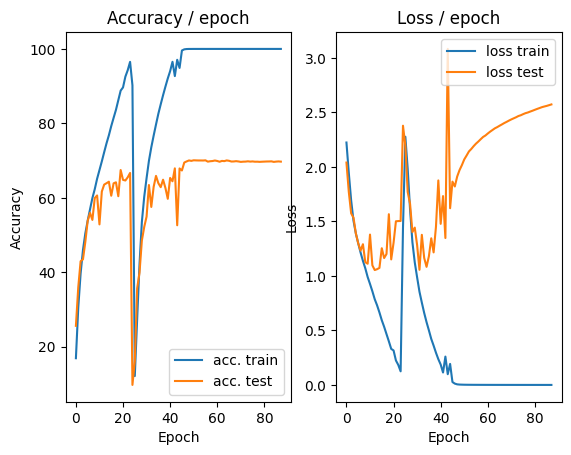

=== EPOCH 89 =====

[TRAIN Batch 000/196]	Time 0.320s (0.320s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


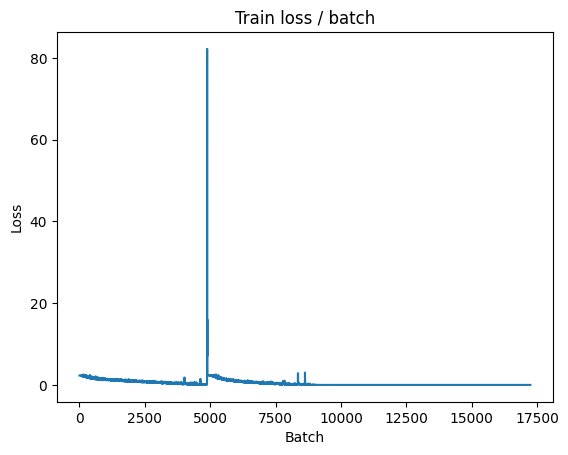


===============> Total time 8s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.220s (0.220s)	Loss 2.8140 (2.8140)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 2.5803	Avg Prec@1 69.73 %	Avg Prec@5 96.79 %



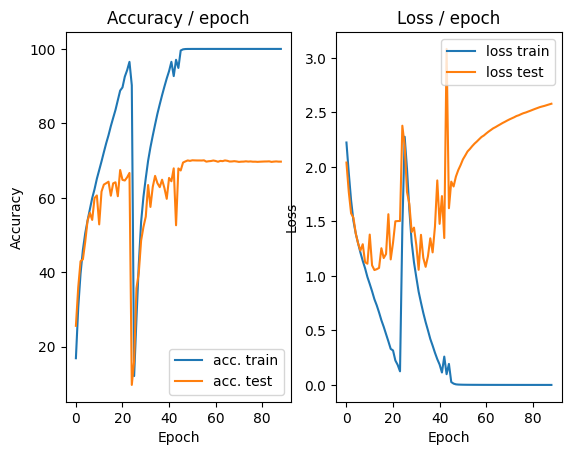

=== EPOCH 90 =====

[TRAIN Batch 000/196]	Time 0.259s (0.259s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


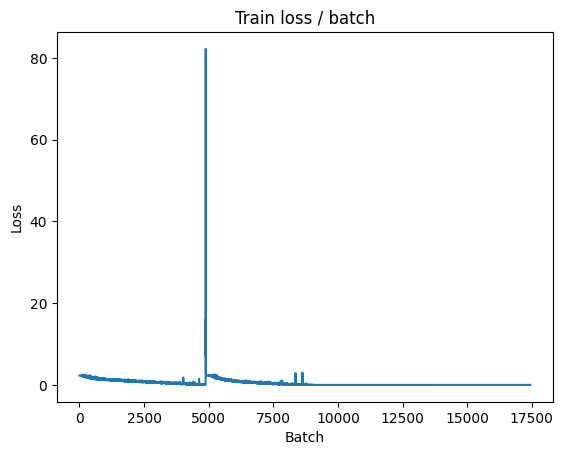


===============> Total time 8s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.193s (0.193s)	Loss 2.8210 (2.8210)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5867	Avg Prec@1 69.78 %	Avg Prec@5 96.79 %



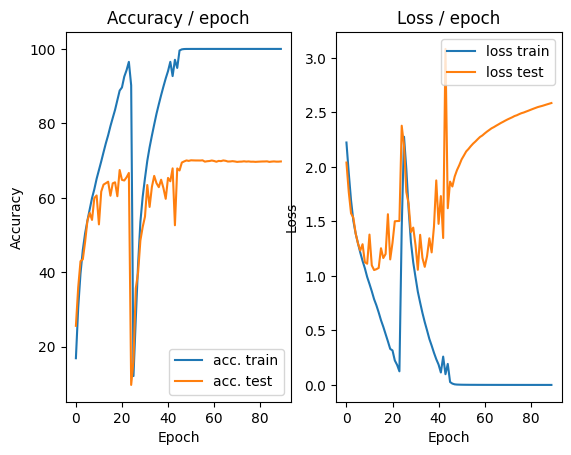

=== EPOCH 91 =====

[TRAIN Batch 000/196]	Time 0.316s (0.316s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


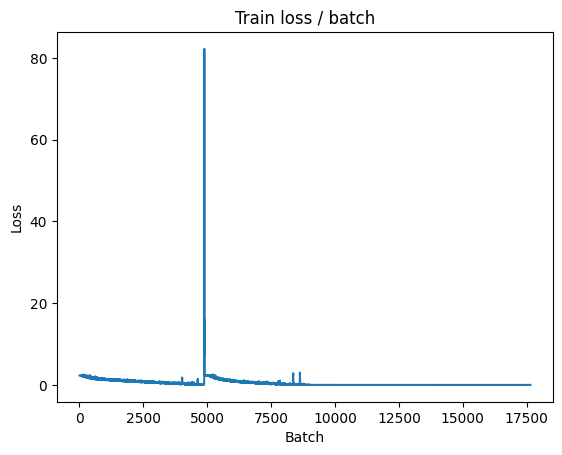


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.211s (0.211s)	Loss 2.8288 (2.8288)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5941	Avg Prec@1 69.74 %	Avg Prec@5 96.82 %



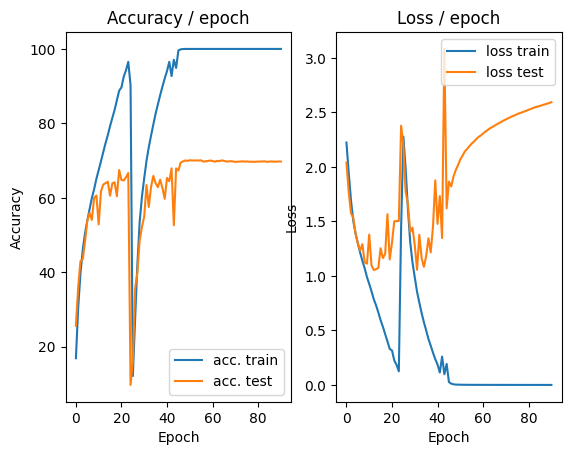

=== EPOCH 92 =====

[TRAIN Batch 000/196]	Time 0.282s (0.282s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


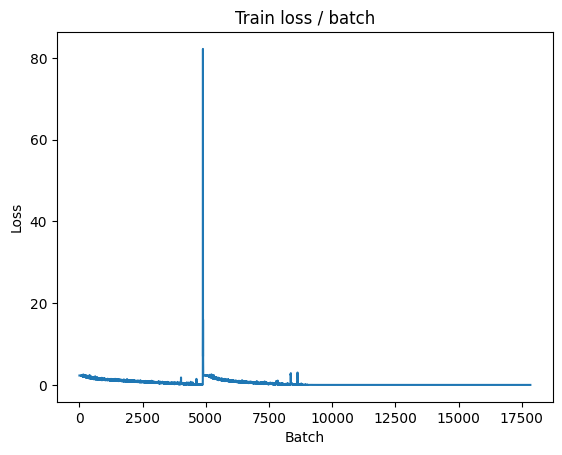


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.193s (0.193s)	Loss 2.8387 (2.8387)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.5999	Avg Prec@1 69.79 %	Avg Prec@5 96.81 %



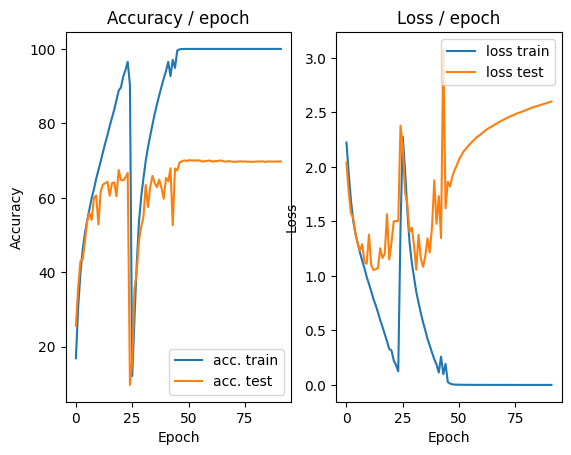

=== EPOCH 93 =====

[TRAIN Batch 000/196]	Time 0.277s (0.277s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


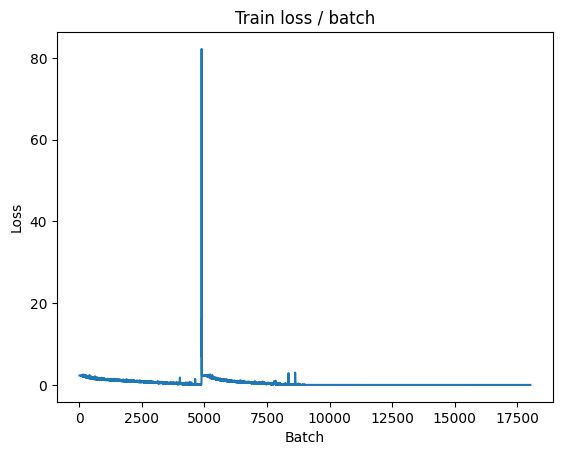


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.205s (0.205s)	Loss 2.8463 (2.8463)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.6064	Avg Prec@1 69.81 %	Avg Prec@5 96.82 %



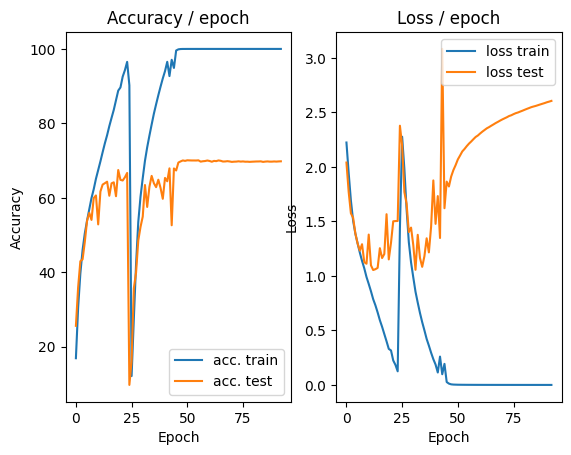

=== EPOCH 94 =====

[TRAIN Batch 000/196]	Time 0.324s (0.324s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


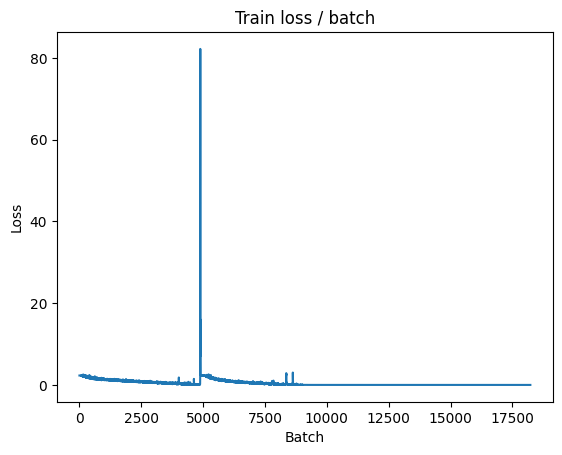


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.197s (0.197s)	Loss 2.8540 (2.8540)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.6104	Avg Prec@1 69.77 %	Avg Prec@5 96.81 %



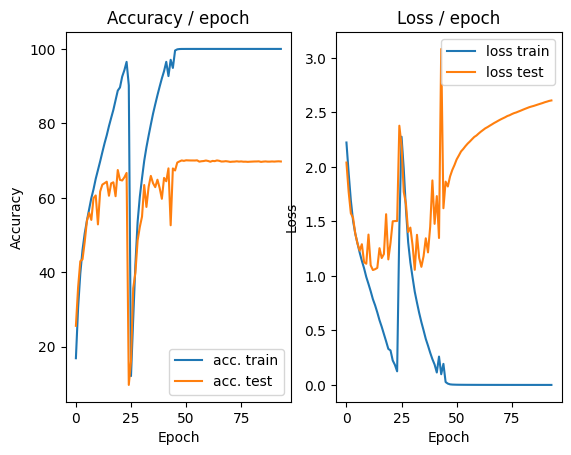

=== EPOCH 95 =====

[TRAIN Batch 000/196]	Time 0.305s (0.305s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


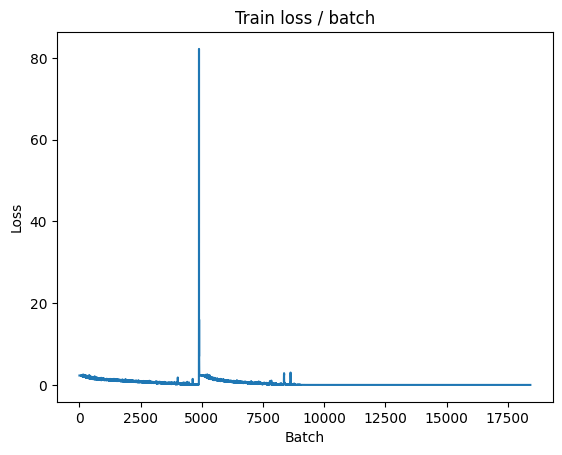


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.218s (0.218s)	Loss 2.8557 (2.8557)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.6172	Avg Prec@1 69.73 %	Avg Prec@5 96.79 %



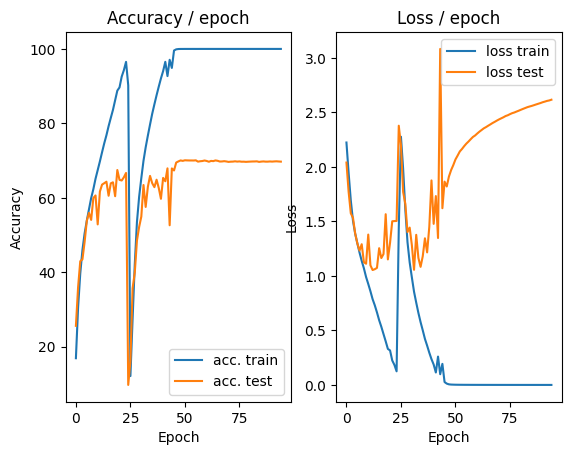

=== EPOCH 96 =====

[TRAIN Batch 000/196]	Time 0.315s (0.315s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


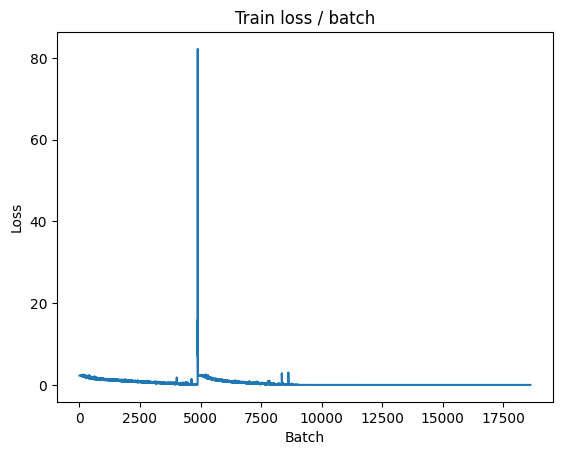


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.292s (0.292s)	Loss 2.8673 (2.8673)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.6226	Avg Prec@1 69.78 %	Avg Prec@5 96.80 %



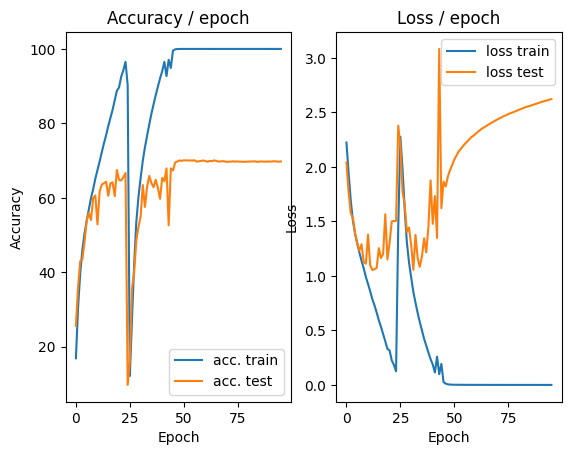

=== EPOCH 97 =====

[TRAIN Batch 000/196]	Time 0.305s (0.305s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


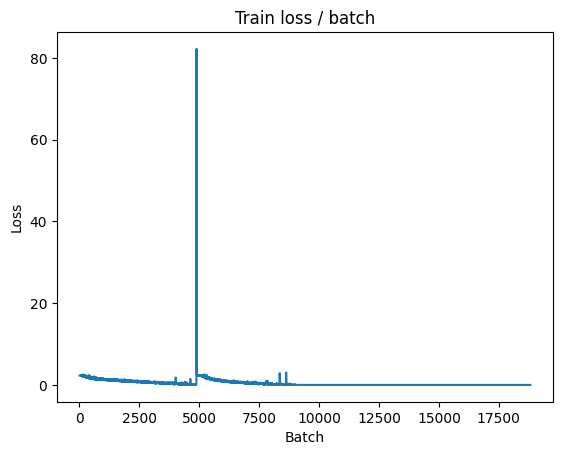


===============> Total time 8s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.191s (0.191s)	Loss 2.8731 (2.8731)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 2.6266	Avg Prec@1 69.68 %	Avg Prec@5 96.82 %



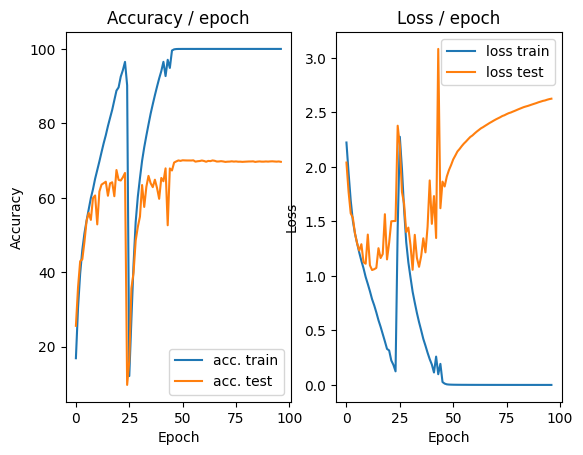

=== EPOCH 98 =====

[TRAIN Batch 000/196]	Time 0.277s (0.277s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


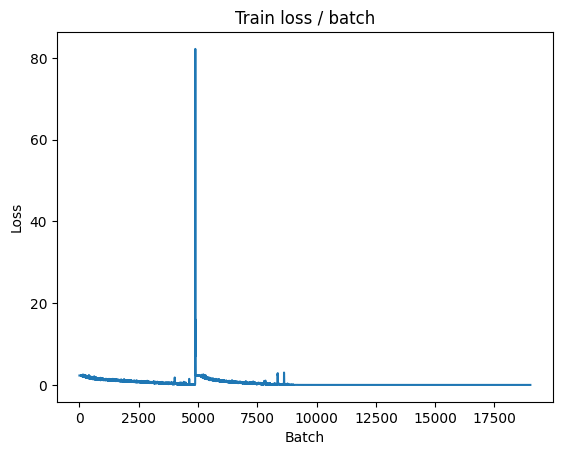


===============> Total time 8s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.195s (0.195s)	Loss 2.8787 (2.8787)	Prec@1  68.0 ( 68.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.6341	Avg Prec@1 69.75 %	Avg Prec@5 96.82 %



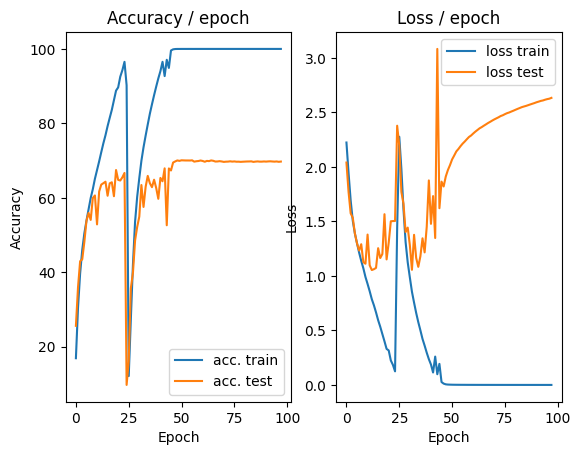

=== EPOCH 99 =====

[TRAIN Batch 000/196]	Time 0.302s (0.302s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


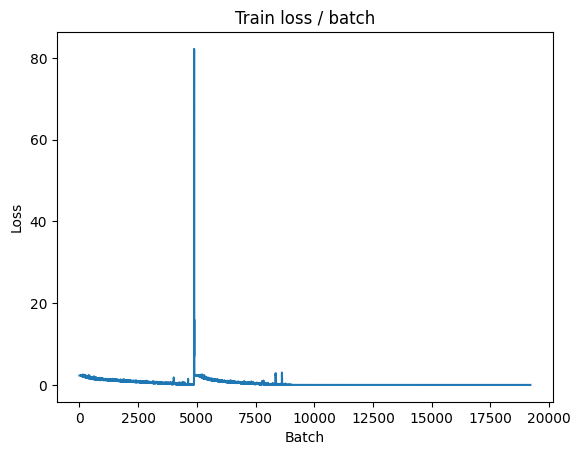


===============> Total time 8s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.188s (0.188s)	Loss 2.8839 (2.8839)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.6398	Avg Prec@1 69.70 %	Avg Prec@5 96.82 %



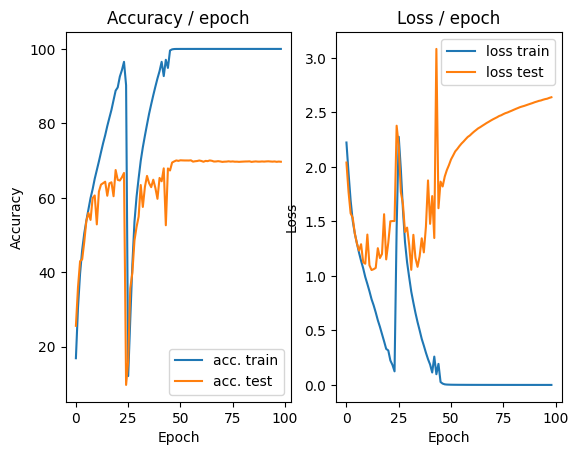

=== EPOCH 100 =====

[TRAIN Batch 000/196]	Time 0.320s (0.320s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


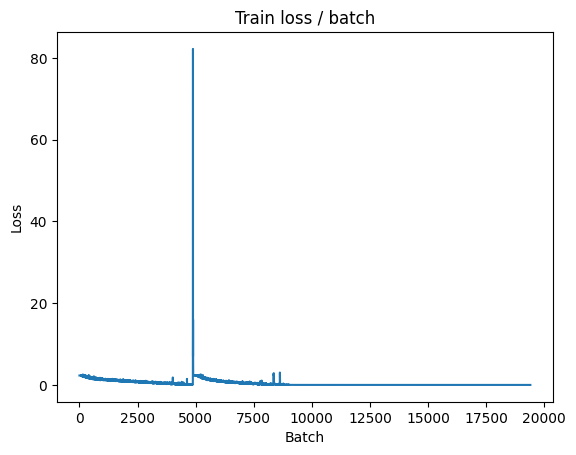


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/040]	Time 0.195s (0.195s)	Loss 2.8876 (2.8876)	Prec@1  68.4 ( 68.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 2.6441	Avg Prec@1 69.72 %	Avg Prec@5 96.81 %



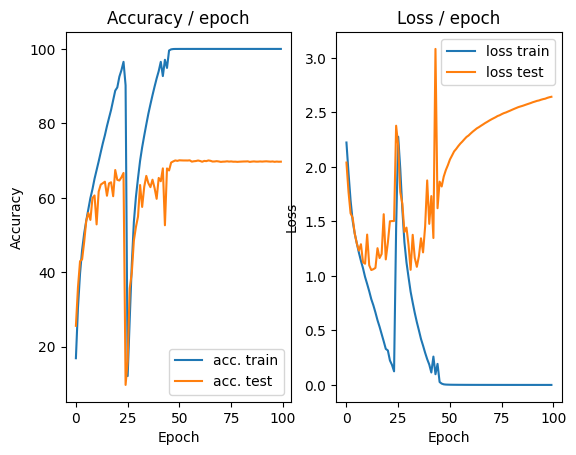

In [ ]:
main(256, 0.1, 100, cuda=True) #50 epoch, lr 0.1, batch 256

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/196]	Time 0.194s (0.194s)	Loss 2.3031 (2.3031)	Prec@1   9.4 (  9.4)	Prec@5  50.0 ( 50.0)


<Figure size 640x480 with 0 Axes>

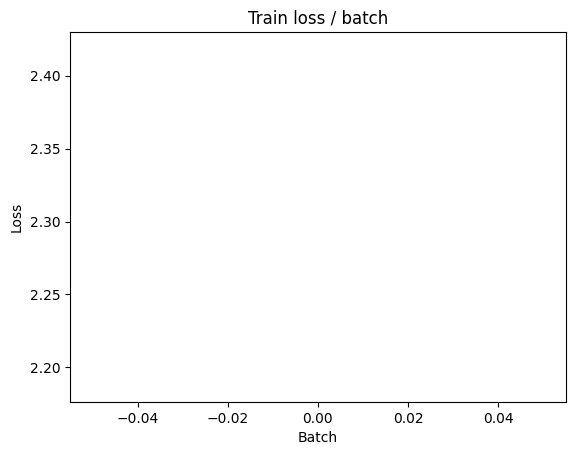


===============> Total time 9s	Avg loss 2.3018	Avg Prec@1 10.21 %	Avg Prec@5 52.39 %

[EVAL Batch 000/040]	Time 0.162s (0.162s)	Loss 2.3000 (2.3000)	Prec@1  10.9 ( 10.9)	Prec@5  59.0 ( 59.0)

===============> Total time 1s	Avg loss 2.3005	Avg Prec@1 11.95 %	Avg Prec@5 55.02 %



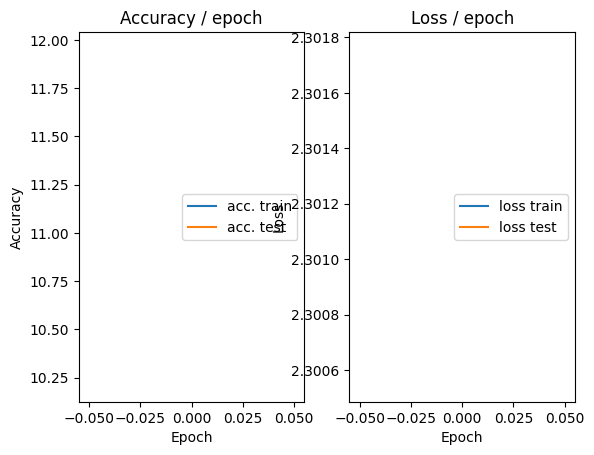

=== EPOCH 2 =====

[TRAIN Batch 000/196]	Time 0.198s (0.198s)	Loss 2.3033 (2.3033)	Prec@1   8.2 (  8.2)	Prec@5  44.9 ( 44.9)


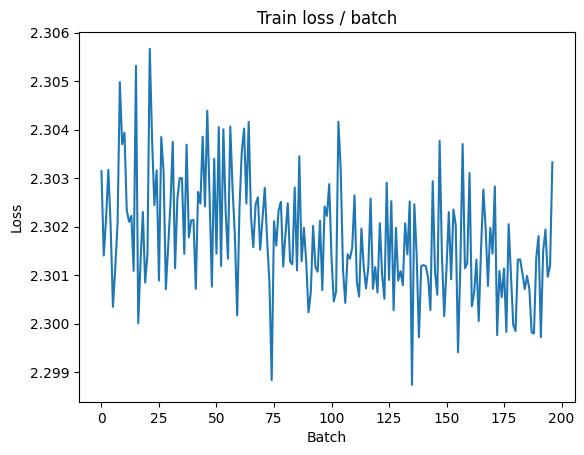


===============> Total time 9s	Avg loss 2.2995	Avg Prec@1 16.05 %	Avg Prec@5 56.24 %

[EVAL Batch 000/040]	Time 0.158s (0.158s)	Loss 2.2970 (2.2970)	Prec@1  11.3 ( 11.3)	Prec@5  60.5 ( 60.5)

===============> Total time 1s	Avg loss 2.2978	Avg Prec@1 12.86 %	Avg Prec@5 56.71 %



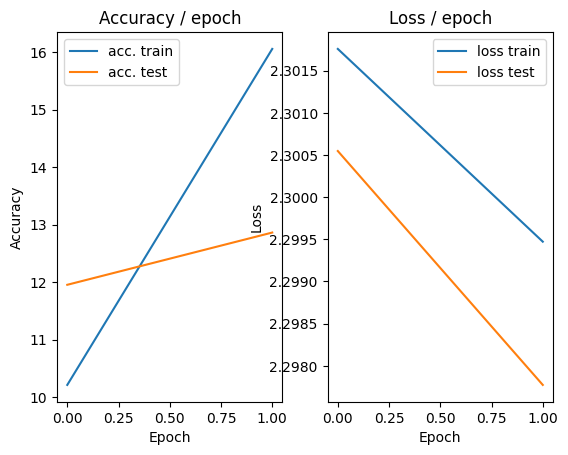

=== EPOCH 3 =====

[TRAIN Batch 000/196]	Time 0.177s (0.177s)	Loss 2.2978 (2.2978)	Prec@1  14.8 ( 14.8)	Prec@5  55.9 ( 55.9)


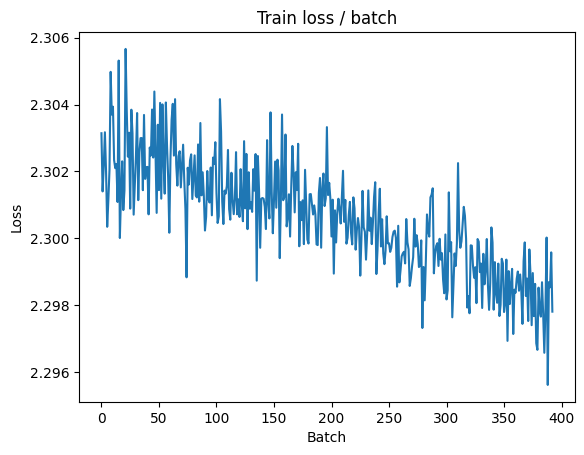


===============> Total time 9s	Avg loss 2.2955	Avg Prec@1 13.55 %	Avg Prec@5 57.88 %

[EVAL Batch 000/040]	Time 0.181s (0.181s)	Loss 2.2899 (2.2899)	Prec@1  12.5 ( 12.5)	Prec@5  62.5 ( 62.5)

===============> Total time 1s	Avg loss 2.2916	Avg Prec@1 14.41 %	Avg Prec@5 60.56 %



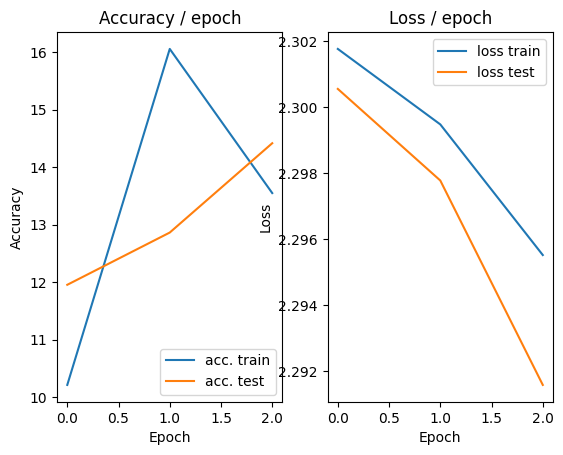

=== EPOCH 4 =====

[TRAIN Batch 000/196]	Time 0.195s (0.195s)	Loss 2.2927 (2.2927)	Prec@1  14.1 ( 14.1)	Prec@5  62.1 ( 62.1)


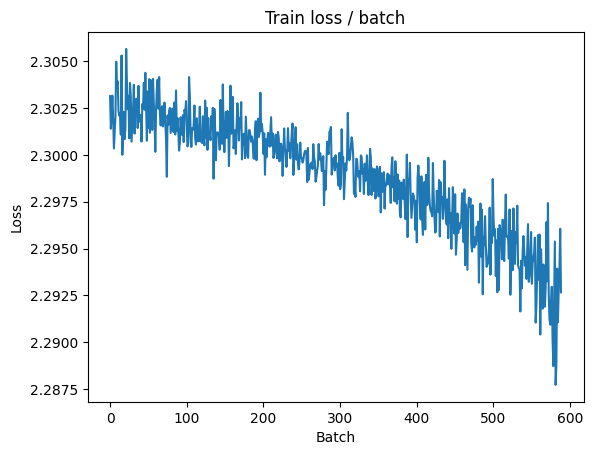


===============> Total time 9s	Avg loss 2.2835	Avg Prec@1 15.06 %	Avg Prec@5 60.78 %

[EVAL Batch 000/040]	Time 0.170s (0.170s)	Loss 2.2623 (2.2623)	Prec@1  13.3 ( 13.3)	Prec@5  64.5 ( 64.5)

===============> Total time 1s	Avg loss 2.2678	Avg Prec@1 13.27 %	Avg Prec@5 63.47 %



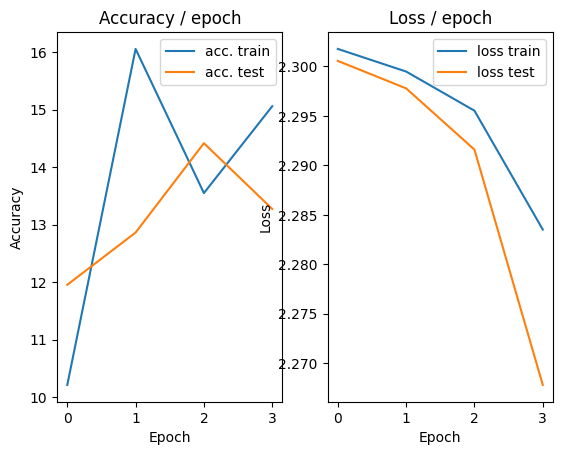

=== EPOCH 5 =====

[TRAIN Batch 000/196]	Time 0.192s (0.192s)	Loss 2.2754 (2.2754)	Prec@1   9.8 (  9.8)	Prec@5  57.4 ( 57.4)


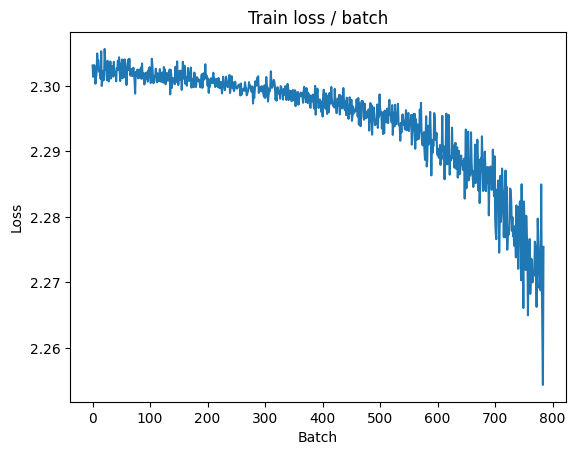


===============> Total time 8s	Avg loss 2.2029	Avg Prec@1 20.38 %	Avg Prec@5 70.19 %

[EVAL Batch 000/040]	Time 0.248s (0.248s)	Loss 2.0811 (2.0811)	Prec@1  24.6 ( 24.6)	Prec@5  71.9 ( 71.9)

===============> Total time 1s	Avg loss 2.0991	Avg Prec@1 21.14 %	Avg Prec@5 73.42 %



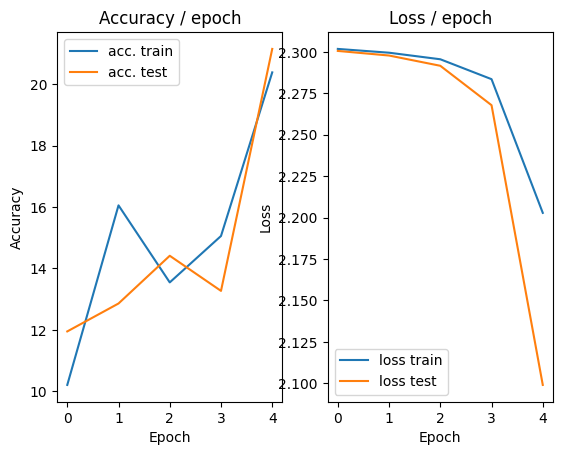

=== EPOCH 6 =====

[TRAIN Batch 000/196]	Time 0.209s (0.209s)	Loss 2.0822 (2.0822)	Prec@1  20.3 ( 20.3)	Prec@5  73.0 ( 73.0)


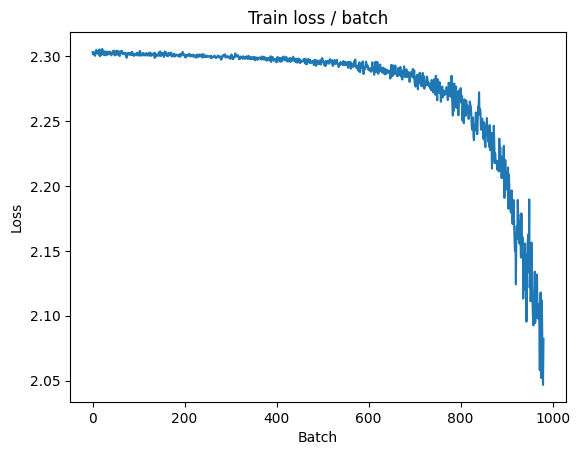


===============> Total time 7s	Avg loss 2.0513	Avg Prec@1 25.16 %	Avg Prec@5 75.49 %

[EVAL Batch 000/040]	Time 0.189s (0.189s)	Loss 2.0953 (2.0953)	Prec@1  22.3 ( 22.3)	Prec@5  72.3 ( 72.3)

===============> Total time 2s	Avg loss 2.0571	Avg Prec@1 24.51 %	Avg Prec@5 75.62 %



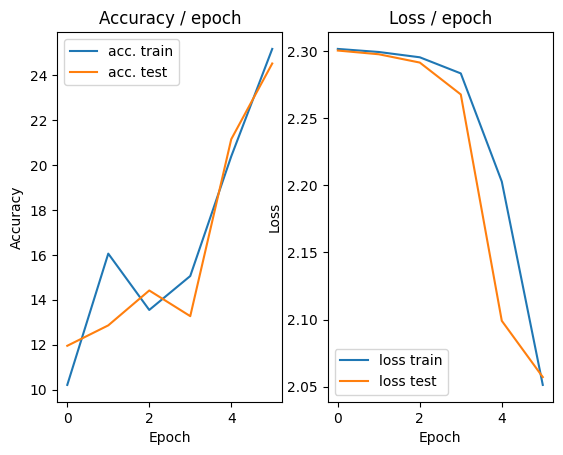

=== EPOCH 7 =====

[TRAIN Batch 000/196]	Time 0.234s (0.234s)	Loss 2.0995 (2.0995)	Prec@1  23.0 ( 23.0)	Prec@5  73.0 ( 73.0)


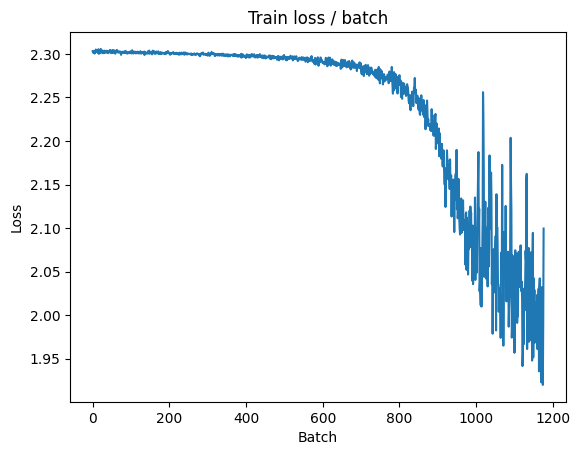


===============> Total time 8s	Avg loss 1.9869	Avg Prec@1 27.58 %	Avg Prec@5 78.53 %

[EVAL Batch 000/040]	Time 0.171s (0.171s)	Loss 1.9642 (1.9642)	Prec@1  28.5 ( 28.5)	Prec@5  78.9 ( 78.9)

===============> Total time 1s	Avg loss 1.9428	Avg Prec@1 28.31 %	Avg Prec@5 80.42 %



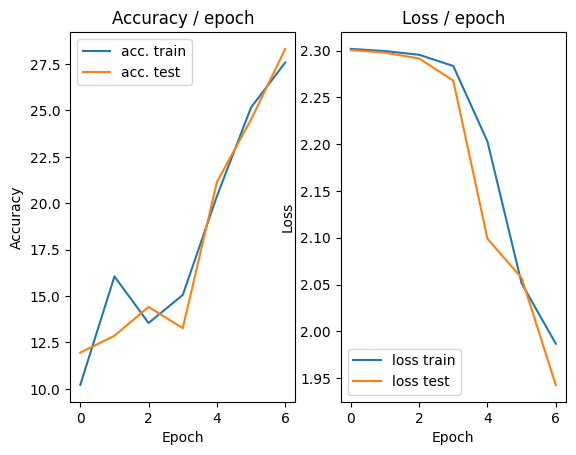

=== EPOCH 8 =====

[TRAIN Batch 000/196]	Time 0.196s (0.196s)	Loss 2.0390 (2.0390)	Prec@1  28.9 ( 28.9)	Prec@5  75.0 ( 75.0)


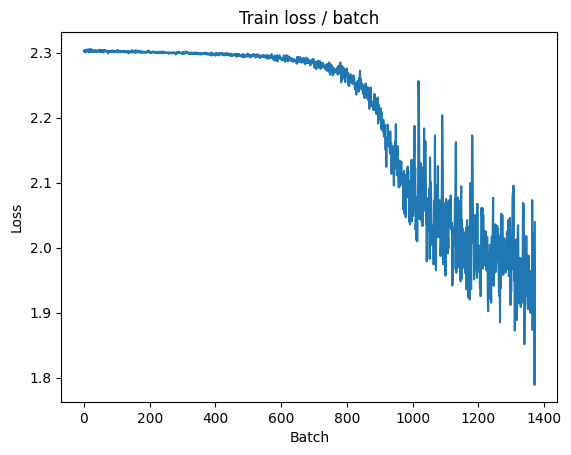


===============> Total time 9s	Avg loss 1.9418	Avg Prec@1 29.69 %	Avg Prec@5 80.20 %

[EVAL Batch 000/040]	Time 0.161s (0.161s)	Loss 1.9038 (1.9038)	Prec@1  30.1 ( 30.1)	Prec@5  84.0 ( 84.0)

===============> Total time 1s	Avg loss 1.9019	Avg Prec@1 30.61 %	Avg Prec@5 82.52 %



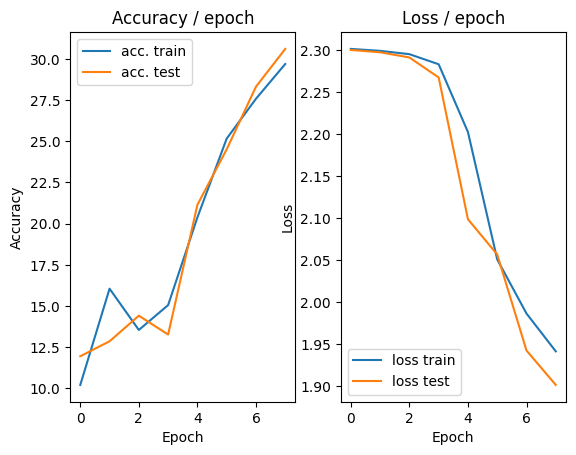

=== EPOCH 9 =====

[TRAIN Batch 000/196]	Time 0.187s (0.187s)	Loss 1.9023 (1.9023)	Prec@1  28.9 ( 28.9)	Prec@5  82.8 ( 82.8)


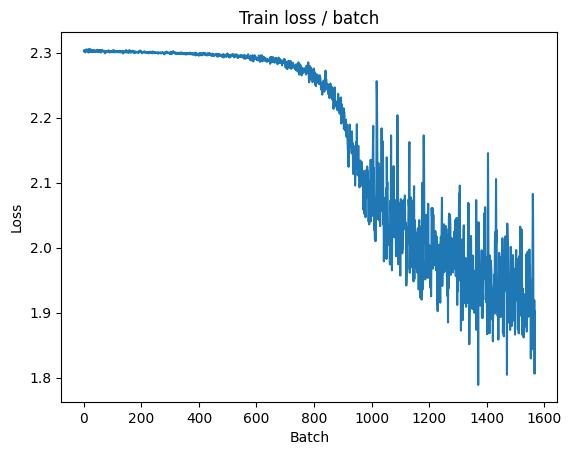


===============> Total time 9s	Avg loss 1.8903	Avg Prec@1 32.20 %	Avg Prec@5 82.16 %

[EVAL Batch 000/040]	Time 0.188s (0.188s)	Loss 1.8550 (1.8550)	Prec@1  35.5 ( 35.5)	Prec@5  83.6 ( 83.6)

===============> Total time 1s	Avg loss 1.8264	Avg Prec@1 34.73 %	Avg Prec@5 84.17 %



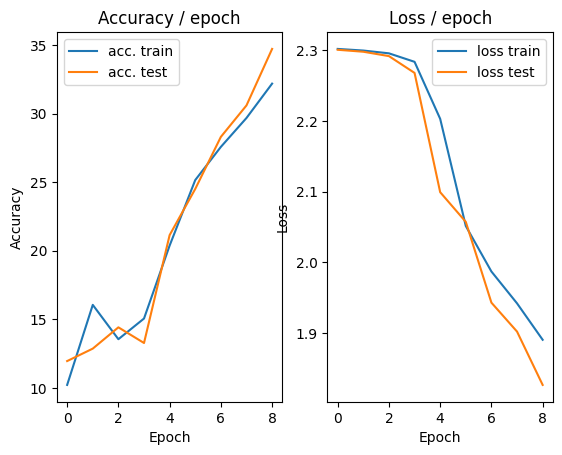

=== EPOCH 10 =====

[TRAIN Batch 000/196]	Time 0.190s (0.190s)	Loss 1.8858 (1.8858)	Prec@1  30.9 ( 30.9)	Prec@5  82.8 ( 82.8)


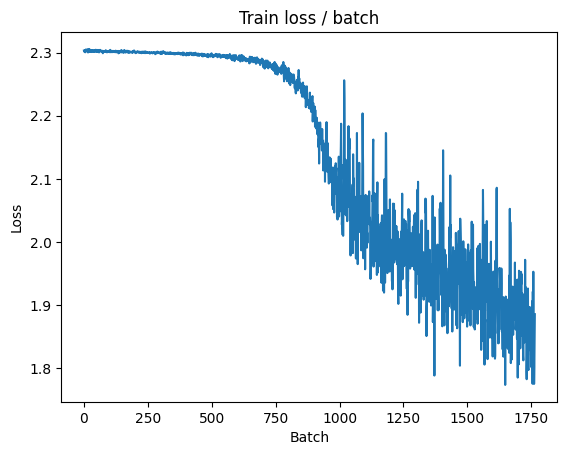


===============> Total time 9s	Avg loss 1.8399	Avg Prec@1 34.03 %	Avg Prec@5 83.80 %

[EVAL Batch 000/040]	Time 0.175s (0.175s)	Loss 1.8393 (1.8393)	Prec@1  37.1 ( 37.1)	Prec@5  85.2 ( 85.2)

===============> Total time 1s	Avg loss 1.8410	Avg Prec@1 33.58 %	Avg Prec@5 83.44 %



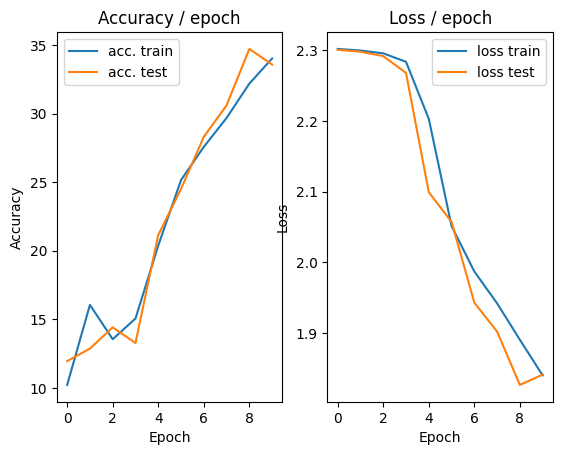

=== EPOCH 11 =====

[TRAIN Batch 000/196]	Time 0.201s (0.201s)	Loss 1.8508 (1.8508)	Prec@1  30.5 ( 30.5)	Prec@5  82.8 ( 82.8)


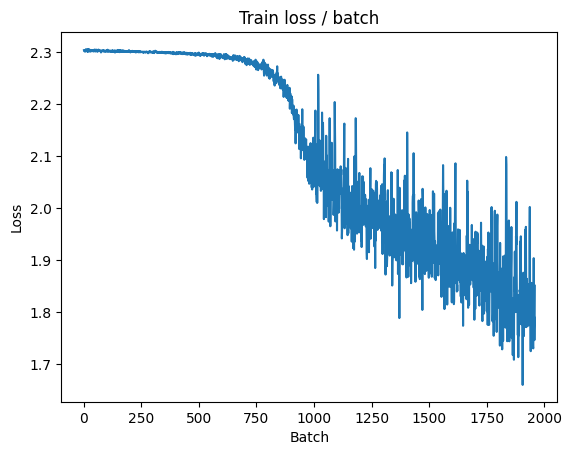


===============> Total time 9s	Avg loss 1.7875	Avg Prec@1 36.29 %	Avg Prec@5 85.18 %

[EVAL Batch 000/040]	Time 0.180s (0.180s)	Loss 1.8416 (1.8416)	Prec@1  37.5 ( 37.5)	Prec@5  81.6 ( 81.6)

===============> Total time 1s	Avg loss 1.8126	Avg Prec@1 36.19 %	Avg Prec@5 83.22 %



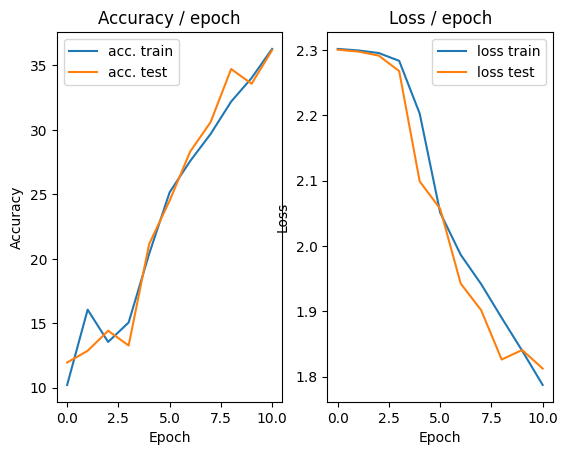

=== EPOCH 12 =====

[TRAIN Batch 000/196]	Time 0.208s (0.208s)	Loss 1.7172 (1.7172)	Prec@1  41.0 ( 41.0)	Prec@5  85.5 ( 85.5)


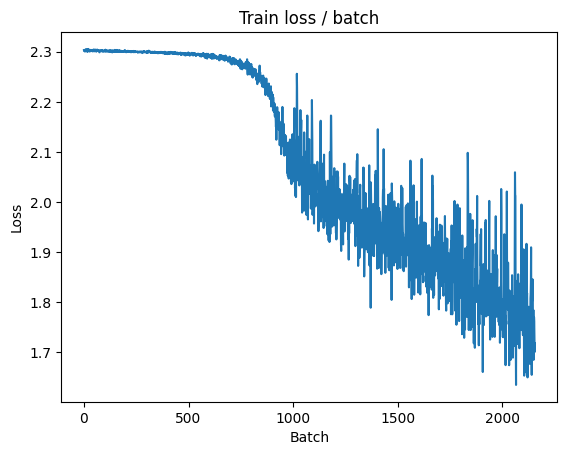


===============> Total time 9s	Avg loss 1.7368	Avg Prec@1 37.74 %	Avg Prec@5 86.48 %

[EVAL Batch 000/040]	Time 0.174s (0.174s)	Loss 1.7316 (1.7316)	Prec@1  36.7 ( 36.7)	Prec@5  88.7 ( 88.7)

===============> Total time 1s	Avg loss 1.6829	Avg Prec@1 39.45 %	Avg Prec@5 88.15 %



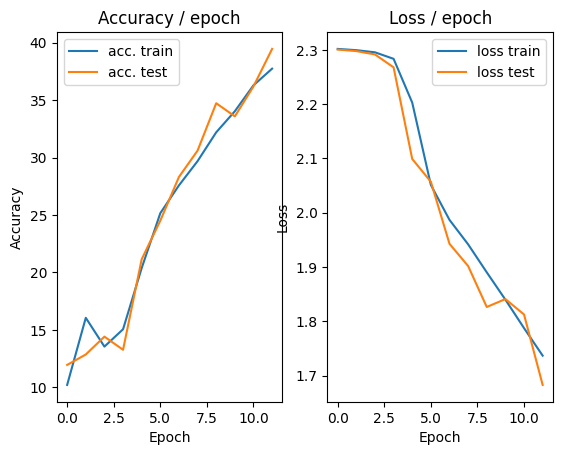

=== EPOCH 13 =====

[TRAIN Batch 000/196]	Time 0.205s (0.205s)	Loss 1.7166 (1.7166)	Prec@1  34.4 ( 34.4)	Prec@5  85.9 ( 85.9)


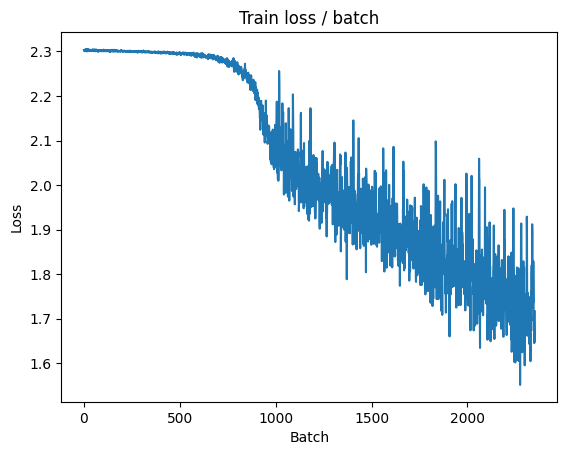


===============> Total time 8s	Avg loss 1.6902	Avg Prec@1 39.47 %	Avg Prec@5 87.76 %

[EVAL Batch 000/040]	Time 0.320s (0.320s)	Loss 1.7465 (1.7465)	Prec@1  38.3 ( 38.3)	Prec@5  84.8 ( 84.8)

===============> Total time 2s	Avg loss 1.6668	Avg Prec@1 40.11 %	Avg Prec@5 88.34 %



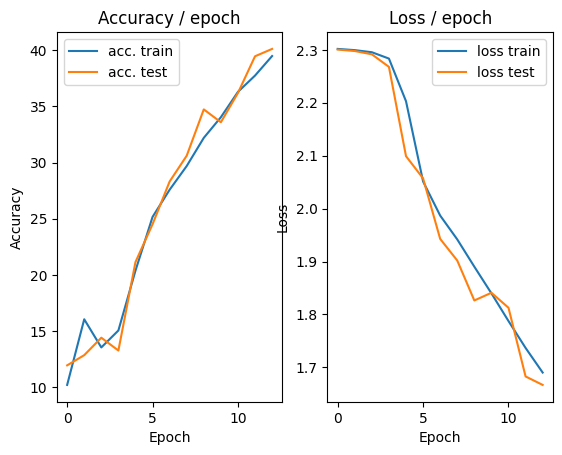

=== EPOCH 14 =====

[TRAIN Batch 000/196]	Time 0.195s (0.195s)	Loss 1.7434 (1.7434)	Prec@1  33.2 ( 33.2)	Prec@5  83.6 ( 83.6)


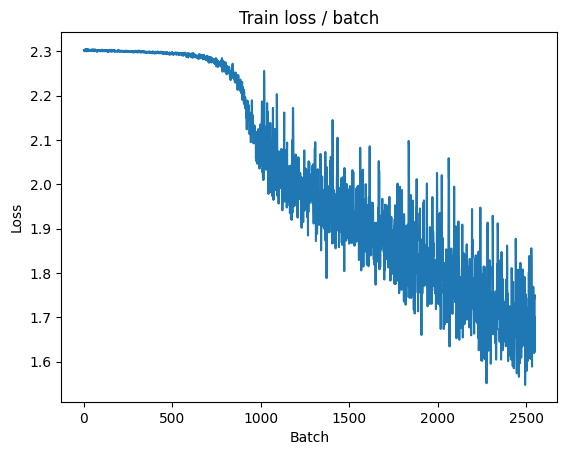


===============> Total time 8s	Avg loss 1.6500	Avg Prec@1 40.87 %	Avg Prec@5 88.63 %

[EVAL Batch 000/040]	Time 0.173s (0.173s)	Loss 1.7085 (1.7085)	Prec@1  37.5 ( 37.5)	Prec@5  86.7 ( 86.7)

===============> Total time 1s	Avg loss 1.6229	Avg Prec@1 42.37 %	Avg Prec@5 89.26 %



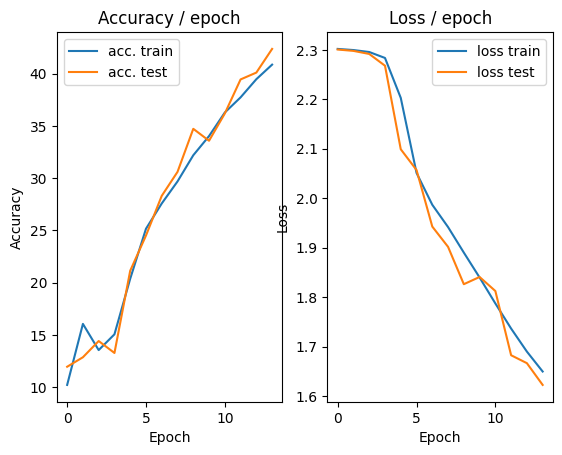

=== EPOCH 15 =====

[TRAIN Batch 000/196]	Time 0.310s (0.310s)	Loss 1.6478 (1.6478)	Prec@1  35.5 ( 35.5)	Prec@5  89.5 ( 89.5)


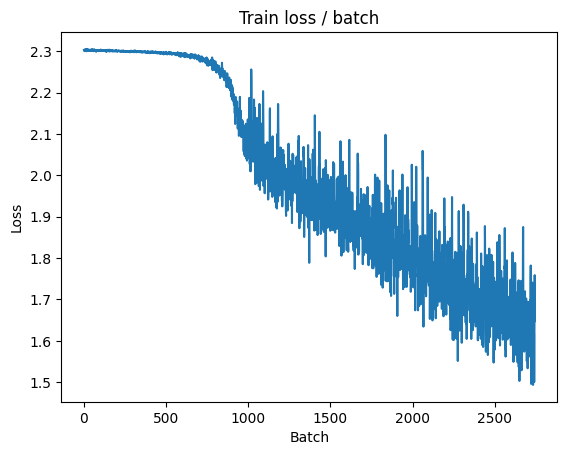


===============> Total time 8s	Avg loss 1.6137	Avg Prec@1 42.22 %	Avg Prec@5 89.45 %

[EVAL Batch 000/040]	Time 0.172s (0.172s)	Loss 1.6225 (1.6225)	Prec@1  41.8 ( 41.8)	Prec@5  87.9 ( 87.9)

===============> Total time 1s	Avg loss 1.5916	Avg Prec@1 42.46 %	Avg Prec@5 89.98 %



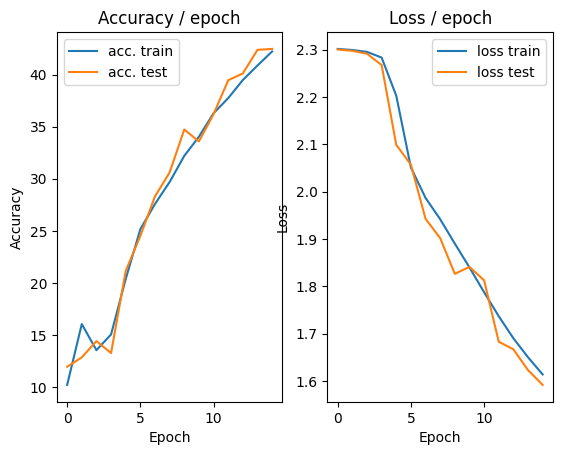

=== EPOCH 16 =====

[TRAIN Batch 000/196]	Time 0.219s (0.219s)	Loss 1.5540 (1.5540)	Prec@1  44.1 ( 44.1)	Prec@5  92.2 ( 92.2)


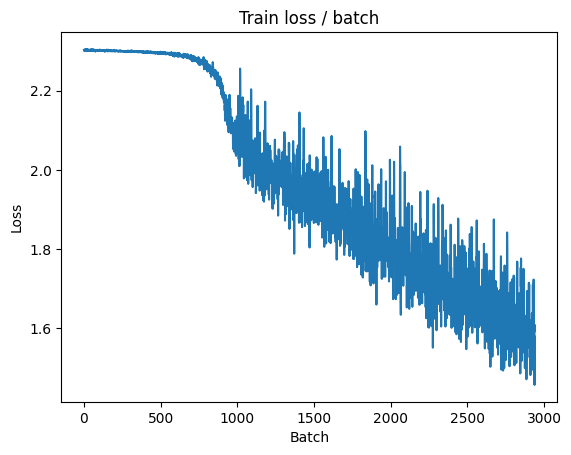


===============> Total time 9s	Avg loss 1.5866	Avg Prec@1 43.38 %	Avg Prec@5 89.94 %

[EVAL Batch 000/040]	Time 0.175s (0.175s)	Loss 1.6905 (1.6905)	Prec@1  38.3 ( 38.3)	Prec@5  86.3 ( 86.3)

===============> Total time 1s	Avg loss 1.6441	Avg Prec@1 41.49 %	Avg Prec@5 88.04 %



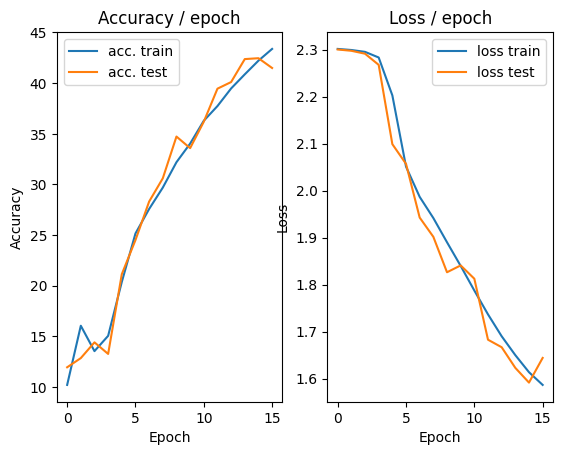

=== EPOCH 17 =====

[TRAIN Batch 000/196]	Time 0.203s (0.203s)	Loss 1.6579 (1.6579)	Prec@1  39.5 ( 39.5)	Prec@5  88.3 ( 88.3)


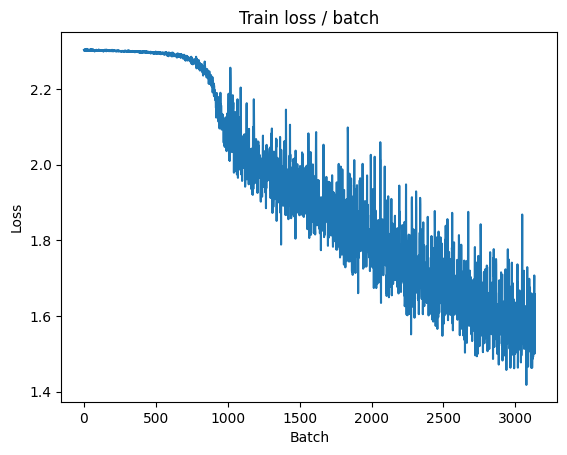


===============> Total time 9s	Avg loss 1.5621	Avg Prec@1 44.07 %	Avg Prec@5 90.38 %

[EVAL Batch 000/040]	Time 0.182s (0.182s)	Loss 1.6567 (1.6567)	Prec@1  41.0 ( 41.0)	Prec@5  87.1 ( 87.1)

===============> Total time 1s	Avg loss 1.6236	Avg Prec@1 42.61 %	Avg Prec@5 88.66 %



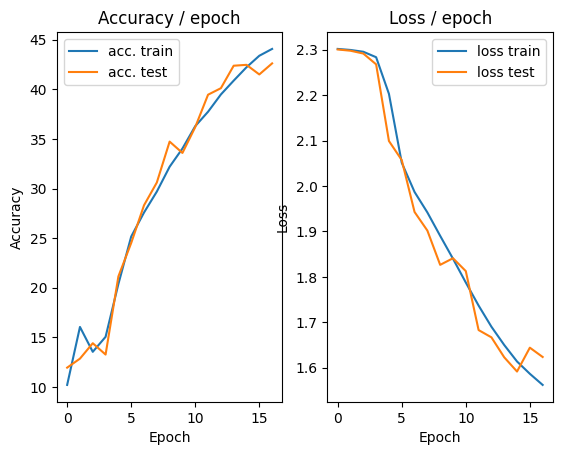

=== EPOCH 18 =====

[TRAIN Batch 000/196]	Time 0.193s (0.193s)	Loss 1.5620 (1.5620)	Prec@1  43.8 ( 43.8)	Prec@5  91.0 ( 91.0)


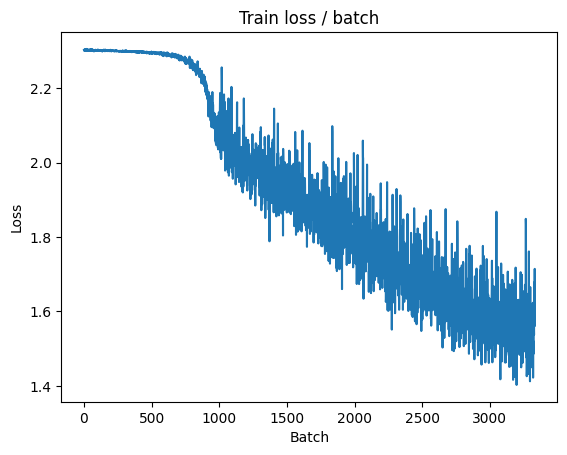


===============> Total time 9s	Avg loss 1.5377	Avg Prec@1 45.23 %	Avg Prec@5 90.80 %

[EVAL Batch 000/040]	Time 0.179s (0.179s)	Loss 1.7522 (1.7522)	Prec@1  38.7 ( 38.7)	Prec@5  85.5 ( 85.5)

===============> Total time 1s	Avg loss 1.6978	Avg Prec@1 39.97 %	Avg Prec@5 87.71 %



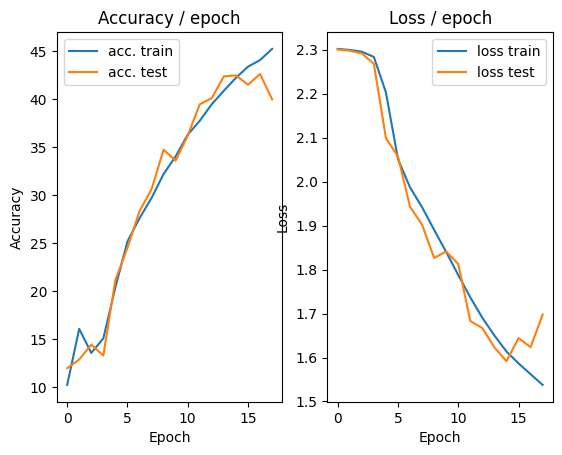

=== EPOCH 19 =====

[TRAIN Batch 000/196]	Time 0.211s (0.211s)	Loss 1.6927 (1.6927)	Prec@1  40.2 ( 40.2)	Prec@5  87.9 ( 87.9)


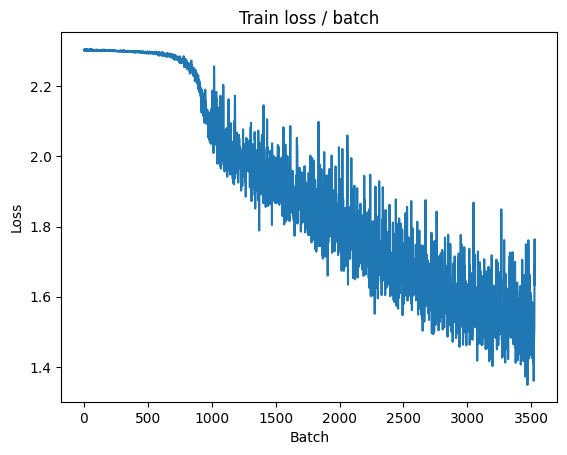


===============> Total time 9s	Avg loss 1.5144	Avg Prec@1 45.96 %	Avg Prec@5 91.28 %

[EVAL Batch 000/040]	Time 0.178s (0.178s)	Loss 1.5852 (1.5852)	Prec@1  44.1 ( 44.1)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.5145	Avg Prec@1 45.18 %	Avg Prec@5 91.18 %



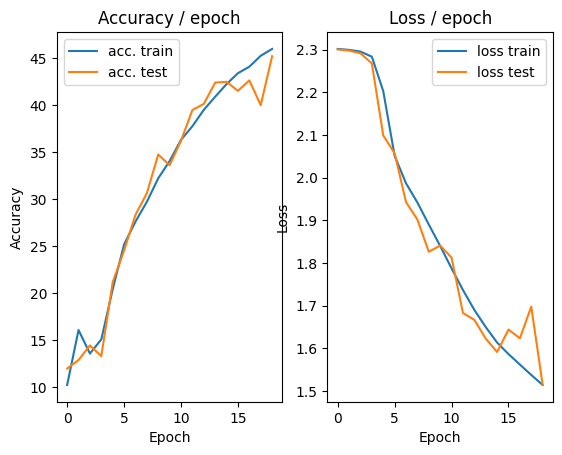

=== EPOCH 20 =====

[TRAIN Batch 000/196]	Time 0.218s (0.218s)	Loss 1.5095 (1.5095)	Prec@1  43.8 ( 43.8)	Prec@5  92.6 ( 92.6)


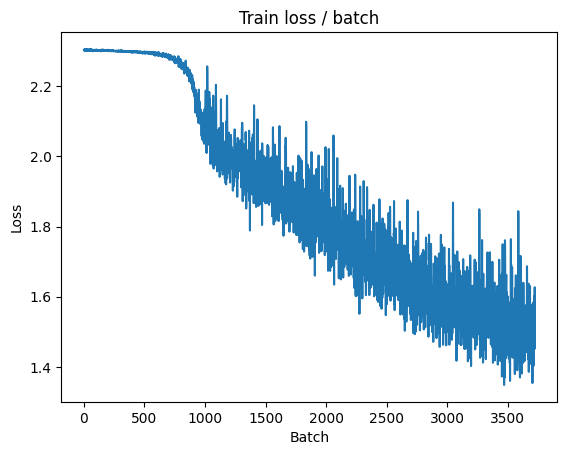


===============> Total time 9s	Avg loss 1.4940	Avg Prec@1 46.81 %	Avg Prec@5 91.60 %

[EVAL Batch 000/040]	Time 0.202s (0.202s)	Loss 1.6378 (1.6378)	Prec@1  39.8 ( 39.8)	Prec@5  88.7 ( 88.7)

===============> Total time 1s	Avg loss 1.5697	Avg Prec@1 43.46 %	Avg Prec@5 90.61 %



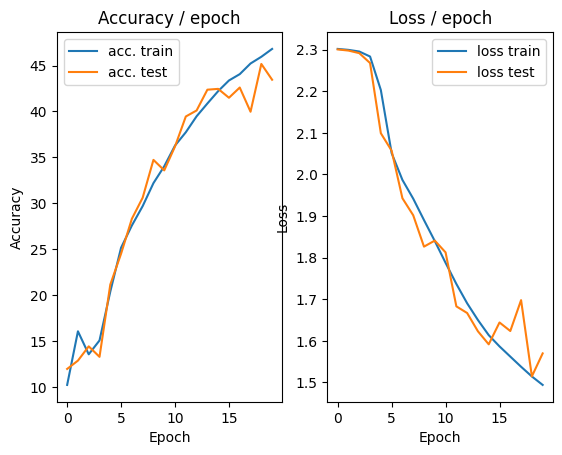

=== EPOCH 21 =====

[TRAIN Batch 000/196]	Time 0.221s (0.221s)	Loss 1.5623 (1.5623)	Prec@1  43.0 ( 43.0)	Prec@5  90.6 ( 90.6)


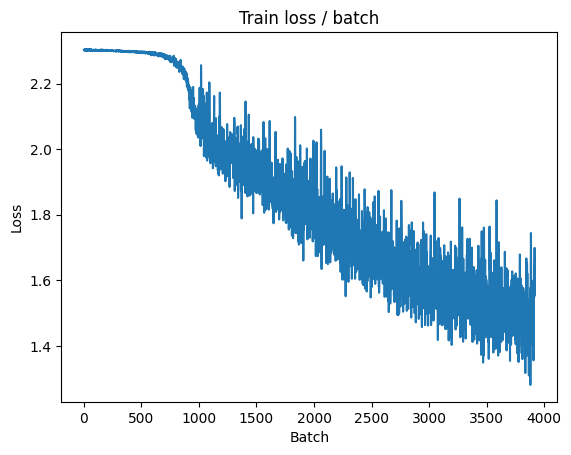


===============> Total time 8s	Avg loss 1.4697	Avg Prec@1 47.68 %	Avg Prec@5 91.92 %

[EVAL Batch 000/040]	Time 0.277s (0.277s)	Loss 1.4863 (1.4863)	Prec@1  46.1 ( 46.1)	Prec@5  91.0 ( 91.0)

===============> Total time 2s	Avg loss 1.4476	Avg Prec@1 47.72 %	Avg Prec@5 92.37 %



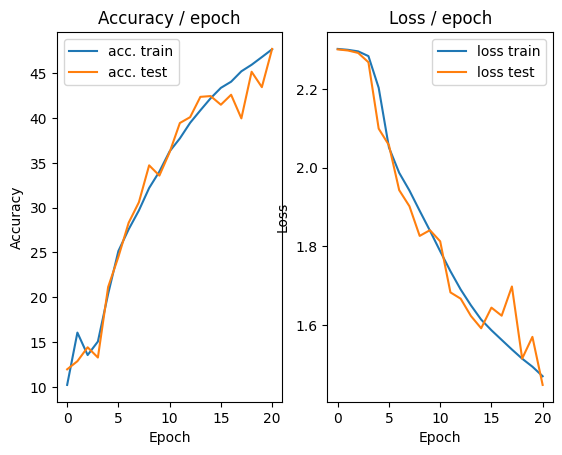

=== EPOCH 22 =====

[TRAIN Batch 000/196]	Time 0.207s (0.207s)	Loss 1.4366 (1.4366)	Prec@1  48.8 ( 48.8)	Prec@5  92.2 ( 92.2)


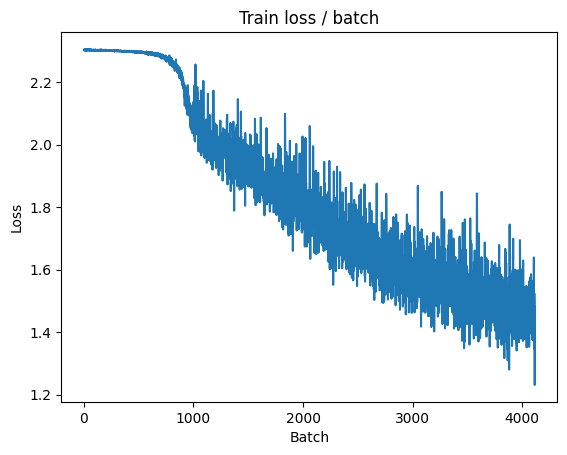


===============> Total time 8s	Avg loss 1.4528	Avg Prec@1 48.26 %	Avg Prec@5 92.16 %

[EVAL Batch 000/040]	Time 0.194s (0.194s)	Loss 1.5725 (1.5725)	Prec@1  42.2 ( 42.2)	Prec@5  90.2 ( 90.2)

===============> Total time 1s	Avg loss 1.5025	Avg Prec@1 44.65 %	Avg Prec@5 91.81 %



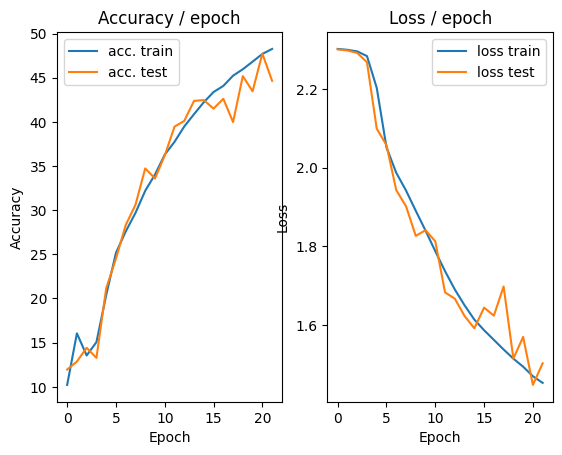

=== EPOCH 23 =====

[TRAIN Batch 000/196]	Time 0.306s (0.306s)	Loss 1.5775 (1.5775)	Prec@1  43.0 ( 43.0)	Prec@5  90.6 ( 90.6)


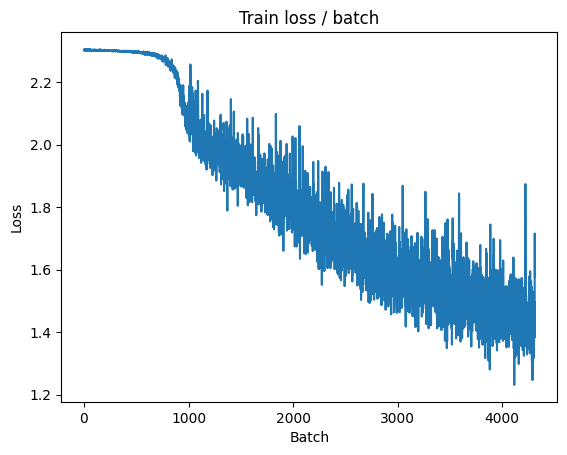


===============> Total time 8s	Avg loss 1.4290	Avg Prec@1 49.10 %	Avg Prec@5 92.50 %

[EVAL Batch 000/040]	Time 0.183s (0.183s)	Loss 1.5577 (1.5577)	Prec@1  44.5 ( 44.5)	Prec@5  92.6 ( 92.6)

===============> Total time 1s	Avg loss 1.4987	Avg Prec@1 46.04 %	Avg Prec@5 91.62 %



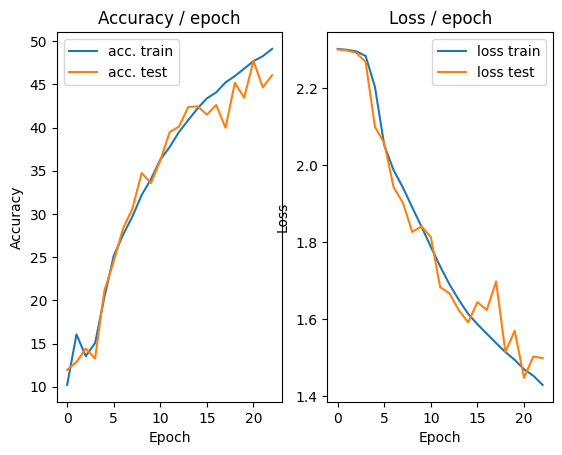

=== EPOCH 24 =====

[TRAIN Batch 000/196]	Time 0.226s (0.226s)	Loss 1.5202 (1.5202)	Prec@1  46.1 ( 46.1)	Prec@5  93.8 ( 93.8)


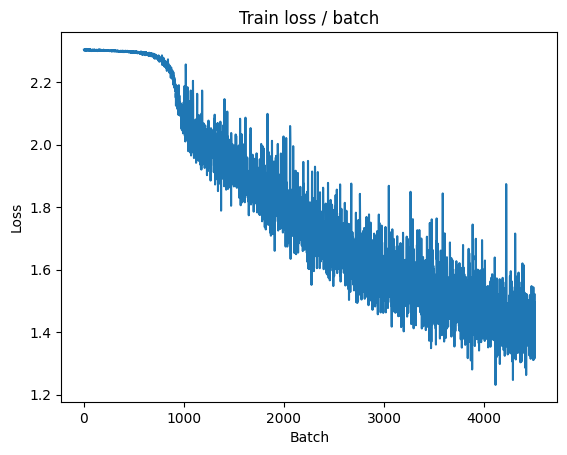


===============> Total time 9s	Avg loss 1.4125	Avg Prec@1 49.78 %	Avg Prec@5 92.71 %

[EVAL Batch 000/040]	Time 0.188s (0.188s)	Loss 1.4298 (1.4298)	Prec@1  49.6 ( 49.6)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.3931	Avg Prec@1 49.69 %	Avg Prec@5 93.11 %



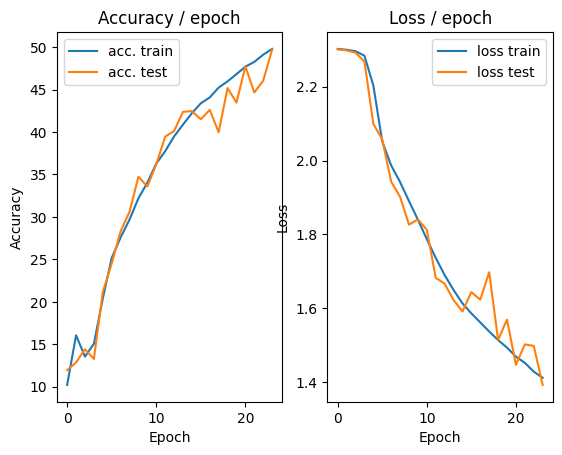

=== EPOCH 25 =====

[TRAIN Batch 000/196]	Time 0.207s (0.207s)	Loss 1.3863 (1.3863)	Prec@1  51.2 ( 51.2)	Prec@5  89.8 ( 89.8)


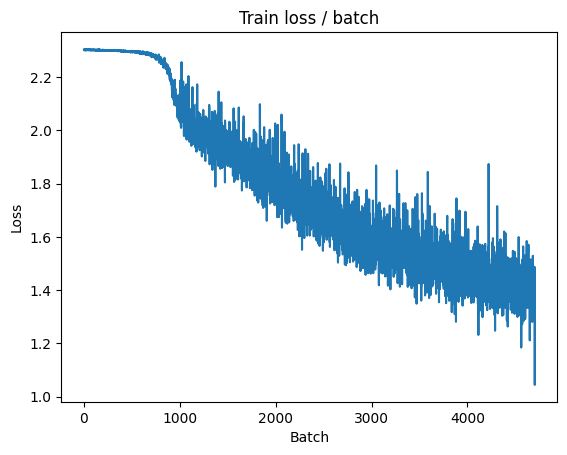


===============> Total time 8s	Avg loss 1.3939	Avg Prec@1 50.58 %	Avg Prec@5 92.95 %

[EVAL Batch 000/040]	Time 0.188s (0.188s)	Loss 1.5158 (1.5158)	Prec@1  46.9 ( 46.9)	Prec@5  91.0 ( 91.0)

===============> Total time 1s	Avg loss 1.4628	Avg Prec@1 45.87 %	Avg Prec@5 92.03 %



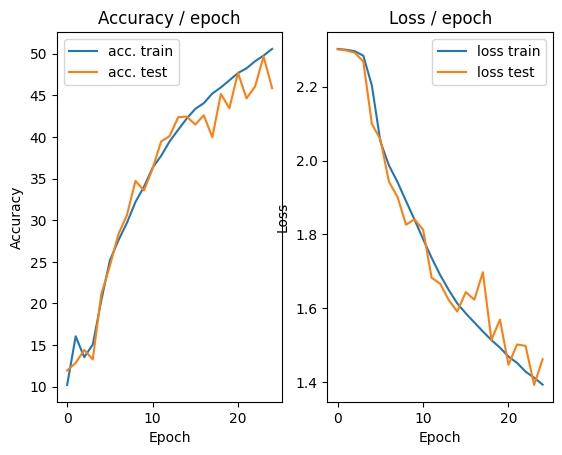

=== EPOCH 26 =====

[TRAIN Batch 000/196]	Time 0.212s (0.212s)	Loss 1.4654 (1.4654)	Prec@1  48.4 ( 48.4)	Prec@5  89.5 ( 89.5)


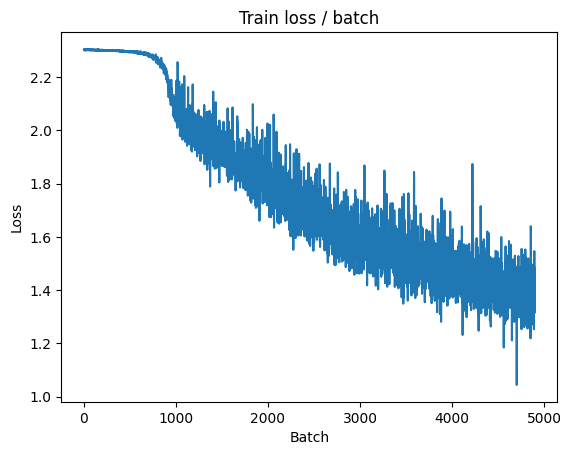


===============> Total time 9s	Avg loss 1.3721	Avg Prec@1 51.51 %	Avg Prec@5 93.25 %

[EVAL Batch 000/040]	Time 0.179s (0.179s)	Loss 1.4324 (1.4324)	Prec@1  52.0 ( 52.0)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.4214	Avg Prec@1 48.50 %	Avg Prec@5 93.08 %



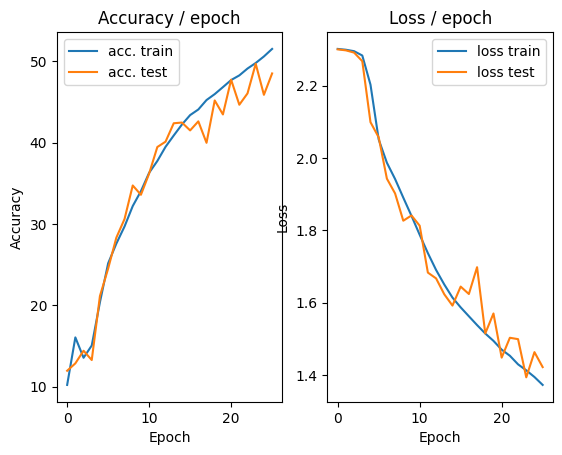

=== EPOCH 27 =====

[TRAIN Batch 000/196]	Time 0.234s (0.234s)	Loss 1.3720 (1.3720)	Prec@1  48.0 ( 48.0)	Prec@5  93.4 ( 93.4)


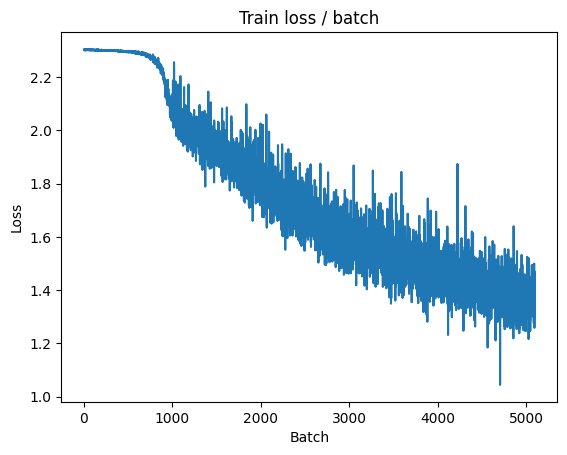


===============> Total time 9s	Avg loss 1.3633	Avg Prec@1 51.71 %	Avg Prec@5 93.31 %

[EVAL Batch 000/040]	Time 0.182s (0.182s)	Loss 1.4335 (1.4335)	Prec@1  52.0 ( 52.0)	Prec@5  92.6 ( 92.6)

===============> Total time 1s	Avg loss 1.4090	Avg Prec@1 50.15 %	Avg Prec@5 92.21 %



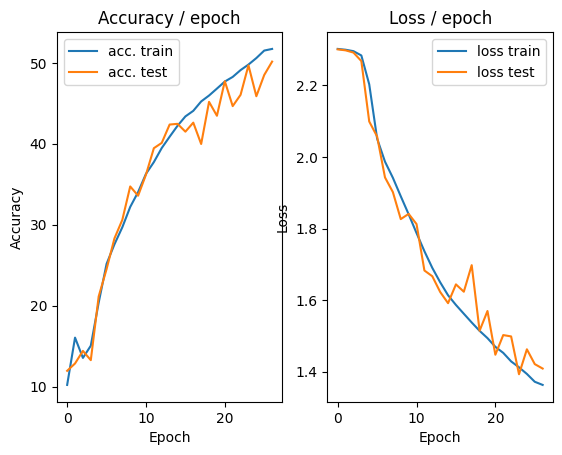

=== EPOCH 28 =====

[TRAIN Batch 000/196]	Time 0.228s (0.228s)	Loss 1.3888 (1.3888)	Prec@1  50.4 ( 50.4)	Prec@5  91.0 ( 91.0)


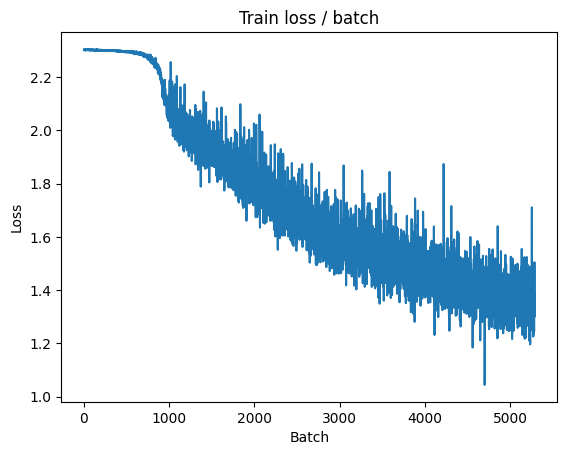


===============> Total time 8s	Avg loss 1.3427	Avg Prec@1 52.50 %	Avg Prec@5 93.63 %

[EVAL Batch 000/040]	Time 0.293s (0.293s)	Loss 1.6200 (1.6200)	Prec@1  44.5 ( 44.5)	Prec@5  89.5 ( 89.5)

===============> Total time 1s	Avg loss 1.5247	Avg Prec@1 45.09 %	Avg Prec@5 92.10 %



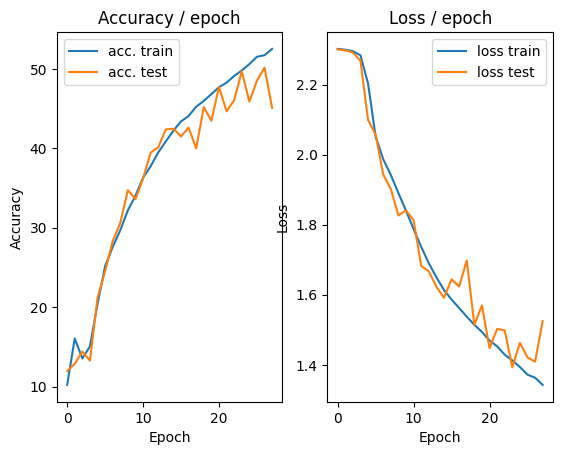

=== EPOCH 29 =====

[TRAIN Batch 000/196]	Time 0.222s (0.222s)	Loss 1.5252 (1.5252)	Prec@1  50.8 ( 50.8)	Prec@5  93.4 ( 93.4)


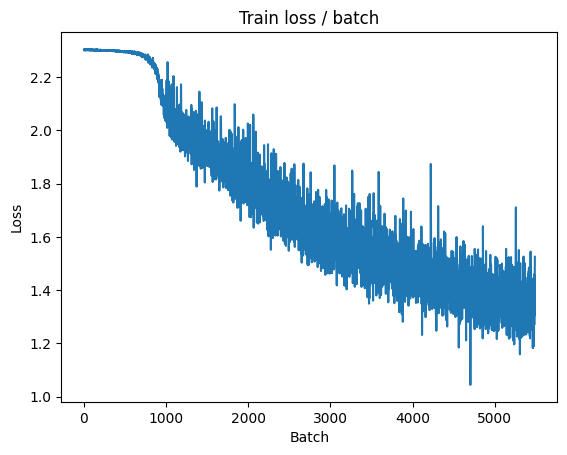


===============> Total time 8s	Avg loss 1.3248	Avg Prec@1 53.04 %	Avg Prec@5 93.76 %

[EVAL Batch 000/040]	Time 0.185s (0.185s)	Loss 1.4758 (1.4758)	Prec@1  50.4 ( 50.4)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.4584	Avg Prec@1 47.12 %	Avg Prec@5 92.03 %



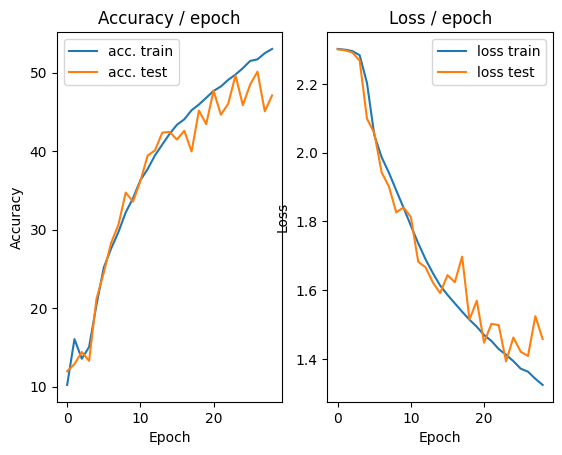

=== EPOCH 30 =====

[TRAIN Batch 000/196]	Time 0.382s (0.382s)	Loss 1.4020 (1.4020)	Prec@1  53.1 ( 53.1)	Prec@5  90.6 ( 90.6)


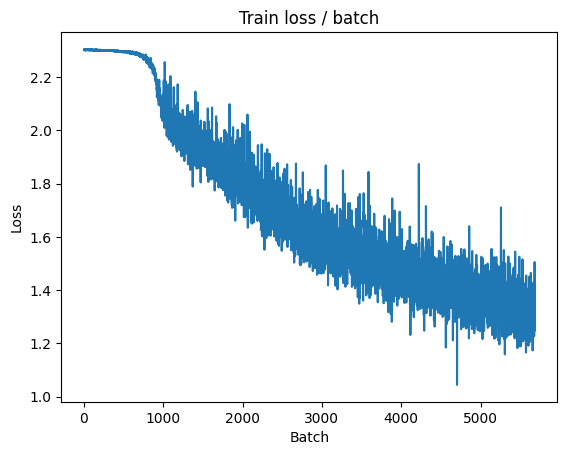


===============> Total time 8s	Avg loss 1.3126	Avg Prec@1 53.72 %	Avg Prec@5 93.91 %

[EVAL Batch 000/040]	Time 0.218s (0.218s)	Loss 1.4888 (1.4888)	Prec@1  49.6 ( 49.6)	Prec@5  92.6 ( 92.6)

===============> Total time 1s	Avg loss 1.4180	Avg Prec@1 48.84 %	Avg Prec@5 92.61 %



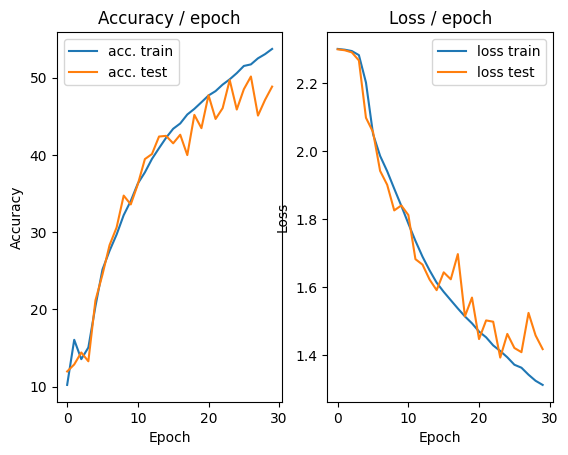

=== EPOCH 31 =====

[TRAIN Batch 000/196]	Time 0.256s (0.256s)	Loss 1.4549 (1.4549)	Prec@1  46.5 ( 46.5)	Prec@5  91.4 ( 91.4)


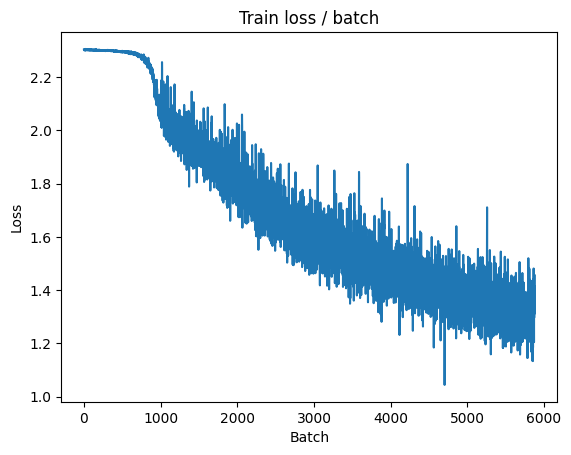


===============> Total time 9s	Avg loss 1.2965	Avg Prec@1 54.18 %	Avg Prec@5 94.12 %

[EVAL Batch 000/040]	Time 0.180s (0.180s)	Loss 1.3568 (1.3568)	Prec@1  52.3 ( 52.3)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.3936	Avg Prec@1 49.61 %	Avg Prec@5 93.69 %



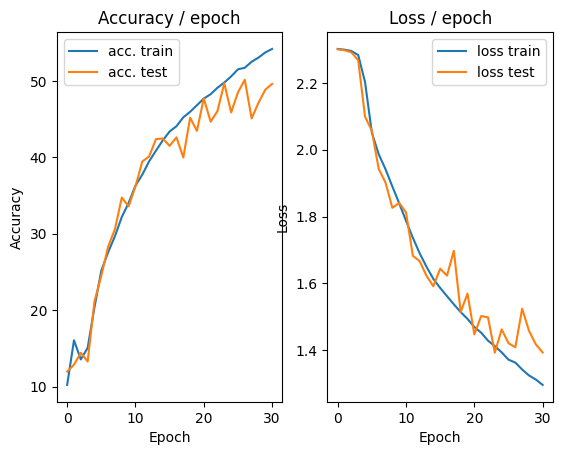

=== EPOCH 32 =====

[TRAIN Batch 000/196]	Time 0.207s (0.207s)	Loss 1.4686 (1.4686)	Prec@1  47.3 ( 47.3)	Prec@5  93.0 ( 93.0)


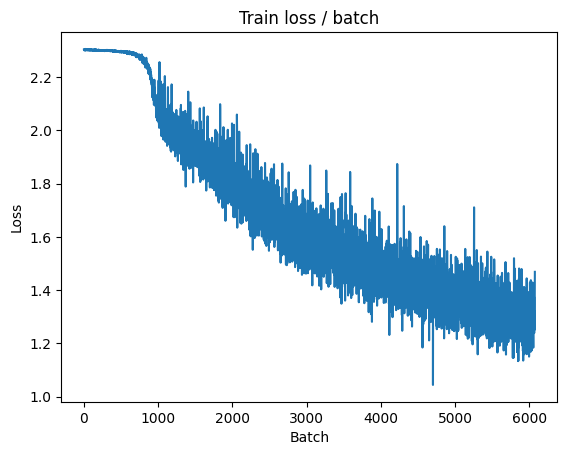


===============> Total time 9s	Avg loss 1.2792	Avg Prec@1 54.82 %	Avg Prec@5 94.40 %

[EVAL Batch 000/040]	Time 0.183s (0.183s)	Loss 1.4205 (1.4205)	Prec@1  52.7 ( 52.7)	Prec@5  92.6 ( 92.6)

===============> Total time 1s	Avg loss 1.3919	Avg Prec@1 49.34 %	Avg Prec@5 93.21 %



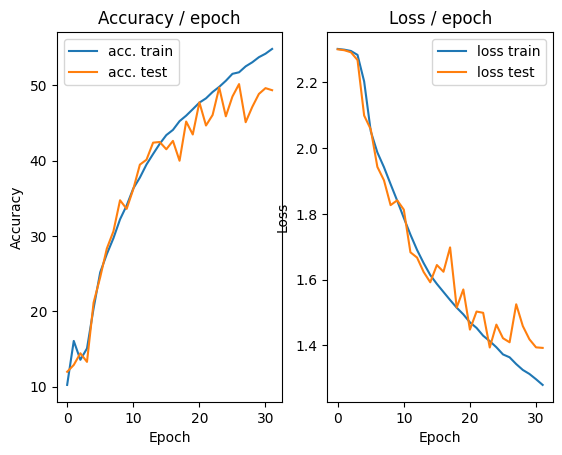

=== EPOCH 33 =====

[TRAIN Batch 000/196]	Time 0.217s (0.217s)	Loss 1.3538 (1.3538)	Prec@1  52.0 ( 52.0)	Prec@5  91.4 ( 91.4)


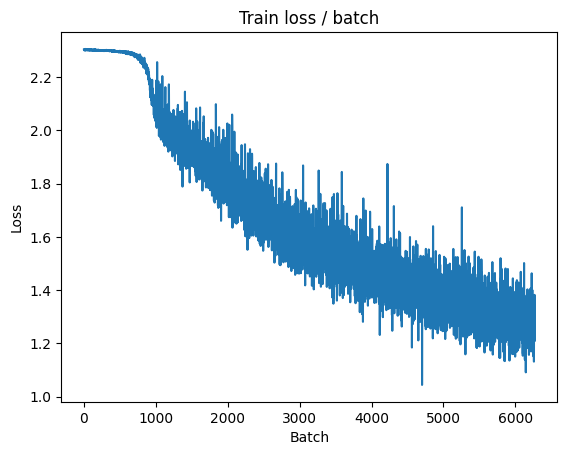


===============> Total time 9s	Avg loss 1.2652	Avg Prec@1 55.43 %	Avg Prec@5 94.52 %

[EVAL Batch 000/040]	Time 0.186s (0.186s)	Loss 1.2688 (1.2688)	Prec@1  57.4 ( 57.4)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.2695	Avg Prec@1 54.20 %	Avg Prec@5 94.80 %



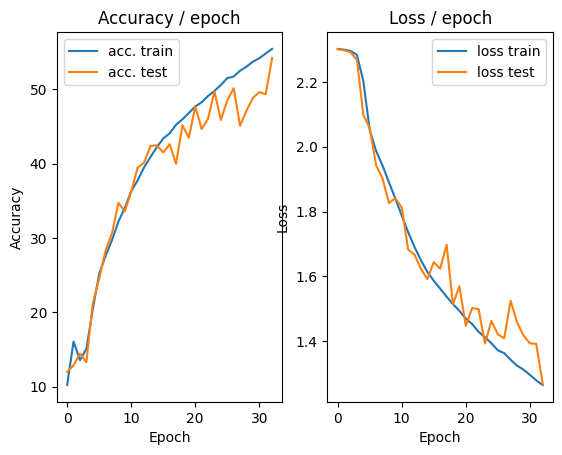

=== EPOCH 34 =====

[TRAIN Batch 000/196]	Time 0.230s (0.230s)	Loss 1.2113 (1.2113)	Prec@1  57.0 ( 57.0)	Prec@5  92.2 ( 92.2)


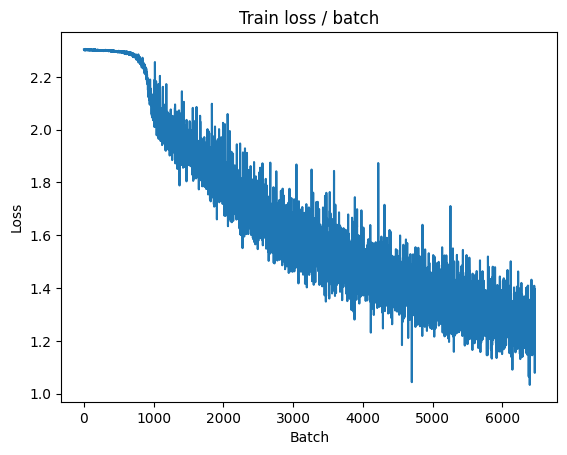


===============> Total time 9s	Avg loss 1.2442	Avg Prec@1 56.03 %	Avg Prec@5 94.62 %

[EVAL Batch 000/040]	Time 0.190s (0.190s)	Loss 1.3322 (1.3322)	Prec@1  55.5 ( 55.5)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.2824	Avg Prec@1 53.51 %	Avg Prec@5 94.51 %



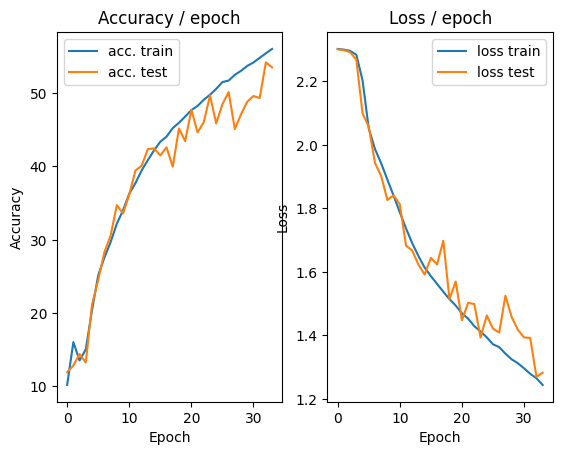

=== EPOCH 35 =====

[TRAIN Batch 000/196]	Time 0.220s (0.220s)	Loss 1.2358 (1.2358)	Prec@1  58.2 ( 58.2)	Prec@5  94.5 ( 94.5)


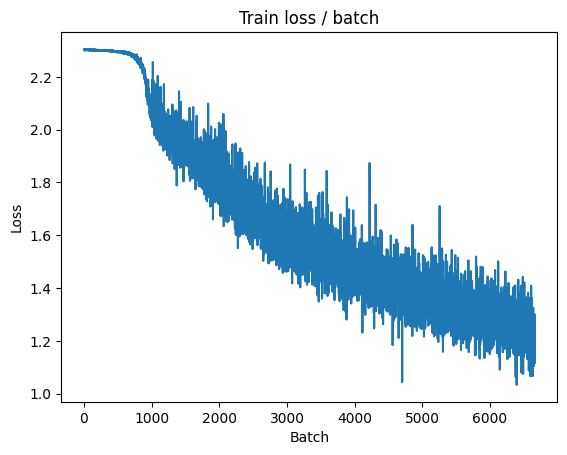


===============> Total time 9s	Avg loss 1.2344	Avg Prec@1 56.65 %	Avg Prec@5 94.75 %

[EVAL Batch 000/040]	Time 0.204s (0.204s)	Loss 1.4117 (1.4117)	Prec@1  52.0 ( 52.0)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.3467	Avg Prec@1 51.73 %	Avg Prec@5 93.84 %



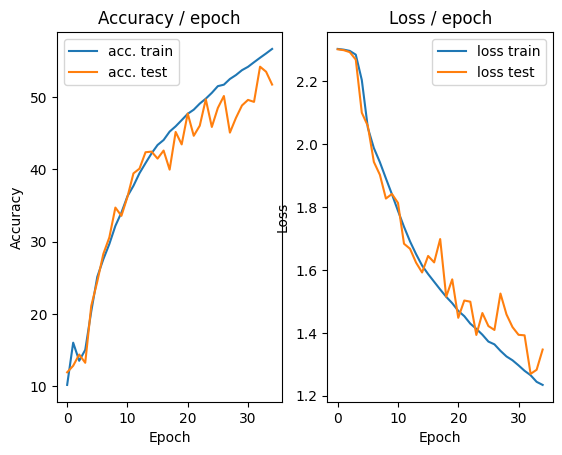

=== EPOCH 36 =====

[TRAIN Batch 000/196]	Time 0.249s (0.249s)	Loss 1.3883 (1.3883)	Prec@1  55.1 ( 55.1)	Prec@5  91.8 ( 91.8)


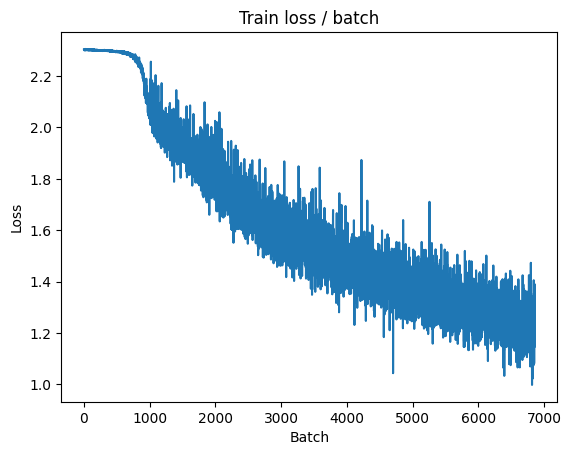


===============> Total time 8s	Avg loss 1.2174	Avg Prec@1 57.27 %	Avg Prec@5 94.84 %

[EVAL Batch 000/040]	Time 0.293s (0.293s)	Loss 1.2808 (1.2808)	Prec@1  55.9 ( 55.9)	Prec@5  96.5 ( 96.5)

===============> Total time 2s	Avg loss 1.2674	Avg Prec@1 54.30 %	Avg Prec@5 94.55 %



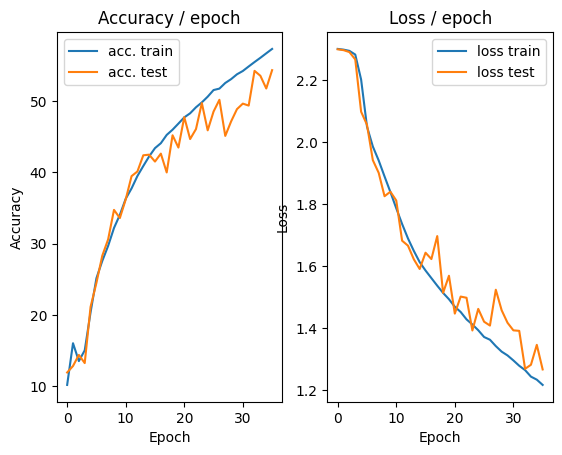

=== EPOCH 37 =====

[TRAIN Batch 000/196]	Time 0.227s (0.227s)	Loss 1.3652 (1.3652)	Prec@1  52.7 ( 52.7)	Prec@5  93.0 ( 93.0)


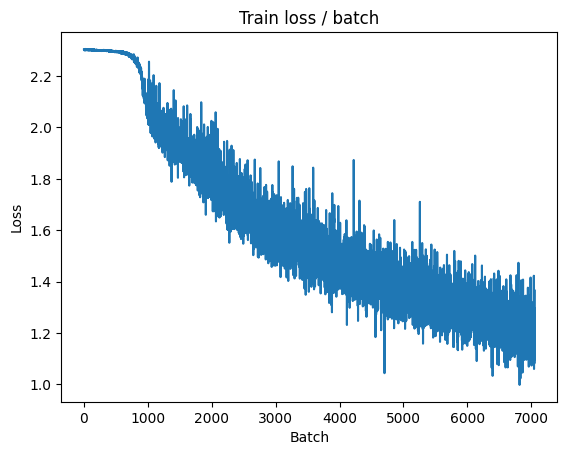


===============> Total time 8s	Avg loss 1.2038	Avg Prec@1 57.65 %	Avg Prec@5 95.00 %

[EVAL Batch 000/040]	Time 0.188s (0.188s)	Loss 1.3505 (1.3505)	Prec@1  55.1 ( 55.1)	Prec@5  94.1 ( 94.1)

===============> Total time 1s	Avg loss 1.2885	Avg Prec@1 53.58 %	Avg Prec@5 94.52 %



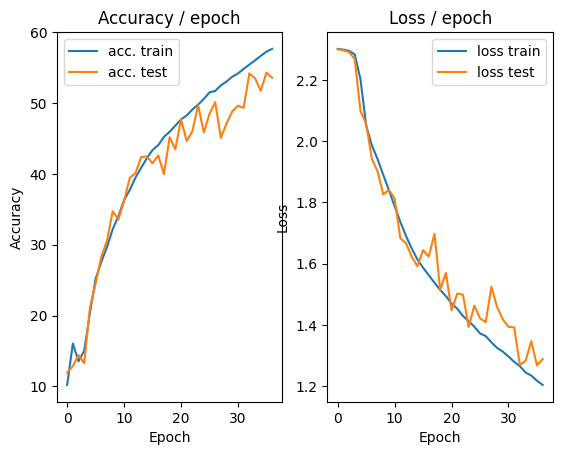

=== EPOCH 38 =====

[TRAIN Batch 000/196]	Time 0.374s (0.374s)	Loss 1.1819 (1.1819)	Prec@1  59.4 ( 59.4)	Prec@5  96.1 ( 96.1)


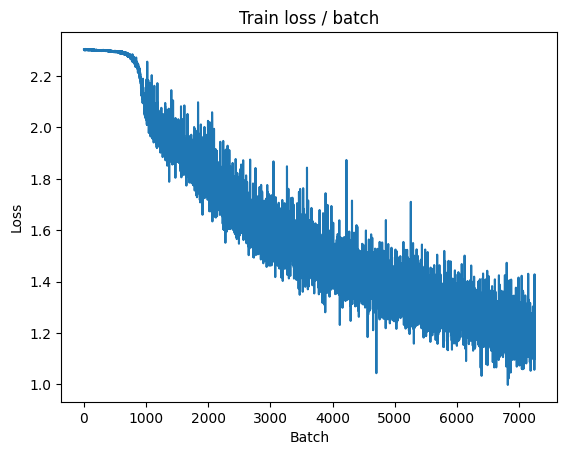


===============> Total time 8s	Avg loss 1.1816	Avg Prec@1 58.42 %	Avg Prec@5 95.29 %

[EVAL Batch 000/040]	Time 0.197s (0.197s)	Loss 1.2465 (1.2465)	Prec@1  58.2 ( 58.2)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.2540	Avg Prec@1 54.93 %	Avg Prec@5 94.93 %



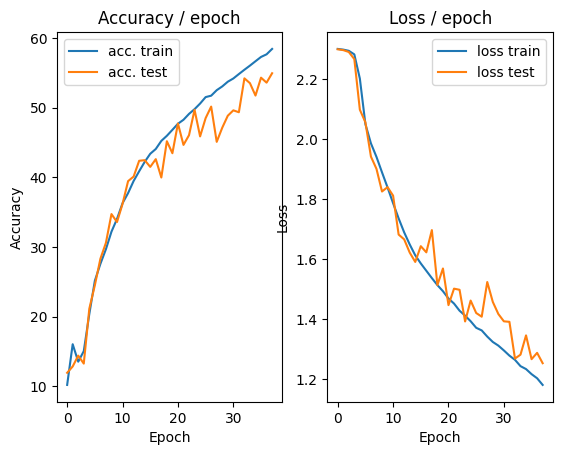

=== EPOCH 39 =====

[TRAIN Batch 000/196]	Time 0.219s (0.219s)	Loss 1.3039 (1.3039)	Prec@1  53.5 ( 53.5)	Prec@5  94.1 ( 94.1)


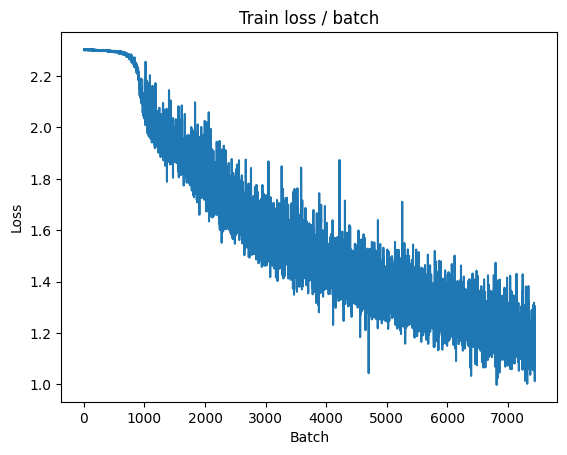


===============> Total time 9s	Avg loss 1.1715	Avg Prec@1 58.65 %	Avg Prec@5 95.39 %

[EVAL Batch 000/040]	Time 0.184s (0.184s)	Loss 1.3144 (1.3144)	Prec@1  55.9 ( 55.9)	Prec@5  93.4 ( 93.4)

===============> Total time 1s	Avg loss 1.2823	Avg Prec@1 54.85 %	Avg Prec@5 93.82 %



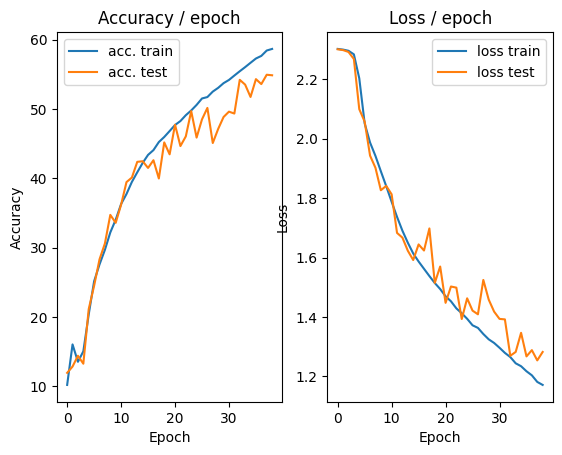

=== EPOCH 40 =====

[TRAIN Batch 000/196]	Time 0.223s (0.223s)	Loss 1.1622 (1.1622)	Prec@1  59.4 ( 59.4)	Prec@5  92.2 ( 92.2)


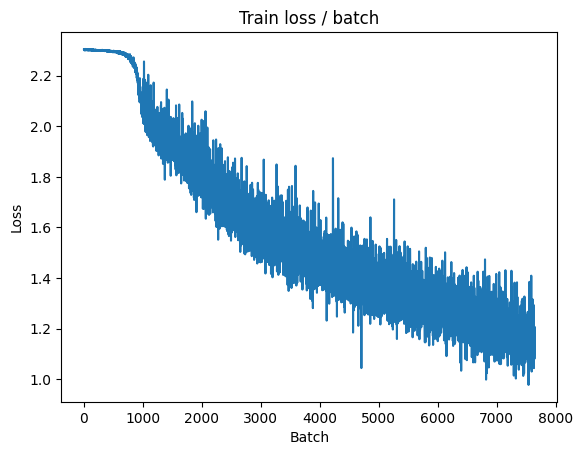


===============> Total time 9s	Avg loss 1.1596	Avg Prec@1 59.44 %	Avg Prec@5 95.43 %

[EVAL Batch 000/040]	Time 0.186s (0.186s)	Loss 1.2399 (1.2399)	Prec@1  57.8 ( 57.8)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.1892	Avg Prec@1 57.89 %	Avg Prec@5 95.24 %



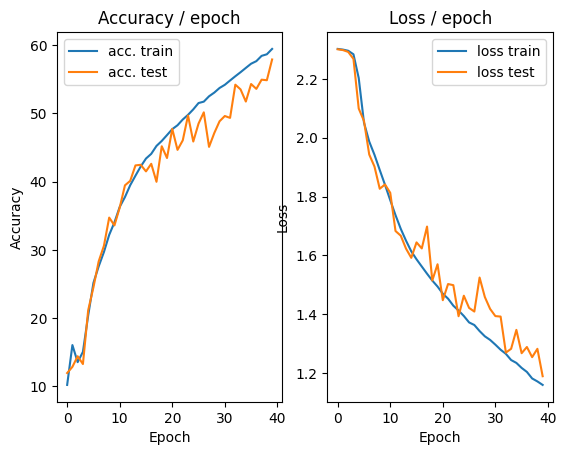

=== EPOCH 41 =====

[TRAIN Batch 000/196]	Time 0.226s (0.226s)	Loss 1.2990 (1.2990)	Prec@1  57.0 ( 57.0)	Prec@5  93.4 ( 93.4)


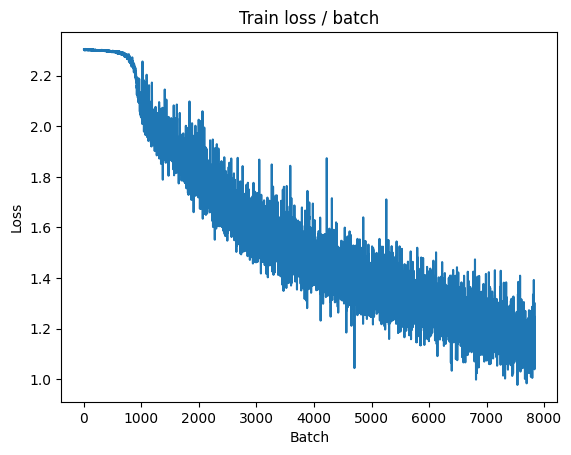


===============> Total time 9s	Avg loss 1.1411	Avg Prec@1 59.88 %	Avg Prec@5 95.62 %

[EVAL Batch 000/040]	Time 0.185s (0.185s)	Loss 1.2718 (1.2718)	Prec@1  57.8 ( 57.8)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.2299	Avg Prec@1 56.90 %	Avg Prec@5 94.85 %



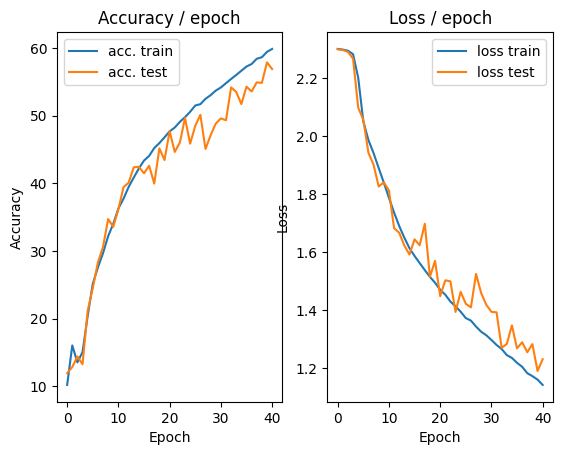

=== EPOCH 42 =====

[TRAIN Batch 000/196]	Time 0.271s (0.271s)	Loss 1.2544 (1.2544)	Prec@1  56.6 ( 56.6)	Prec@5  94.9 ( 94.9)


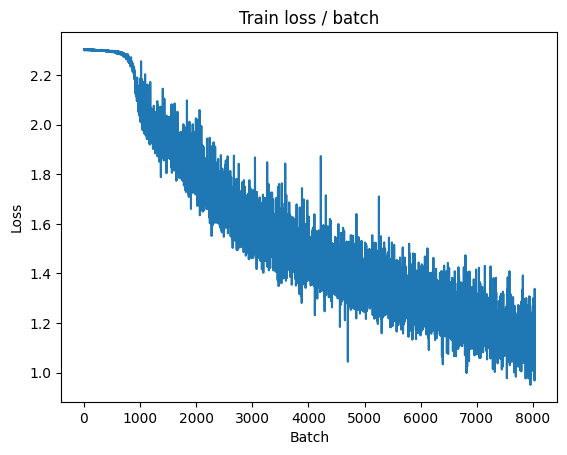


===============> Total time 9s	Avg loss 1.1281	Avg Prec@1 60.56 %	Avg Prec@5 95.77 %

[EVAL Batch 000/040]	Time 0.199s (0.199s)	Loss 1.2690 (1.2690)	Prec@1  56.6 ( 56.6)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.2589	Avg Prec@1 55.32 %	Avg Prec@5 94.91 %



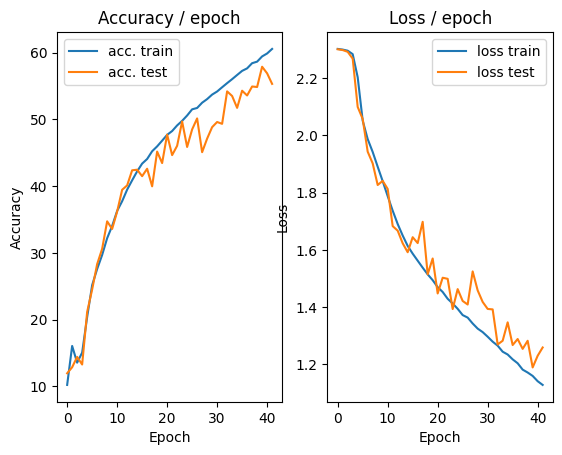

=== EPOCH 43 =====

[TRAIN Batch 000/196]	Time 0.223s (0.223s)	Loss 1.2036 (1.2036)	Prec@1  57.0 ( 57.0)	Prec@5  93.8 ( 93.8)


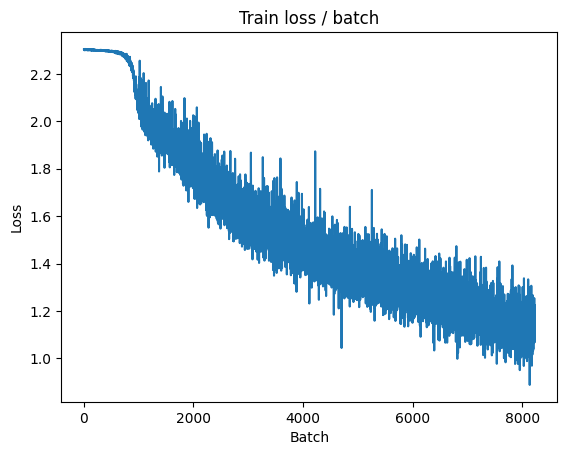


===============> Total time 9s	Avg loss 1.1096	Avg Prec@1 61.15 %	Avg Prec@5 95.77 %

[EVAL Batch 000/040]	Time 0.306s (0.306s)	Loss 1.1742 (1.1742)	Prec@1  59.4 ( 59.4)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 1.1592	Avg Prec@1 59.08 %	Avg Prec@5 95.65 %



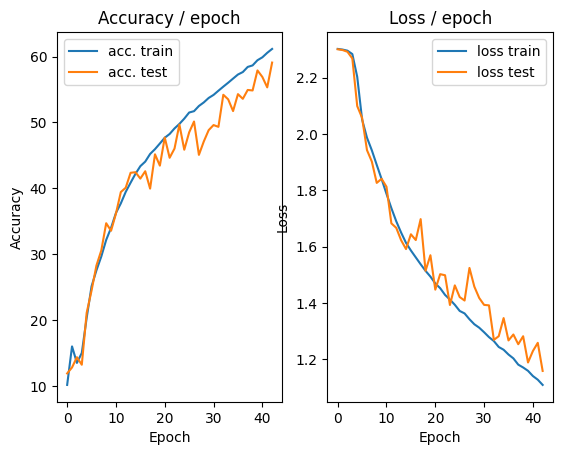

=== EPOCH 44 =====

[TRAIN Batch 000/196]	Time 0.265s (0.265s)	Loss 1.1159 (1.1159)	Prec@1  60.5 ( 60.5)	Prec@5  94.1 ( 94.1)


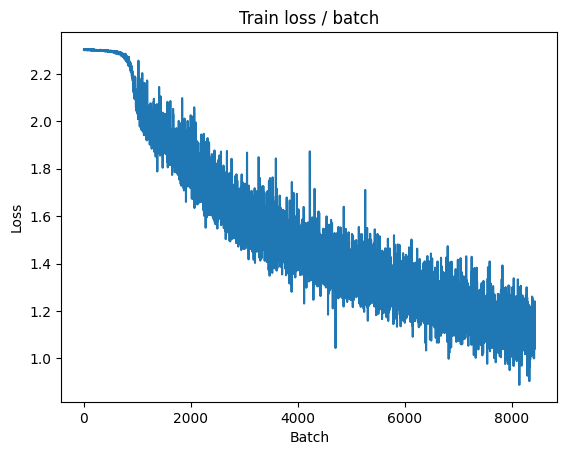


===============> Total time 8s	Avg loss 1.0980	Avg Prec@1 61.45 %	Avg Prec@5 95.92 %

[EVAL Batch 000/040]	Time 0.291s (0.291s)	Loss 1.3021 (1.3021)	Prec@1  52.7 ( 52.7)	Prec@5  94.1 ( 94.1)

===============> Total time 2s	Avg loss 1.2514	Avg Prec@1 54.67 %	Avg Prec@5 94.92 %



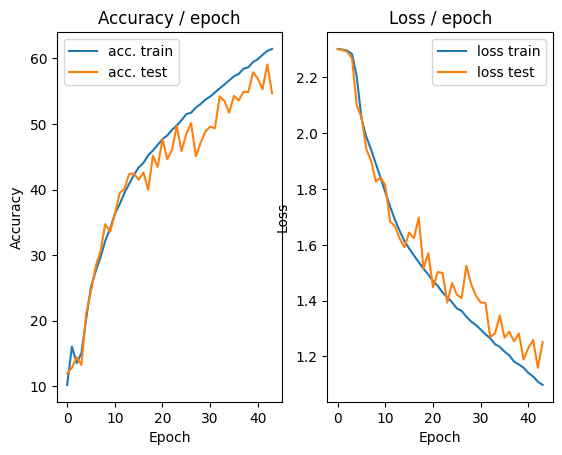

=== EPOCH 45 =====

[TRAIN Batch 000/196]	Time 0.265s (0.265s)	Loss 1.1638 (1.1638)	Prec@1  58.6 ( 58.6)	Prec@5  95.7 ( 95.7)


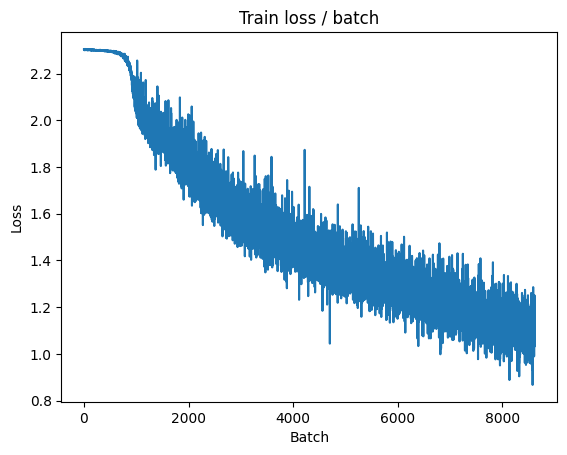


===============> Total time 8s	Avg loss 1.0867	Avg Prec@1 62.08 %	Avg Prec@5 96.06 %

[EVAL Batch 000/040]	Time 0.192s (0.192s)	Loss 1.2734 (1.2734)	Prec@1  57.4 ( 57.4)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.2480	Avg Prec@1 55.40 %	Avg Prec@5 95.17 %



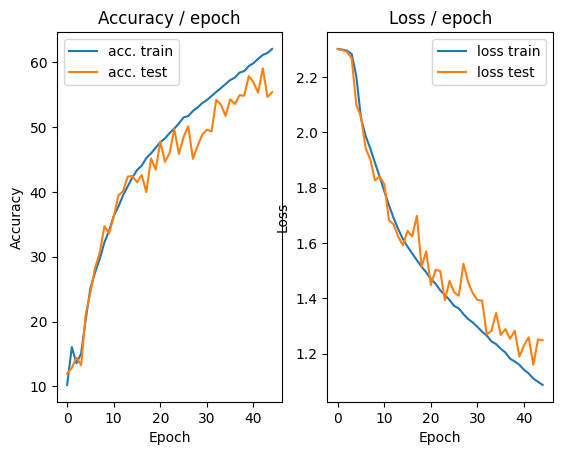

=== EPOCH 46 =====

[TRAIN Batch 000/196]	Time 0.312s (0.312s)	Loss 1.1225 (1.1225)	Prec@1  59.4 ( 59.4)	Prec@5  95.7 ( 95.7)


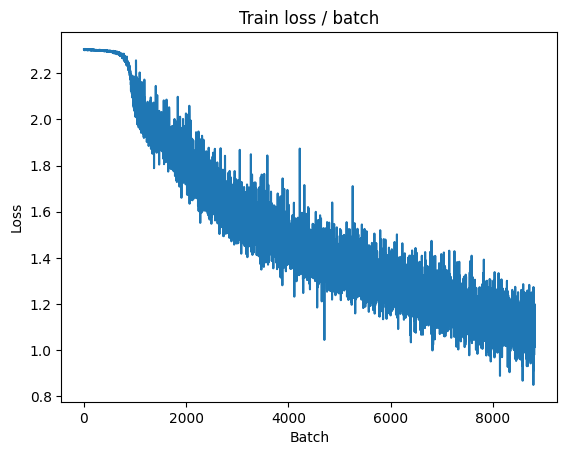


===============> Total time 8s	Avg loss 1.0740	Avg Prec@1 62.56 %	Avg Prec@5 96.07 %

[EVAL Batch 000/040]	Time 0.193s (0.193s)	Loss 1.1562 (1.1562)	Prec@1  60.2 ( 60.2)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 1.1467	Avg Prec@1 59.20 %	Avg Prec@5 95.60 %



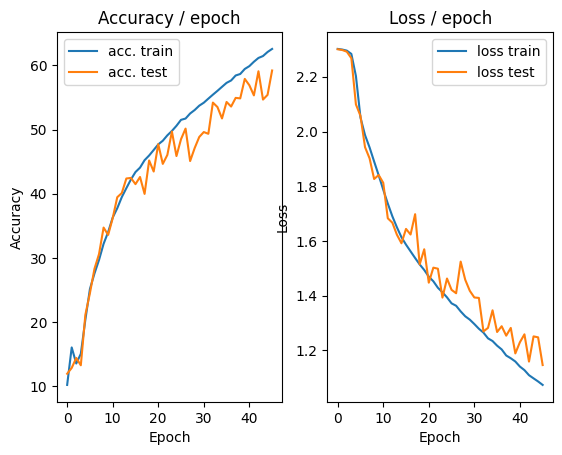

=== EPOCH 47 =====

[TRAIN Batch 000/196]	Time 0.261s (0.261s)	Loss 0.9788 (0.9788)	Prec@1  64.5 ( 64.5)	Prec@5  96.9 ( 96.9)


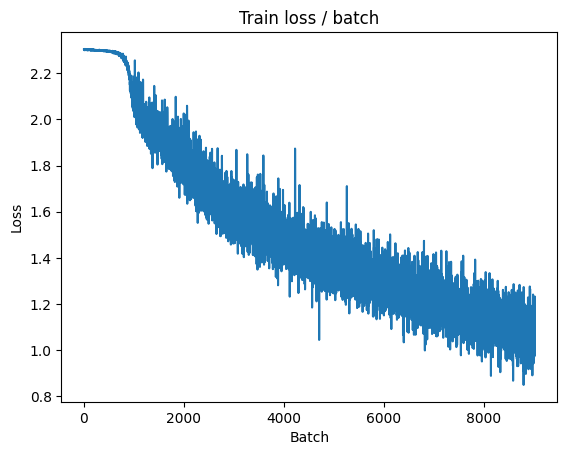


===============> Total time 9s	Avg loss 1.0578	Avg Prec@1 63.06 %	Avg Prec@5 96.28 %

[EVAL Batch 000/040]	Time 0.205s (0.205s)	Loss 1.2720 (1.2720)	Prec@1  56.2 ( 56.2)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2730	Avg Prec@1 53.84 %	Avg Prec@5 95.28 %



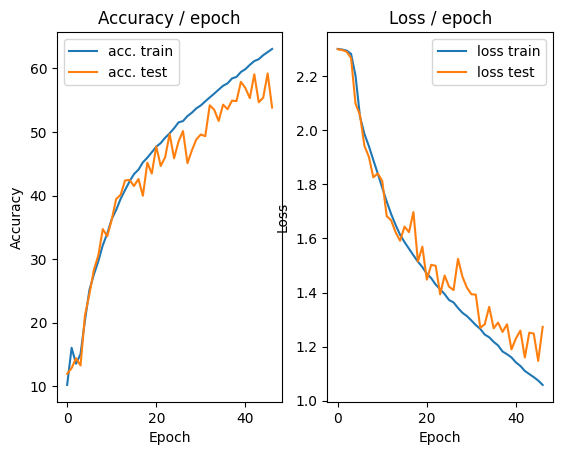

=== EPOCH 48 =====

[TRAIN Batch 000/196]	Time 0.271s (0.271s)	Loss 1.2169 (1.2169)	Prec@1  55.5 ( 55.5)	Prec@5  94.5 ( 94.5)


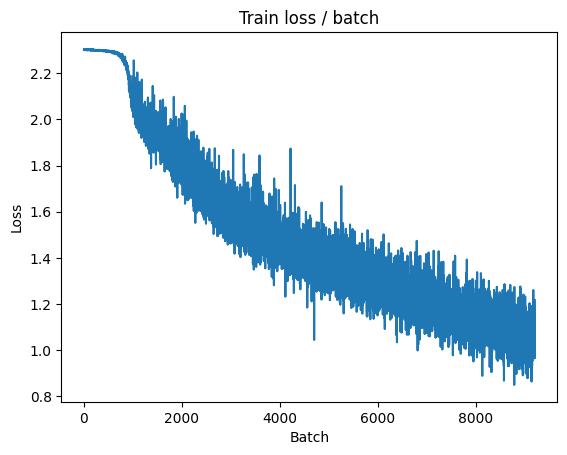


===============> Total time 9s	Avg loss 1.0472	Avg Prec@1 63.61 %	Avg Prec@5 96.32 %

[EVAL Batch 000/040]	Time 0.193s (0.193s)	Loss 1.1862 (1.1862)	Prec@1  56.6 ( 56.6)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 1.1518	Avg Prec@1 59.01 %	Avg Prec@5 95.57 %



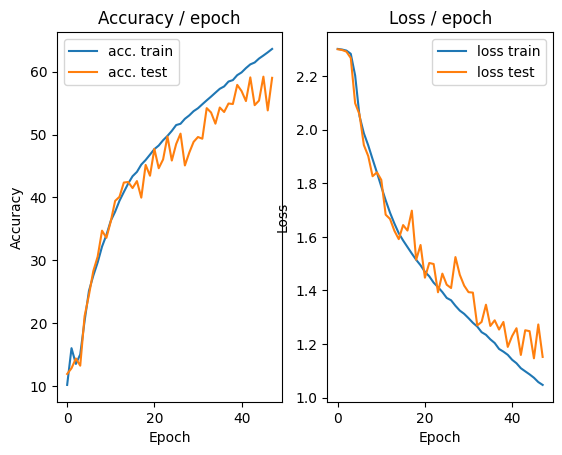

=== EPOCH 49 =====

[TRAIN Batch 000/196]	Time 0.260s (0.260s)	Loss 1.1415 (1.1415)	Prec@1  59.8 ( 59.8)	Prec@5  94.1 ( 94.1)


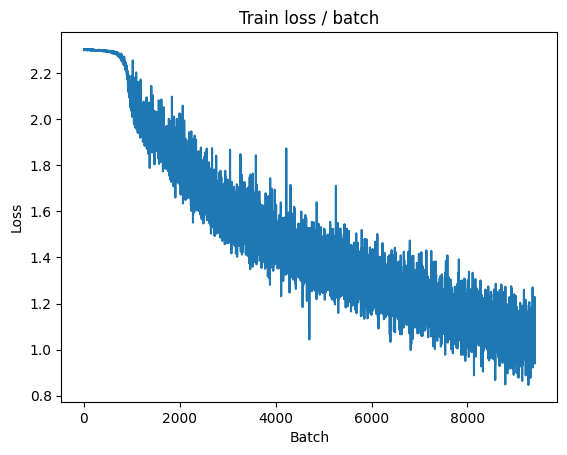


===============> Total time 9s	Avg loss 1.0334	Avg Prec@1 64.01 %	Avg Prec@5 96.43 %

[EVAL Batch 000/040]	Time 0.188s (0.188s)	Loss 1.3354 (1.3354)	Prec@1  53.9 ( 53.9)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.2979	Avg Prec@1 53.97 %	Avg Prec@5 94.80 %



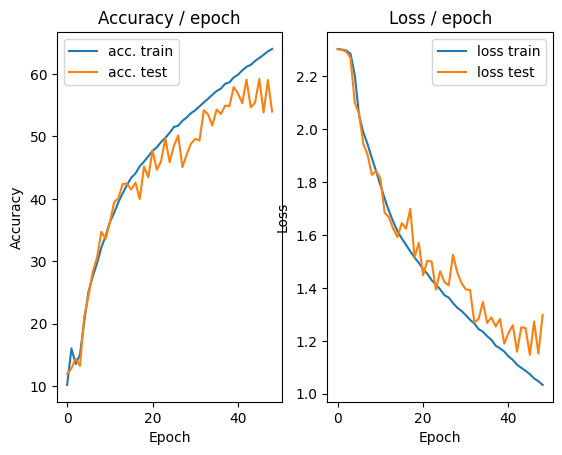

=== EPOCH 50 =====

[TRAIN Batch 000/196]	Time 0.216s (0.216s)	Loss 1.4318 (1.4318)	Prec@1  53.9 ( 53.9)	Prec@5  92.2 ( 92.2)


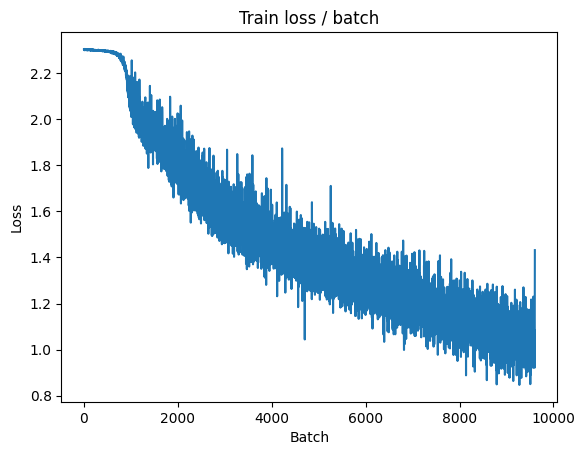


===============> Total time 9s	Avg loss 1.0177	Avg Prec@1 64.55 %	Avg Prec@5 96.54 %

[EVAL Batch 000/040]	Time 0.202s (0.202s)	Loss 1.1532 (1.1532)	Prec@1  61.3 ( 61.3)	Prec@5  94.1 ( 94.1)

===============> Total time 1s	Avg loss 1.2064	Avg Prec@1 57.66 %	Avg Prec@5 94.77 %



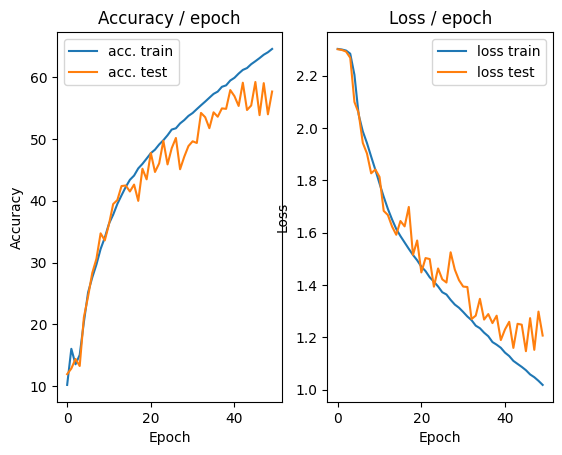

=== EPOCH 51 =====

[TRAIN Batch 000/196]	Time 0.248s (0.248s)	Loss 0.9829 (0.9829)	Prec@1  66.4 ( 66.4)	Prec@5  97.3 ( 97.3)


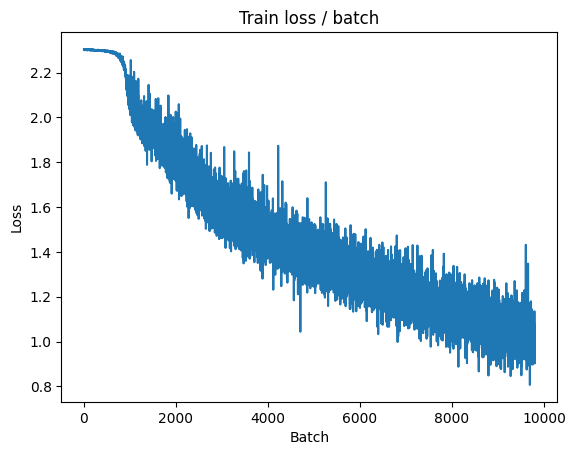


===============> Total time 9s	Avg loss 1.0024	Avg Prec@1 64.96 %	Avg Prec@5 96.61 %

[EVAL Batch 000/040]	Time 0.205s (0.205s)	Loss 1.2466 (1.2466)	Prec@1  58.6 ( 58.6)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.1791	Avg Prec@1 58.37 %	Avg Prec@5 95.52 %



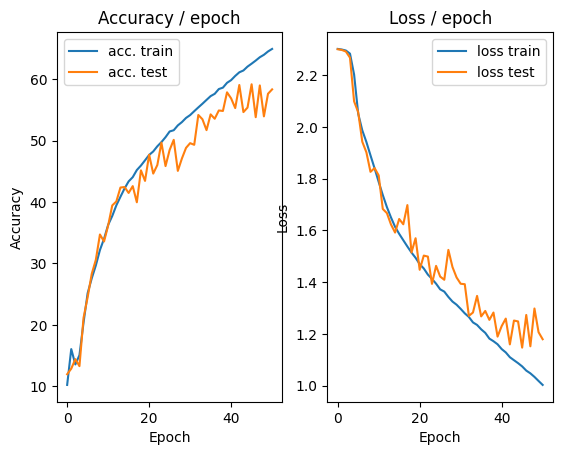

=== EPOCH 52 =====

[TRAIN Batch 000/196]	Time 0.221s (0.221s)	Loss 1.0320 (1.0320)	Prec@1  62.1 ( 62.1)	Prec@5  96.5 ( 96.5)


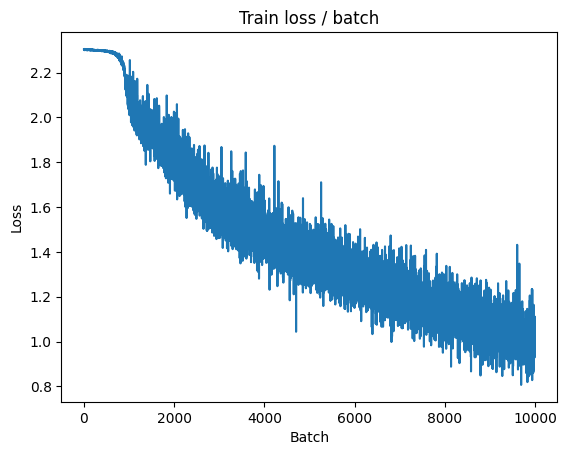


===============> Total time 8s	Avg loss 0.9909	Avg Prec@1 65.52 %	Avg Prec@5 96.72 %

[EVAL Batch 000/040]	Time 0.315s (0.315s)	Loss 1.1686 (1.1686)	Prec@1  61.7 ( 61.7)	Prec@5  94.1 ( 94.1)

===============> Total time 2s	Avg loss 1.1238	Avg Prec@1 60.13 %	Avg Prec@5 95.77 %



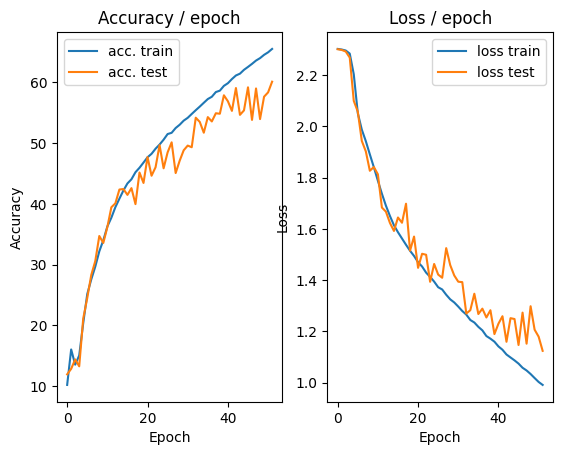

=== EPOCH 53 =====

[TRAIN Batch 000/196]	Time 0.227s (0.227s)	Loss 0.9886 (0.9886)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)


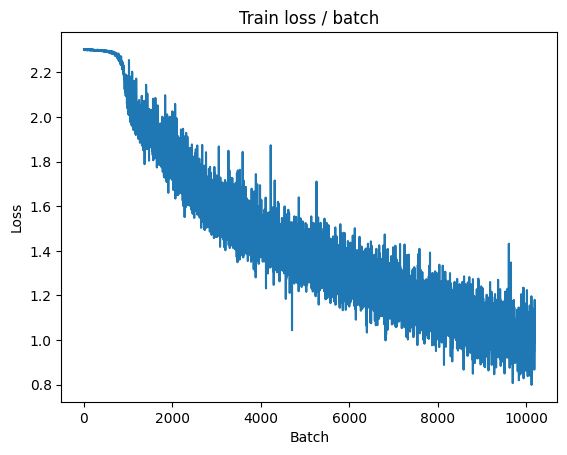


===============> Total time 8s	Avg loss 0.9791	Avg Prec@1 66.25 %	Avg Prec@5 96.74 %

[EVAL Batch 000/040]	Time 0.196s (0.196s)	Loss 1.3248 (1.3248)	Prec@1  53.1 ( 53.1)	Prec@5  94.9 ( 94.9)

===============> Total time 2s	Avg loss 1.2351	Avg Prec@1 56.15 %	Avg Prec@5 95.39 %



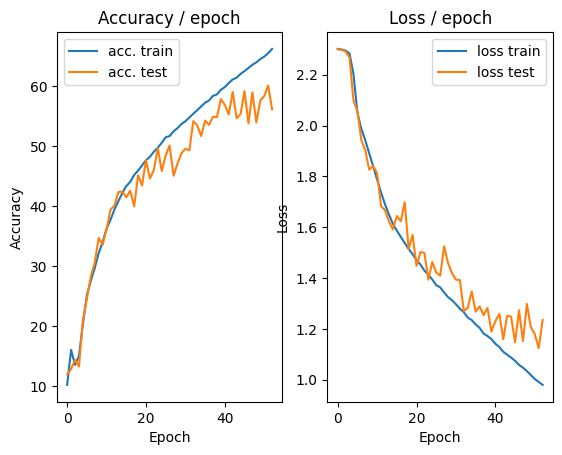

=== EPOCH 54 =====

[TRAIN Batch 000/196]	Time 0.323s (0.323s)	Loss 1.1688 (1.1688)	Prec@1  60.9 ( 60.9)	Prec@5  94.9 ( 94.9)


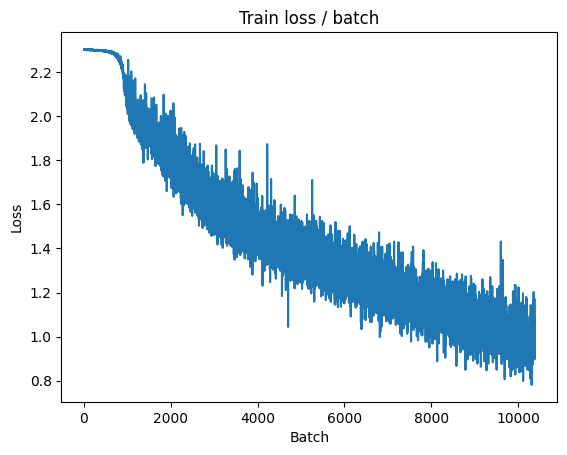


===============> Total time 8s	Avg loss 0.9677	Avg Prec@1 66.22 %	Avg Prec@5 96.92 %

[EVAL Batch 000/040]	Time 0.201s (0.201s)	Loss 1.2372 (1.2372)	Prec@1  58.6 ( 58.6)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1909	Avg Prec@1 57.60 %	Avg Prec@5 95.50 %



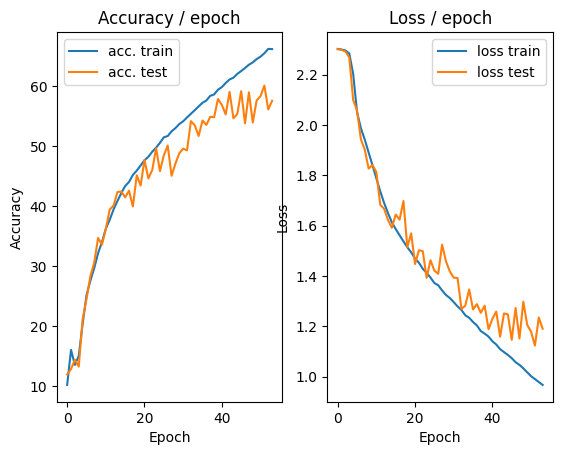

=== EPOCH 55 =====

[TRAIN Batch 000/196]	Time 0.225s (0.225s)	Loss 1.0585 (1.0585)	Prec@1  62.9 ( 62.9)	Prec@5  96.5 ( 96.5)


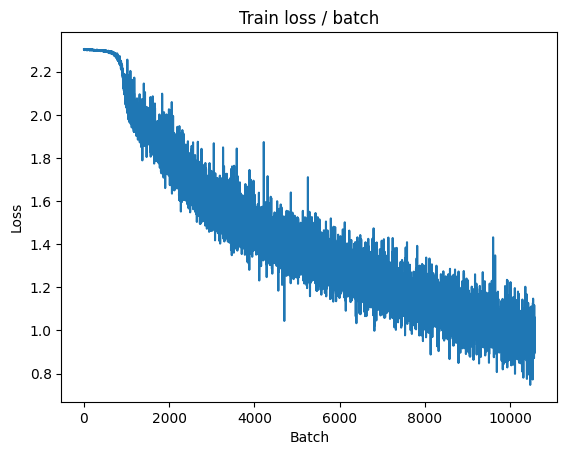


===============> Total time 9s	Avg loss 0.9584	Avg Prec@1 66.73 %	Avg Prec@5 97.05 %

[EVAL Batch 000/040]	Time 0.204s (0.204s)	Loss 1.2947 (1.2947)	Prec@1  55.9 ( 55.9)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.2515	Avg Prec@1 56.26 %	Avg Prec@5 95.14 %



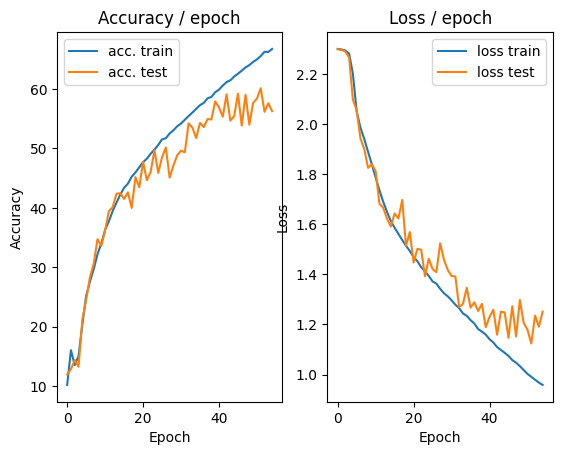

=== EPOCH 56 =====

[TRAIN Batch 000/196]	Time 0.291s (0.291s)	Loss 0.9598 (0.9598)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)


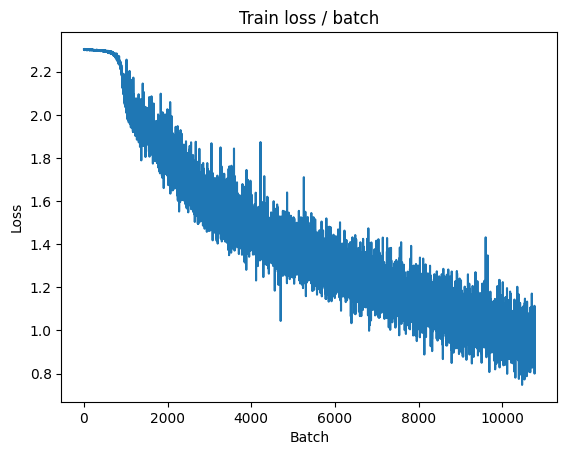


===============> Total time 9s	Avg loss 0.9394	Avg Prec@1 67.38 %	Avg Prec@5 97.09 %

[EVAL Batch 000/040]	Time 0.202s (0.202s)	Loss 1.1369 (1.1369)	Prec@1  61.3 ( 61.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0872	Avg Prec@1 61.58 %	Avg Prec@5 96.24 %



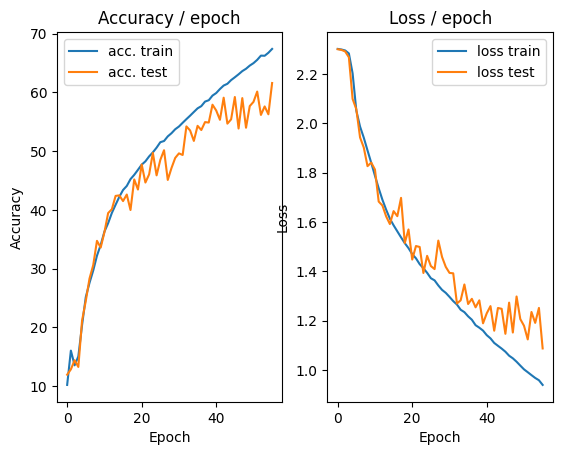

=== EPOCH 57 =====

[TRAIN Batch 000/196]	Time 0.296s (0.296s)	Loss 0.8891 (0.8891)	Prec@1  68.0 ( 68.0)	Prec@5  97.3 ( 97.3)


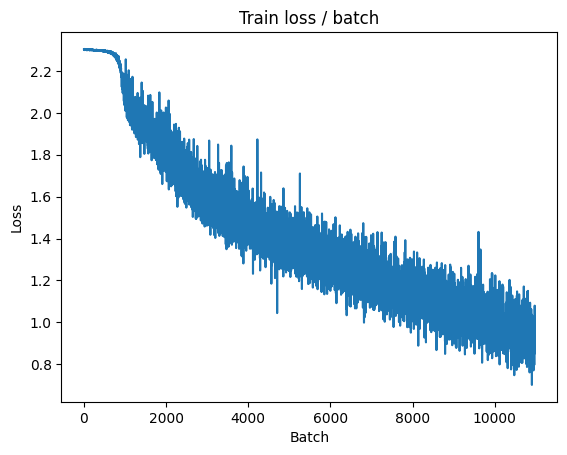


===============> Total time 9s	Avg loss 0.9283	Avg Prec@1 67.70 %	Avg Prec@5 97.22 %

[EVAL Batch 000/040]	Time 0.214s (0.214s)	Loss 1.0675 (1.0675)	Prec@1  62.9 ( 62.9)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 1.0762	Avg Prec@1 61.10 %	Avg Prec@5 96.45 %



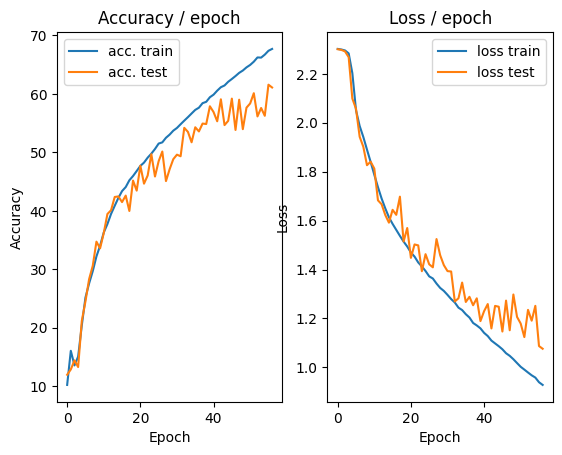

=== EPOCH 58 =====

[TRAIN Batch 000/196]	Time 0.287s (0.287s)	Loss 0.9559 (0.9559)	Prec@1  69.1 ( 69.1)	Prec@5  95.3 ( 95.3)


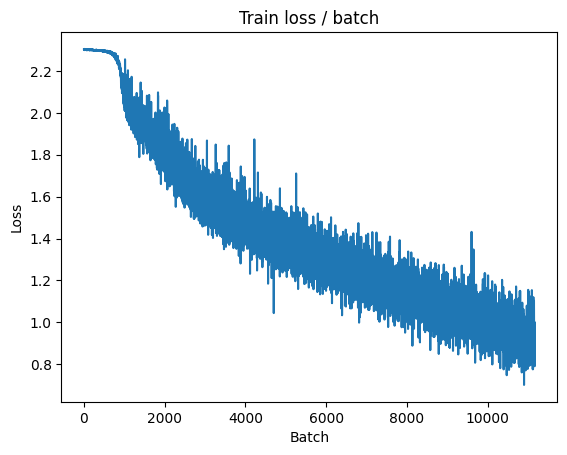


===============> Total time 9s	Avg loss 0.9249	Avg Prec@1 67.81 %	Avg Prec@5 97.23 %

[EVAL Batch 000/040]	Time 0.190s (0.190s)	Loss 1.1783 (1.1783)	Prec@1  58.6 ( 58.6)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1462	Avg Prec@1 59.14 %	Avg Prec@5 96.19 %



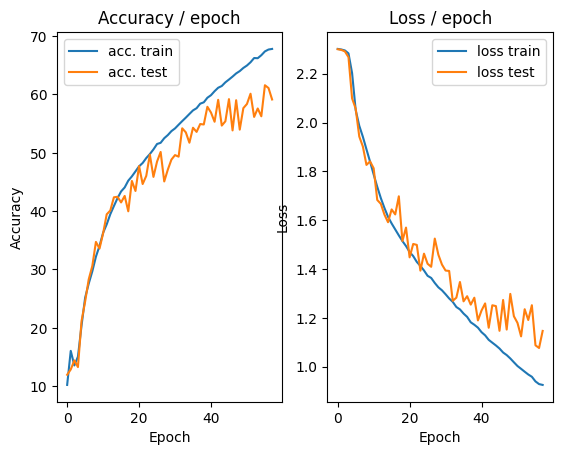

=== EPOCH 59 =====

[TRAIN Batch 000/196]	Time 0.227s (0.227s)	Loss 0.9544 (0.9544)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)


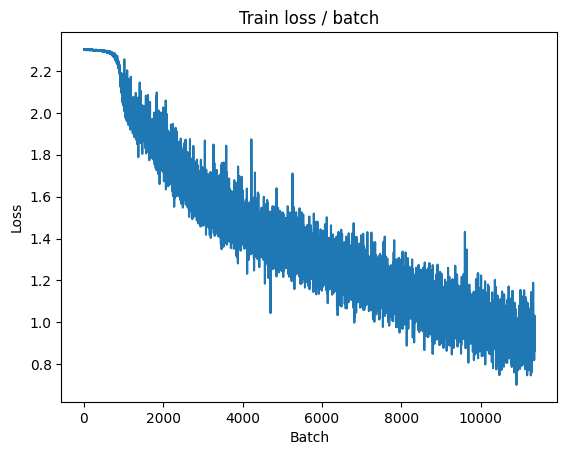


===============> Total time 9s	Avg loss 0.9074	Avg Prec@1 68.40 %	Avg Prec@5 97.29 %

[EVAL Batch 000/040]	Time 0.228s (0.228s)	Loss 1.1048 (1.1048)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.0598	Avg Prec@1 62.59 %	Avg Prec@5 96.52 %



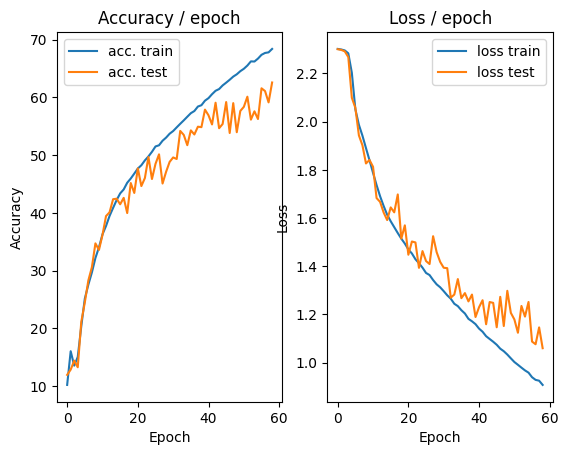

=== EPOCH 60 =====

[TRAIN Batch 000/196]	Time 0.256s (0.256s)	Loss 0.7927 (0.7927)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)


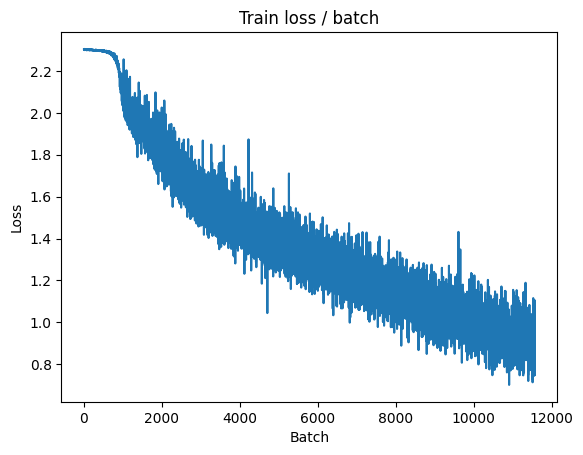


===============> Total time 9s	Avg loss 0.8993	Avg Prec@1 68.79 %	Avg Prec@5 97.46 %

[EVAL Batch 000/040]	Time 0.285s (0.285s)	Loss 1.1606 (1.1606)	Prec@1  58.6 ( 58.6)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.1343	Avg Prec@1 59.45 %	Avg Prec@5 96.17 %



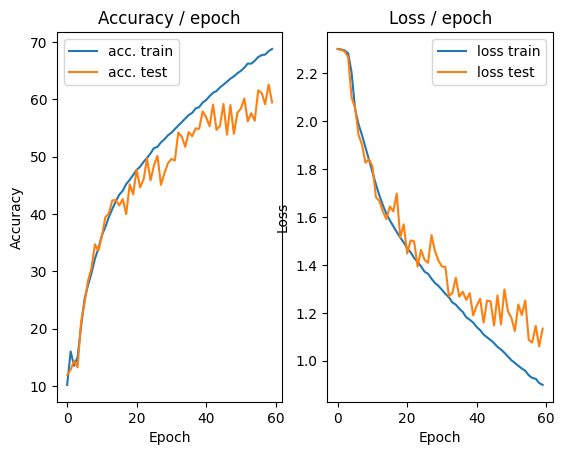

=== EPOCH 61 =====

[TRAIN Batch 000/196]	Time 0.213s (0.213s)	Loss 0.8872 (0.8872)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)


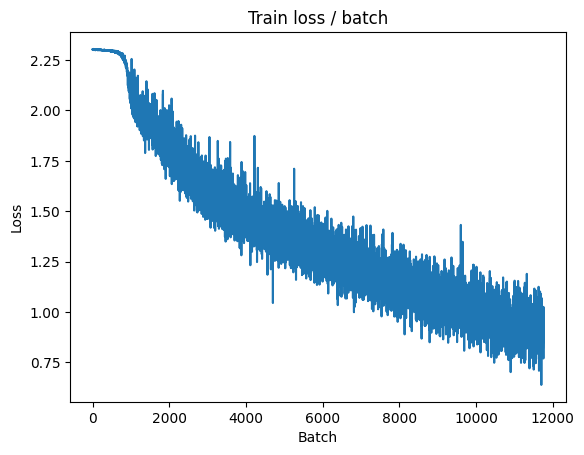


===============> Total time 8s	Avg loss 0.8800	Avg Prec@1 69.68 %	Avg Prec@5 97.46 %

[EVAL Batch 000/040]	Time 0.316s (0.316s)	Loss 1.2178 (1.2178)	Prec@1  58.6 ( 58.6)	Prec@5  94.9 ( 94.9)

===============> Total time 2s	Avg loss 1.1731	Avg Prec@1 59.34 %	Avg Prec@5 95.58 %



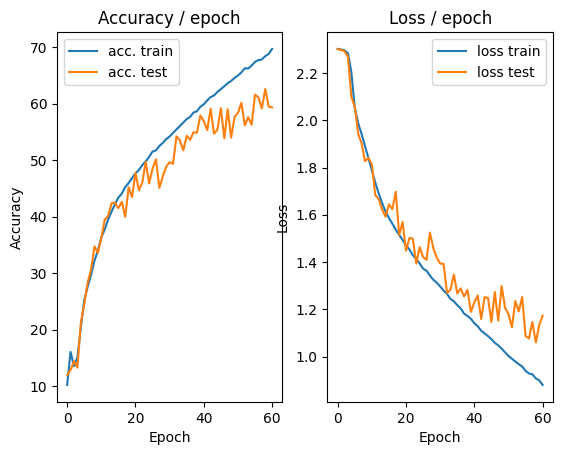

=== EPOCH 62 =====

[TRAIN Batch 000/196]	Time 0.262s (0.262s)	Loss 0.9565 (0.9565)	Prec@1  62.9 ( 62.9)	Prec@5  98.0 ( 98.0)


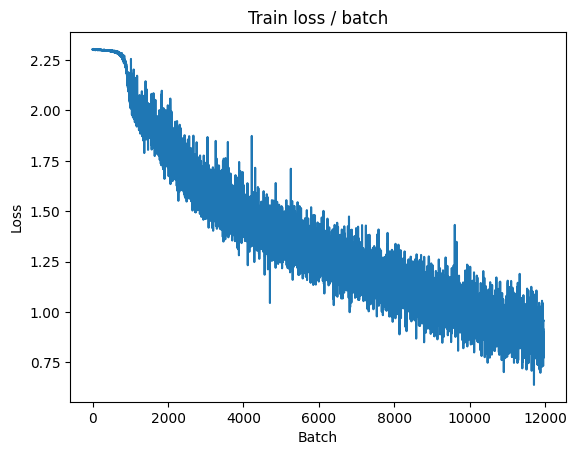


===============> Total time 8s	Avg loss 0.8679	Avg Prec@1 69.82 %	Avg Prec@5 97.49 %

[EVAL Batch 000/040]	Time 0.193s (0.193s)	Loss 1.1275 (1.1275)	Prec@1  59.4 ( 59.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0639	Avg Prec@1 62.53 %	Avg Prec@5 96.38 %



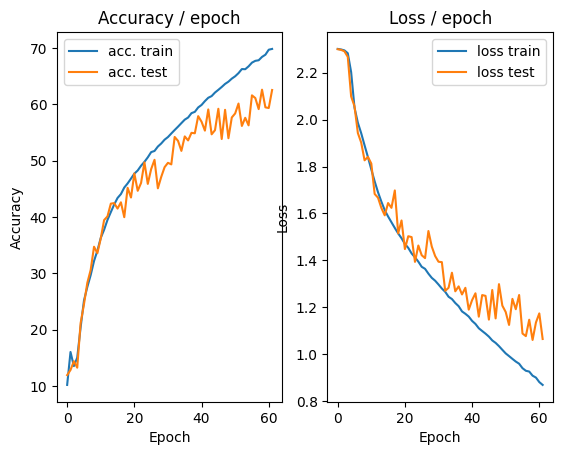

=== EPOCH 63 =====

[TRAIN Batch 000/196]	Time 0.397s (0.397s)	Loss 0.8734 (0.8734)	Prec@1  69.1 ( 69.1)	Prec@5  96.9 ( 96.9)


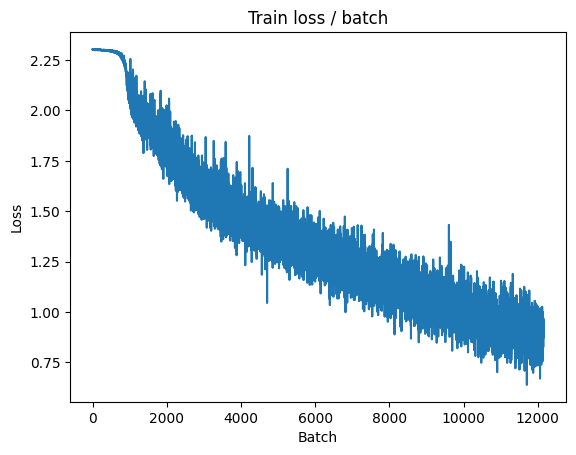


===============> Total time 8s	Avg loss 0.8627	Avg Prec@1 70.08 %	Avg Prec@5 97.57 %

[EVAL Batch 000/040]	Time 0.189s (0.189s)	Loss 1.1361 (1.1361)	Prec@1  64.1 ( 64.1)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.1335	Avg Prec@1 61.04 %	Avg Prec@5 95.85 %



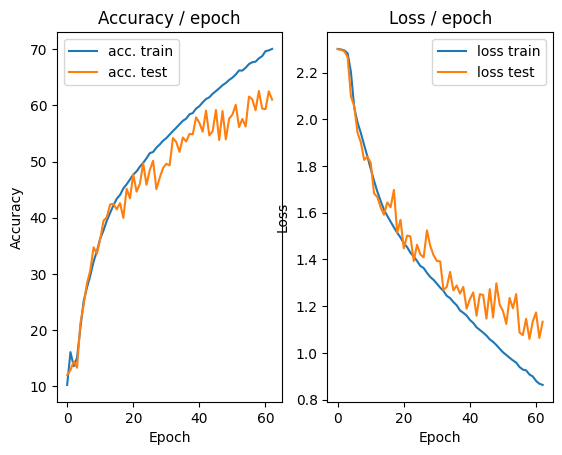

=== EPOCH 64 =====

[TRAIN Batch 000/196]	Time 0.269s (0.269s)	Loss 0.9305 (0.9305)	Prec@1  69.5 ( 69.5)	Prec@5  96.5 ( 96.5)


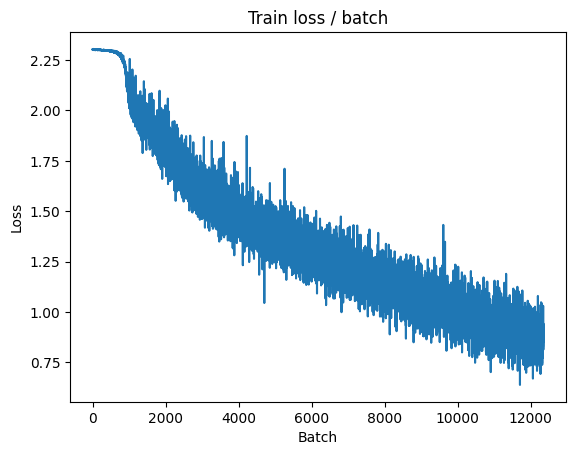


===============> Total time 9s	Avg loss 0.8426	Avg Prec@1 70.77 %	Avg Prec@5 97.62 %

[EVAL Batch 000/040]	Time 0.187s (0.187s)	Loss 1.0818 (1.0818)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.0857	Avg Prec@1 62.39 %	Avg Prec@5 95.74 %



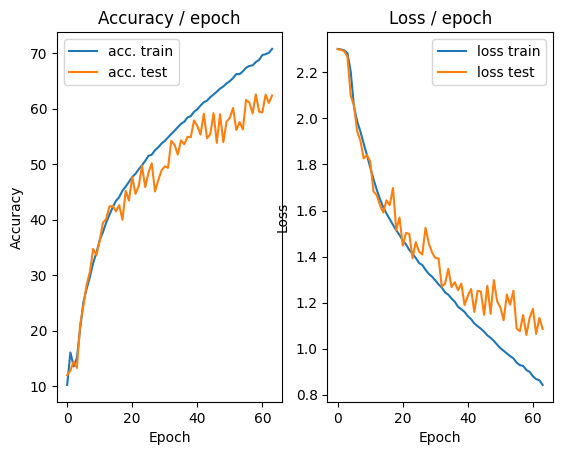

=== EPOCH 65 =====

[TRAIN Batch 000/196]	Time 0.235s (0.235s)	Loss 0.8977 (0.8977)	Prec@1  68.0 ( 68.0)	Prec@5  97.3 ( 97.3)


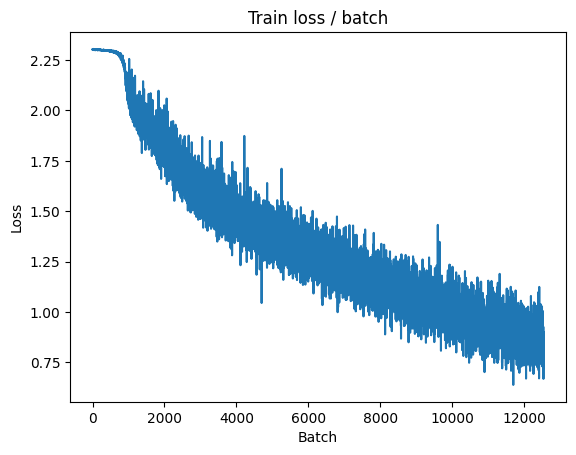


===============> Total time 9s	Avg loss 0.8352	Avg Prec@1 71.12 %	Avg Prec@5 97.69 %

[EVAL Batch 000/040]	Time 0.197s (0.197s)	Loss 1.0692 (1.0692)	Prec@1  64.5 ( 64.5)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0505	Avg Prec@1 63.00 %	Avg Prec@5 96.46 %



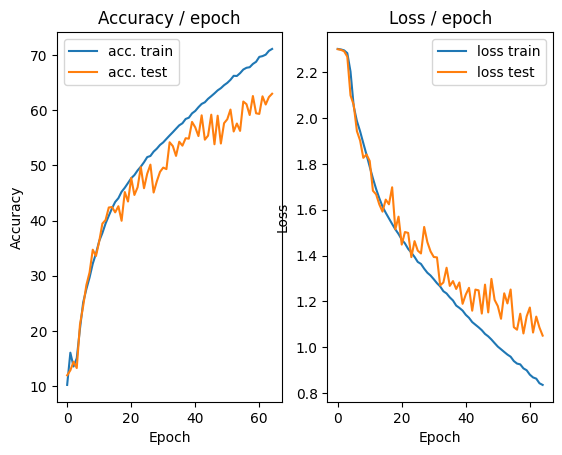

=== EPOCH 66 =====

[TRAIN Batch 000/196]	Time 0.304s (0.304s)	Loss 0.8769 (0.8769)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)


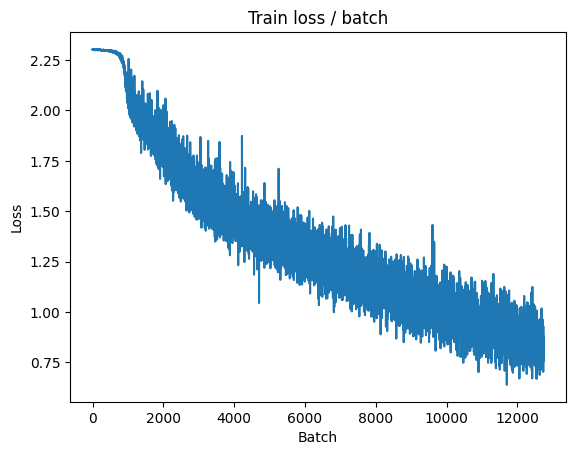


===============> Total time 9s	Avg loss 0.8260	Avg Prec@1 71.27 %	Avg Prec@5 97.87 %

[EVAL Batch 000/040]	Time 0.198s (0.198s)	Loss 1.1408 (1.1408)	Prec@1  62.5 ( 62.5)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.1002	Avg Prec@1 62.12 %	Avg Prec@5 96.33 %



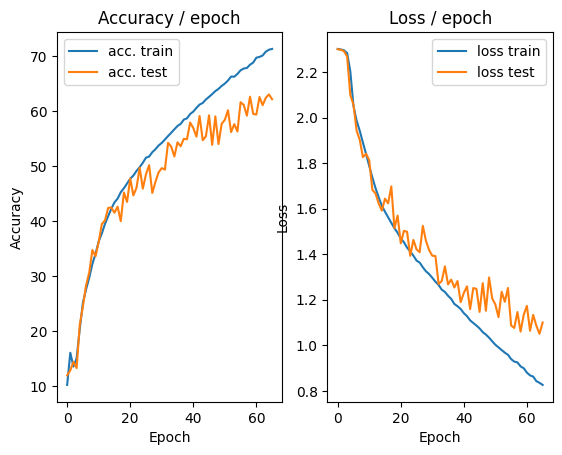

=== EPOCH 67 =====

[TRAIN Batch 000/196]	Time 0.253s (0.253s)	Loss 0.9505 (0.9505)	Prec@1  68.0 ( 68.0)	Prec@5  98.0 ( 98.0)


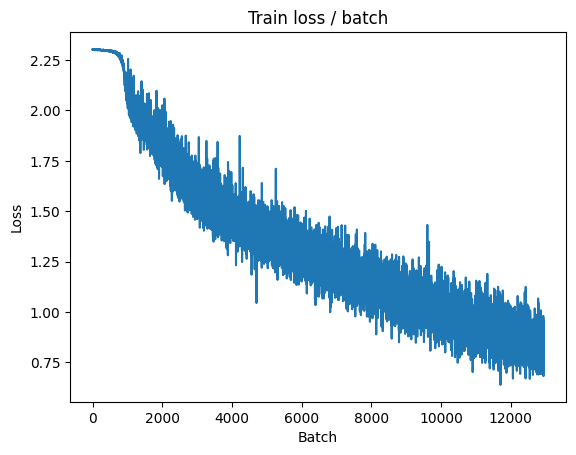


===============> Total time 9s	Avg loss 0.8139	Avg Prec@1 71.69 %	Avg Prec@5 97.87 %

[EVAL Batch 000/040]	Time 0.195s (0.195s)	Loss 1.1134 (1.1134)	Prec@1  59.8 ( 59.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.1161	Avg Prec@1 60.89 %	Avg Prec@5 96.32 %



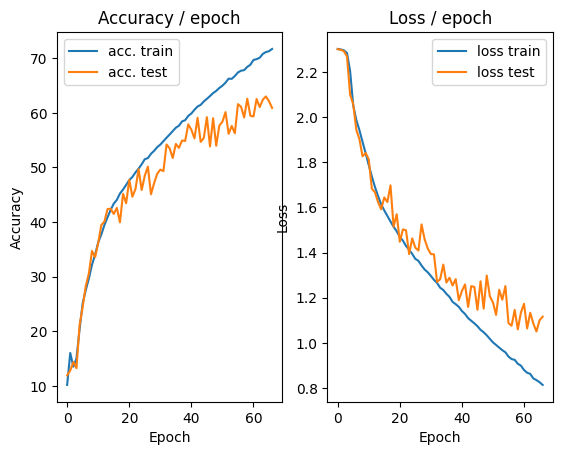

=== EPOCH 68 =====

[TRAIN Batch 000/196]	Time 0.300s (0.300s)	Loss 0.9719 (0.9719)	Prec@1  64.1 ( 64.1)	Prec@5  97.7 ( 97.7)


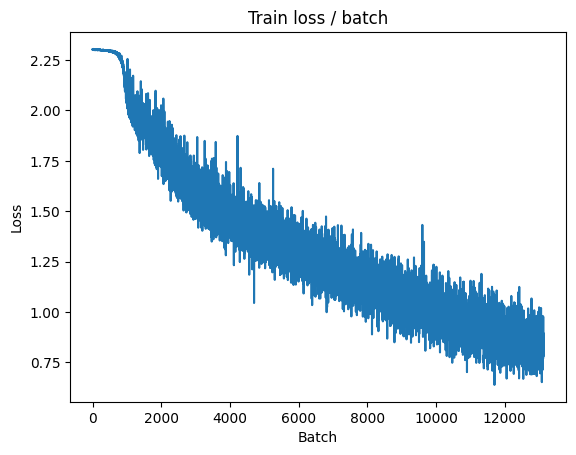


===============> Total time 9s	Avg loss 0.7938	Avg Prec@1 72.57 %	Avg Prec@5 98.08 %

[EVAL Batch 000/040]	Time 0.218s (0.218s)	Loss 1.3340 (1.3340)	Prec@1  59.4 ( 59.4)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2440	Avg Prec@1 58.26 %	Avg Prec@5 95.28 %



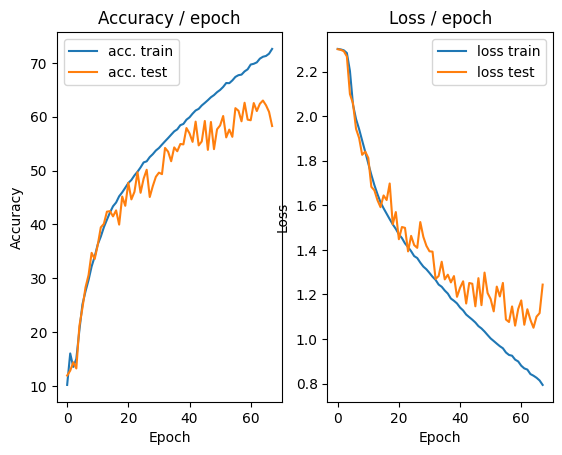

=== EPOCH 69 =====

[TRAIN Batch 000/196]	Time 0.278s (0.278s)	Loss 1.0345 (1.0345)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)


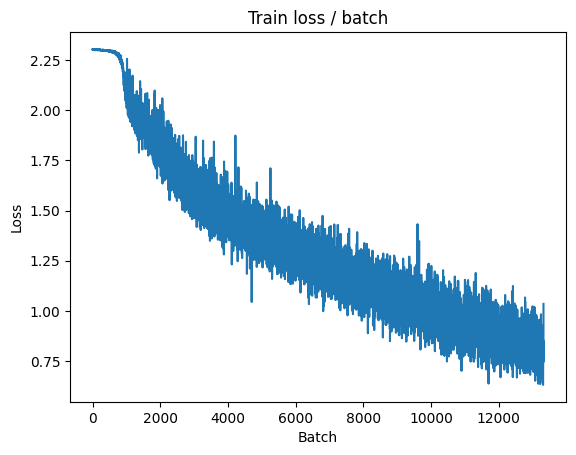


===============> Total time 9s	Avg loss 0.7910	Avg Prec@1 72.72 %	Avg Prec@5 98.02 %

[EVAL Batch 000/040]	Time 0.275s (0.275s)	Loss 1.0907 (1.0907)	Prec@1  62.5 ( 62.5)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.0659	Avg Prec@1 63.54 %	Avg Prec@5 96.46 %



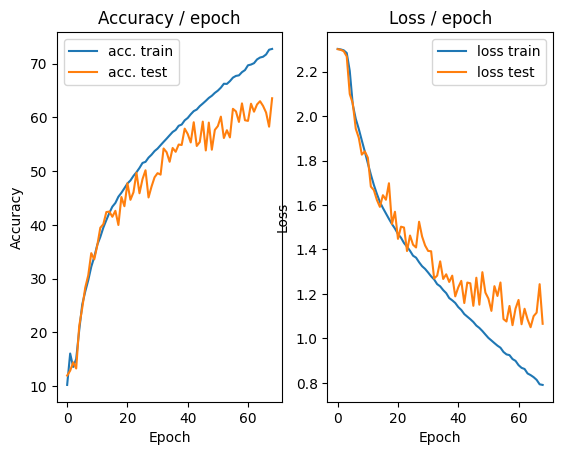

=== EPOCH 70 =====

[TRAIN Batch 000/196]	Time 0.269s (0.269s)	Loss 0.9933 (0.9933)	Prec@1  64.1 ( 64.1)	Prec@5  97.3 ( 97.3)


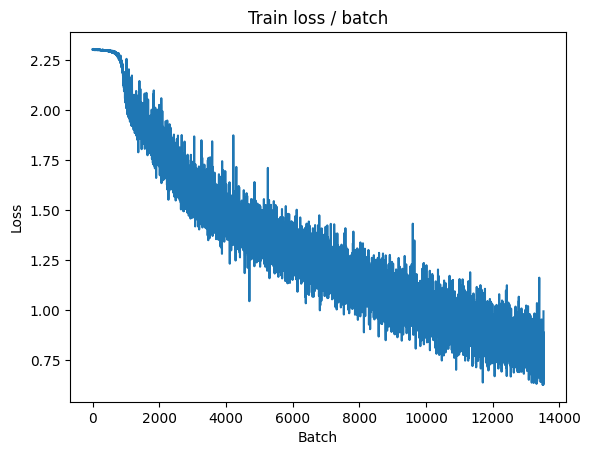


===============> Total time 8s	Avg loss 0.7758	Avg Prec@1 73.33 %	Avg Prec@5 98.07 %

[EVAL Batch 000/040]	Time 0.219s (0.219s)	Loss 1.0725 (1.0725)	Prec@1  64.5 ( 64.5)	Prec@5  97.3 ( 97.3)

===============> Total time 2s	Avg loss 1.0961	Avg Prec@1 61.88 %	Avg Prec@5 96.21 %



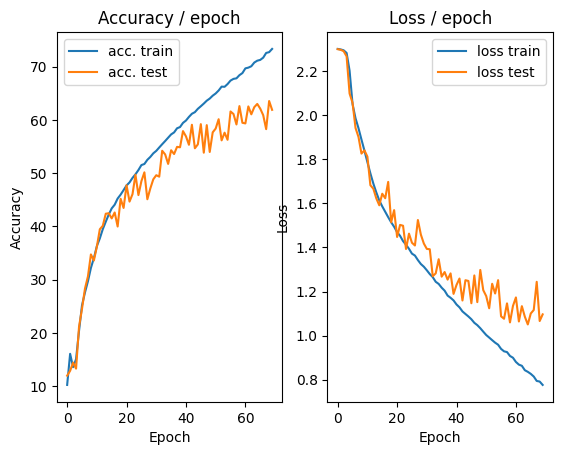

=== EPOCH 71 =====

[TRAIN Batch 000/196]	Time 0.226s (0.226s)	Loss 0.7706 (0.7706)	Prec@1  72.7 ( 72.7)	Prec@5  96.5 ( 96.5)


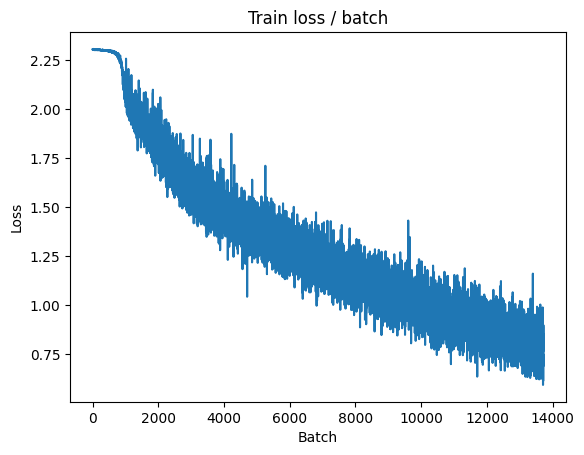


===============> Total time 8s	Avg loss 0.7606	Avg Prec@1 73.78 %	Avg Prec@5 98.14 %

[EVAL Batch 000/040]	Time 0.188s (0.188s)	Loss 1.0546 (1.0546)	Prec@1  66.8 ( 66.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0543	Avg Prec@1 63.81 %	Avg Prec@5 96.39 %



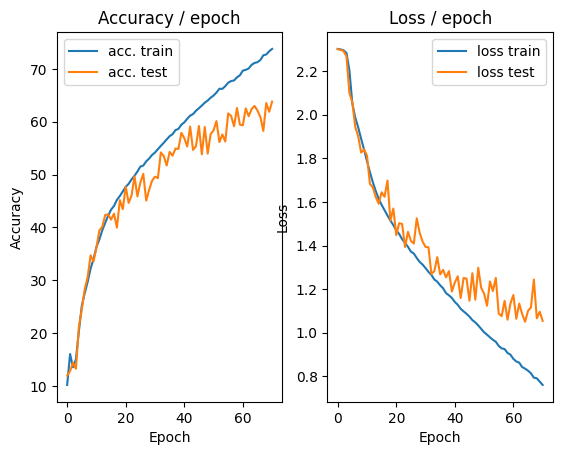

=== EPOCH 72 =====

[TRAIN Batch 000/196]	Time 0.392s (0.392s)	Loss 0.7374 (0.7374)	Prec@1  74.6 ( 74.6)	Prec@5  97.7 ( 97.7)


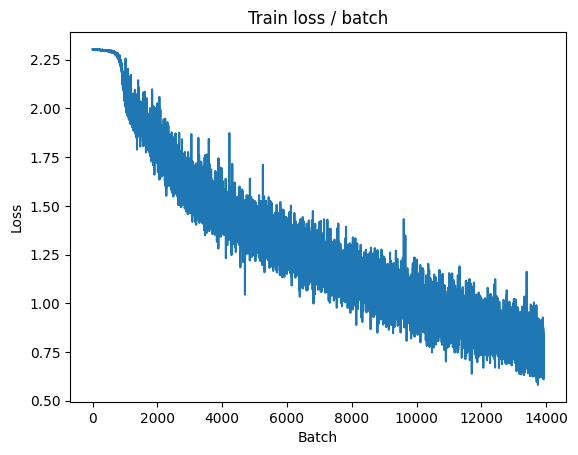


===============> Total time 9s	Avg loss 0.7586	Avg Prec@1 73.61 %	Avg Prec@5 98.21 %

[EVAL Batch 000/040]	Time 0.186s (0.186s)	Loss 1.0650 (1.0650)	Prec@1  64.1 ( 64.1)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0115	Avg Prec@1 65.13 %	Avg Prec@5 96.72 %



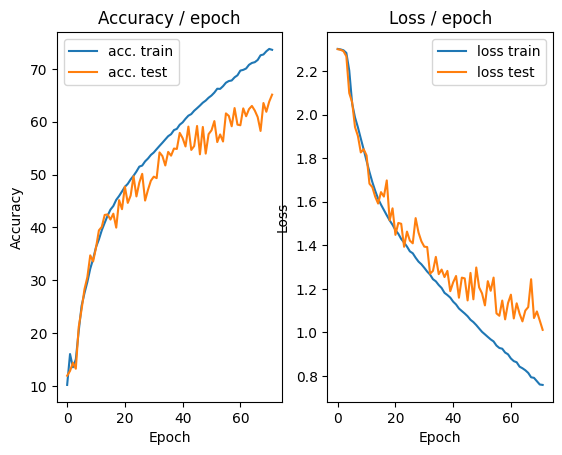

=== EPOCH 73 =====

[TRAIN Batch 000/196]	Time 0.277s (0.277s)	Loss 0.6925 (0.6925)	Prec@1  77.7 ( 77.7)	Prec@5  98.0 ( 98.0)


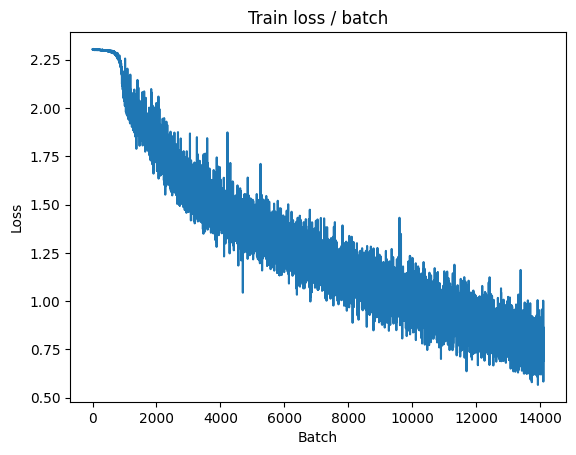


===============> Total time 9s	Avg loss 0.7415	Avg Prec@1 74.33 %	Avg Prec@5 98.25 %

[EVAL Batch 000/040]	Time 0.190s (0.190s)	Loss 1.1951 (1.1951)	Prec@1  60.9 ( 60.9)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.2323	Avg Prec@1 60.15 %	Avg Prec@5 95.29 %



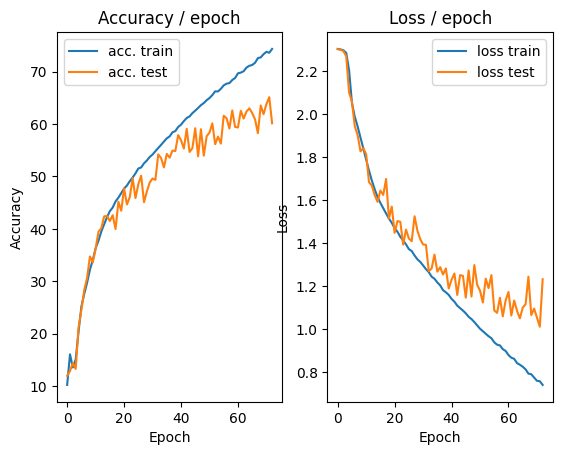

=== EPOCH 74 =====

[TRAIN Batch 000/196]	Time 0.218s (0.218s)	Loss 0.9622 (0.9622)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)


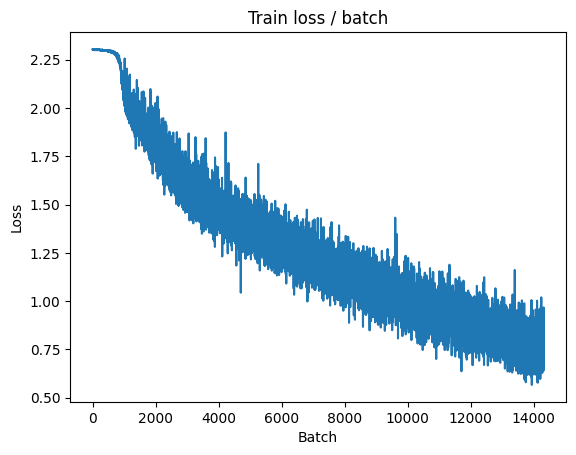


===============> Total time 9s	Avg loss 0.7323	Avg Prec@1 74.61 %	Avg Prec@5 98.32 %

[EVAL Batch 000/040]	Time 0.204s (0.204s)	Loss 1.0753 (1.0753)	Prec@1  66.8 ( 66.8)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.0815	Avg Prec@1 63.20 %	Avg Prec@5 96.40 %



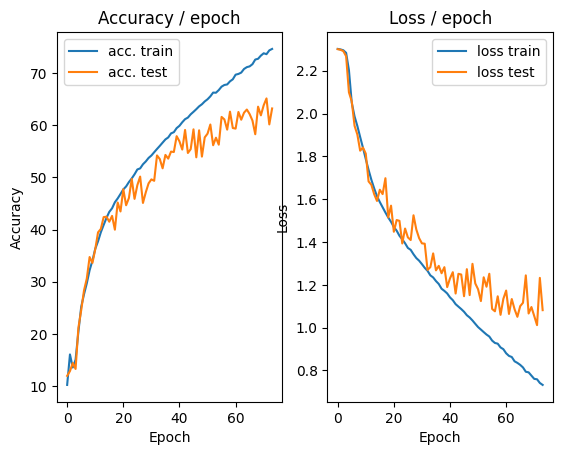

=== EPOCH 75 =====

[TRAIN Batch 000/196]	Time 0.201s (0.201s)	Loss 0.7760 (0.7760)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)


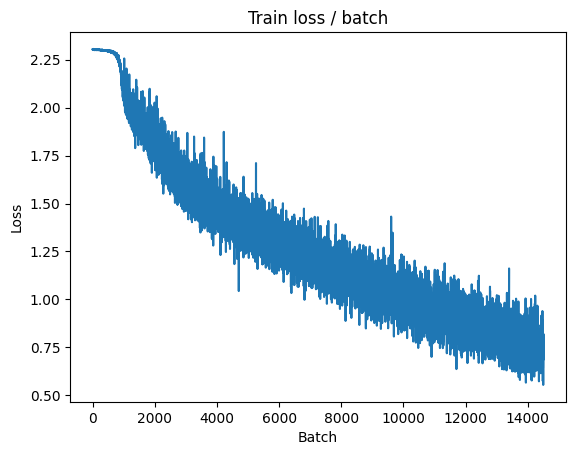


===============> Total time 9s	Avg loss 0.7197	Avg Prec@1 75.12 %	Avg Prec@5 98.39 %

[EVAL Batch 000/040]	Time 0.546s (0.546s)	Loss 1.0308 (1.0308)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0018	Avg Prec@1 66.14 %	Avg Prec@5 96.56 %



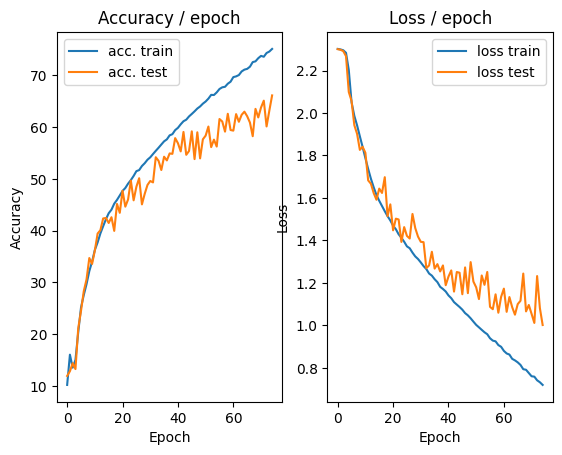

=== EPOCH 76 =====

[TRAIN Batch 000/196]	Time 0.288s (0.288s)	Loss 0.7447 (0.7447)	Prec@1  73.8 ( 73.8)	Prec@5  96.1 ( 96.1)


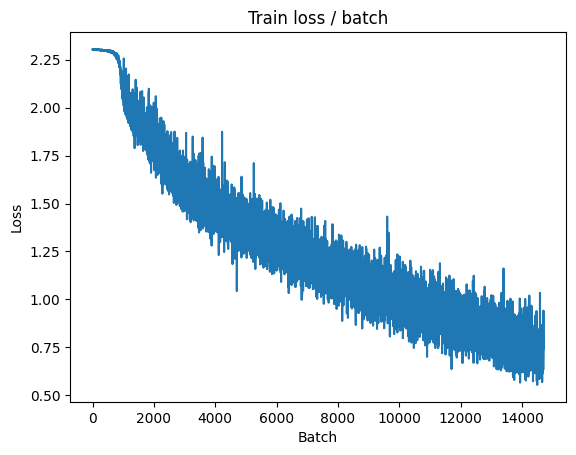


===============> Total time 9s	Avg loss 0.7039	Avg Prec@1 75.74 %	Avg Prec@5 98.43 %

[EVAL Batch 000/040]	Time 0.205s (0.205s)	Loss 1.1024 (1.1024)	Prec@1  62.5 ( 62.5)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0771	Avg Prec@1 64.39 %	Avg Prec@5 96.13 %



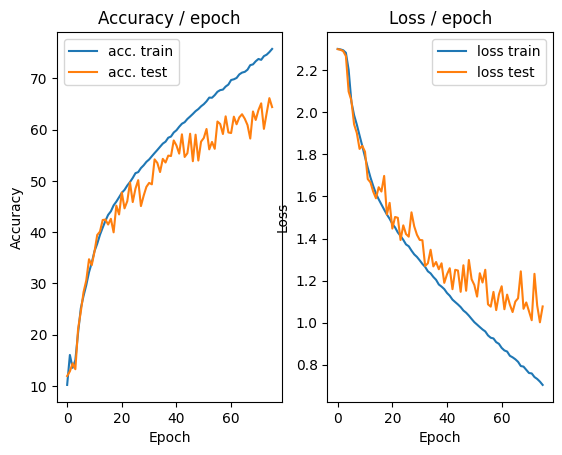

=== EPOCH 77 =====

[TRAIN Batch 000/196]	Time 0.303s (0.303s)	Loss 0.6066 (0.6066)	Prec@1  79.7 ( 79.7)	Prec@5  98.8 ( 98.8)


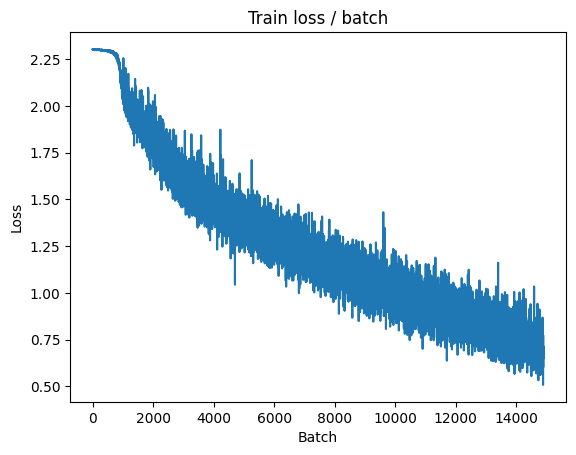


===============> Total time 9s	Avg loss 0.6956	Avg Prec@1 75.81 %	Avg Prec@5 98.50 %

[EVAL Batch 000/040]	Time 0.207s (0.207s)	Loss 1.0541 (1.0541)	Prec@1  63.3 ( 63.3)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.0123	Avg Prec@1 65.52 %	Avg Prec@5 96.80 %



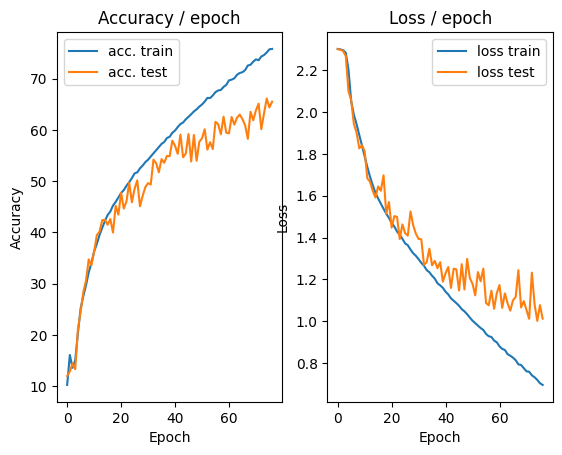

=== EPOCH 78 =====

[TRAIN Batch 000/196]	Time 0.222s (0.222s)	Loss 0.8805 (0.8805)	Prec@1  68.8 ( 68.8)	Prec@5  98.0 ( 98.0)


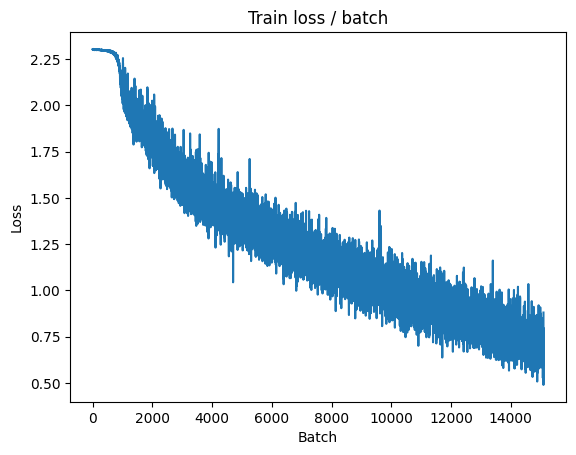


===============> Total time 8s	Avg loss 0.6826	Avg Prec@1 76.38 %	Avg Prec@5 98.60 %

[EVAL Batch 000/040]	Time 0.345s (0.345s)	Loss 1.0742 (1.0742)	Prec@1  64.1 ( 64.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0467	Avg Prec@1 64.87 %	Avg Prec@5 96.88 %



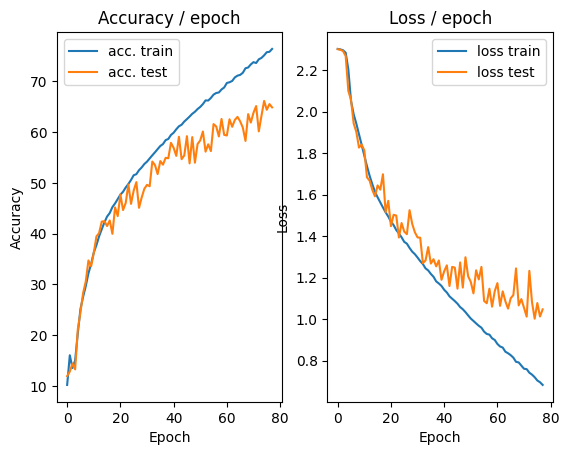

=== EPOCH 79 =====

[TRAIN Batch 000/196]	Time 0.314s (0.314s)	Loss 0.7375 (0.7375)	Prec@1  73.0 ( 73.0)	Prec@5  99.2 ( 99.2)


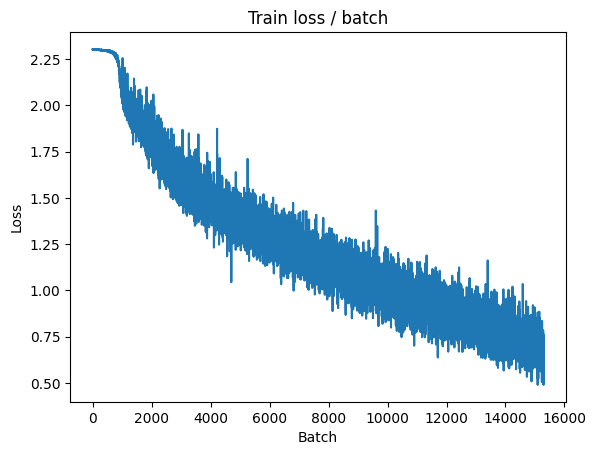


===============> Total time 8s	Avg loss 0.6748	Avg Prec@1 76.77 %	Avg Prec@5 98.64 %

[EVAL Batch 000/040]	Time 0.178s (0.178s)	Loss 1.2295 (1.2295)	Prec@1  59.4 ( 59.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2452	Avg Prec@1 60.31 %	Avg Prec@5 95.34 %



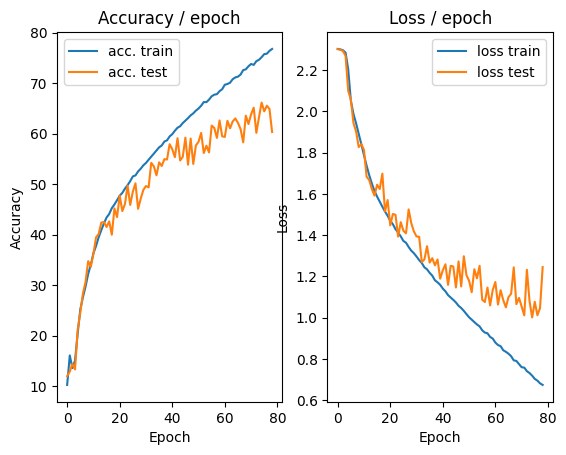

=== EPOCH 80 =====

[TRAIN Batch 000/196]	Time 0.334s (0.334s)	Loss 0.9045 (0.9045)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)


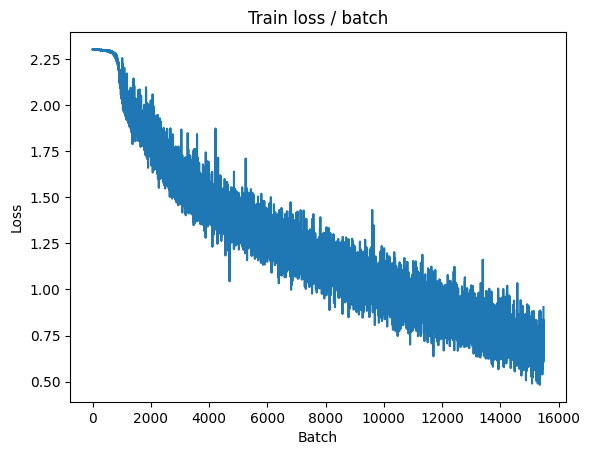


===============> Total time 8s	Avg loss 0.6615	Avg Prec@1 77.05 %	Avg Prec@5 98.66 %

[EVAL Batch 000/040]	Time 0.221s (0.221s)	Loss 1.1939 (1.1939)	Prec@1  61.3 ( 61.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.1496	Avg Prec@1 62.60 %	Avg Prec@5 96.49 %



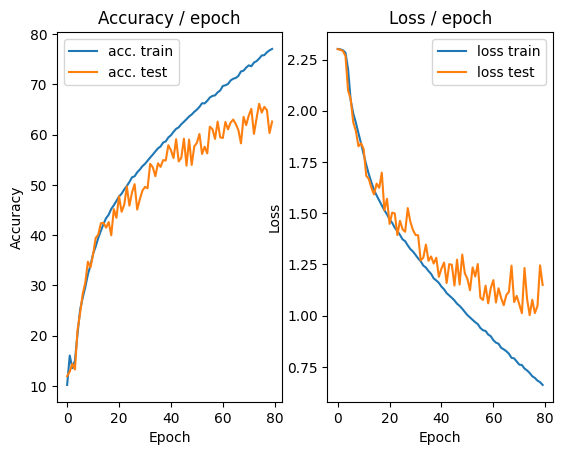

=== EPOCH 81 =====

[TRAIN Batch 000/196]	Time 0.280s (0.280s)	Loss 0.7751 (0.7751)	Prec@1  73.4 ( 73.4)	Prec@5  98.8 ( 98.8)


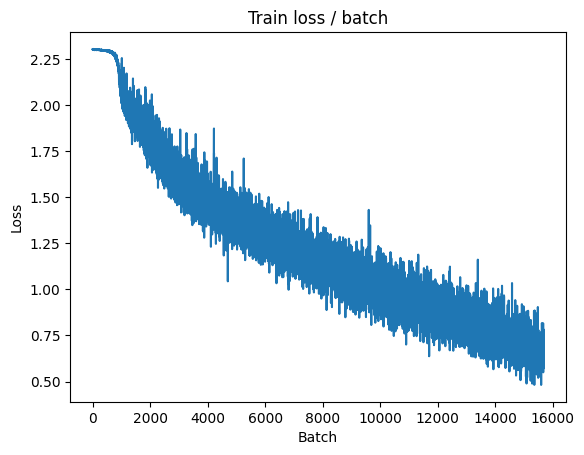


===============> Total time 9s	Avg loss 0.6500	Avg Prec@1 77.68 %	Avg Prec@5 98.73 %

[EVAL Batch 000/040]	Time 0.218s (0.218s)	Loss 1.0716 (1.0716)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0759	Avg Prec@1 64.06 %	Avg Prec@5 96.50 %



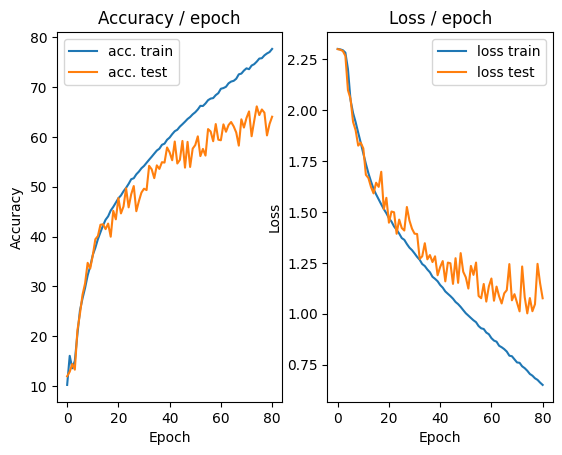

=== EPOCH 82 =====

[TRAIN Batch 000/196]	Time 0.258s (0.258s)	Loss 0.7238 (0.7238)	Prec@1  75.0 ( 75.0)	Prec@5  98.8 ( 98.8)


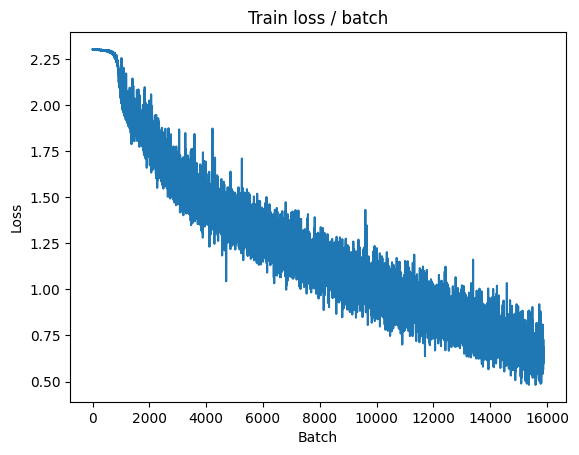


===============> Total time 9s	Avg loss 0.6357	Avg Prec@1 78.14 %	Avg Prec@5 98.76 %

[EVAL Batch 000/040]	Time 0.206s (0.206s)	Loss 1.0730 (1.0730)	Prec@1  67.6 ( 67.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.1064	Avg Prec@1 63.89 %	Avg Prec@5 96.29 %



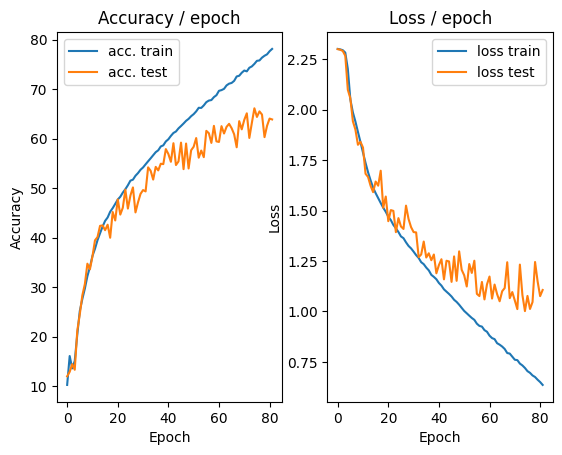

=== EPOCH 83 =====

[TRAIN Batch 000/196]	Time 0.360s (0.360s)	Loss 0.6890 (0.6890)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


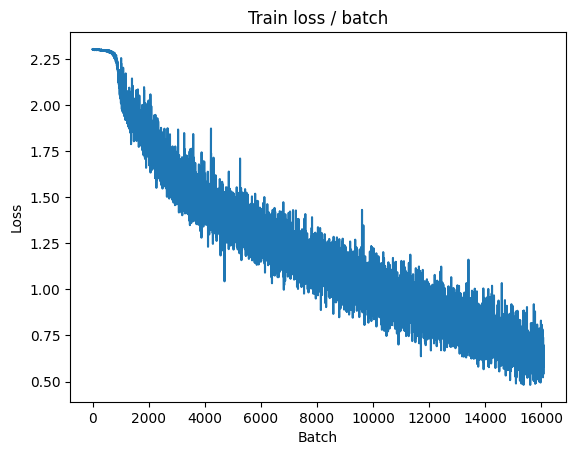


===============> Total time 9s	Avg loss 0.6242	Avg Prec@1 78.48 %	Avg Prec@5 98.82 %

[EVAL Batch 000/040]	Time 0.190s (0.190s)	Loss 1.1321 (1.1321)	Prec@1  60.9 ( 60.9)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.0943	Avg Prec@1 64.26 %	Avg Prec@5 97.17 %



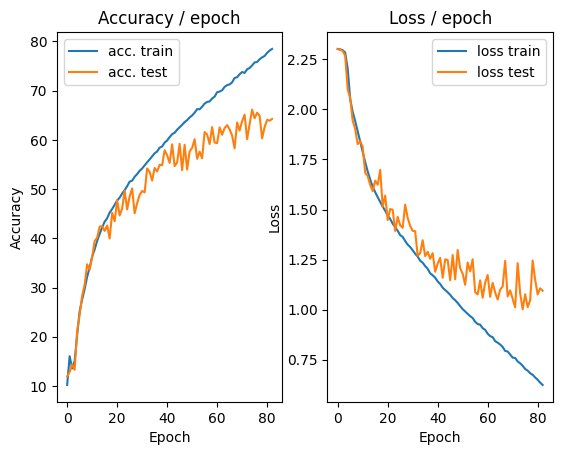

=== EPOCH 84 =====

[TRAIN Batch 000/196]	Time 0.246s (0.246s)	Loss 0.6274 (0.6274)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)


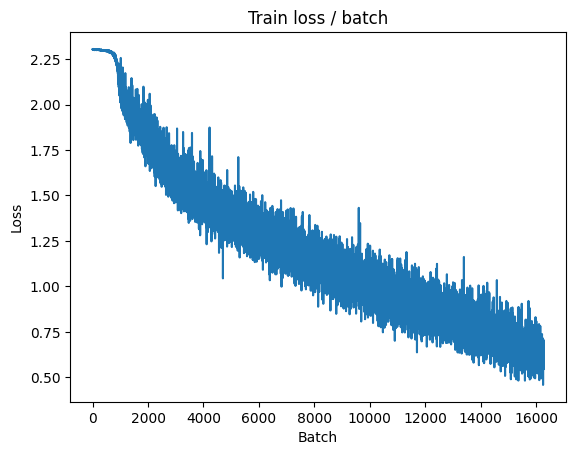


===============> Total time 9s	Avg loss 0.6176	Avg Prec@1 78.86 %	Avg Prec@5 98.84 %

[EVAL Batch 000/040]	Time 0.182s (0.182s)	Loss 1.0545 (1.0545)	Prec@1  66.0 ( 66.0)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.0596	Avg Prec@1 65.03 %	Avg Prec@5 96.67 %



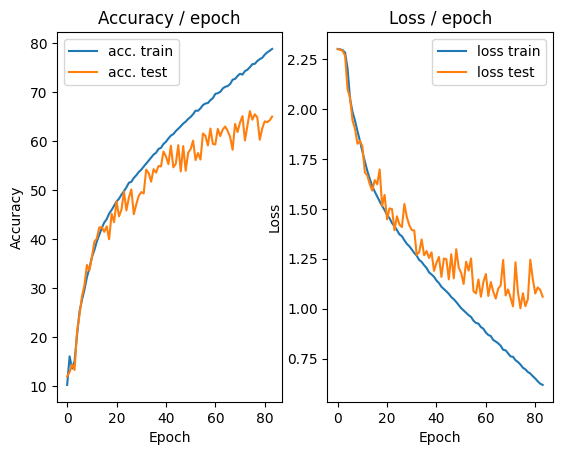

=== EPOCH 85 =====

[TRAIN Batch 000/196]	Time 0.303s (0.303s)	Loss 0.6895 (0.6895)	Prec@1  76.6 ( 76.6)	Prec@5  99.6 ( 99.6)


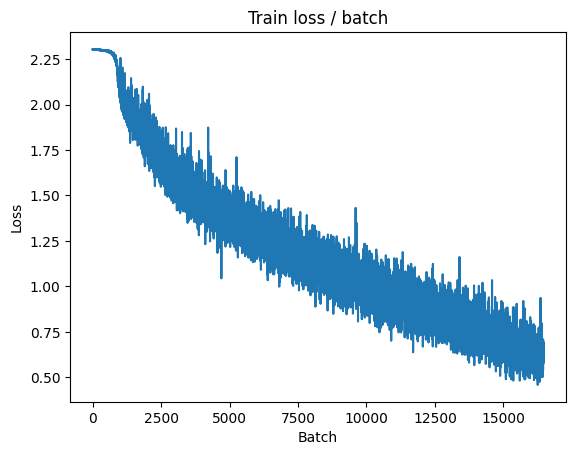


===============> Total time 9s	Avg loss 0.5992	Avg Prec@1 79.30 %	Avg Prec@5 98.93 %

[EVAL Batch 000/040]	Time 0.192s (0.192s)	Loss 0.9979 (0.9979)	Prec@1  69.1 ( 69.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0331	Avg Prec@1 66.36 %	Avg Prec@5 96.59 %



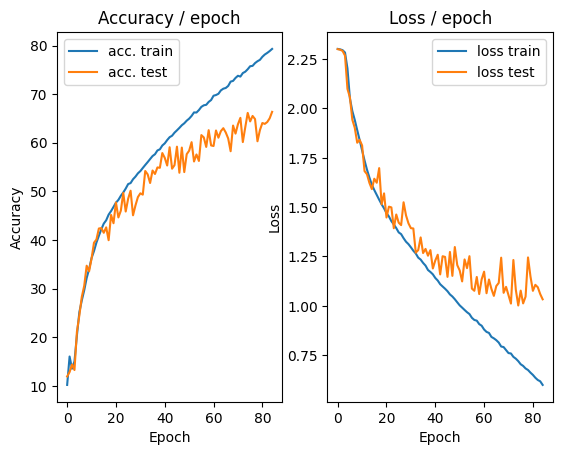

=== EPOCH 86 =====

[TRAIN Batch 000/196]	Time 0.296s (0.296s)	Loss 0.6256 (0.6256)	Prec@1  77.0 ( 77.0)	Prec@5  99.2 ( 99.2)


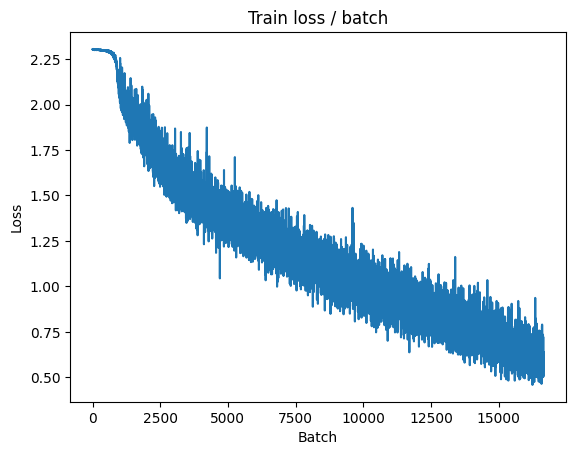


===============> Total time 9s	Avg loss 0.5932	Avg Prec@1 79.67 %	Avg Prec@5 99.01 %

[EVAL Batch 000/040]	Time 0.204s (0.204s)	Loss 1.0070 (1.0070)	Prec@1  66.4 ( 66.4)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.0265	Avg Prec@1 66.13 %	Avg Prec@5 97.11 %



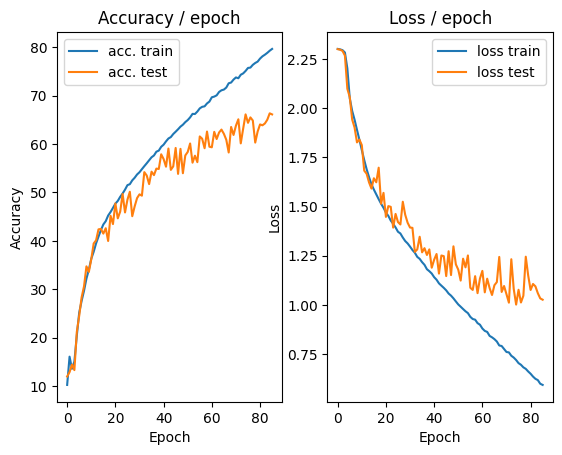

=== EPOCH 87 =====

[TRAIN Batch 000/196]	Time 0.321s (0.321s)	Loss 0.5197 (0.5197)	Prec@1  82.0 ( 82.0)	Prec@5  99.6 ( 99.6)


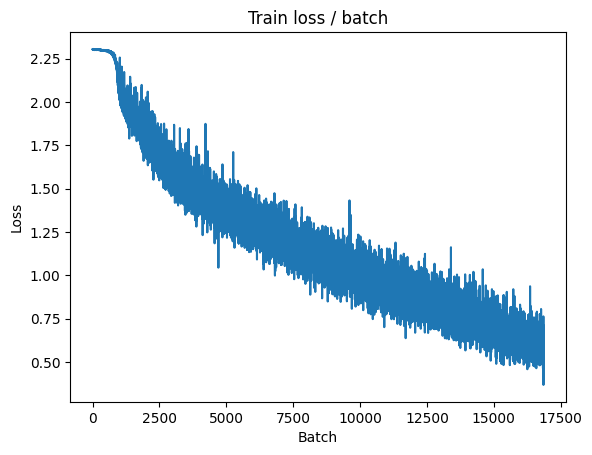


===============> Total time 8s	Avg loss 0.5773	Avg Prec@1 80.23 %	Avg Prec@5 99.07 %

[EVAL Batch 000/040]	Time 0.331s (0.331s)	Loss 1.0221 (1.0221)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0206	Avg Prec@1 66.50 %	Avg Prec@5 96.97 %



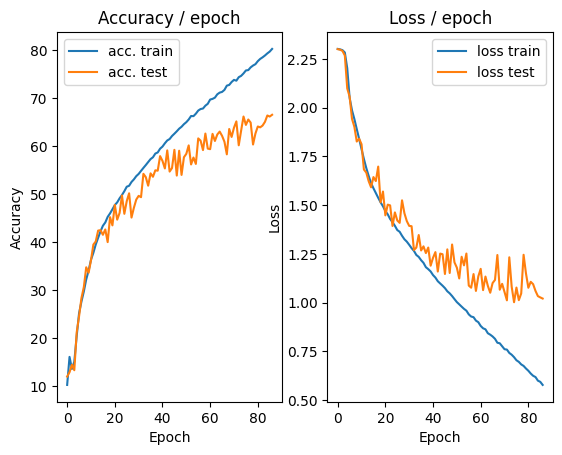

=== EPOCH 88 =====

[TRAIN Batch 000/196]	Time 0.304s (0.304s)	Loss 0.5749 (0.5749)	Prec@1  78.9 ( 78.9)	Prec@5  98.8 ( 98.8)


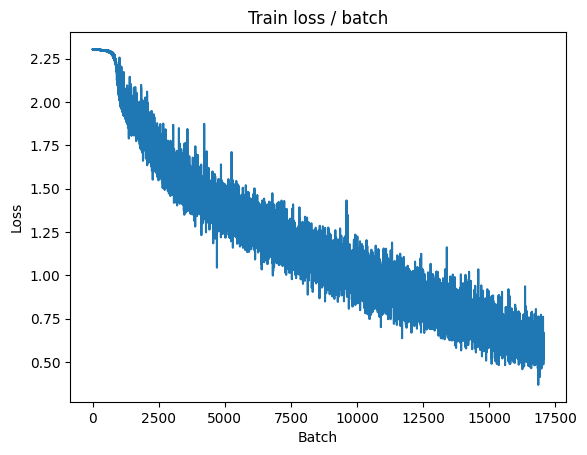


===============> Total time 8s	Avg loss 0.5728	Avg Prec@1 80.33 %	Avg Prec@5 99.01 %

[EVAL Batch 000/040]	Time 0.217s (0.217s)	Loss 1.0991 (1.0991)	Prec@1  63.3 ( 63.3)	Prec@5  95.7 ( 95.7)

===============> Total time 2s	Avg loss 1.0982	Avg Prec@1 64.56 %	Avg Prec@5 96.43 %



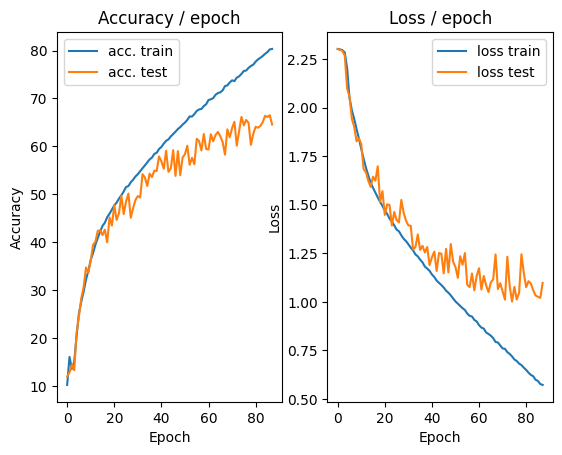

=== EPOCH 89 =====

[TRAIN Batch 000/196]	Time 0.348s (0.348s)	Loss 0.6731 (0.6731)	Prec@1  71.9 ( 71.9)	Prec@5  99.6 ( 99.6)


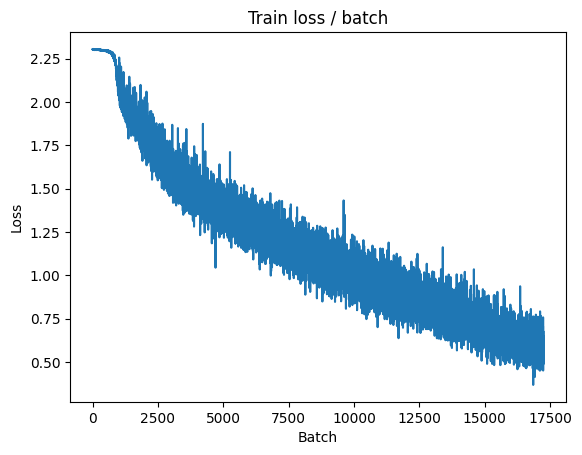


===============> Total time 8s	Avg loss 0.5558	Avg Prec@1 80.76 %	Avg Prec@5 99.16 %

[EVAL Batch 000/040]	Time 0.197s (0.197s)	Loss 1.0735 (1.0735)	Prec@1  63.3 ( 63.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0423	Avg Prec@1 65.83 %	Avg Prec@5 96.80 %



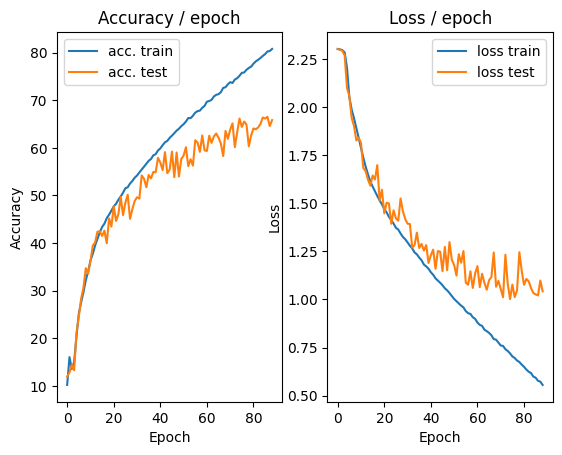

=== EPOCH 90 =====

[TRAIN Batch 000/196]	Time 0.324s (0.324s)	Loss 0.5762 (0.5762)	Prec@1  81.6 ( 81.6)	Prec@5  98.8 ( 98.8)


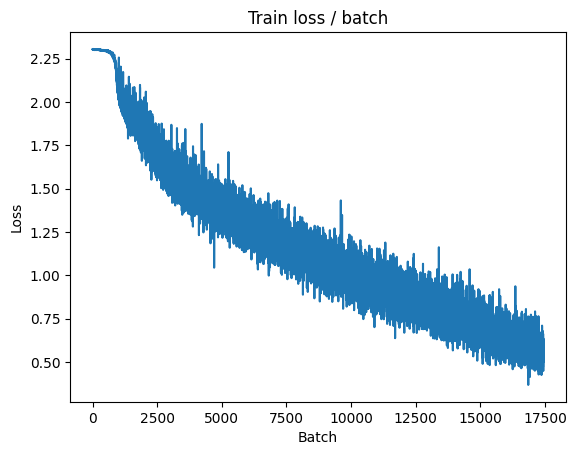


===============> Total time 9s	Avg loss 0.5457	Avg Prec@1 81.27 %	Avg Prec@5 99.15 %

[EVAL Batch 000/040]	Time 0.208s (0.208s)	Loss 1.0147 (1.0147)	Prec@1  69.1 ( 69.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0984	Avg Prec@1 65.73 %	Avg Prec@5 96.43 %



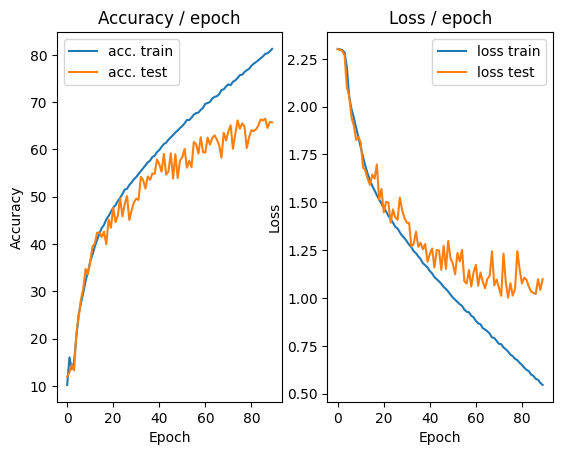

=== EPOCH 91 =====

[TRAIN Batch 000/196]	Time 0.265s (0.265s)	Loss 0.6994 (0.6994)	Prec@1  75.8 ( 75.8)	Prec@5  97.3 ( 97.3)


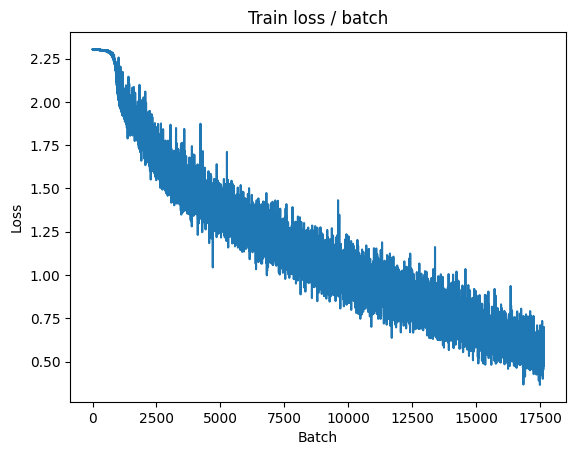


===============> Total time 9s	Avg loss 0.5359	Avg Prec@1 81.45 %	Avg Prec@5 99.20 %

[EVAL Batch 000/040]	Time 0.211s (0.211s)	Loss 1.2037 (1.2037)	Prec@1  63.3 ( 63.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.2099	Avg Prec@1 62.24 %	Avg Prec@5 96.34 %



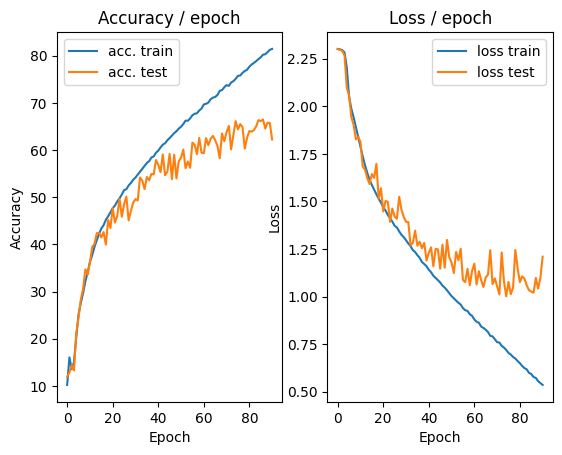

=== EPOCH 92 =====

[TRAIN Batch 000/196]	Time 0.308s (0.308s)	Loss 0.6377 (0.6377)	Prec@1  79.7 ( 79.7)	Prec@5  99.6 ( 99.6)


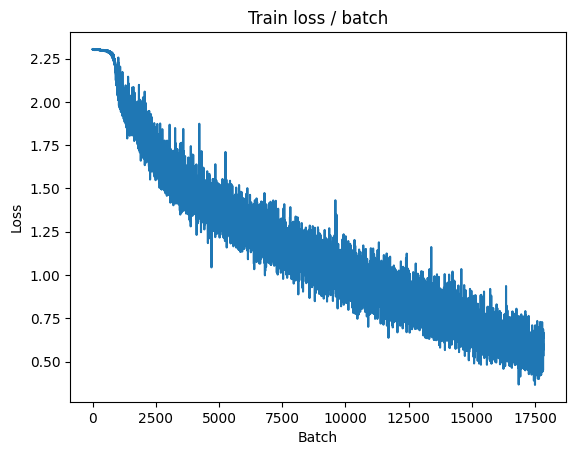


===============> Total time 9s	Avg loss 0.5258	Avg Prec@1 82.03 %	Avg Prec@5 99.22 %

[EVAL Batch 000/040]	Time 0.200s (0.200s)	Loss 1.1780 (1.1780)	Prec@1  66.8 ( 66.8)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 1.1715	Avg Prec@1 63.63 %	Avg Prec@5 96.36 %



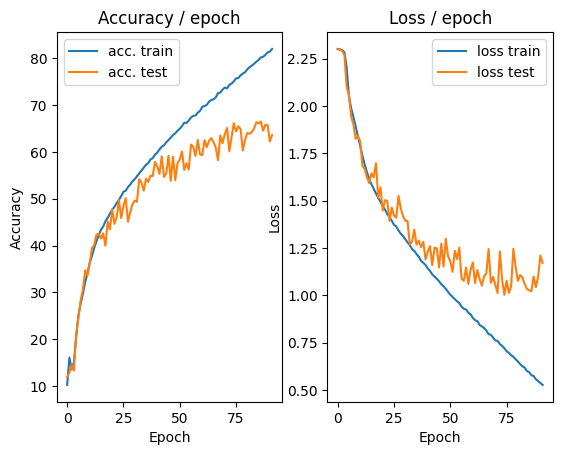

=== EPOCH 93 =====

[TRAIN Batch 000/196]	Time 0.345s (0.345s)	Loss 0.5687 (0.5687)	Prec@1  79.7 ( 79.7)	Prec@5  99.6 ( 99.6)


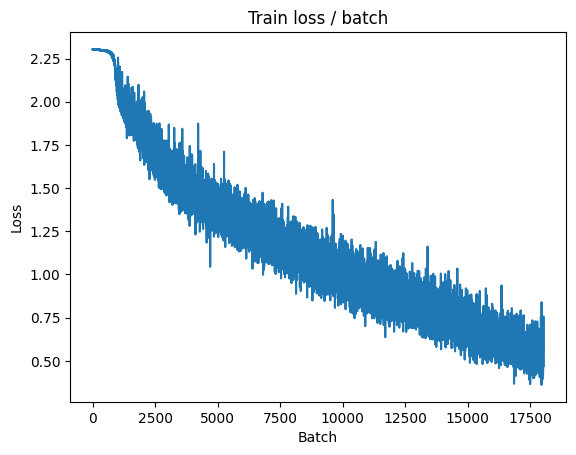


===============> Total time 9s	Avg loss 0.5155	Avg Prec@1 82.25 %	Avg Prec@5 99.29 %

[EVAL Batch 000/040]	Time 0.205s (0.205s)	Loss 1.1304 (1.1304)	Prec@1  64.1 ( 64.1)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.1338	Avg Prec@1 64.17 %	Avg Prec@5 96.55 %



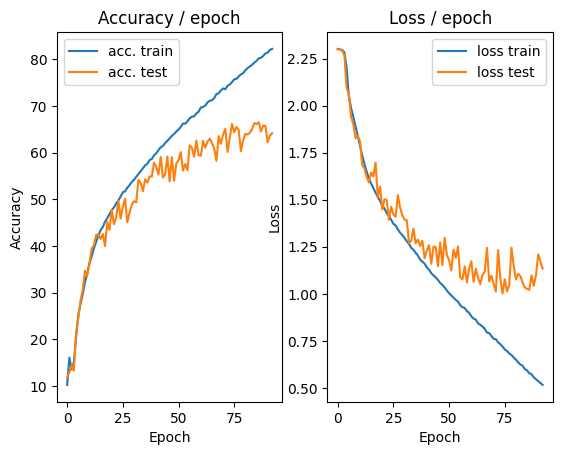

=== EPOCH 94 =====

[TRAIN Batch 000/196]	Time 0.327s (0.327s)	Loss 0.4893 (0.4893)	Prec@1  82.8 ( 82.8)	Prec@5  99.6 ( 99.6)


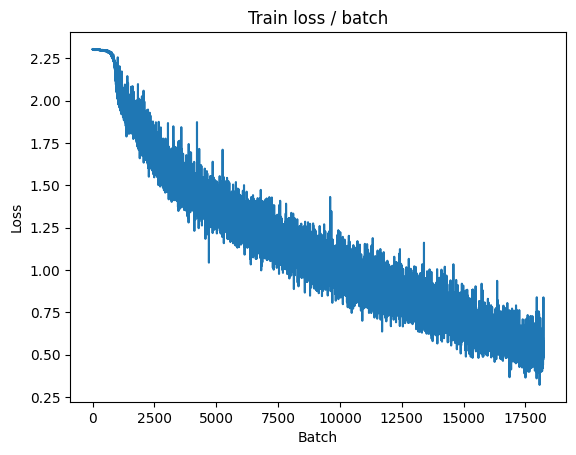


===============> Total time 9s	Avg loss 0.4963	Avg Prec@1 83.03 %	Avg Prec@5 99.35 %

[EVAL Batch 000/040]	Time 0.195s (0.195s)	Loss 1.1957 (1.1957)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1693	Avg Prec@1 63.68 %	Avg Prec@5 96.61 %



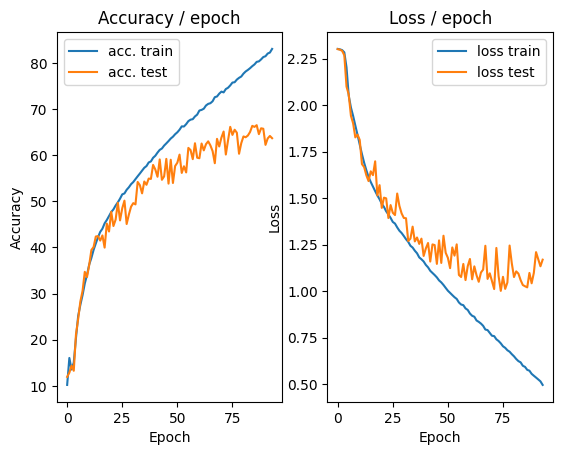

=== EPOCH 95 =====

[TRAIN Batch 000/196]	Time 0.335s (0.335s)	Loss 0.5994 (0.5994)	Prec@1  80.5 ( 80.5)	Prec@5  98.8 ( 98.8)


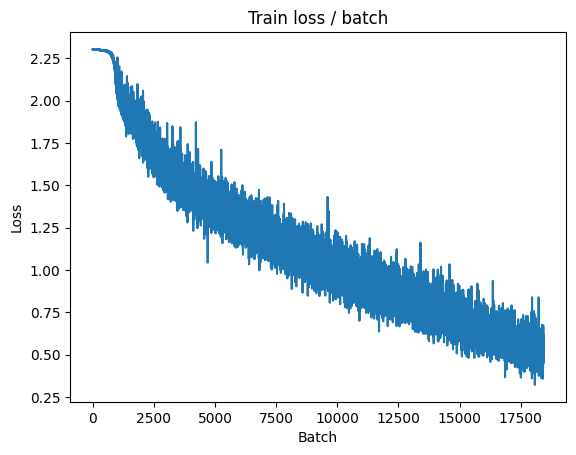


===============> Total time 9s	Avg loss 0.4810	Avg Prec@1 83.77 %	Avg Prec@5 99.35 %

[EVAL Batch 000/040]	Time 0.234s (0.234s)	Loss 1.0047 (1.0047)	Prec@1  66.4 ( 66.4)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.0472	Avg Prec@1 67.19 %	Avg Prec@5 96.70 %



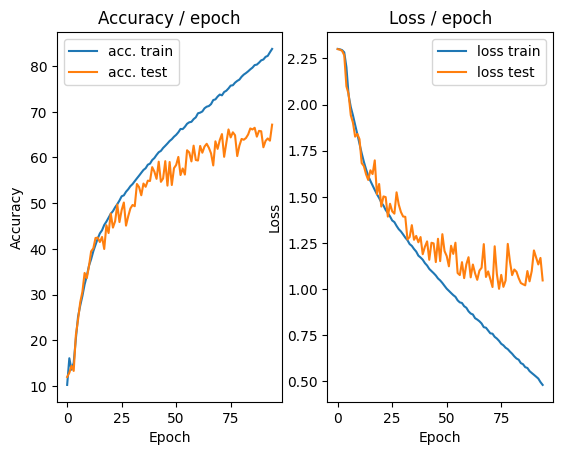

=== EPOCH 96 =====

[TRAIN Batch 000/196]	Time 0.295s (0.295s)	Loss 0.3864 (0.3864)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


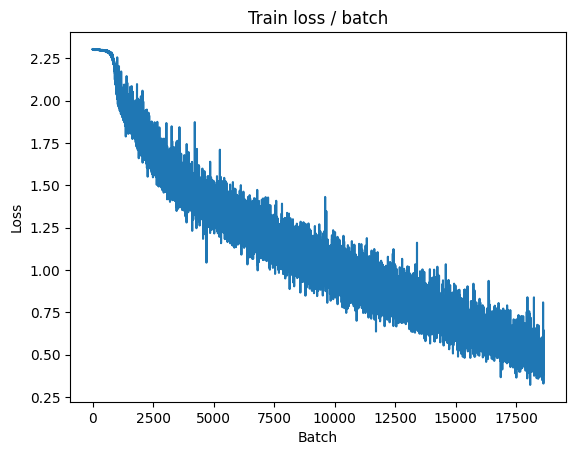


===============> Total time 9s	Avg loss 0.4734	Avg Prec@1 83.82 %	Avg Prec@5 99.40 %

[EVAL Batch 000/040]	Time 0.273s (0.273s)	Loss 1.2864 (1.2864)	Prec@1  59.0 ( 59.0)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 1.2792	Avg Prec@1 61.26 %	Avg Prec@5 96.54 %



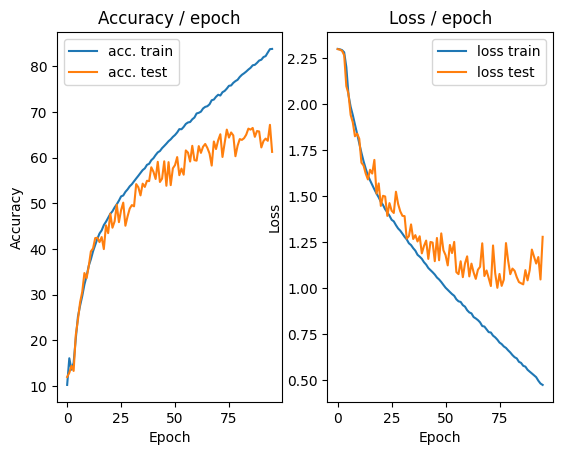

=== EPOCH 97 =====

[TRAIN Batch 000/196]	Time 0.267s (0.267s)	Loss 0.6078 (0.6078)	Prec@1  77.0 ( 77.0)	Prec@5  99.6 ( 99.6)


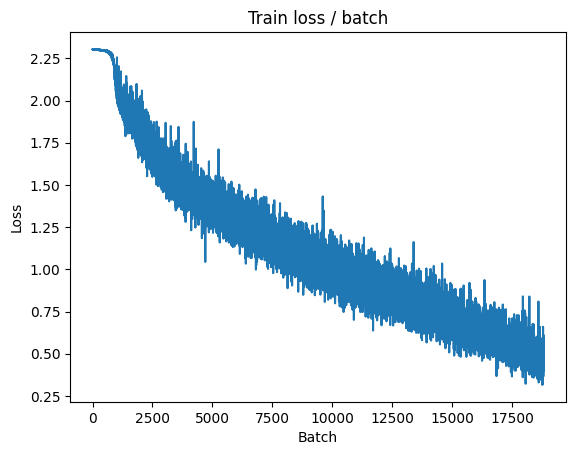


===============> Total time 8s	Avg loss 0.4640	Avg Prec@1 84.20 %	Avg Prec@5 99.41 %

[EVAL Batch 000/040]	Time 0.286s (0.286s)	Loss 1.1651 (1.1651)	Prec@1  66.8 ( 66.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1491	Avg Prec@1 65.21 %	Avg Prec@5 96.57 %



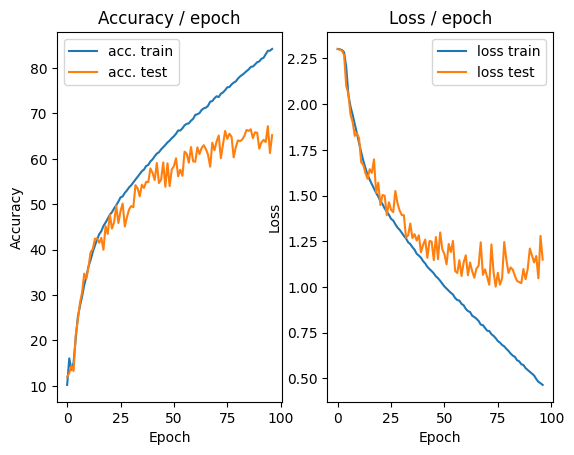

=== EPOCH 98 =====

[TRAIN Batch 000/196]	Time 0.326s (0.326s)	Loss 0.4423 (0.4423)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


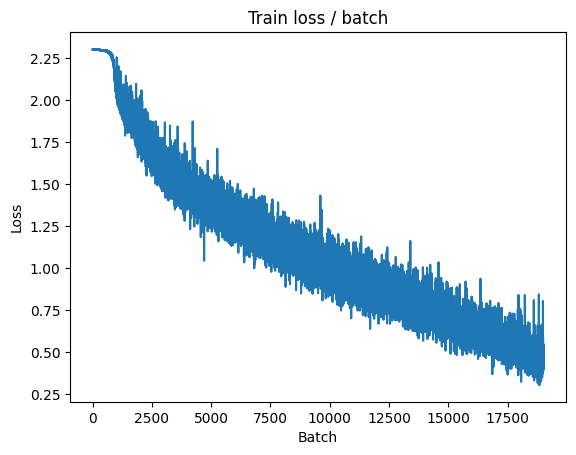


===============> Total time 8s	Avg loss 0.4554	Avg Prec@1 84.34 %	Avg Prec@5 99.45 %

[EVAL Batch 000/040]	Time 0.254s (0.254s)	Loss 1.0430 (1.0430)	Prec@1  65.6 ( 65.6)	Prec@5  96.5 ( 96.5)

===============> Total time 2s	Avg loss 1.1140	Avg Prec@1 65.17 %	Avg Prec@5 96.58 %



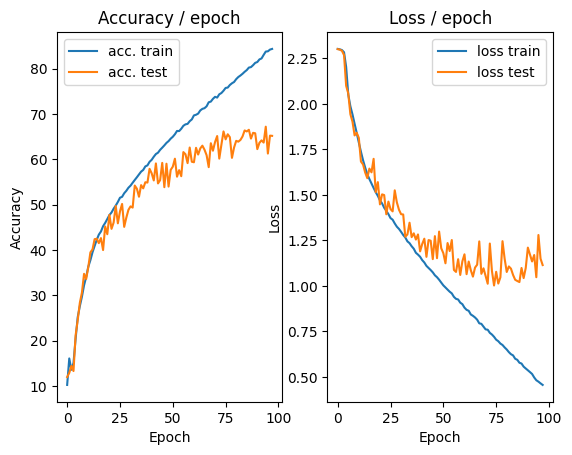

=== EPOCH 99 =====

[TRAIN Batch 000/196]	Time 0.357s (0.357s)	Loss 0.4352 (0.4352)	Prec@1  87.1 ( 87.1)	Prec@5  99.2 ( 99.2)


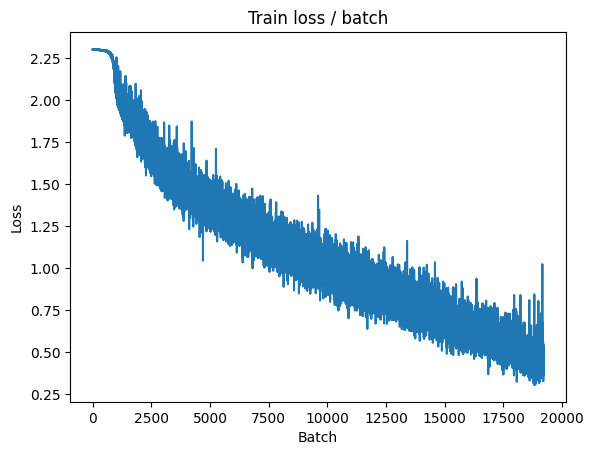


===============> Total time 8s	Avg loss 0.4426	Avg Prec@1 85.00 %	Avg Prec@5 99.50 %

[EVAL Batch 000/040]	Time 0.205s (0.205s)	Loss 1.2507 (1.2507)	Prec@1  63.7 ( 63.7)	Prec@5  95.7 ( 95.7)

===============> Total time 1s	Avg loss 1.3067	Avg Prec@1 62.38 %	Avg Prec@5 95.88 %



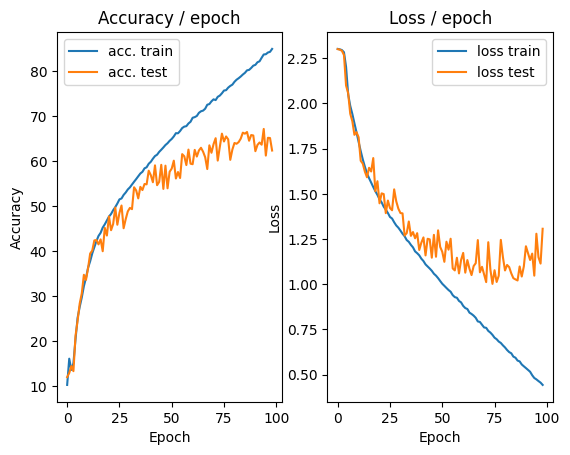

=== EPOCH 100 =====

[TRAIN Batch 000/196]	Time 0.331s (0.331s)	Loss 0.5406 (0.5406)	Prec@1  82.0 ( 82.0)	Prec@5  98.8 ( 98.8)


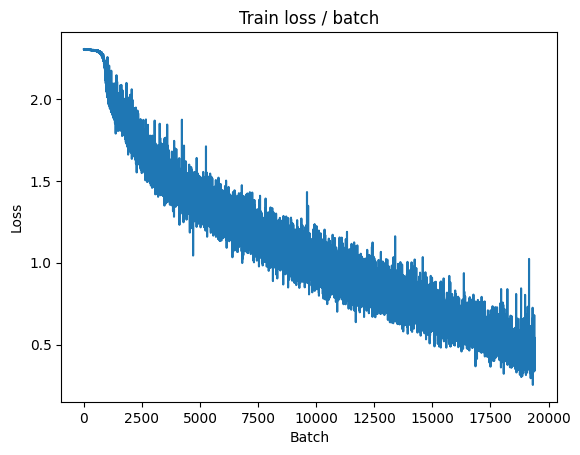


===============> Total time 9s	Avg loss 0.4311	Avg Prec@1 85.36 %	Avg Prec@5 99.53 %

[EVAL Batch 000/040]	Time 0.243s (0.243s)	Loss 1.1291 (1.1291)	Prec@1  66.8 ( 66.8)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.0699	Avg Prec@1 67.07 %	Avg Prec@5 97.12 %



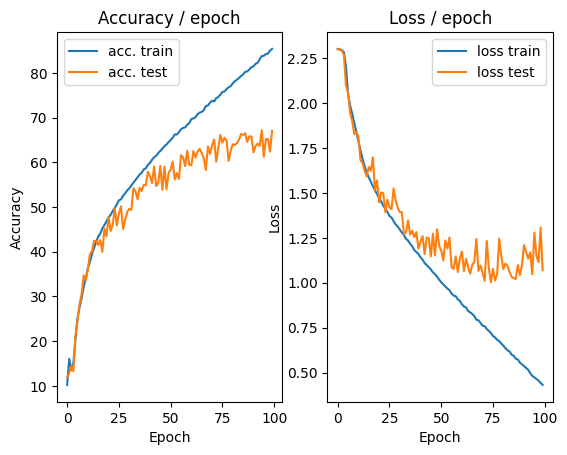

In [ ]:
main(256, 0.01, 100, cuda=True) #50 epoch, lr 0.01, batch size 256

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/098]	Time 0.261s (0.261s)	Loss 2.3021 (2.3021)	Prec@1  11.7 ( 11.7)	Prec@5  53.1 ( 53.1)


<Figure size 640x480 with 0 Axes>

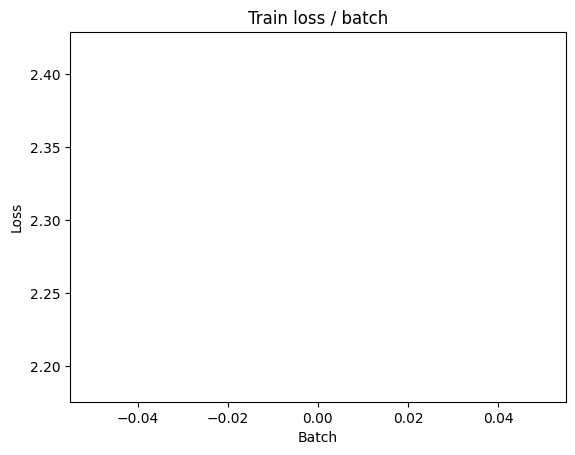


===============> Total time 8s	Avg loss 2.2915	Avg Prec@1 13.15 %	Avg Prec@5 58.03 %

[EVAL Batch 000/020]	Time 0.249s (0.249s)	Loss 2.2476 (2.2476)	Prec@1  22.5 ( 22.5)	Prec@5  75.2 ( 75.2)

===============> Total time 1s	Avg loss 2.2474	Avg Prec@1 22.20 %	Avg Prec@5 74.84 %



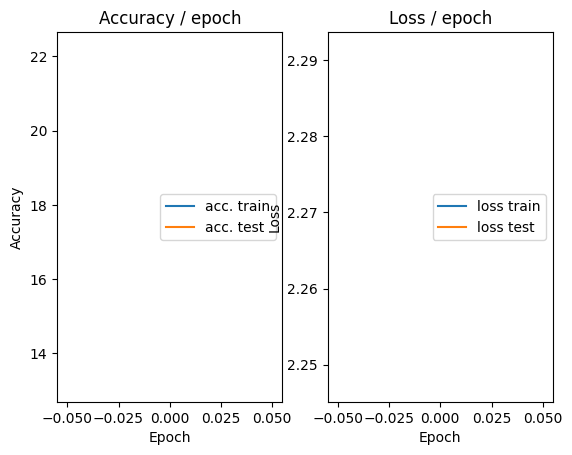

=== EPOCH 2 =====

[TRAIN Batch 000/098]	Time 0.270s (0.270s)	Loss 2.2382 (2.2382)	Prec@1  25.0 ( 25.0)	Prec@5  76.8 ( 76.8)


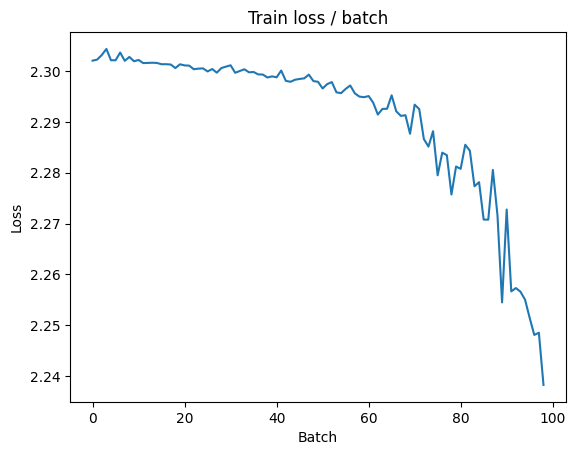


===============> Total time 8s	Avg loss 2.2524	Avg Prec@1 15.94 %	Avg Prec@5 63.03 %

[EVAL Batch 000/020]	Time 0.363s (0.363s)	Loss 2.3009 (2.3009)	Prec@1  10.7 ( 10.7)	Prec@5  59.6 ( 59.6)

===============> Total time 1s	Avg loss 2.2937	Avg Prec@1 11.15 %	Avg Prec@5 60.42 %



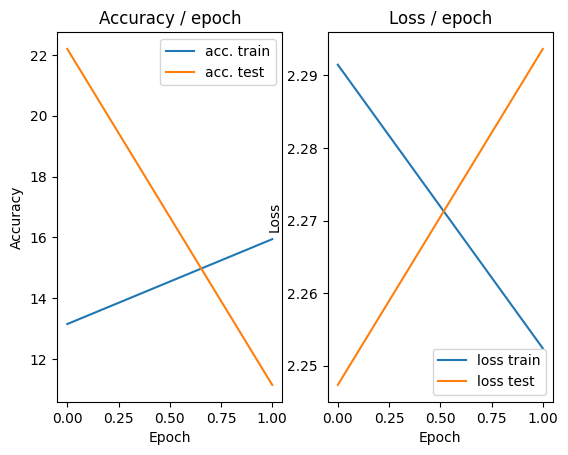

=== EPOCH 3 =====

[TRAIN Batch 000/098]	Time 0.263s (0.263s)	Loss 2.2864 (2.2864)	Prec@1  13.1 ( 13.1)	Prec@5  61.9 ( 61.9)


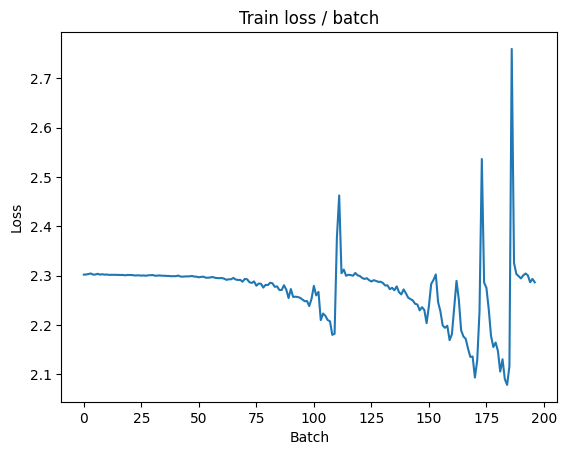


===============> Total time 7s	Avg loss 2.1674	Avg Prec@1 20.02 %	Avg Prec@5 69.36 %

[EVAL Batch 000/020]	Time 0.256s (0.256s)	Loss 2.0186 (2.0186)	Prec@1  31.4 ( 31.4)	Prec@5  78.7 ( 78.7)

===============> Total time 1s	Avg loss 2.0109	Avg Prec@1 30.18 %	Avg Prec@5 79.02 %



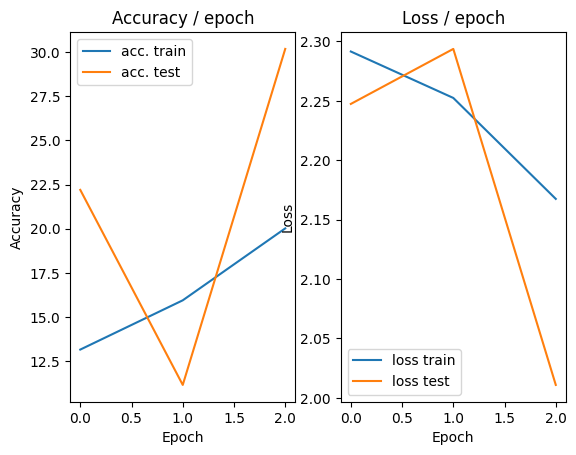

=== EPOCH 4 =====

[TRAIN Batch 000/098]	Time 0.455s (0.455s)	Loss 2.0350 (2.0350)	Prec@1  31.4 ( 31.4)	Prec@5  77.1 ( 77.1)


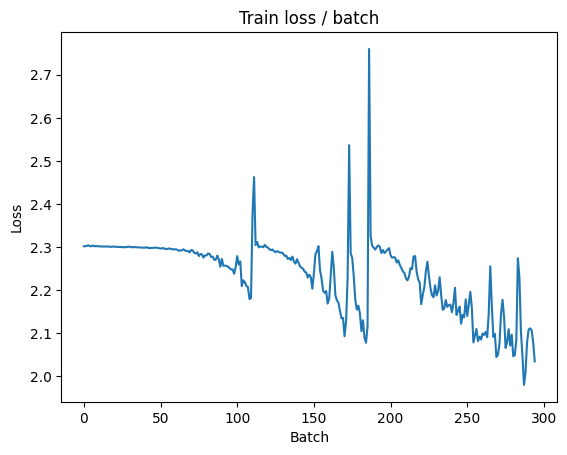


===============> Total time 8s	Avg loss 1.9916	Avg Prec@1 28.81 %	Avg Prec@5 78.95 %

[EVAL Batch 000/020]	Time 0.235s (0.235s)	Loss 2.1753 (2.1753)	Prec@1  22.3 ( 22.3)	Prec@5  72.9 ( 72.9)

===============> Total time 1s	Avg loss 2.1897	Avg Prec@1 21.29 %	Avg Prec@5 71.08 %



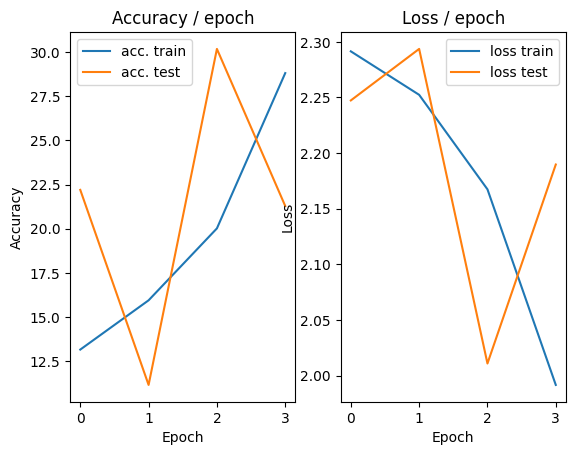

=== EPOCH 5 =====

[TRAIN Batch 000/098]	Time 0.268s (0.268s)	Loss 2.1076 (2.1076)	Prec@1  23.8 ( 23.8)	Prec@5  70.5 ( 70.5)


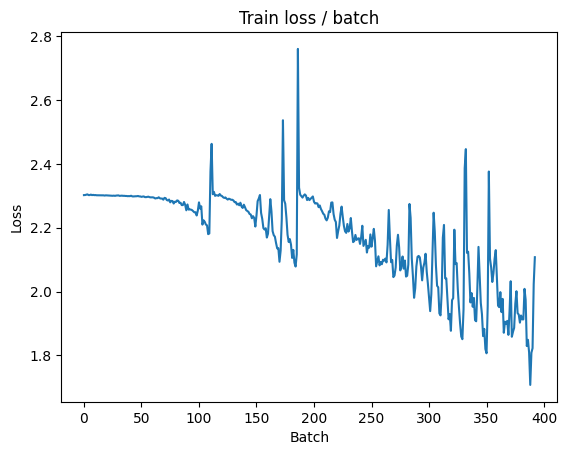


===============> Total time 9s	Avg loss 1.8270	Avg Prec@1 34.67 %	Avg Prec@5 84.07 %

[EVAL Batch 000/020]	Time 0.259s (0.259s)	Loss 1.7208 (1.7208)	Prec@1  38.1 ( 38.1)	Prec@5  87.3 ( 87.3)

===============> Total time 1s	Avg loss 1.6862	Avg Prec@1 40.10 %	Avg Prec@5 87.97 %



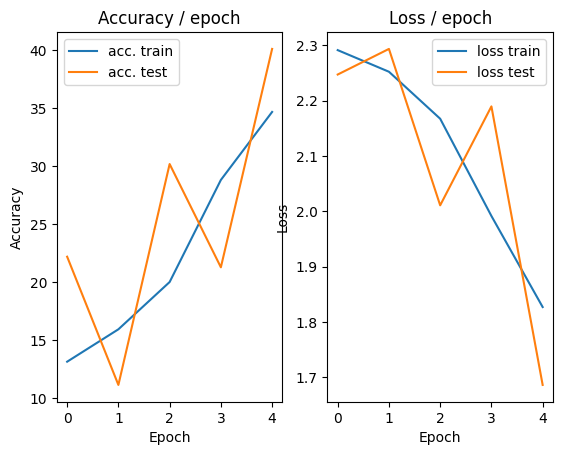

=== EPOCH 6 =====

[TRAIN Batch 000/098]	Time 0.275s (0.275s)	Loss 1.7246 (1.7246)	Prec@1  36.5 ( 36.5)	Prec@5  88.5 ( 88.5)


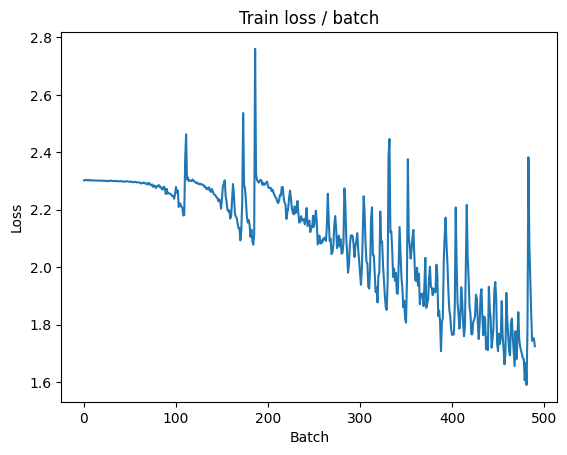


===============> Total time 8s	Avg loss 1.6783	Avg Prec@1 39.95 %	Avg Prec@5 87.81 %

[EVAL Batch 000/020]	Time 0.263s (0.263s)	Loss 1.6962 (1.6962)	Prec@1  36.1 ( 36.1)	Prec@5  89.5 ( 89.5)

===============> Total time 1s	Avg loss 1.6482	Avg Prec@1 40.34 %	Avg Prec@5 88.94 %



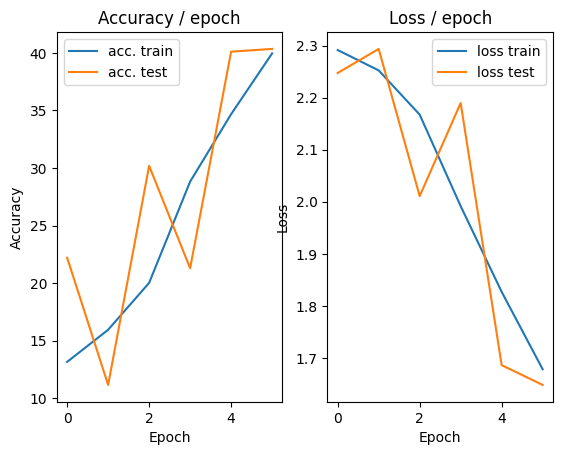

=== EPOCH 7 =====

[TRAIN Batch 000/098]	Time 0.283s (0.283s)	Loss 1.5843 (1.5843)	Prec@1  40.6 ( 40.6)	Prec@5  90.0 ( 90.0)


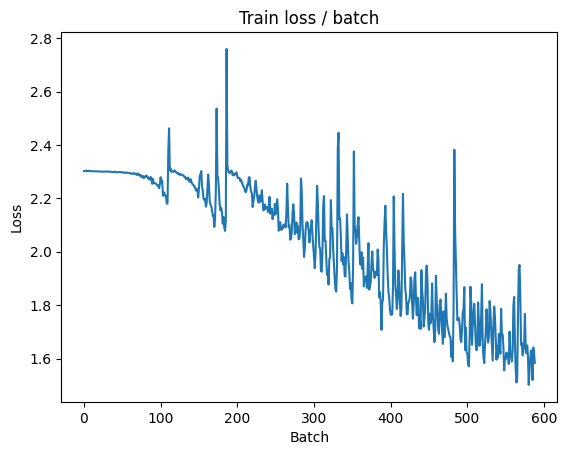


===============> Total time 8s	Avg loss 1.5822	Avg Prec@1 43.40 %	Avg Prec@5 89.71 %

[EVAL Batch 000/020]	Time 0.249s (0.249s)	Loss 1.6189 (1.6189)	Prec@1  42.4 ( 42.4)	Prec@5  89.3 ( 89.3)

===============> Total time 1s	Avg loss 1.5752	Avg Prec@1 43.04 %	Avg Prec@5 90.39 %



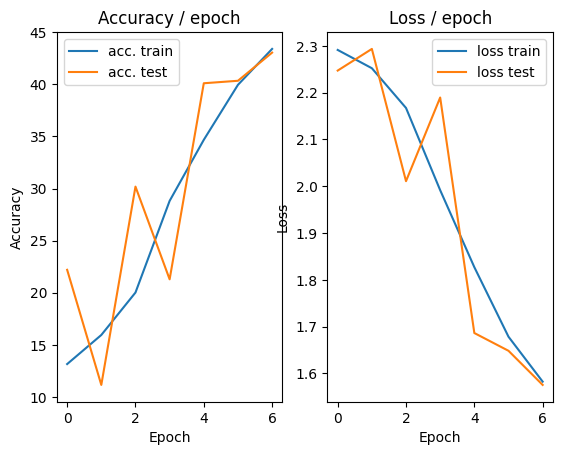

=== EPOCH 8 =====

[TRAIN Batch 000/098]	Time 0.264s (0.264s)	Loss 1.5590 (1.5590)	Prec@1  47.1 ( 47.1)	Prec@5  89.1 ( 89.1)


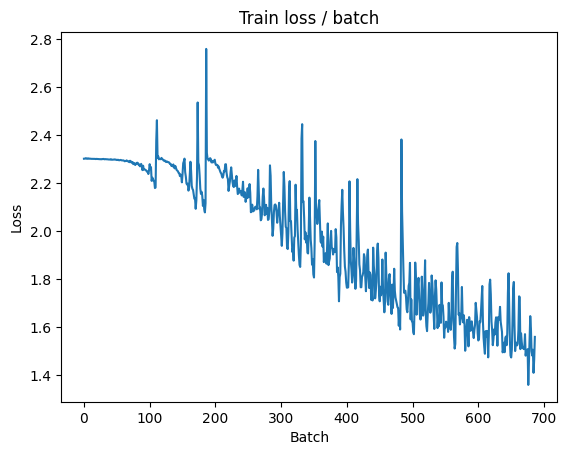


===============> Total time 8s	Avg loss 1.5039	Avg Prec@1 46.21 %	Avg Prec@5 91.22 %

[EVAL Batch 000/020]	Time 0.255s (0.255s)	Loss 1.6775 (1.6775)	Prec@1  40.2 ( 40.2)	Prec@5  85.2 ( 85.2)

===============> Total time 1s	Avg loss 1.6754	Avg Prec@1 41.40 %	Avg Prec@5 84.97 %



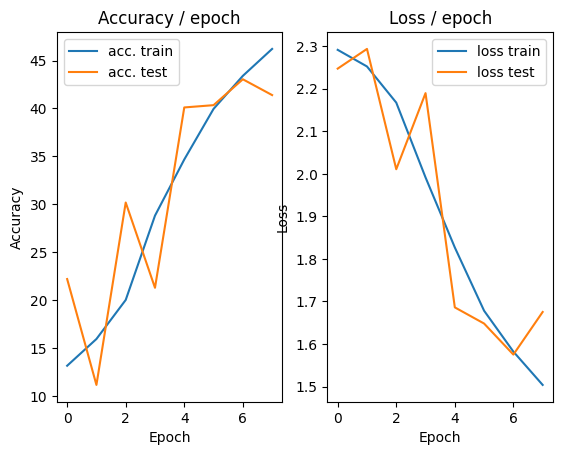

=== EPOCH 9 =====

[TRAIN Batch 000/098]	Time 0.273s (0.273s)	Loss 1.6310 (1.6310)	Prec@1  41.0 ( 41.0)	Prec@5  85.5 ( 85.5)


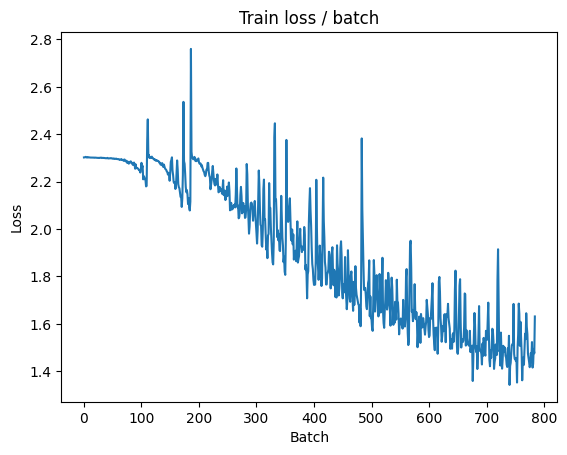


===============> Total time 7s	Avg loss 1.4416	Avg Prec@1 48.60 %	Avg Prec@5 92.08 %

[EVAL Batch 000/020]	Time 0.388s (0.388s)	Loss 1.4437 (1.4437)	Prec@1  47.9 ( 47.9)	Prec@5  93.4 ( 93.4)

===============> Total time 2s	Avg loss 1.4272	Avg Prec@1 48.91 %	Avg Prec@5 91.91 %



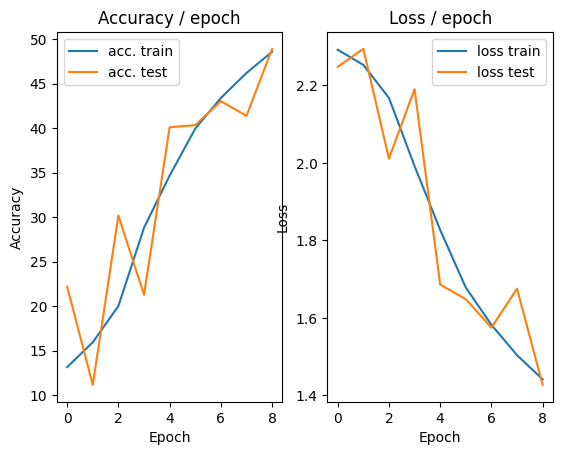

=== EPOCH 10 =====

[TRAIN Batch 000/098]	Time 0.260s (0.260s)	Loss 1.3749 (1.3749)	Prec@1  51.2 ( 51.2)	Prec@5  92.2 ( 92.2)


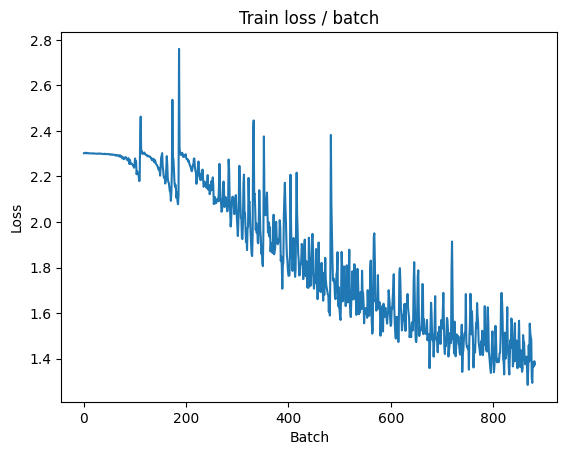


===============> Total time 7s	Avg loss 1.3825	Avg Prec@1 50.86 %	Avg Prec@5 93.03 %

[EVAL Batch 000/020]	Time 0.277s (0.277s)	Loss 1.4139 (1.4139)	Prec@1  46.9 ( 46.9)	Prec@5  93.2 ( 93.2)

===============> Total time 1s	Avg loss 1.3870	Avg Prec@1 50.34 %	Avg Prec@5 93.04 %



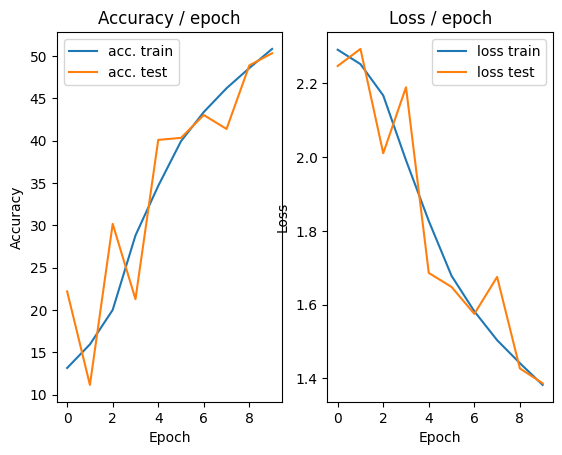

=== EPOCH 11 =====

[TRAIN Batch 000/098]	Time 0.370s (0.370s)	Loss 1.3829 (1.3829)	Prec@1  51.2 ( 51.2)	Prec@5  92.8 ( 92.8)


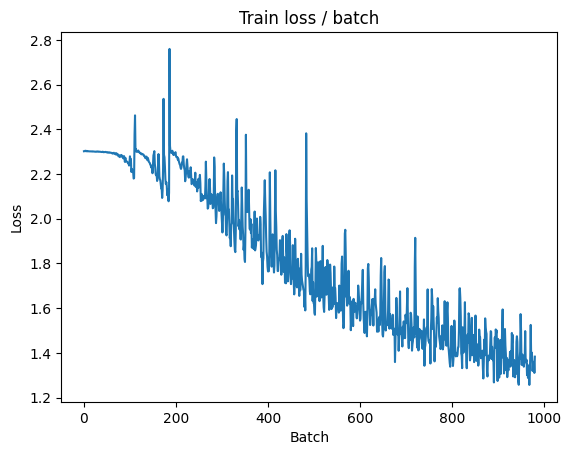


===============> Total time 8s	Avg loss 1.3245	Avg Prec@1 52.75 %	Avg Prec@5 93.77 %

[EVAL Batch 000/020]	Time 0.264s (0.264s)	Loss 1.3289 (1.3289)	Prec@1  52.5 ( 52.5)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.3236	Avg Prec@1 52.58 %	Avg Prec@5 94.00 %



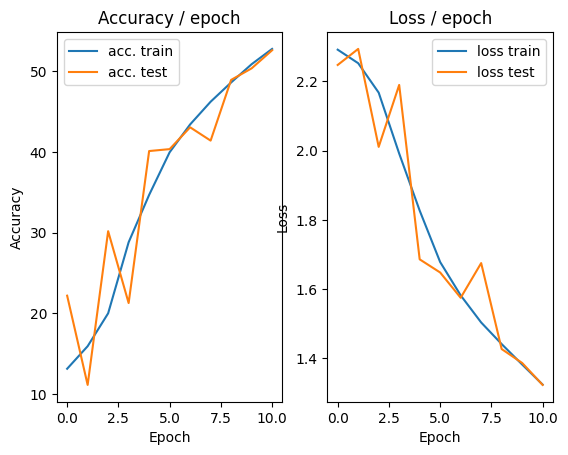

=== EPOCH 12 =====

[TRAIN Batch 000/098]	Time 0.274s (0.274s)	Loss 1.2277 (1.2277)	Prec@1  57.0 ( 57.0)	Prec@5  94.3 ( 94.3)


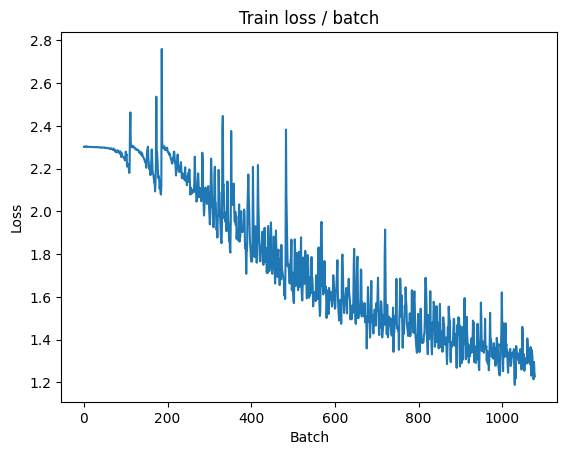


===============> Total time 8s	Avg loss 1.2810	Avg Prec@1 54.48 %	Avg Prec@5 94.31 %

[EVAL Batch 000/020]	Time 0.273s (0.273s)	Loss 1.3439 (1.3439)	Prec@1  52.7 ( 52.7)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.3187	Avg Prec@1 53.16 %	Avg Prec@5 93.78 %



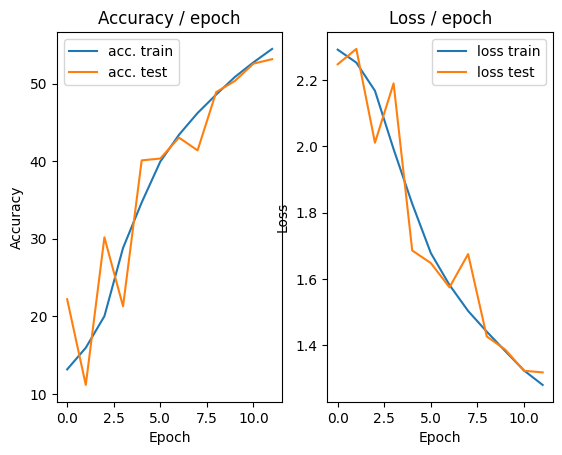

=== EPOCH 13 =====

[TRAIN Batch 000/098]	Time 0.289s (0.289s)	Loss 1.3195 (1.3195)	Prec@1  52.3 ( 52.3)	Prec@5  94.9 ( 94.9)


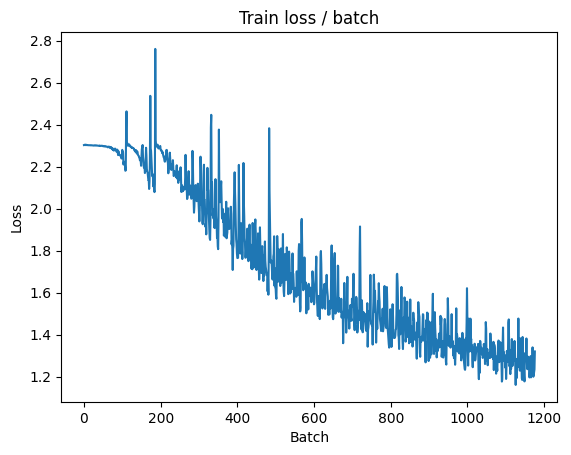


===============> Total time 8s	Avg loss 1.2499	Avg Prec@1 56.01 %	Avg Prec@5 94.41 %

[EVAL Batch 000/020]	Time 0.252s (0.252s)	Loss 1.2497 (1.2497)	Prec@1  56.8 ( 56.8)	Prec@5  95.1 ( 95.1)

===============> Total time 1s	Avg loss 1.2193	Avg Prec@1 56.48 %	Avg Prec@5 94.96 %



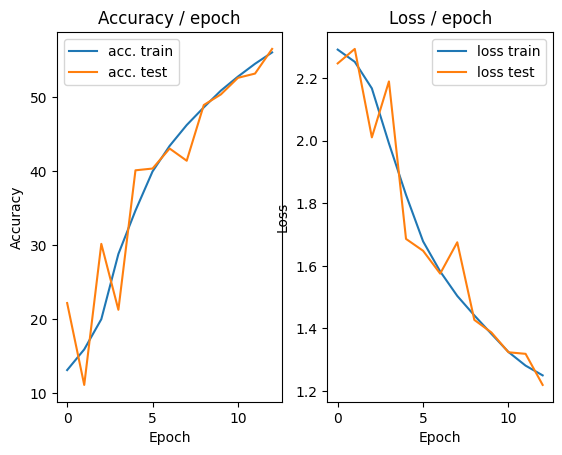

=== EPOCH 14 =====

[TRAIN Batch 000/098]	Time 0.261s (0.261s)	Loss 1.2092 (1.2092)	Prec@1  58.4 ( 58.4)	Prec@5  95.1 ( 95.1)


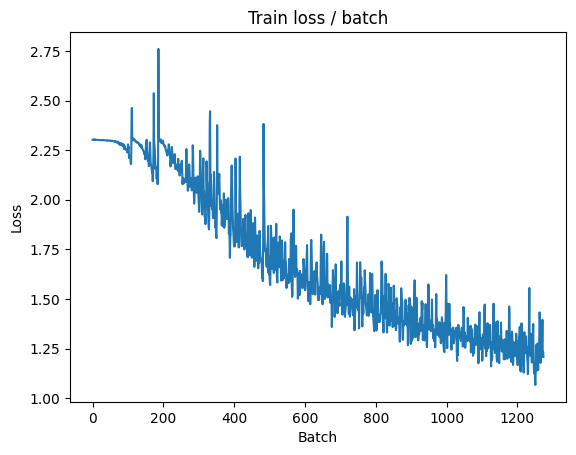


===============> Total time 9s	Avg loss 1.1897	Avg Prec@1 57.87 %	Avg Prec@5 95.20 %

[EVAL Batch 000/020]	Time 0.269s (0.269s)	Loss 1.2206 (1.2206)	Prec@1  56.2 ( 56.2)	Prec@5  94.9 ( 94.9)

===============> Total time 1s	Avg loss 1.2112	Avg Prec@1 57.10 %	Avg Prec@5 94.80 %



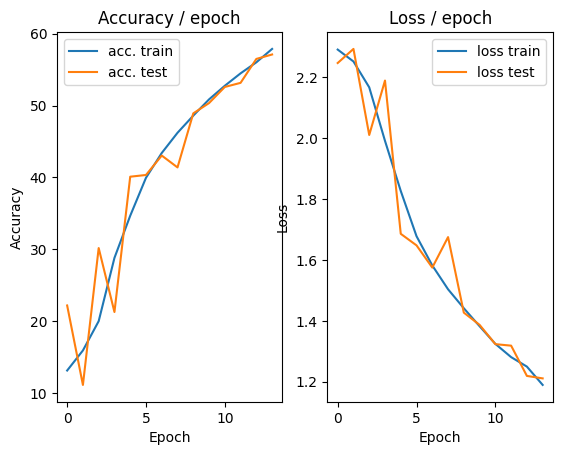

=== EPOCH 15 =====

[TRAIN Batch 000/098]	Time 0.300s (0.300s)	Loss 1.1093 (1.1093)	Prec@1  60.9 ( 60.9)	Prec@5  94.7 ( 94.7)


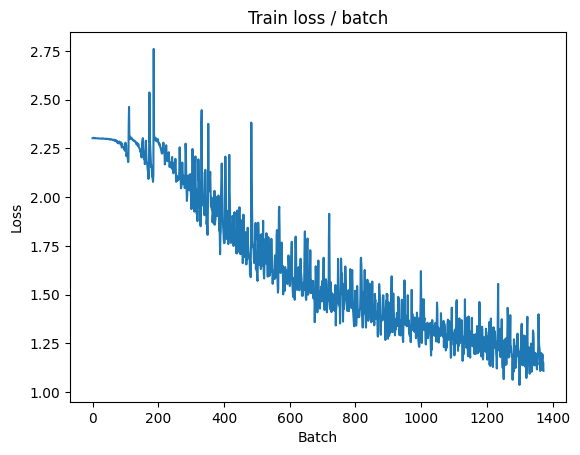


===============> Total time 7s	Avg loss 1.1557	Avg Prec@1 59.30 %	Avg Prec@5 95.57 %

[EVAL Batch 000/020]	Time 0.344s (0.344s)	Loss 1.2401 (1.2401)	Prec@1  55.9 ( 55.9)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.2059	Avg Prec@1 57.75 %	Avg Prec@5 94.68 %



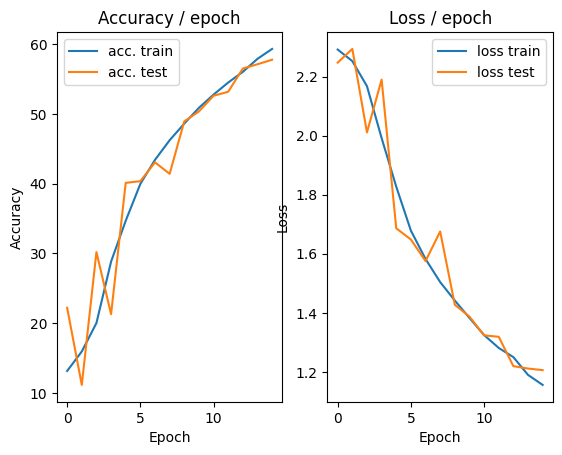

=== EPOCH 16 =====

[TRAIN Batch 000/098]	Time 0.278s (0.278s)	Loss 1.1033 (1.1033)	Prec@1  59.2 ( 59.2)	Prec@5  97.5 ( 97.5)


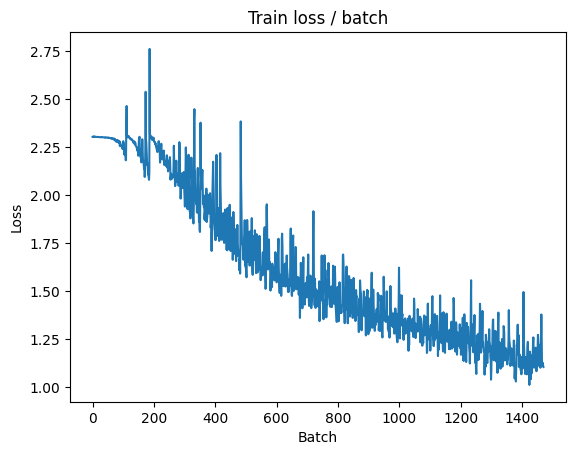


===============> Total time 7s	Avg loss 1.1063	Avg Prec@1 61.01 %	Avg Prec@5 95.93 %

[EVAL Batch 000/020]	Time 0.260s (0.260s)	Loss 1.1954 (1.1954)	Prec@1  57.6 ( 57.6)	Prec@5  96.3 ( 96.3)

===============> Total time 1s	Avg loss 1.1894	Avg Prec@1 57.93 %	Avg Prec@5 94.98 %



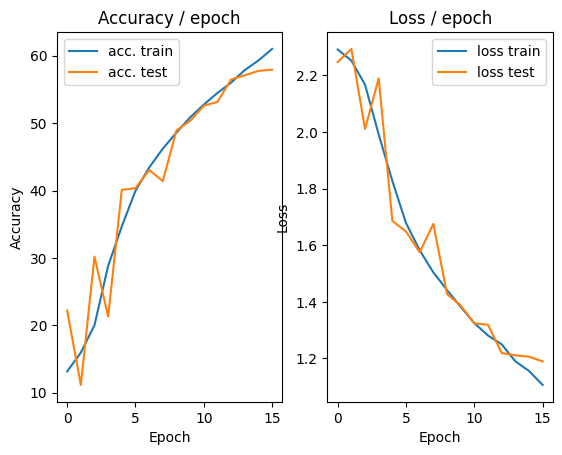

=== EPOCH 17 =====

[TRAIN Batch 000/098]	Time 0.427s (0.427s)	Loss 1.0709 (1.0709)	Prec@1  64.1 ( 64.1)	Prec@5  96.3 ( 96.3)


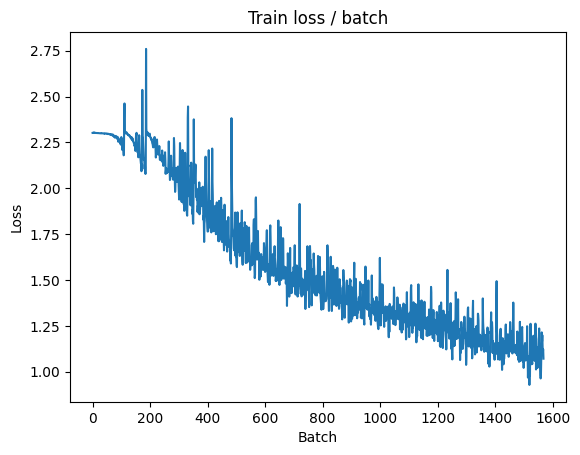


===============> Total time 8s	Avg loss 1.0621	Avg Prec@1 62.74 %	Avg Prec@5 96.19 %

[EVAL Batch 000/020]	Time 0.258s (0.258s)	Loss 1.1979 (1.1979)	Prec@1  56.4 ( 56.4)	Prec@5  95.5 ( 95.5)

===============> Total time 1s	Avg loss 1.1669	Avg Prec@1 58.90 %	Avg Prec@5 95.29 %



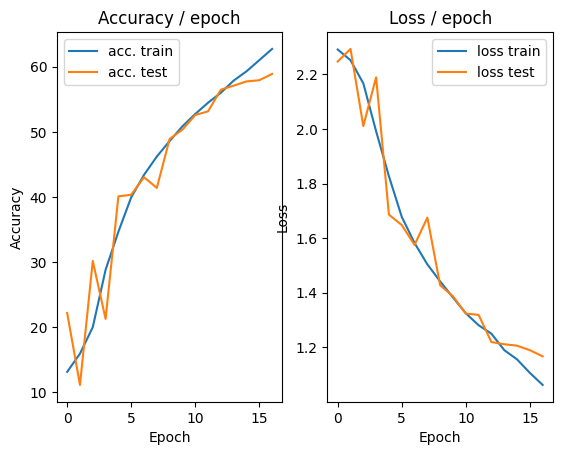

=== EPOCH 18 =====

[TRAIN Batch 000/098]	Time 0.298s (0.298s)	Loss 0.9769 (0.9769)	Prec@1  64.8 ( 64.8)	Prec@5  97.5 ( 97.5)


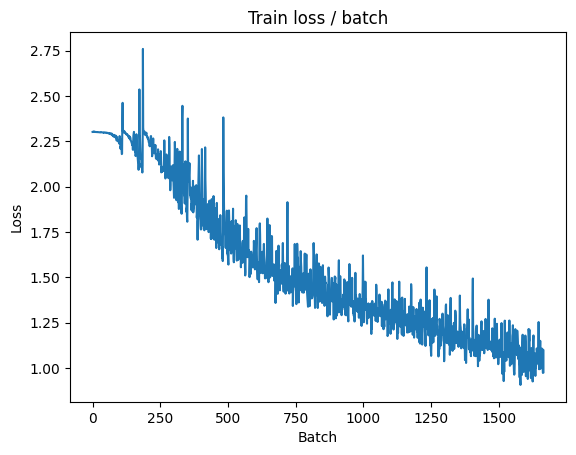


===============> Total time 8s	Avg loss 1.0282	Avg Prec@1 63.80 %	Avg Prec@5 96.55 %

[EVAL Batch 000/020]	Time 0.267s (0.267s)	Loss 1.1249 (1.1249)	Prec@1  58.8 ( 58.8)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.1230	Avg Prec@1 60.93 %	Avg Prec@5 95.96 %



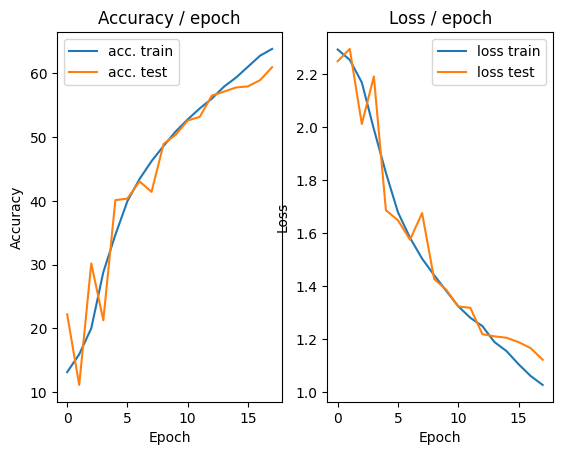

=== EPOCH 19 =====

[TRAIN Batch 000/098]	Time 0.295s (0.295s)	Loss 0.9448 (0.9448)	Prec@1  66.8 ( 66.8)	Prec@5  97.5 ( 97.5)


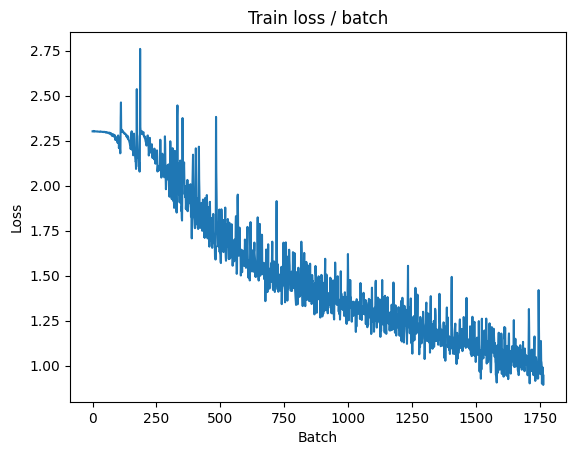


===============> Total time 8s	Avg loss 0.9781	Avg Prec@1 65.56 %	Avg Prec@5 97.01 %

[EVAL Batch 000/020]	Time 0.269s (0.269s)	Loss 1.1608 (1.1608)	Prec@1  56.4 ( 56.4)	Prec@5  96.3 ( 96.3)

===============> Total time 1s	Avg loss 1.1360	Avg Prec@1 60.55 %	Avg Prec@5 95.16 %



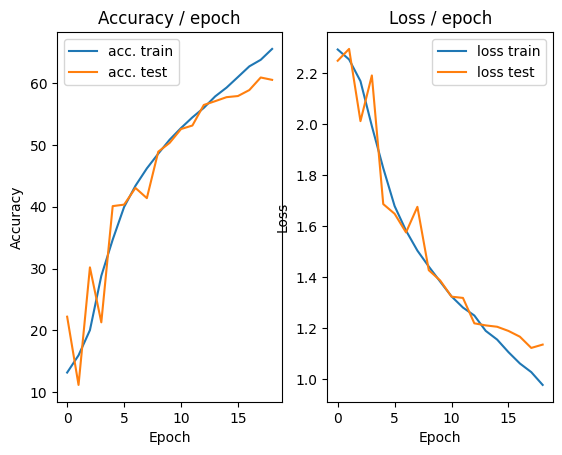

=== EPOCH 20 =====

[TRAIN Batch 000/098]	Time 0.284s (0.284s)	Loss 1.0276 (1.0276)	Prec@1  65.2 ( 65.2)	Prec@5  97.5 ( 97.5)


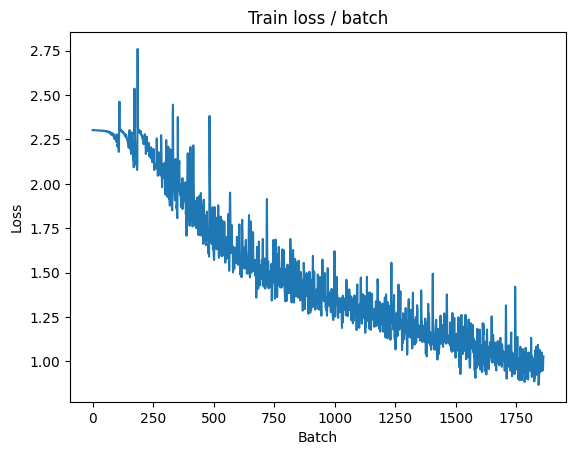


===============> Total time 8s	Avg loss 0.9465	Avg Prec@1 66.74 %	Avg Prec@5 97.14 %

[EVAL Batch 000/020]	Time 0.262s (0.262s)	Loss 1.2238 (1.2238)	Prec@1  55.9 ( 55.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.1862	Avg Prec@1 58.01 %	Avg Prec@5 95.34 %



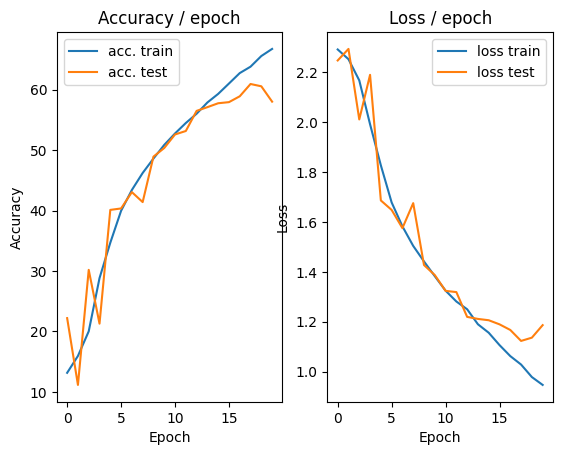

=== EPOCH 21 =====

[TRAIN Batch 000/098]	Time 0.272s (0.272s)	Loss 0.9910 (0.9910)	Prec@1  67.0 ( 67.0)	Prec@5  96.9 ( 96.9)


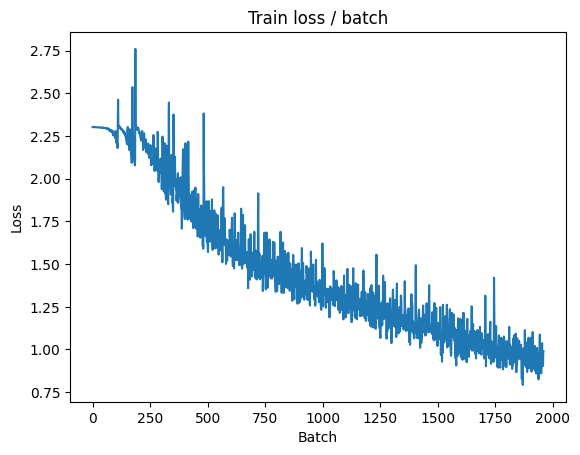


===============> Total time 7s	Avg loss 0.8989	Avg Prec@1 68.50 %	Avg Prec@5 97.49 %

[EVAL Batch 000/020]	Time 0.335s (0.335s)	Loss 1.0771 (1.0771)	Prec@1  59.8 ( 59.8)	Prec@5  98.2 ( 98.2)

===============> Total time 2s	Avg loss 1.0708	Avg Prec@1 62.66 %	Avg Prec@5 96.23 %



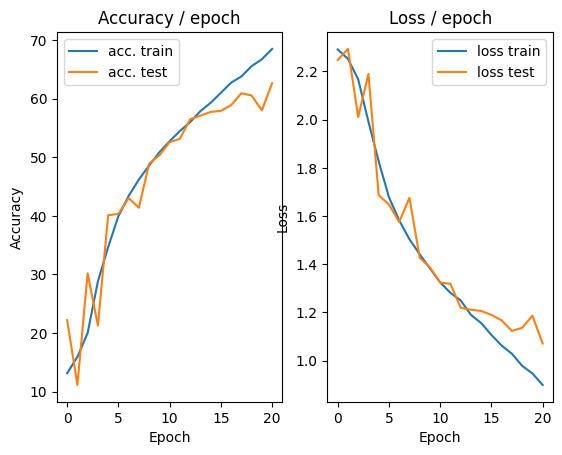

=== EPOCH 22 =====

[TRAIN Batch 000/098]	Time 0.279s (0.279s)	Loss 0.8094 (0.8094)	Prec@1  71.3 ( 71.3)	Prec@5  97.9 ( 97.9)


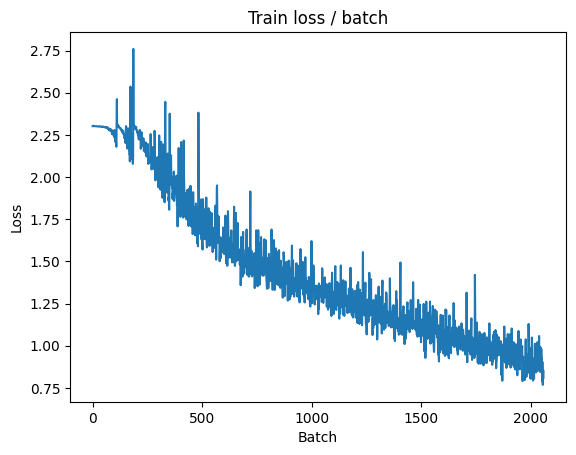


===============> Total time 8s	Avg loss 0.8665	Avg Prec@1 69.65 %	Avg Prec@5 97.71 %

[EVAL Batch 000/020]	Time 0.265s (0.265s)	Loss 1.2747 (1.2747)	Prec@1  55.7 ( 55.7)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.2371	Avg Prec@1 57.90 %	Avg Prec@5 94.93 %



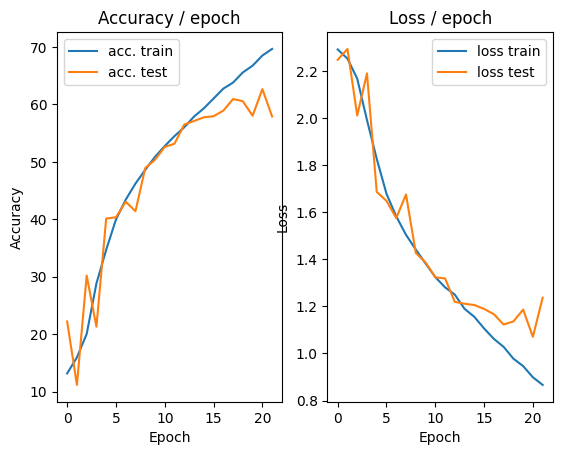

=== EPOCH 23 =====

[TRAIN Batch 000/098]	Time 0.442s (0.442s)	Loss 0.9640 (0.9640)	Prec@1  65.8 ( 65.8)	Prec@5  97.1 ( 97.1)


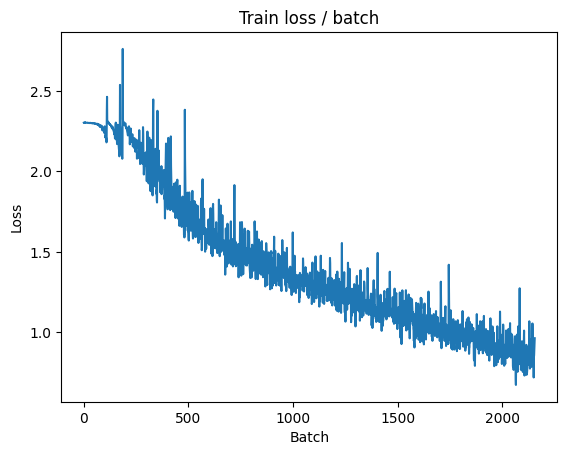


===============> Total time 8s	Avg loss 0.8265	Avg Prec@1 71.05 %	Avg Prec@5 97.91 %

[EVAL Batch 000/020]	Time 0.267s (0.267s)	Loss 1.0754 (1.0754)	Prec@1  61.1 ( 61.1)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.0645	Avg Prec@1 62.59 %	Avg Prec@5 96.17 %



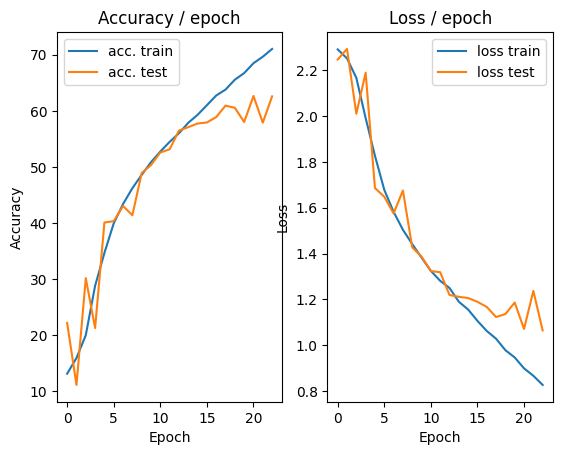

=== EPOCH 24 =====

[TRAIN Batch 000/098]	Time 0.297s (0.297s)	Loss 0.7968 (0.7968)	Prec@1  72.7 ( 72.7)	Prec@5  98.6 ( 98.6)


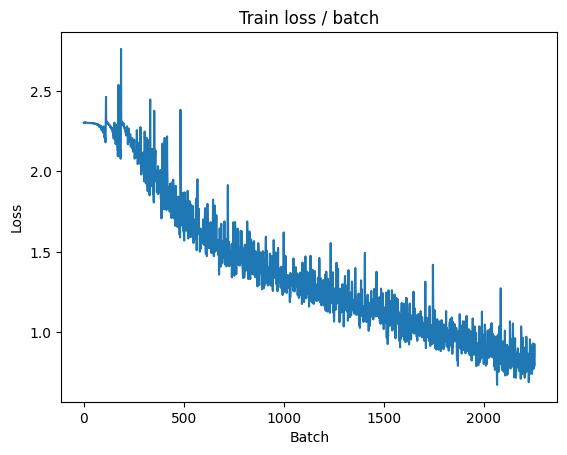


===============> Total time 8s	Avg loss 0.7785	Avg Prec@1 72.64 %	Avg Prec@5 98.31 %

[EVAL Batch 000/020]	Time 0.280s (0.280s)	Loss 1.0485 (1.0485)	Prec@1  61.1 ( 61.1)	Prec@5  98.2 ( 98.2)

===============> Total time 1s	Avg loss 1.0418	Avg Prec@1 64.21 %	Avg Prec@5 96.18 %



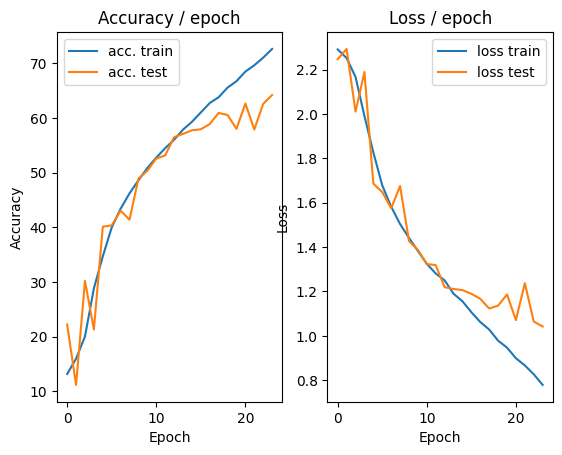

=== EPOCH 25 =====

[TRAIN Batch 000/098]	Time 0.314s (0.314s)	Loss 0.6545 (0.6545)	Prec@1  76.8 ( 76.8)	Prec@5  99.0 ( 99.0)


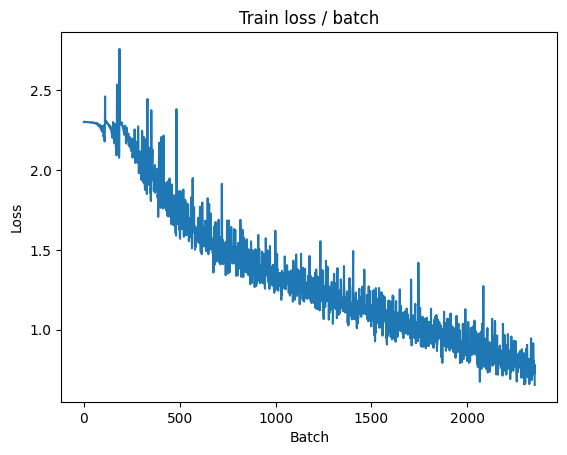


===============> Total time 8s	Avg loss 0.7436	Avg Prec@1 74.11 %	Avg Prec@5 98.43 %

[EVAL Batch 000/020]	Time 0.274s (0.274s)	Loss 1.0539 (1.0539)	Prec@1  63.1 ( 63.1)	Prec@5  95.9 ( 95.9)

===============> Total time 1s	Avg loss 1.0511	Avg Prec@1 64.30 %	Avg Prec@5 96.20 %



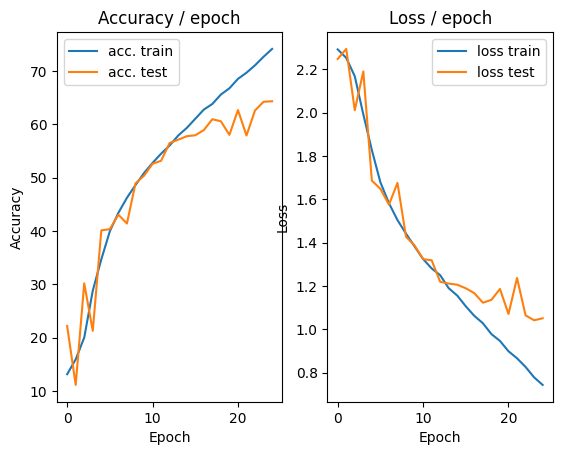

=== EPOCH 26 =====

[TRAIN Batch 000/098]	Time 0.308s (0.308s)	Loss 0.7800 (0.7800)	Prec@1  74.0 ( 74.0)	Prec@5  96.9 ( 96.9)


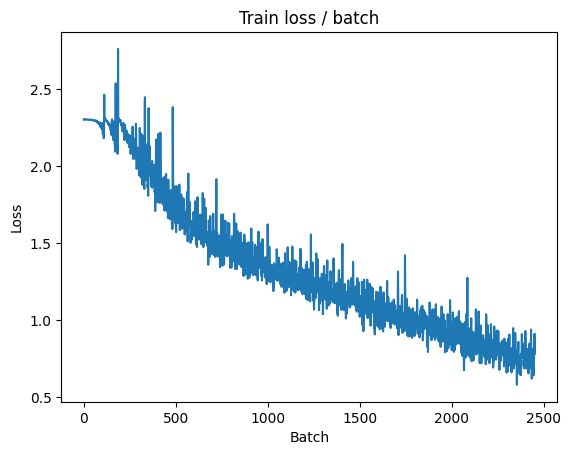


===============> Total time 8s	Avg loss 0.7094	Avg Prec@1 75.24 %	Avg Prec@5 98.65 %

[EVAL Batch 000/020]	Time 0.255s (0.255s)	Loss 1.0247 (1.0247)	Prec@1  64.5 ( 64.5)	Prec@5  97.9 ( 97.9)

===============> Total time 1s	Avg loss 1.0484	Avg Prec@1 64.65 %	Avg Prec@5 96.03 %



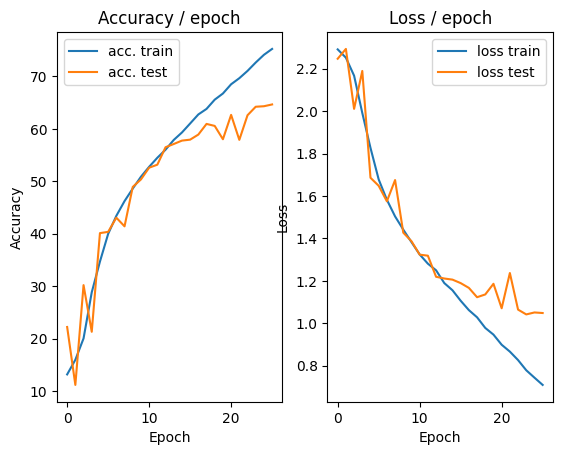

=== EPOCH 27 =====

[TRAIN Batch 000/098]	Time 0.338s (0.338s)	Loss 0.7041 (0.7041)	Prec@1  74.0 ( 74.0)	Prec@5  99.6 ( 99.6)


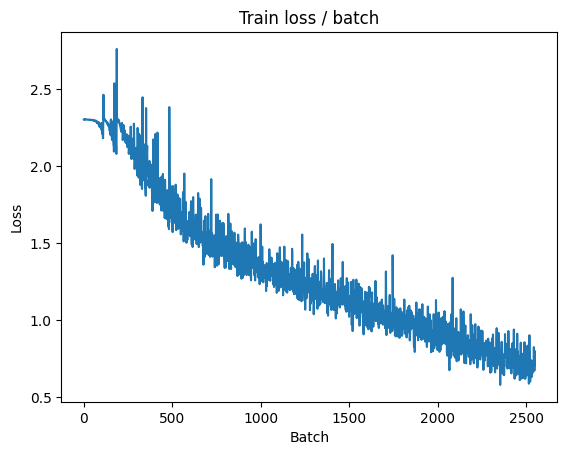


===============> Total time 7s	Avg loss 0.6746	Avg Prec@1 76.56 %	Avg Prec@5 98.79 %

[EVAL Batch 000/020]	Time 0.489s (0.489s)	Loss 0.9737 (0.9737)	Prec@1  64.3 ( 64.3)	Prec@5  98.2 ( 98.2)

===============> Total time 2s	Avg loss 0.9781	Avg Prec@1 66.64 %	Avg Prec@5 96.79 %



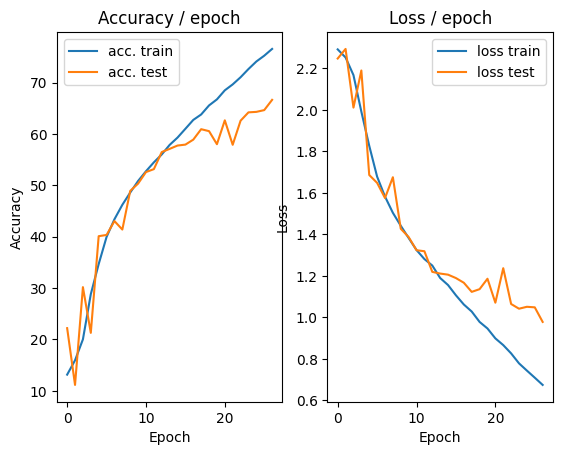

=== EPOCH 28 =====

[TRAIN Batch 000/098]	Time 0.296s (0.296s)	Loss 0.5441 (0.5441)	Prec@1  82.8 ( 82.8)	Prec@5  98.6 ( 98.6)


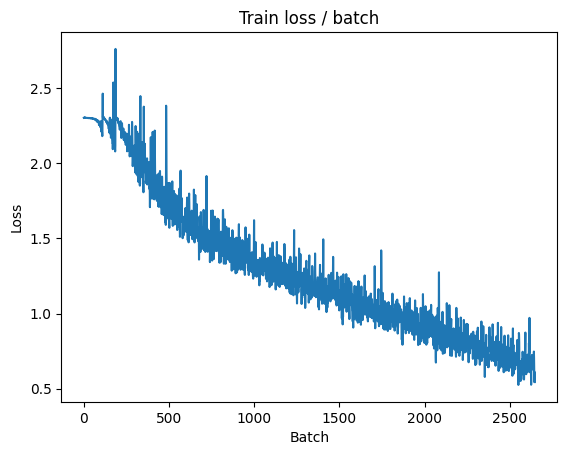


===============> Total time 7s	Avg loss 0.6325	Avg Prec@1 77.98 %	Avg Prec@5 98.98 %

[EVAL Batch 000/020]	Time 0.259s (0.259s)	Loss 1.0878 (1.0878)	Prec@1  64.1 ( 64.1)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.0840	Avg Prec@1 64.38 %	Avg Prec@5 96.41 %



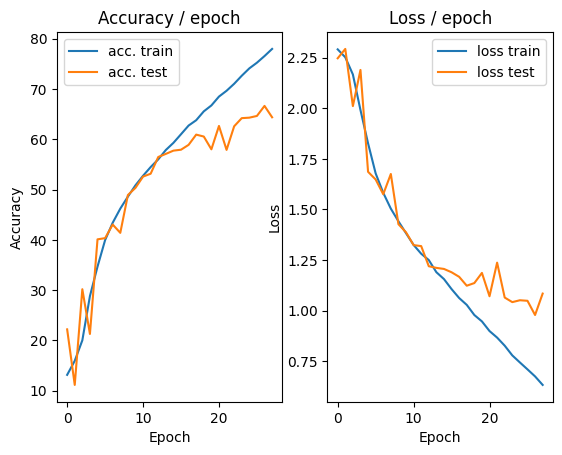

=== EPOCH 29 =====

[TRAIN Batch 000/098]	Time 0.442s (0.442s)	Loss 0.6237 (0.6237)	Prec@1  78.3 ( 78.3)	Prec@5  98.2 ( 98.2)


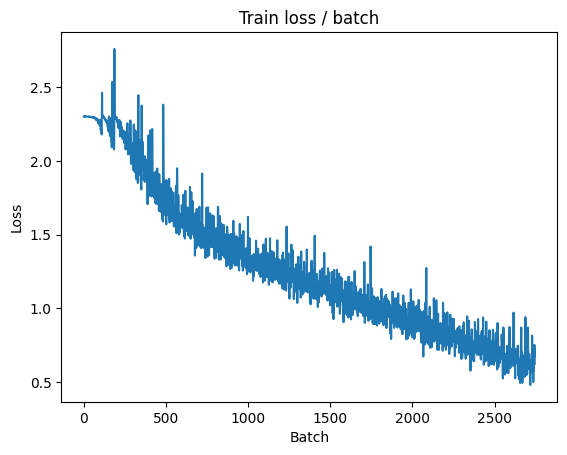


===============> Total time 8s	Avg loss 0.5862	Avg Prec@1 79.59 %	Avg Prec@5 99.07 %

[EVAL Batch 000/020]	Time 0.253s (0.253s)	Loss 1.1663 (1.1663)	Prec@1  61.5 ( 61.5)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.1675	Avg Prec@1 62.32 %	Avg Prec@5 96.06 %



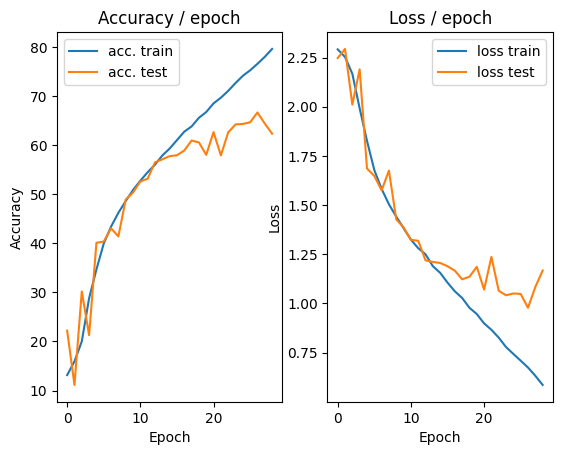

=== EPOCH 30 =====

[TRAIN Batch 000/098]	Time 0.319s (0.319s)	Loss 0.6374 (0.6374)	Prec@1  77.5 ( 77.5)	Prec@5  99.6 ( 99.6)


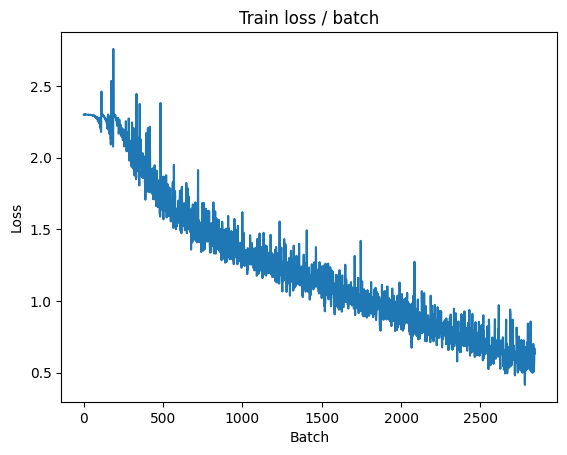


===============> Total time 8s	Avg loss 0.5435	Avg Prec@1 80.93 %	Avg Prec@5 99.32 %

[EVAL Batch 000/020]	Time 0.262s (0.262s)	Loss 1.0969 (1.0969)	Prec@1  62.7 ( 62.7)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.1174	Avg Prec@1 64.17 %	Avg Prec@5 96.45 %



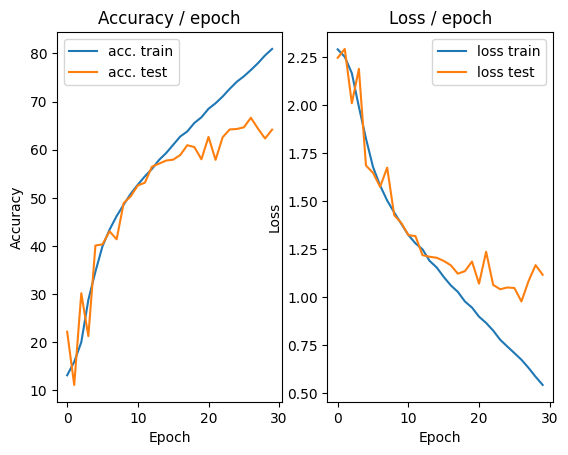

=== EPOCH 31 =====

[TRAIN Batch 000/098]	Time 0.308s (0.308s)	Loss 0.5219 (0.5219)	Prec@1  81.8 ( 81.8)	Prec@5  99.8 ( 99.8)


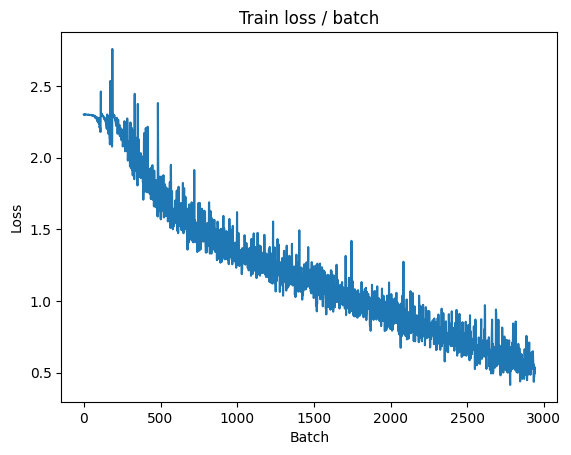


===============> Total time 8s	Avg loss 0.5173	Avg Prec@1 82.25 %	Avg Prec@5 99.34 %

[EVAL Batch 000/020]	Time 0.272s (0.272s)	Loss 1.1273 (1.1273)	Prec@1  62.3 ( 62.3)	Prec@5  96.7 ( 96.7)

===============> Total time 1s	Avg loss 1.1539	Avg Prec@1 64.51 %	Avg Prec@5 96.13 %



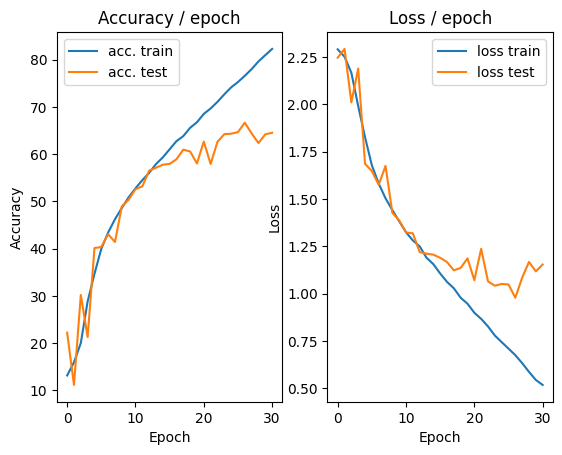

=== EPOCH 32 =====

[TRAIN Batch 000/098]	Time 0.333s (0.333s)	Loss 0.5192 (0.5192)	Prec@1  82.4 ( 82.4)	Prec@5  99.4 ( 99.4)


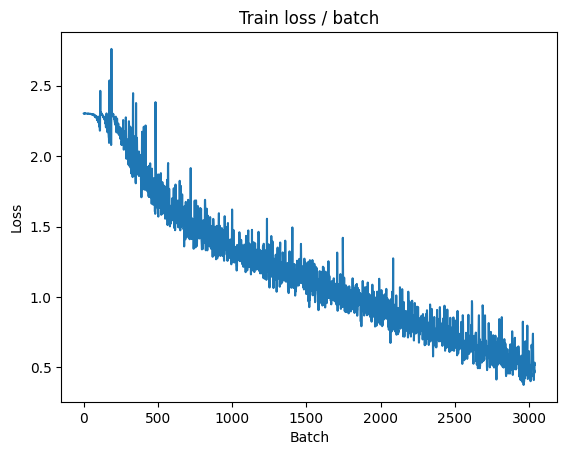


===============> Total time 8s	Avg loss 0.4665	Avg Prec@1 83.77 %	Avg Prec@5 99.54 %

[EVAL Batch 000/020]	Time 0.264s (0.264s)	Loss 1.0398 (1.0398)	Prec@1  68.2 ( 68.2)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.0787	Avg Prec@1 66.85 %	Avg Prec@5 96.58 %



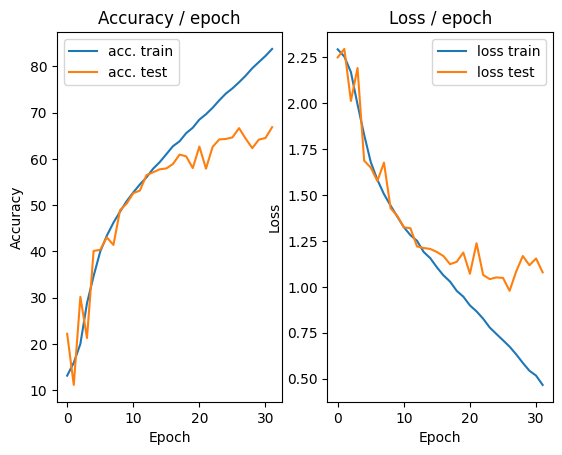

=== EPOCH 33 =====

[TRAIN Batch 000/098]	Time 0.296s (0.296s)	Loss 0.3869 (0.3869)	Prec@1  85.9 ( 85.9)	Prec@5  99.8 ( 99.8)


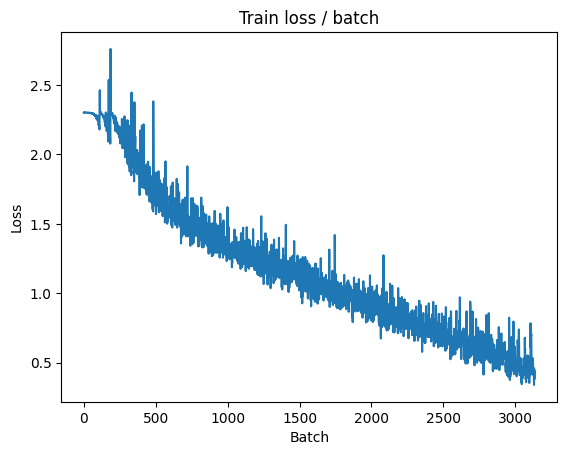


===============> Total time 7s	Avg loss 0.4283	Avg Prec@1 85.25 %	Avg Prec@5 99.58 %

[EVAL Batch 000/020]	Time 0.424s (0.424s)	Loss 1.4266 (1.4266)	Prec@1  56.2 ( 56.2)	Prec@5  95.1 ( 95.1)

===============> Total time 2s	Avg loss 1.3865	Avg Prec@1 59.32 %	Avg Prec@5 94.17 %



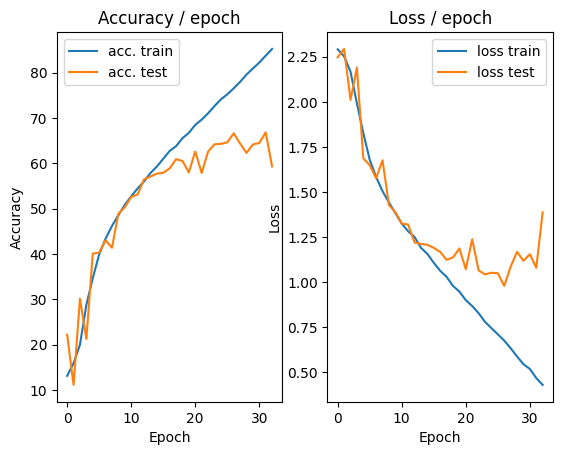

=== EPOCH 34 =====

[TRAIN Batch 000/098]	Time 0.331s (0.331s)	Loss 0.6927 (0.6927)	Prec@1  74.4 ( 74.4)	Prec@5  98.8 ( 98.8)


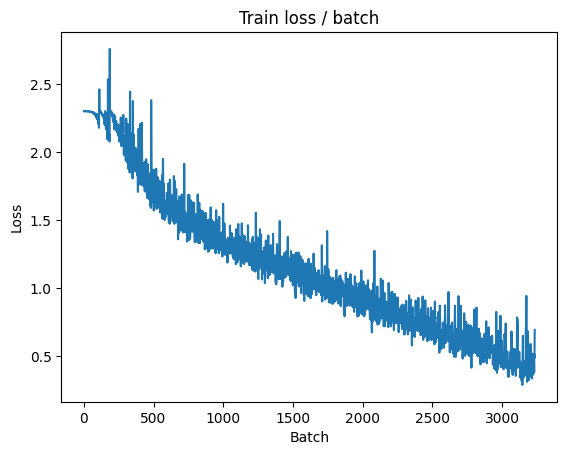


===============> Total time 7s	Avg loss 0.3887	Avg Prec@1 86.73 %	Avg Prec@5 99.68 %

[EVAL Batch 000/020]	Time 0.262s (0.262s)	Loss 1.2527 (1.2527)	Prec@1  64.1 ( 64.1)	Prec@5  96.3 ( 96.3)

===============> Total time 1s	Avg loss 1.3266	Avg Prec@1 63.49 %	Avg Prec@5 96.06 %



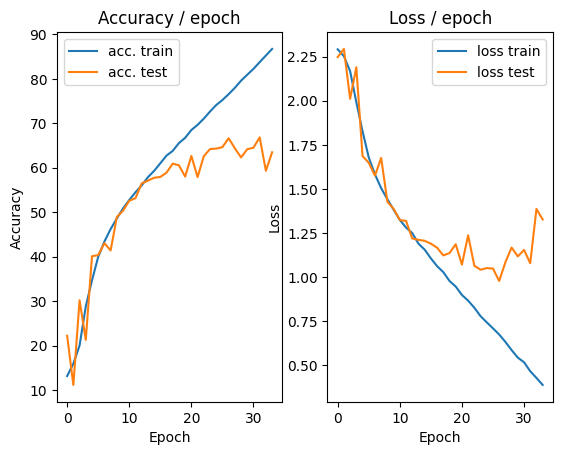

=== EPOCH 35 =====

[TRAIN Batch 000/098]	Time 0.500s (0.500s)	Loss 0.4455 (0.4455)	Prec@1  84.4 ( 84.4)	Prec@5  99.8 ( 99.8)


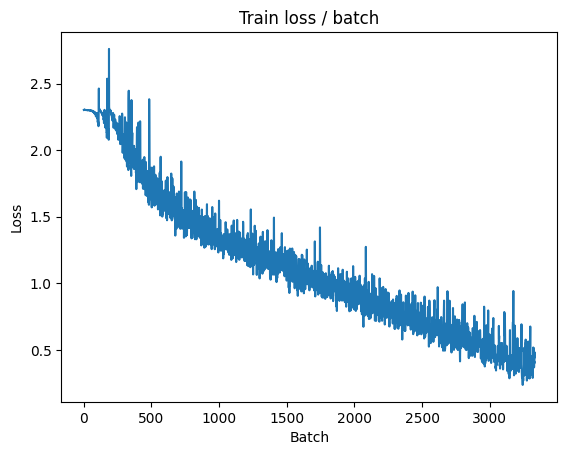


===============> Total time 8s	Avg loss 0.3377	Avg Prec@1 88.63 %	Avg Prec@5 99.82 %

[EVAL Batch 000/020]	Time 0.268s (0.268s)	Loss 1.6542 (1.6542)	Prec@1  58.0 ( 58.0)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.6821	Avg Prec@1 59.79 %	Avg Prec@5 93.31 %



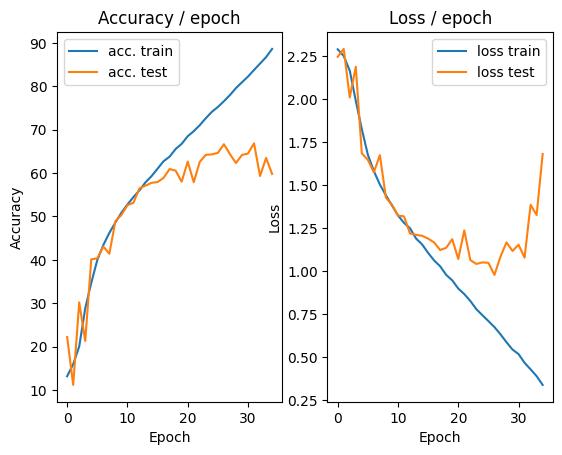

=== EPOCH 36 =====

[TRAIN Batch 000/098]	Time 0.308s (0.308s)	Loss 0.7365 (0.7365)	Prec@1  77.1 ( 77.1)	Prec@5  98.4 ( 98.4)


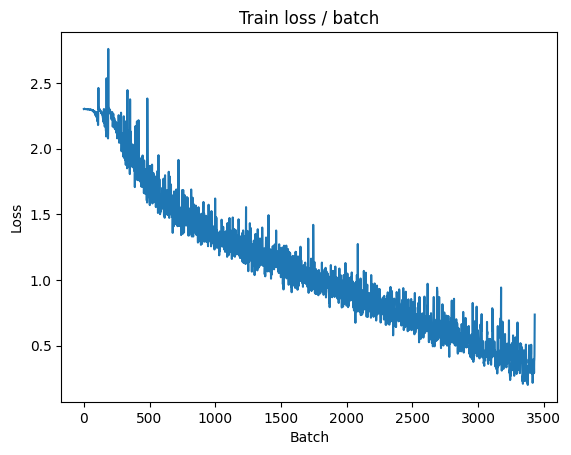


===============> Total time 8s	Avg loss 0.4577	Avg Prec@1 85.46 %	Avg Prec@5 99.18 %

[EVAL Batch 000/020]	Time 0.268s (0.268s)	Loss 1.2015 (1.2015)	Prec@1  63.7 ( 63.7)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.2497	Avg Prec@1 64.94 %	Avg Prec@5 96.35 %



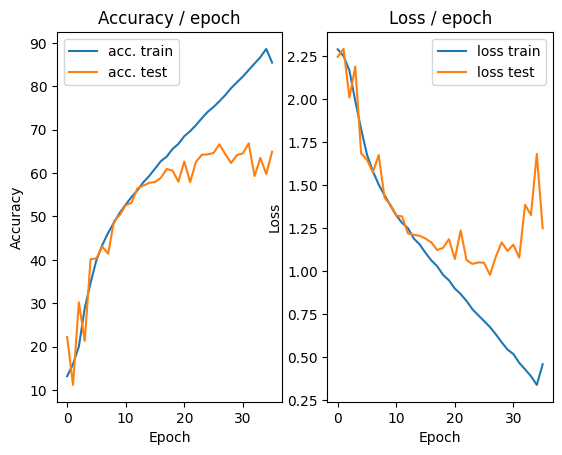

=== EPOCH 37 =====

[TRAIN Batch 000/098]	Time 0.342s (0.342s)	Loss 0.2765 (0.2765)	Prec@1  91.2 ( 91.2)	Prec@5  99.8 ( 99.8)


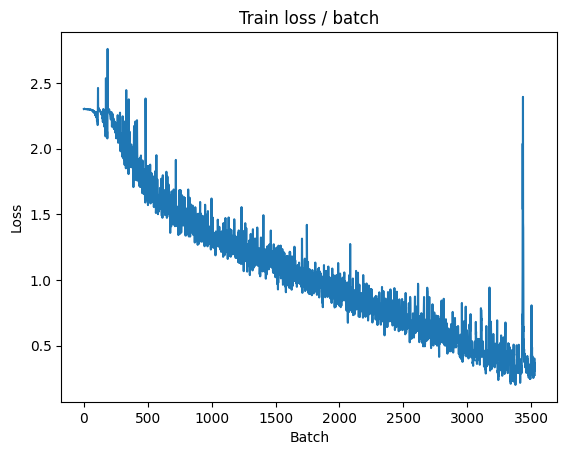


===============> Total time 8s	Avg loss 0.2679	Avg Prec@1 91.30 %	Avg Prec@5 99.86 %

[EVAL Batch 000/020]	Time 0.263s (0.263s)	Loss 1.1748 (1.1748)	Prec@1  67.8 ( 67.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.2260	Avg Prec@1 66.83 %	Avg Prec@5 96.37 %



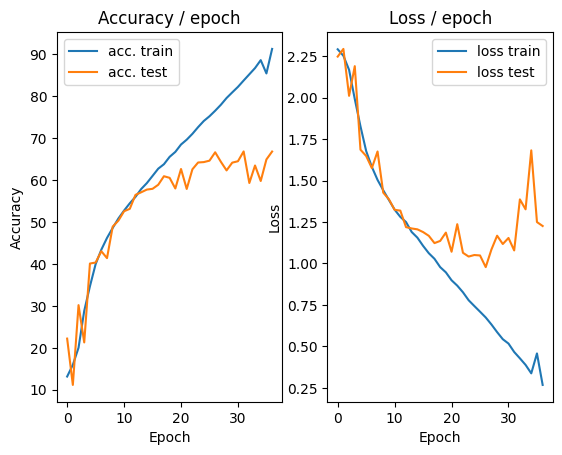

=== EPOCH 38 =====

[TRAIN Batch 000/098]	Time 0.331s (0.331s)	Loss 0.2100 (0.2100)	Prec@1  92.8 ( 92.8)	Prec@5  99.8 ( 99.8)


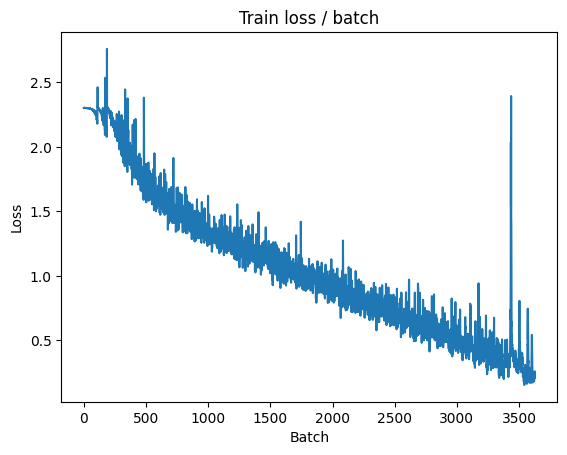


===============> Total time 9s	Avg loss 0.2300	Avg Prec@1 93.06 %	Avg Prec@5 99.82 %

[EVAL Batch 000/020]	Time 0.293s (0.293s)	Loss 1.1906 (1.1906)	Prec@1  68.9 ( 68.9)	Prec@5  97.5 ( 97.5)

===============> Total time 1s	Avg loss 1.2361	Avg Prec@1 68.03 %	Avg Prec@5 96.67 %



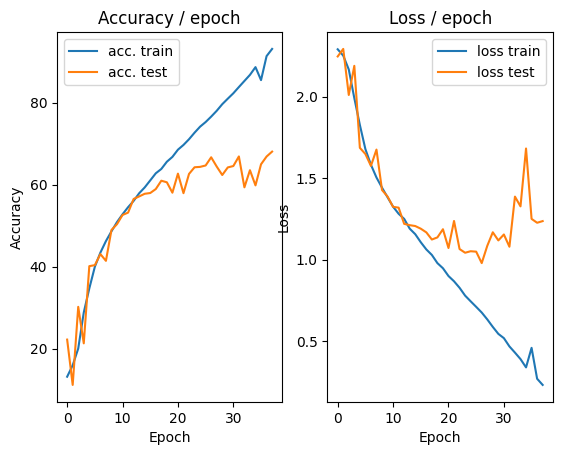

=== EPOCH 39 =====

[TRAIN Batch 000/098]	Time 0.338s (0.338s)	Loss 0.1079 (0.1079)	Prec@1  97.7 ( 97.7)	Prec@5  99.8 ( 99.8)


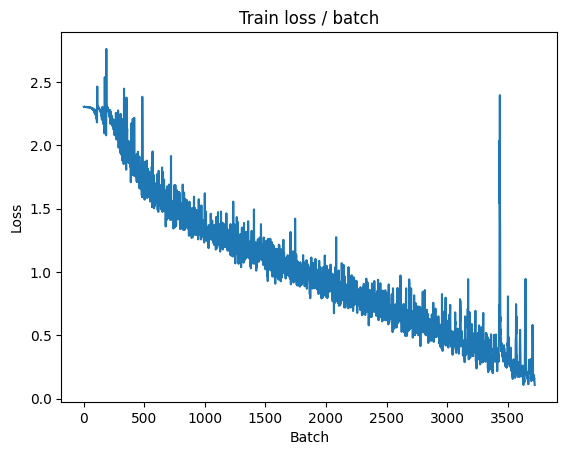


===============> Total time 8s	Avg loss 0.5374	Avg Prec@1 85.55 %	Avg Prec@5 98.21 %

[EVAL Batch 000/020]	Time 0.485s (0.485s)	Loss 1.1899 (1.1899)	Prec@1  60.2 ( 60.2)	Prec@5  96.3 ( 96.3)

===============> Total time 2s	Avg loss 1.1388	Avg Prec@1 63.50 %	Avg Prec@5 96.25 %



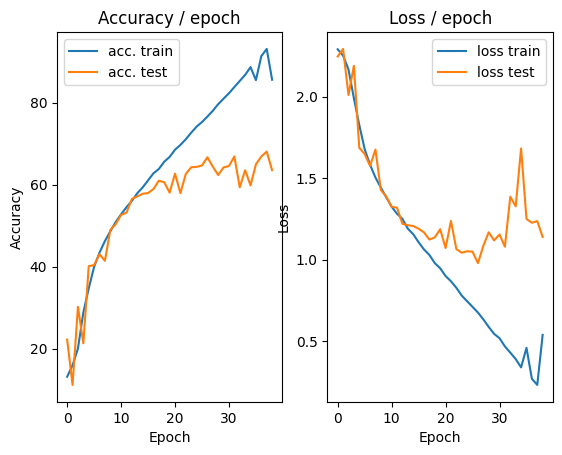

=== EPOCH 40 =====

[TRAIN Batch 000/098]	Time 0.323s (0.323s)	Loss 0.5307 (0.5307)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


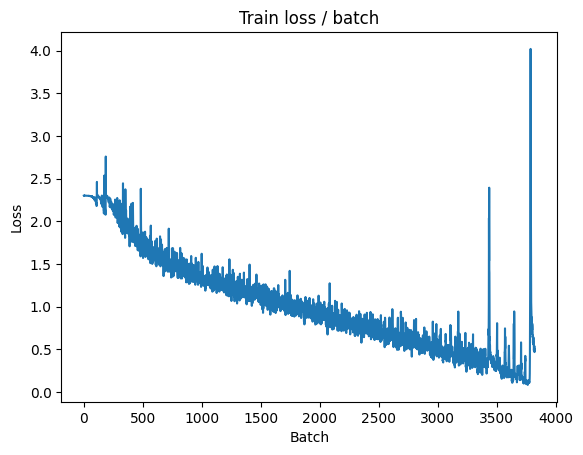


===============> Total time 7s	Avg loss 0.3773	Avg Prec@1 87.11 %	Avg Prec@5 99.78 %

[EVAL Batch 000/020]	Time 0.297s (0.297s)	Loss 1.2132 (1.2132)	Prec@1  65.0 ( 65.0)	Prec@5  96.5 ( 96.5)

===============> Total time 1s	Avg loss 1.2034	Avg Prec@1 65.83 %	Avg Prec@5 96.30 %



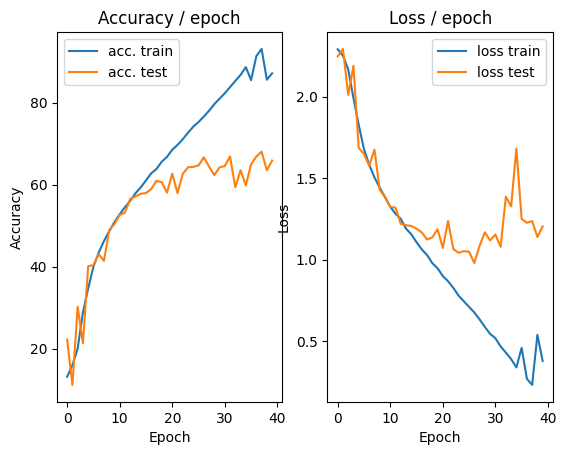

=== EPOCH 41 =====

[TRAIN Batch 000/098]	Time 0.340s (0.340s)	Loss 0.2871 (0.2871)	Prec@1  89.6 ( 89.6)	Prec@5 100.0 (100.0)


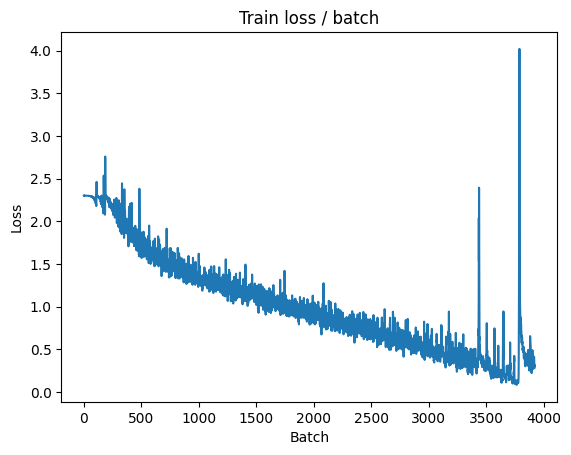


===============> Total time 8s	Avg loss 0.2272	Avg Prec@1 92.83 %	Avg Prec@5 99.93 %

[EVAL Batch 000/020]	Time 0.283s (0.283s)	Loss 1.2629 (1.2629)	Prec@1  67.8 ( 67.8)	Prec@5  95.9 ( 95.9)

===============> Total time 1s	Avg loss 1.3150	Avg Prec@1 66.39 %	Avg Prec@5 96.38 %



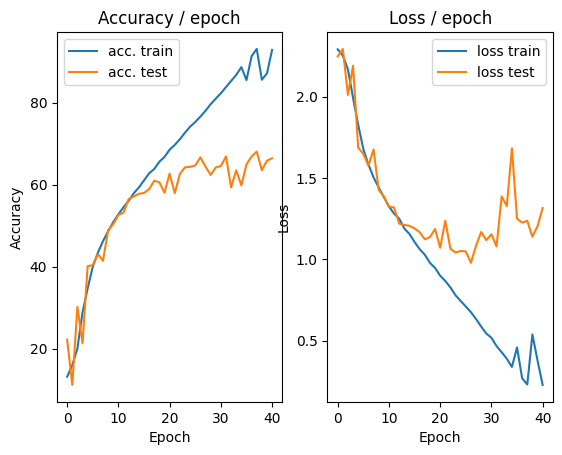

=== EPOCH 42 =====

[TRAIN Batch 000/098]	Time 0.331s (0.331s)	Loss 0.1835 (0.1835)	Prec@1  93.6 ( 93.6)	Prec@5 100.0 (100.0)


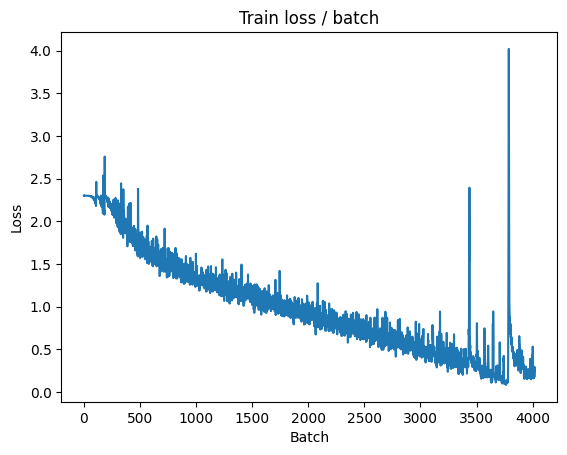


===============> Total time 8s	Avg loss 0.2332	Avg Prec@1 93.24 %	Avg Prec@5 99.78 %

[EVAL Batch 000/020]	Time 0.286s (0.286s)	Loss 1.1950 (1.1950)	Prec@1  67.6 ( 67.6)	Prec@5  97.3 ( 97.3)

===============> Total time 1s	Avg loss 1.2244	Avg Prec@1 67.69 %	Avg Prec@5 96.76 %



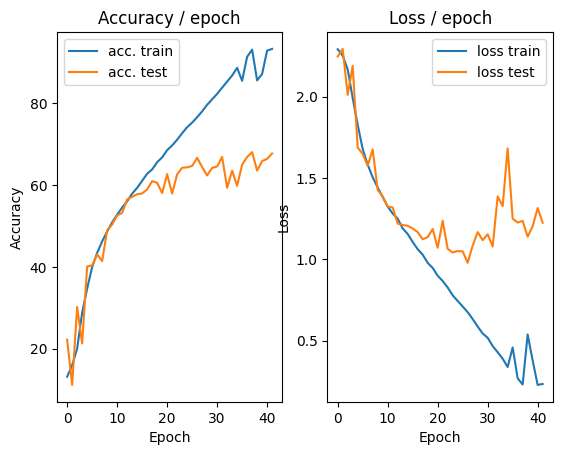

=== EPOCH 43 =====

[TRAIN Batch 000/098]	Time 0.364s (0.364s)	Loss 0.0966 (0.0966)	Prec@1  98.2 ( 98.2)	Prec@5 100.0 (100.0)


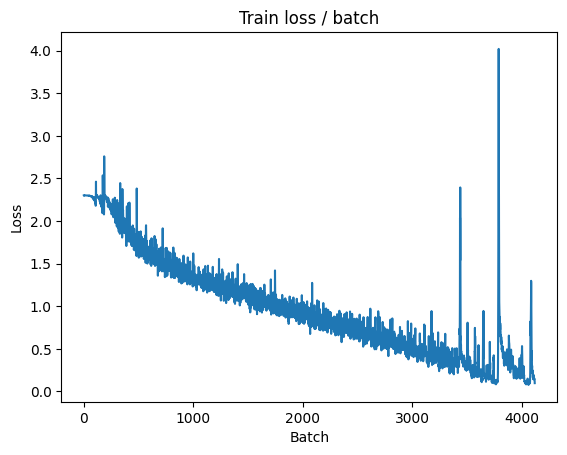


===============> Total time 8s	Avg loss 0.1434	Avg Prec@1 96.08 %	Avg Prec@5 99.91 %

[EVAL Batch 000/020]	Time 0.282s (0.282s)	Loss 1.7617 (1.7617)	Prec@1  58.4 ( 58.4)	Prec@5  94.1 ( 94.1)

===============> Total time 1s	Avg loss 1.7616	Avg Prec@1 60.73 %	Avg Prec@5 94.07 %



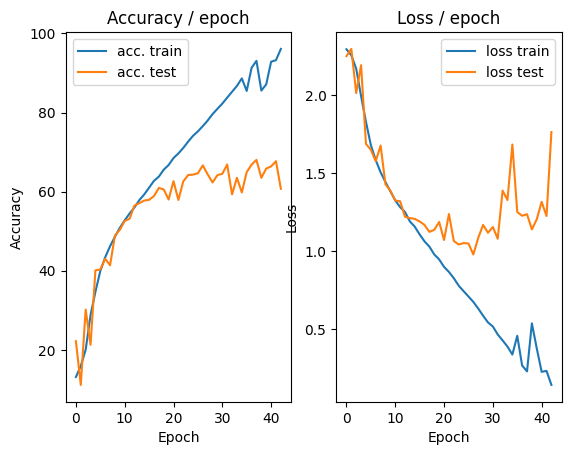

=== EPOCH 44 =====

[TRAIN Batch 000/098]	Time 0.307s (0.307s)	Loss 0.7429 (0.7429)	Prec@1  85.9 ( 85.9)	Prec@5  97.9 ( 97.9)


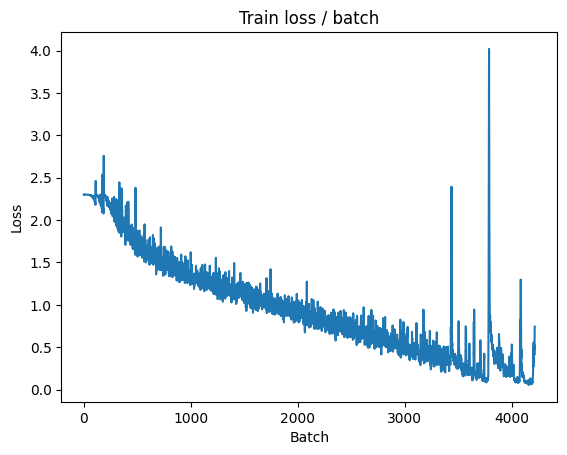


===============> Total time 8s	Avg loss 0.0731	Avg Prec@1 98.65 %	Avg Prec@5 99.98 %

[EVAL Batch 000/020]	Time 0.287s (0.287s)	Loss 1.4270 (1.4270)	Prec@1  67.4 ( 67.4)	Prec@5  97.5 ( 97.5)

===============> Total time 1s	Avg loss 1.4828	Avg Prec@1 68.17 %	Avg Prec@5 96.75 %



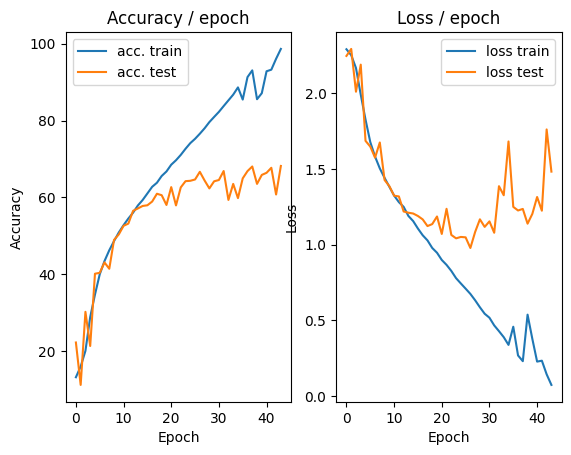

=== EPOCH 45 =====

[TRAIN Batch 000/098]	Time 0.318s (0.318s)	Loss 0.0435 (0.0435)	Prec@1  99.0 ( 99.0)	Prec@5 100.0 (100.0)


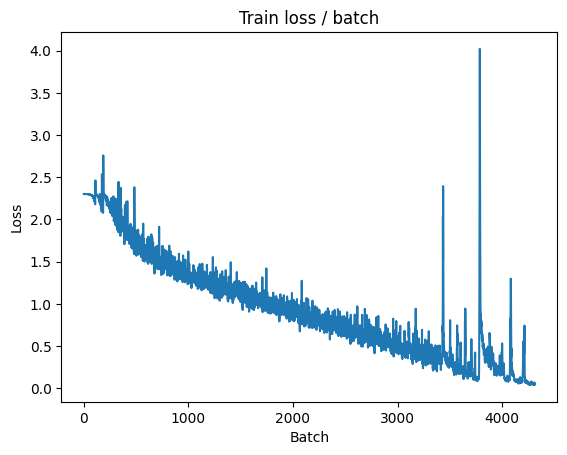


===============> Total time 8s	Avg loss 0.0307	Avg Prec@1 99.61 %	Avg Prec@5 100.00 %

[EVAL Batch 000/020]	Time 0.452s (0.452s)	Loss 1.5877 (1.5877)	Prec@1  66.8 ( 66.8)	Prec@5  97.3 ( 97.3)

===============> Total time 2s	Avg loss 1.6287	Avg Prec@1 67.24 %	Avg Prec@5 96.52 %



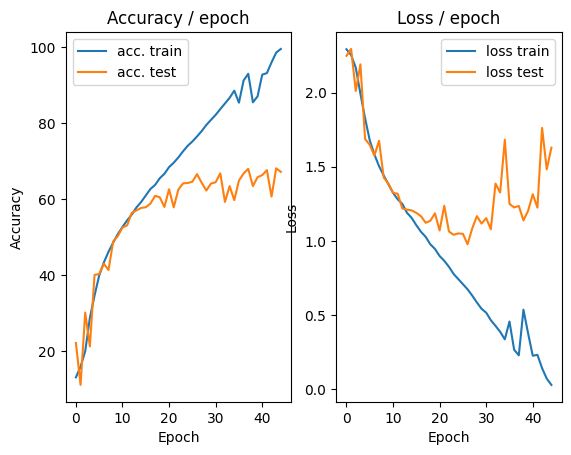

=== EPOCH 46 =====

[TRAIN Batch 000/098]	Time 0.364s (0.364s)	Loss 0.0347 (0.0347)	Prec@1  99.4 ( 99.4)	Prec@5 100.0 (100.0)


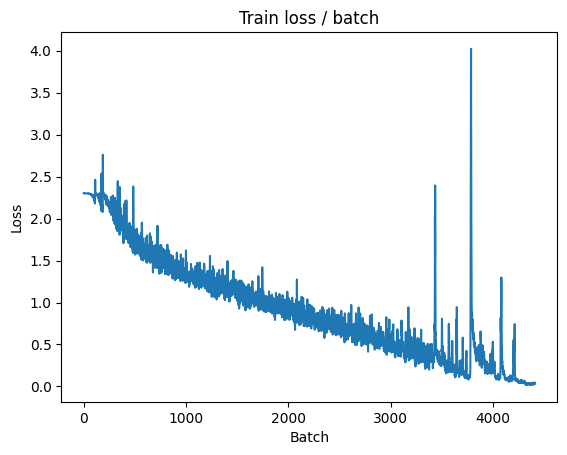


===============> Total time 7s	Avg loss 0.0194	Avg Prec@1 99.85 %	Avg Prec@5 100.00 %

[EVAL Batch 000/020]	Time 0.285s (0.285s)	Loss 1.6204 (1.6204)	Prec@1  68.9 ( 68.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.6919	Avg Prec@1 68.02 %	Avg Prec@5 96.73 %



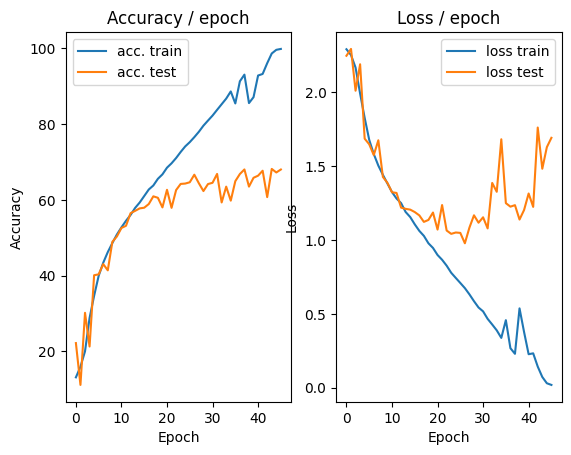

=== EPOCH 47 =====

[TRAIN Batch 000/098]	Time 0.497s (0.497s)	Loss 0.0128 (0.0128)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


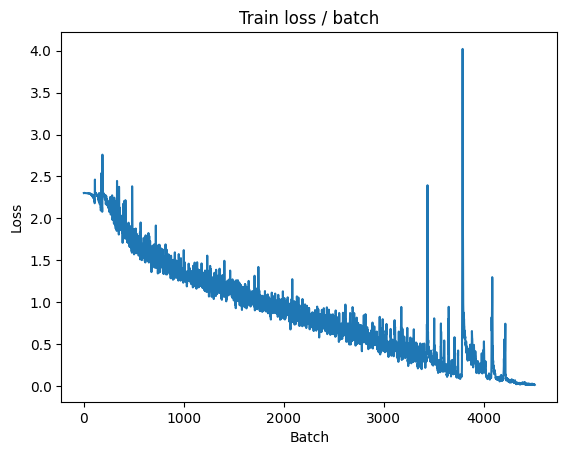


===============> Total time 9s	Avg loss 0.0134	Avg Prec@1 99.91 %	Avg Prec@5 100.00 %

[EVAL Batch 000/020]	Time 0.277s (0.277s)	Loss 1.6982 (1.6982)	Prec@1  67.6 ( 67.6)	Prec@5  97.9 ( 97.9)

===============> Total time 1s	Avg loss 1.7801	Avg Prec@1 68.13 %	Avg Prec@5 96.73 %



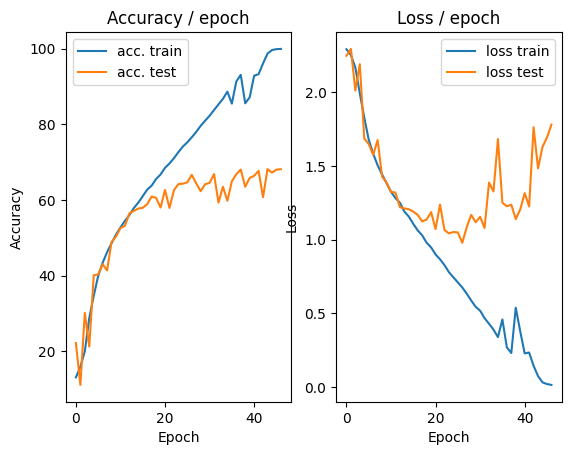

=== EPOCH 48 =====

[TRAIN Batch 000/098]	Time 0.343s (0.343s)	Loss 0.0099 (0.0099)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


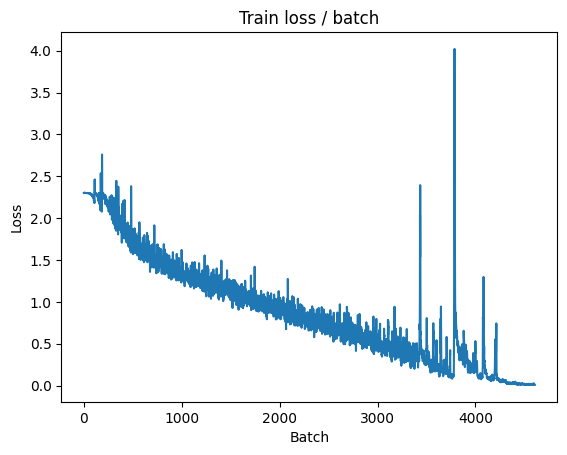


===============> Total time 8s	Avg loss 0.0094	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/020]	Time 0.285s (0.285s)	Loss 1.7677 (1.7677)	Prec@1  68.6 ( 68.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.8276	Avg Prec@1 67.81 %	Avg Prec@5 96.76 %



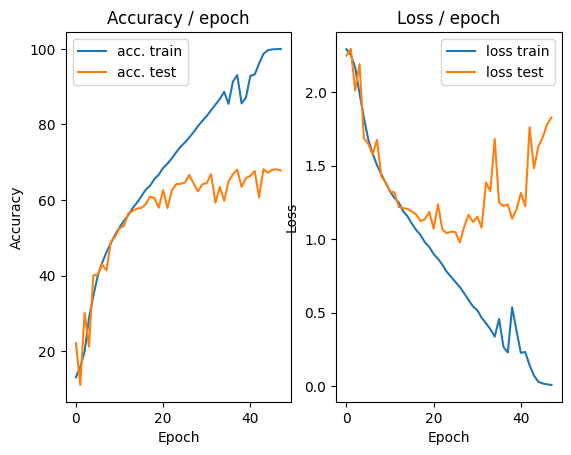

=== EPOCH 49 =====

[TRAIN Batch 000/098]	Time 0.308s (0.308s)	Loss 0.0076 (0.0076)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


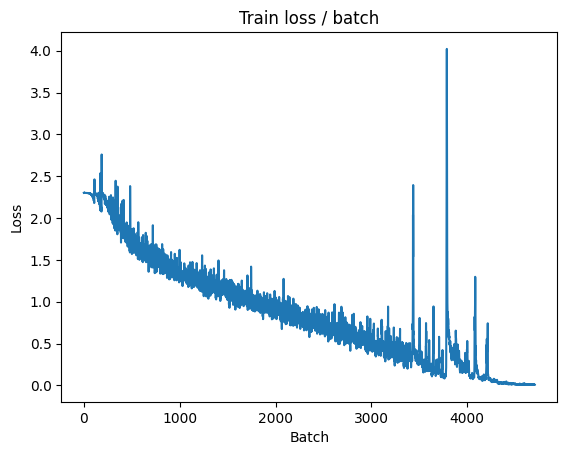


===============> Total time 9s	Avg loss 0.0075	Avg Prec@1 99.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/020]	Time 0.290s (0.290s)	Loss 1.8401 (1.8401)	Prec@1  68.2 ( 68.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.9034	Avg Prec@1 67.72 %	Avg Prec@5 96.66 %



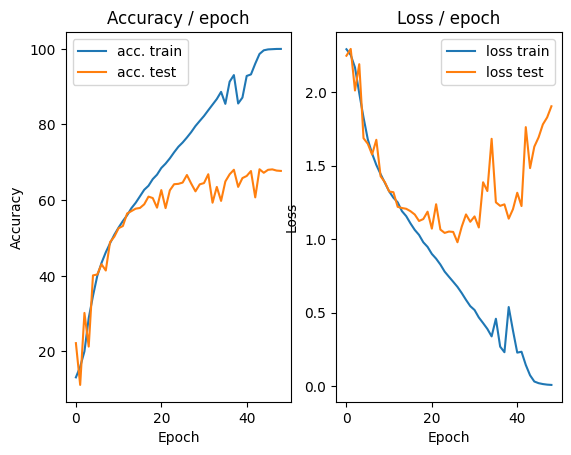

=== EPOCH 50 =====

[TRAIN Batch 000/098]	Time 0.308s (0.308s)	Loss 0.0069 (0.0069)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


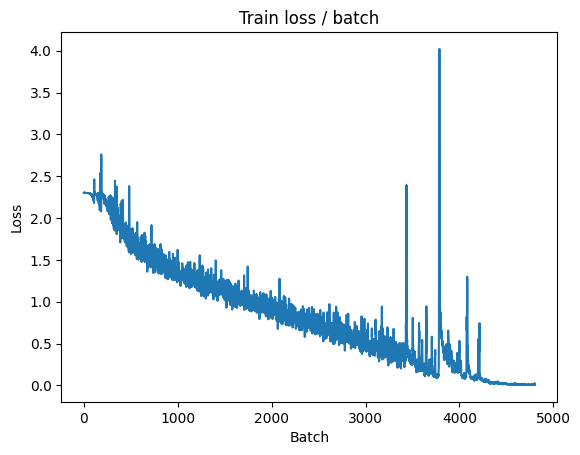


===============> Total time 8s	Avg loss 0.0062	Avg Prec@1 99.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/020]	Time 0.286s (0.286s)	Loss 1.8381 (1.8381)	Prec@1  68.6 ( 68.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.9235	Avg Prec@1 68.01 %	Avg Prec@5 96.86 %



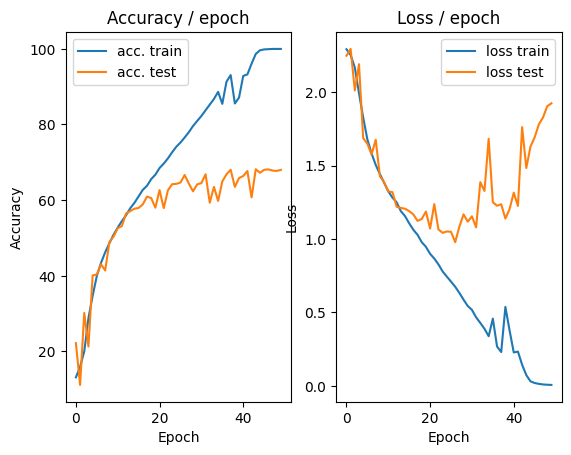

In [ ]:
main(512, 0.1, 50, cuda=True)#50 epoch, lr 0.1, batch size 512

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/098]	Time 0.277s (0.277s)	Loss 2.3026 (2.3026)	Prec@1   9.2 (  9.2)	Prec@5  51.0 ( 51.0)


<Figure size 640x480 with 0 Axes>

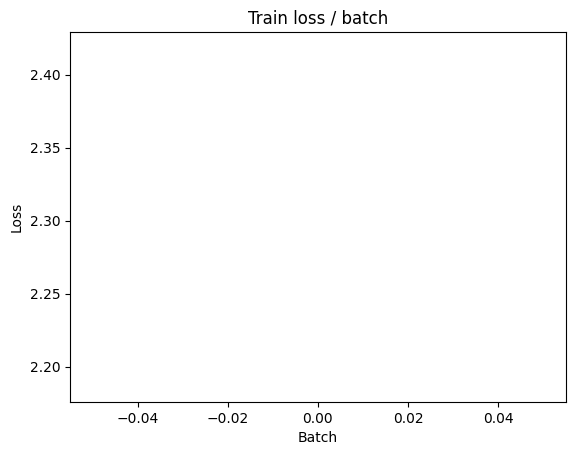


===============> Total time 8s	Avg loss 2.3022	Avg Prec@1 10.26 %	Avg Prec@5 50.02 %

[EVAL Batch 000/020]	Time 0.242s (0.242s)	Loss 2.3020 (2.3020)	Prec@1  10.5 ( 10.5)	Prec@5  50.0 ( 50.0)

===============> Total time 1s	Avg loss 2.3016	Avg Prec@1 10.47 %	Avg Prec@5 50.21 %



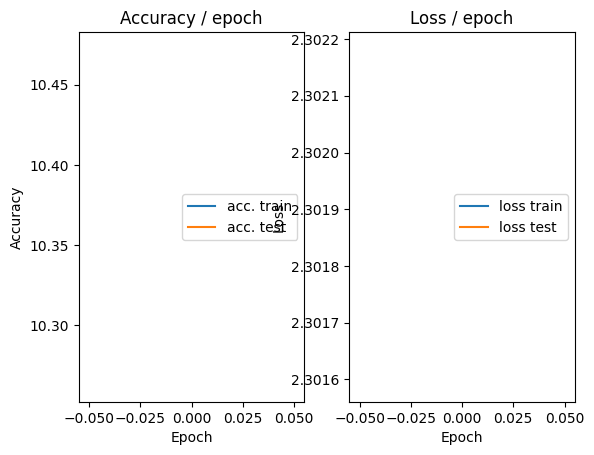

=== EPOCH 2 =====

[TRAIN Batch 000/098]	Time 0.257s (0.257s)	Loss 2.3006 (2.3006)	Prec@1   8.4 (  8.4)	Prec@5  52.3 ( 52.3)


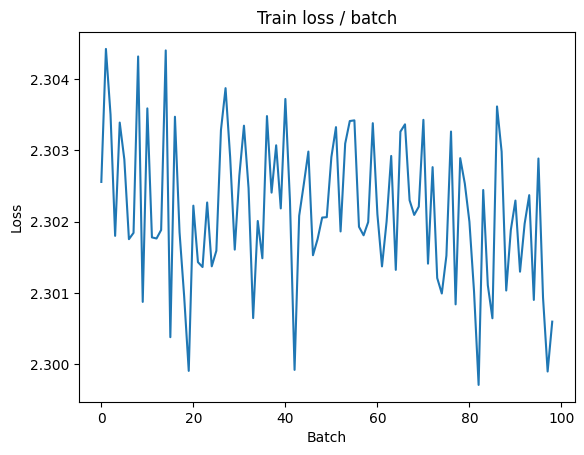


===============> Total time 8s	Avg loss 2.3012	Avg Prec@1 12.31 %	Avg Prec@5 50.04 %

[EVAL Batch 000/020]	Time 0.367s (0.367s)	Loss 2.3008 (2.3008)	Prec@1  16.4 ( 16.4)	Prec@5  50.2 ( 50.2)

===============> Total time 1s	Avg loss 2.3006	Avg Prec@1 16.11 %	Avg Prec@5 50.26 %



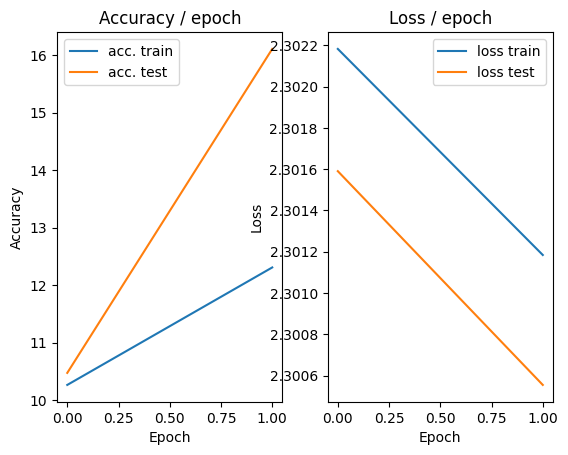

=== EPOCH 3 =====

[TRAIN Batch 000/098]	Time 0.278s (0.278s)	Loss 2.3017 (2.3017)	Prec@1  15.0 ( 15.0)	Prec@5  47.7 ( 47.7)


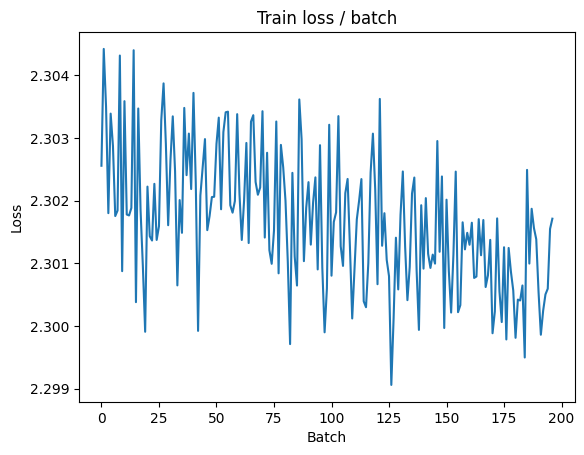


===============> Total time 7s	Avg loss 2.3000	Avg Prec@1 16.66 %	Avg Prec@5 50.52 %

[EVAL Batch 000/020]	Time 0.251s (0.251s)	Loss 2.2993 (2.2993)	Prec@1  16.0 ( 16.0)	Prec@5  51.6 ( 51.6)

===============> Total time 1s	Avg loss 2.2992	Avg Prec@1 16.77 %	Avg Prec@5 51.55 %



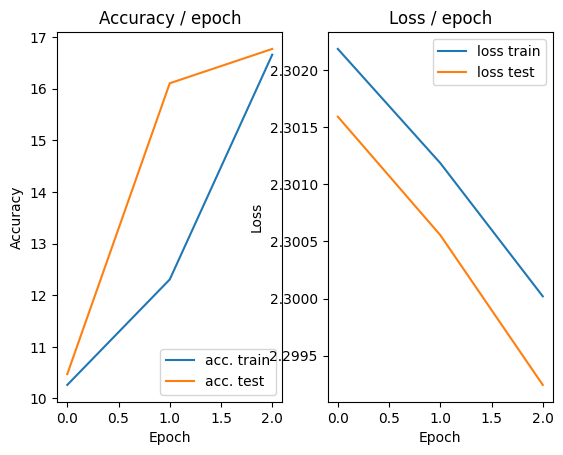

=== EPOCH 4 =====

[TRAIN Batch 000/098]	Time 0.462s (0.462s)	Loss 2.2985 (2.2985)	Prec@1  15.4 ( 15.4)	Prec@5  53.9 ( 53.9)


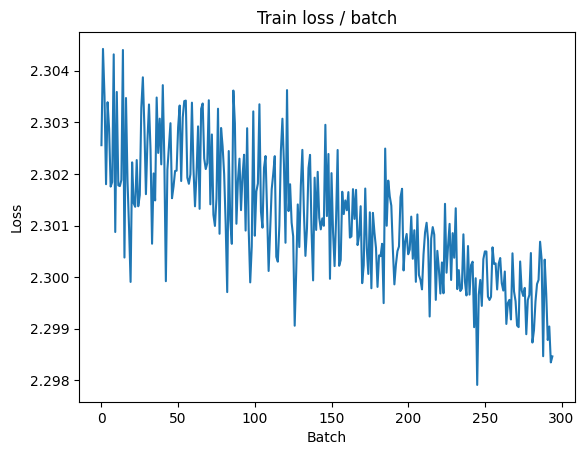


===============> Total time 7s	Avg loss 2.2985	Avg Prec@1 16.45 %	Avg Prec@5 55.07 %

[EVAL Batch 000/020]	Time 0.259s (0.259s)	Loss 2.2973 (2.2973)	Prec@1  16.6 ( 16.6)	Prec@5  58.8 ( 58.8)

===============> Total time 1s	Avg loss 2.2974	Avg Prec@1 18.53 %	Avg Prec@5 57.51 %



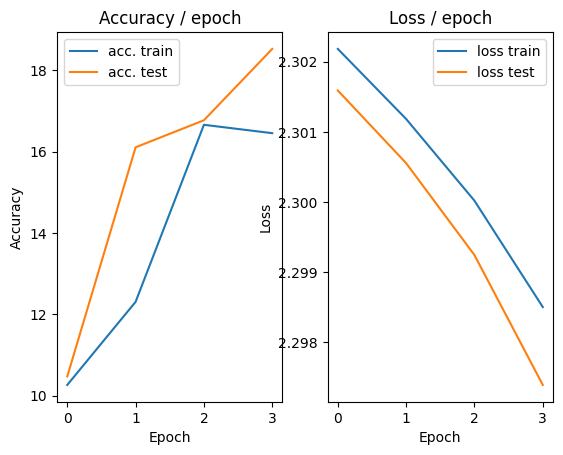

=== EPOCH 5 =====

[TRAIN Batch 000/098]	Time 0.266s (0.266s)	Loss 2.2972 (2.2972)	Prec@1  19.3 ( 19.3)	Prec@5  59.2 ( 59.2)


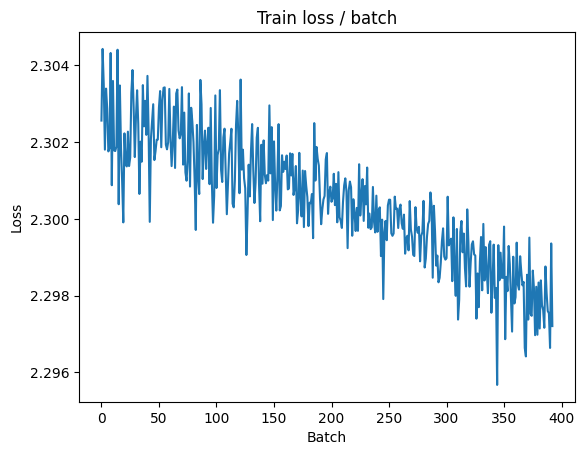


===============> Total time 9s	Avg loss 2.2962	Avg Prec@1 17.07 %	Avg Prec@5 58.11 %

[EVAL Batch 000/020]	Time 0.269s (0.269s)	Loss 2.2938 (2.2938)	Prec@1  16.4 ( 16.4)	Prec@5  56.8 ( 56.8)

===============> Total time 1s	Avg loss 2.2943	Avg Prec@1 17.84 %	Avg Prec@5 58.07 %



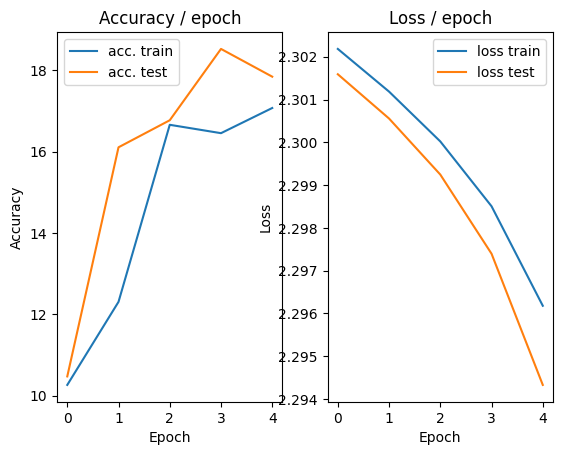

=== EPOCH 6 =====

[TRAIN Batch 000/098]	Time 0.276s (0.276s)	Loss 2.2947 (2.2947)	Prec@1  18.0 ( 18.0)	Prec@5  60.2 ( 60.2)


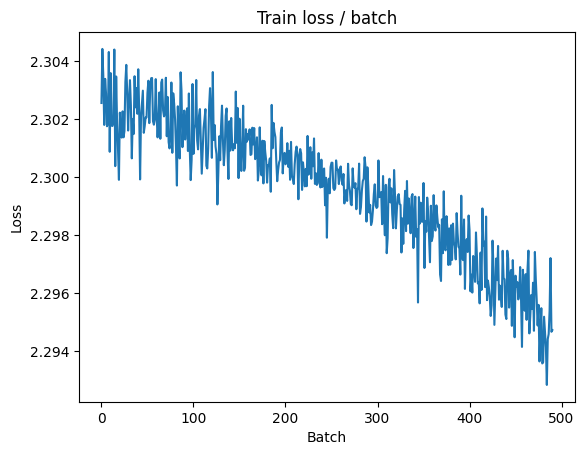


===============> Total time 8s	Avg loss 2.2919	Avg Prec@1 16.21 %	Avg Prec@5 59.40 %

[EVAL Batch 000/020]	Time 0.257s (0.257s)	Loss 2.2870 (2.2870)	Prec@1  16.4 ( 16.4)	Prec@5  58.0 ( 58.0)

===============> Total time 1s	Avg loss 2.2882	Avg Prec@1 17.08 %	Avg Prec@5 58.98 %



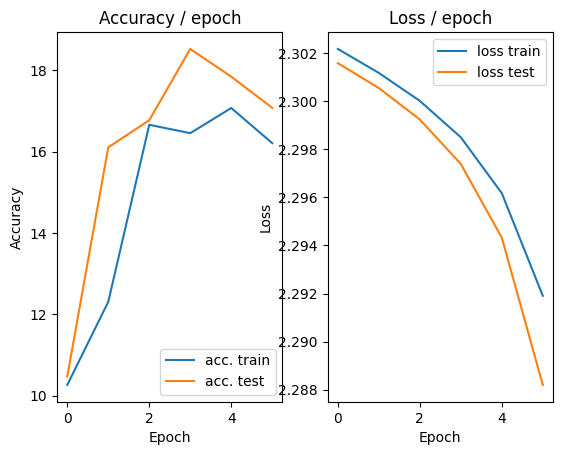

=== EPOCH 7 =====

[TRAIN Batch 000/098]	Time 0.298s (0.298s)	Loss 2.2889 (2.2889)	Prec@1  16.4 ( 16.4)	Prec@5  57.4 ( 57.4)


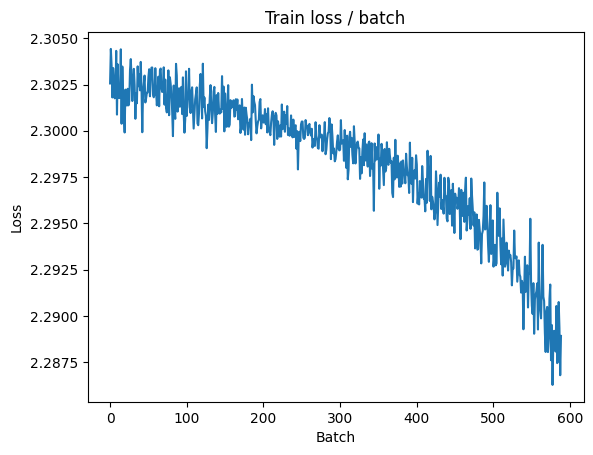


===============> Total time 8s	Avg loss 2.2824	Avg Prec@1 16.55 %	Avg Prec@5 61.42 %

[EVAL Batch 000/020]	Time 0.257s (0.257s)	Loss 2.2711 (2.2711)	Prec@1  14.6 ( 14.6)	Prec@5  66.0 ( 66.0)

===============> Total time 1s	Avg loss 2.2732	Avg Prec@1 16.85 %	Avg Prec@5 65.69 %



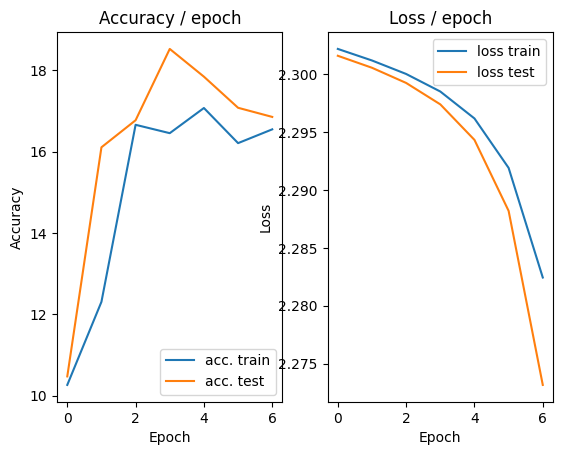

=== EPOCH 8 =====

[TRAIN Batch 000/098]	Time 0.291s (0.291s)	Loss 2.2708 (2.2708)	Prec@1  13.3 ( 13.3)	Prec@5  68.2 ( 68.2)


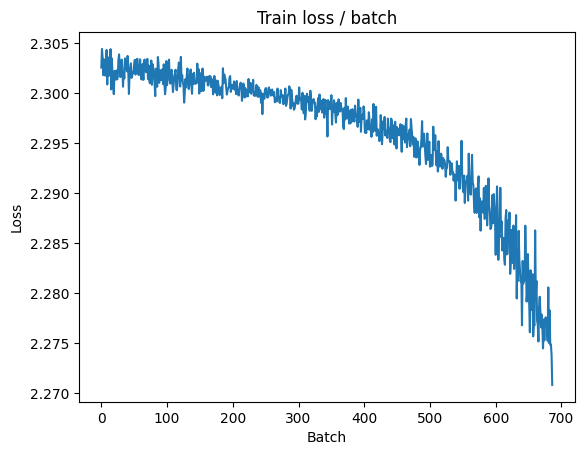


===============> Total time 8s	Avg loss 2.2544	Avg Prec@1 18.46 %	Avg Prec@5 68.06 %

[EVAL Batch 000/020]	Time 0.373s (0.373s)	Loss 2.2171 (2.2171)	Prec@1  20.3 ( 20.3)	Prec@5  73.2 ( 73.2)

===============> Total time 1s	Avg loss 2.2219	Avg Prec@1 20.15 %	Avg Prec@5 71.04 %



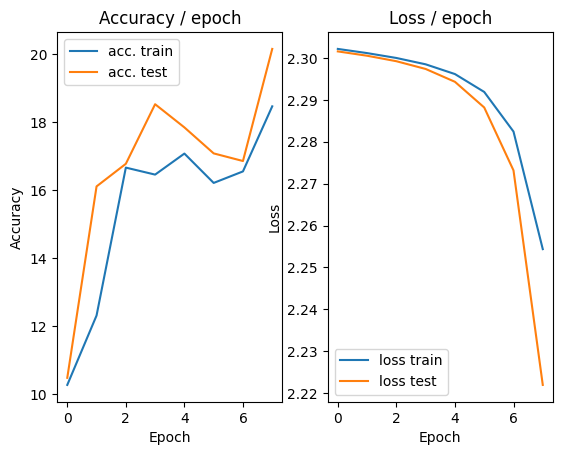

=== EPOCH 9 =====

[TRAIN Batch 000/098]	Time 0.286s (0.286s)	Loss 2.2349 (2.2349)	Prec@1  17.8 ( 17.8)	Prec@5  69.9 ( 69.9)


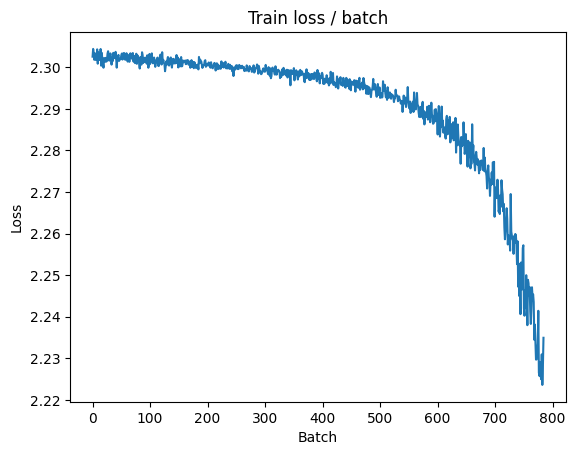


===============> Total time 7s	Avg loss 2.1569	Avg Prec@1 22.53 %	Avg Prec@5 74.55 %

[EVAL Batch 000/020]	Time 0.261s (0.261s)	Loss 2.0995 (2.0995)	Prec@1  26.6 ( 26.6)	Prec@5  76.2 ( 76.2)

===============> Total time 2s	Avg loss 2.0957	Avg Prec@1 24.55 %	Avg Prec@5 76.20 %



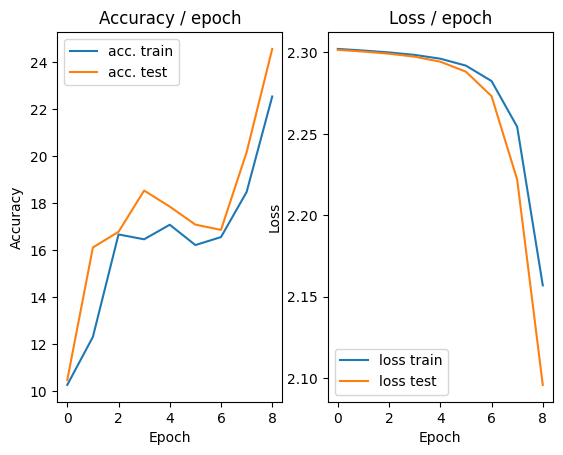

=== EPOCH 10 =====

[TRAIN Batch 000/098]	Time 0.478s (0.478s)	Loss 2.0928 (2.0928)	Prec@1  23.4 ( 23.4)	Prec@5  75.8 ( 75.8)


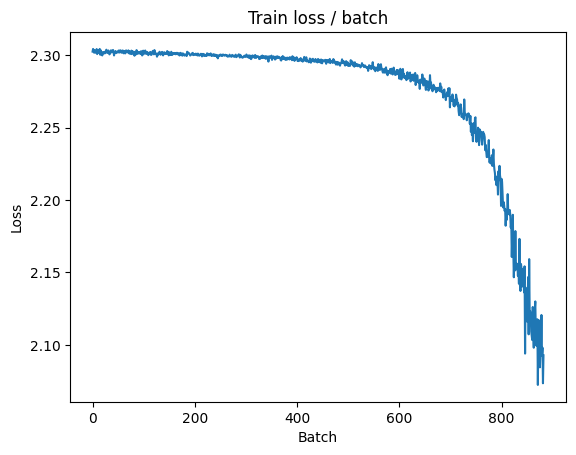


===============> Total time 7s	Avg loss 2.0823	Avg Prec@1 23.91 %	Avg Prec@5 75.31 %

[EVAL Batch 000/020]	Time 0.268s (0.268s)	Loss 2.0176 (2.0176)	Prec@1  27.9 ( 27.9)	Prec@5  80.3 ( 80.3)

===============> Total time 1s	Avg loss 2.0317	Avg Prec@1 26.57 %	Avg Prec@5 77.05 %



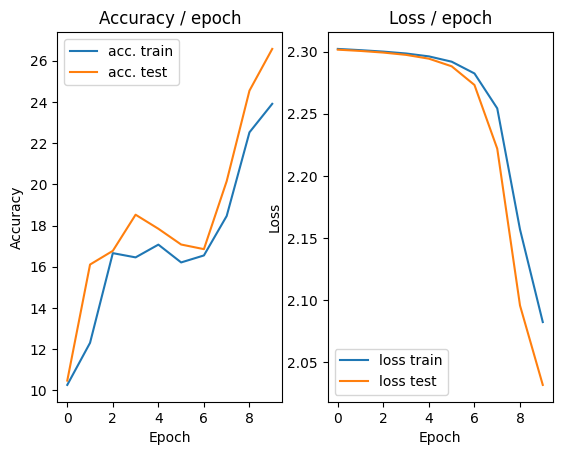

=== EPOCH 11 =====

[TRAIN Batch 000/098]	Time 0.287s (0.287s)	Loss 2.0551 (2.0551)	Prec@1  25.2 ( 25.2)	Prec@5  78.9 ( 78.9)


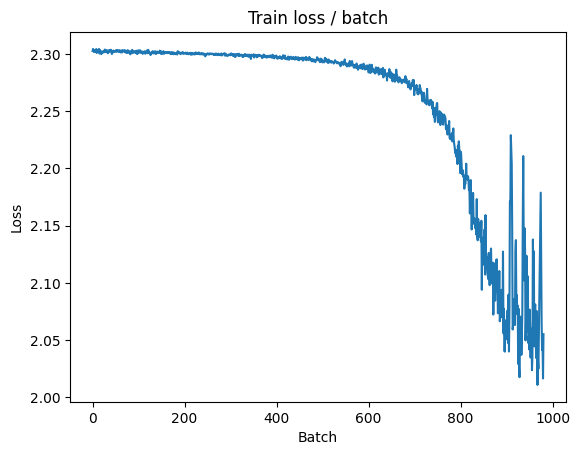


===============> Total time 8s	Avg loss 2.0395	Avg Prec@1 25.04 %	Avg Prec@5 77.12 %

[EVAL Batch 000/020]	Time 0.265s (0.265s)	Loss 2.0970 (2.0970)	Prec@1  25.2 ( 25.2)	Prec@5  73.2 ( 73.2)

===============> Total time 1s	Avg loss 2.0833	Avg Prec@1 23.74 %	Avg Prec@5 74.51 %



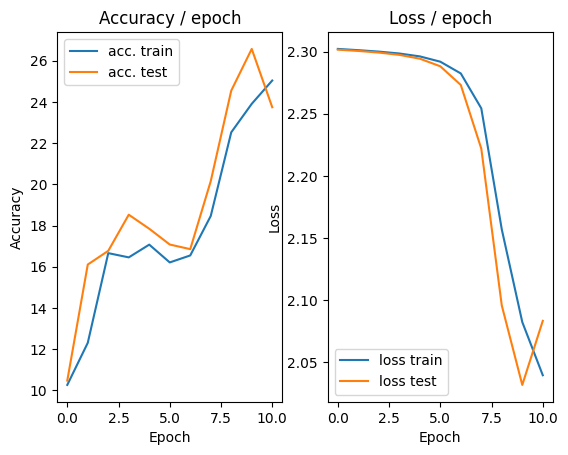

=== EPOCH 12 =====

[TRAIN Batch 000/098]	Time 0.275s (0.275s)	Loss 2.1027 (2.1027)	Prec@1  21.7 ( 21.7)	Prec@5  72.3 ( 72.3)


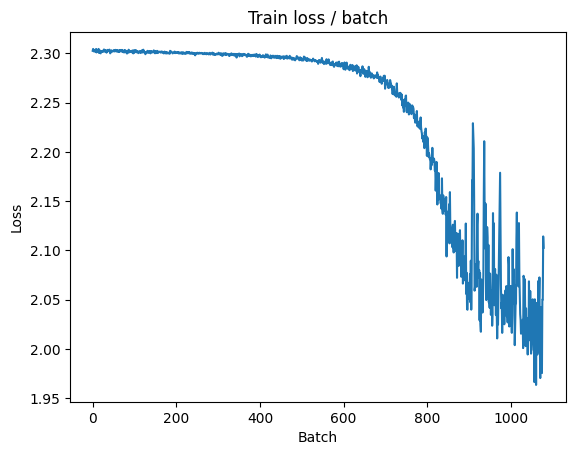


===============> Total time 8s	Avg loss 2.0091	Avg Prec@1 26.44 %	Avg Prec@5 78.25 %

[EVAL Batch 000/020]	Time 0.276s (0.276s)	Loss 1.9733 (1.9733)	Prec@1  29.1 ( 29.1)	Prec@5  80.5 ( 80.5)

===============> Total time 1s	Avg loss 1.9758	Avg Prec@1 28.45 %	Avg Prec@5 79.42 %



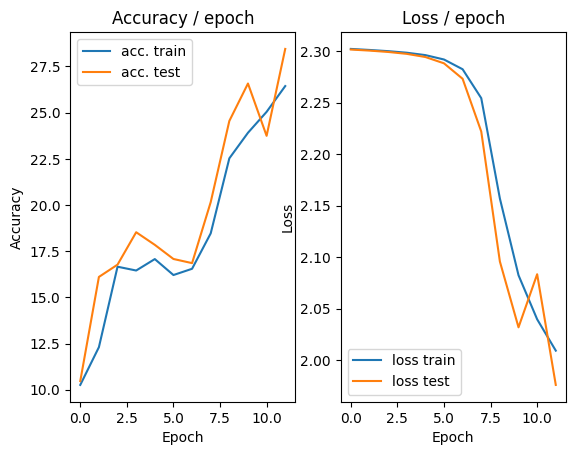

=== EPOCH 13 =====

[TRAIN Batch 000/098]	Time 0.271s (0.271s)	Loss 2.0443 (2.0443)	Prec@1  27.1 ( 27.1)	Prec@5  77.5 ( 77.5)


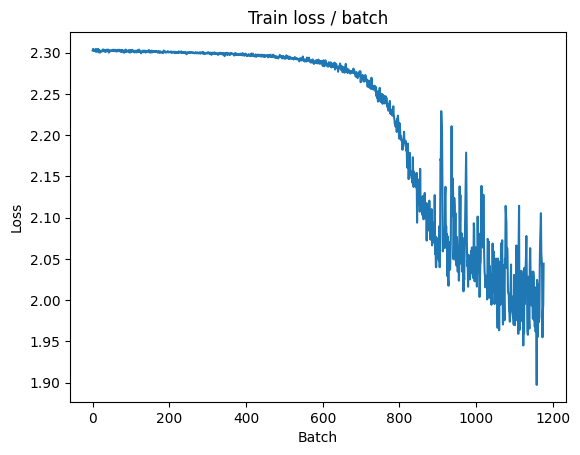


===============> Total time 8s	Avg loss 1.9792	Avg Prec@1 27.82 %	Avg Prec@5 79.28 %

[EVAL Batch 000/020]	Time 0.265s (0.265s)	Loss 1.9832 (1.9832)	Prec@1  28.1 ( 28.1)	Prec@5  80.9 ( 80.9)

===============> Total time 1s	Avg loss 1.9975	Avg Prec@1 27.51 %	Avg Prec@5 78.19 %



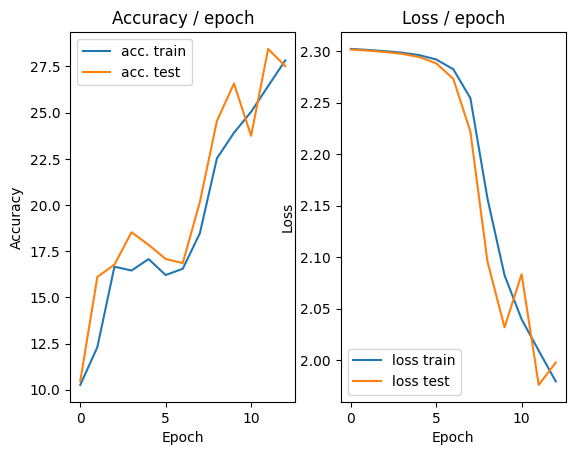

=== EPOCH 14 =====

[TRAIN Batch 000/098]	Time 0.268s (0.268s)	Loss 1.9635 (1.9635)	Prec@1  30.9 ( 30.9)	Prec@5  77.7 ( 77.7)


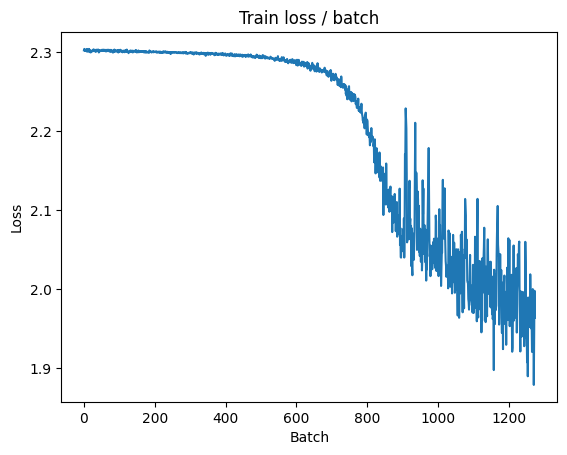


===============> Total time 9s	Avg loss 1.9678	Avg Prec@1 28.66 %	Avg Prec@5 79.59 %

[EVAL Batch 000/020]	Time 0.400s (0.400s)	Loss 1.9436 (1.9436)	Prec@1  30.3 ( 30.3)	Prec@5  82.4 ( 82.4)

===============> Total time 1s	Avg loss 1.9364	Avg Prec@1 30.08 %	Avg Prec@5 81.18 %



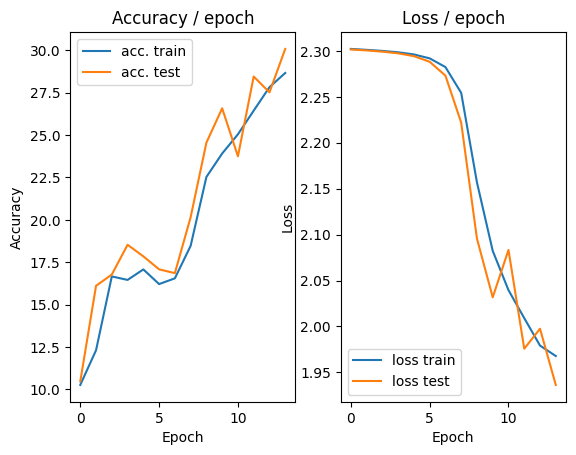

=== EPOCH 15 =====

[TRAIN Batch 000/098]	Time 0.287s (0.287s)	Loss 1.9731 (1.9731)	Prec@1  29.3 ( 29.3)	Prec@5  77.5 ( 77.5)


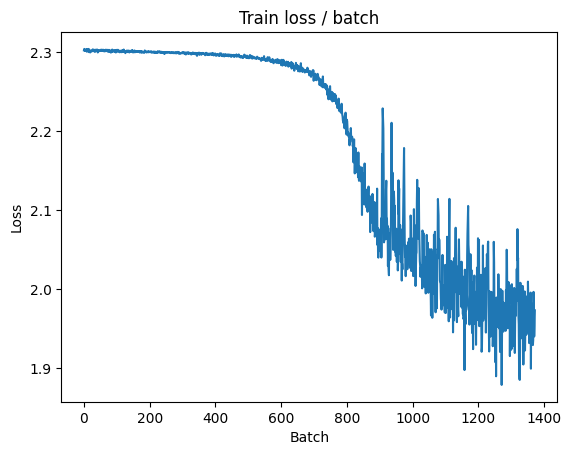


===============> Total time 7s	Avg loss 1.9479	Avg Prec@1 29.71 %	Avg Prec@5 80.20 %

[EVAL Batch 000/020]	Time 0.278s (0.278s)	Loss 1.9178 (1.9178)	Prec@1  31.1 ( 31.1)	Prec@5  82.8 ( 82.8)

===============> Total time 2s	Avg loss 1.9121	Avg Prec@1 31.60 %	Avg Prec@5 81.99 %



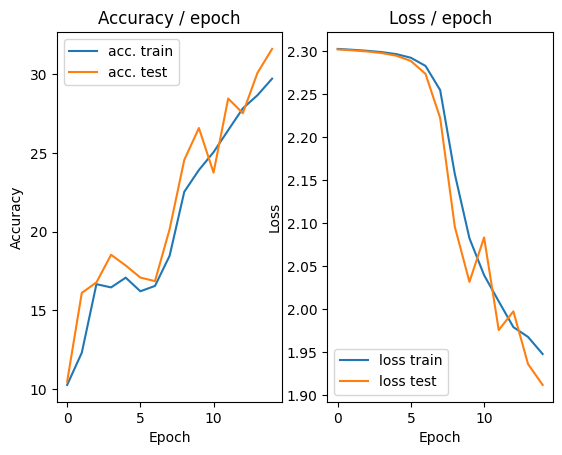

=== EPOCH 16 =====

[TRAIN Batch 000/098]	Time 0.406s (0.406s)	Loss 1.9098 (1.9098)	Prec@1  30.3 ( 30.3)	Prec@5  82.6 ( 82.6)


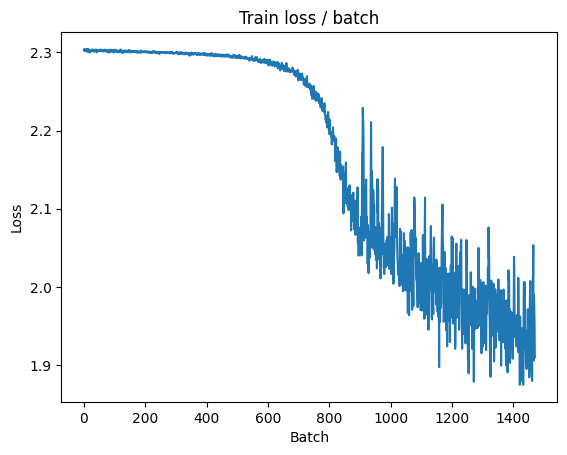


===============> Total time 8s	Avg loss 1.9270	Avg Prec@1 30.55 %	Avg Prec@5 81.20 %

[EVAL Batch 000/020]	Time 0.258s (0.258s)	Loss 1.9420 (1.9420)	Prec@1  28.1 ( 28.1)	Prec@5  81.4 ( 81.4)

===============> Total time 1s	Avg loss 1.9163	Avg Prec@1 31.50 %	Avg Prec@5 81.76 %



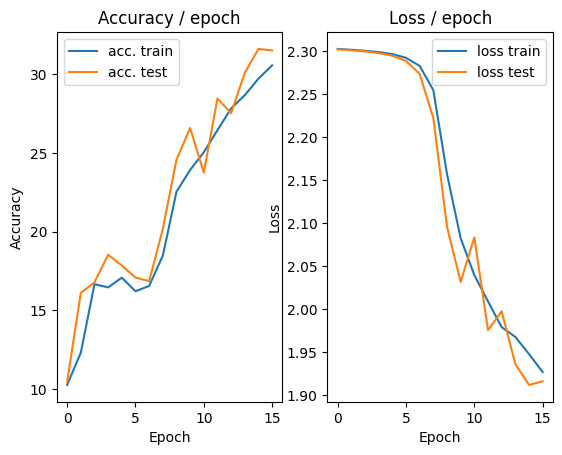

=== EPOCH 17 =====

[TRAIN Batch 000/098]	Time 0.285s (0.285s)	Loss 1.9304 (1.9304)	Prec@1  28.1 ( 28.1)	Prec@5  81.8 ( 81.8)


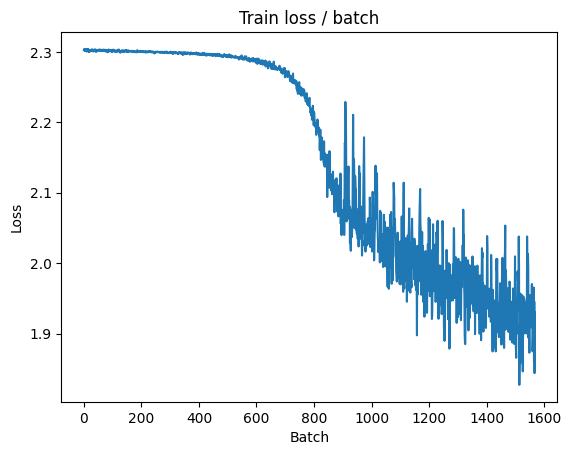


===============> Total time 8s	Avg loss 1.9111	Avg Prec@1 31.38 %	Avg Prec@5 81.81 %

[EVAL Batch 000/020]	Time 0.274s (0.274s)	Loss 1.9253 (1.9253)	Prec@1  29.9 ( 29.9)	Prec@5  83.2 ( 83.2)

===============> Total time 1s	Avg loss 1.9240	Avg Prec@1 30.52 %	Avg Prec@5 80.82 %



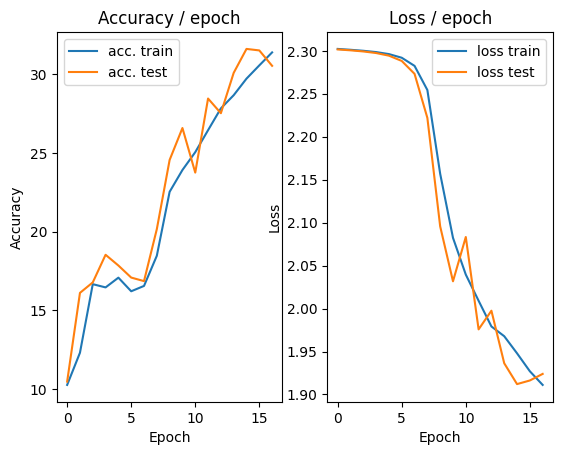

=== EPOCH 18 =====

[TRAIN Batch 000/098]	Time 0.301s (0.301s)	Loss 2.0259 (2.0259)	Prec@1  29.7 ( 29.7)	Prec@5  76.4 ( 76.4)


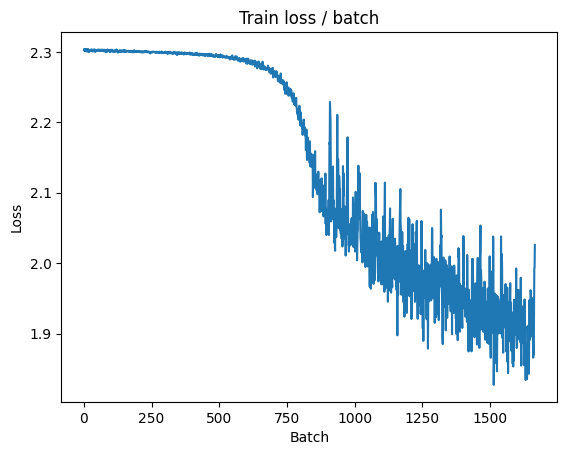


===============> Total time 8s	Avg loss 1.8926	Avg Prec@1 32.08 %	Avg Prec@5 82.58 %

[EVAL Batch 000/020]	Time 0.304s (0.304s)	Loss 2.0035 (2.0035)	Prec@1  27.9 ( 27.9)	Prec@5  78.1 ( 78.1)

===============> Total time 1s	Avg loss 1.9512	Avg Prec@1 30.10 %	Avg Prec@5 80.09 %



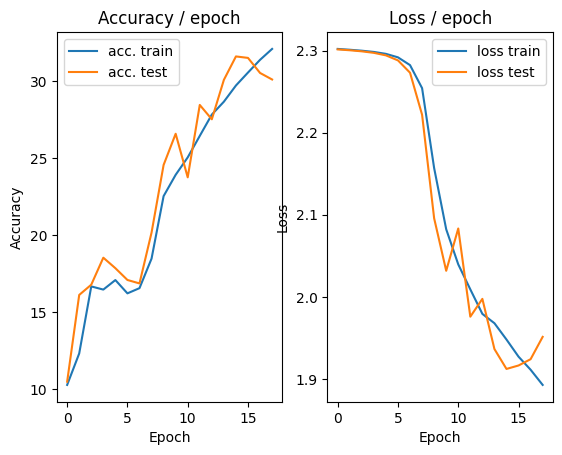

=== EPOCH 19 =====

[TRAIN Batch 000/098]	Time 0.290s (0.290s)	Loss 1.9178 (1.9178)	Prec@1  32.8 ( 32.8)	Prec@5  83.8 ( 83.8)


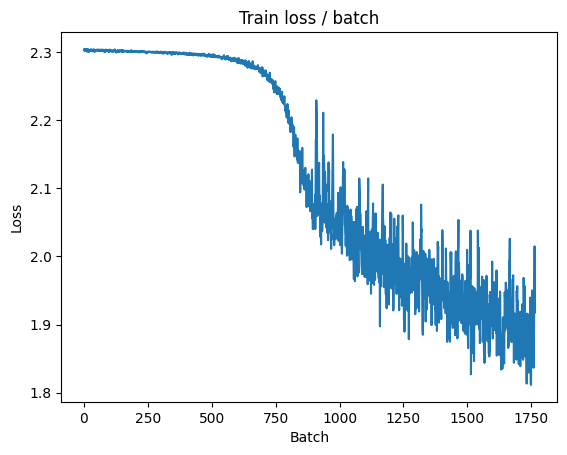


===============> Total time 8s	Avg loss 1.8761	Avg Prec@1 32.94 %	Avg Prec@5 82.94 %

[EVAL Batch 000/020]	Time 0.276s (0.276s)	Loss 1.9172 (1.9172)	Prec@1  30.7 ( 30.7)	Prec@5  81.6 ( 81.6)

===============> Total time 1s	Avg loss 1.8727	Avg Prec@1 32.47 %	Avg Prec@5 83.21 %



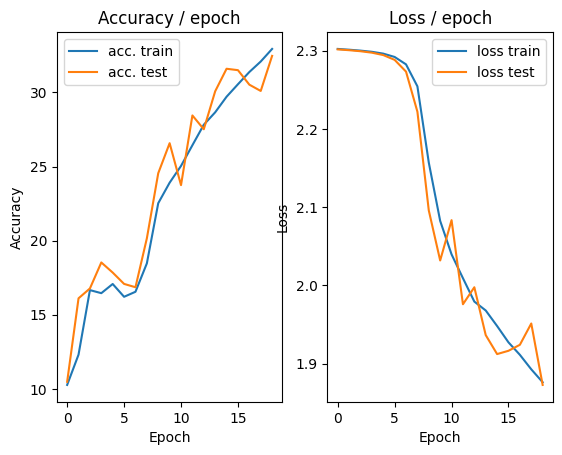

=== EPOCH 20 =====

[TRAIN Batch 000/098]	Time 0.289s (0.289s)	Loss 1.8037 (1.8037)	Prec@1  35.2 ( 35.2)	Prec@5  84.6 ( 84.6)


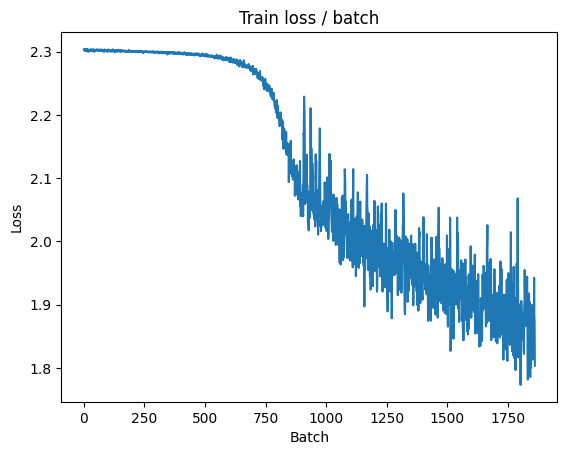


===============> Total time 7s	Avg loss 1.8549	Avg Prec@1 33.68 %	Avg Prec@5 83.52 %

[EVAL Batch 000/020]	Time 0.475s (0.475s)	Loss 1.8576 (1.8576)	Prec@1  31.1 ( 31.1)	Prec@5  85.9 ( 85.9)

===============> Total time 2s	Avg loss 1.8232	Avg Prec@1 35.03 %	Avg Prec@5 85.18 %



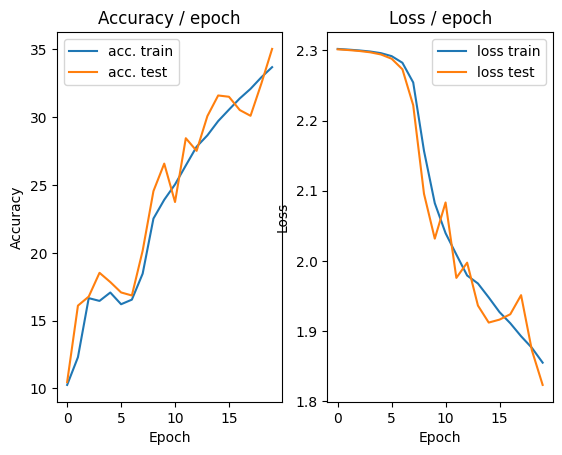

=== EPOCH 21 =====

[TRAIN Batch 000/098]	Time 0.299s (0.299s)	Loss 1.7913 (1.7913)	Prec@1  37.1 ( 37.1)	Prec@5  85.9 ( 85.9)


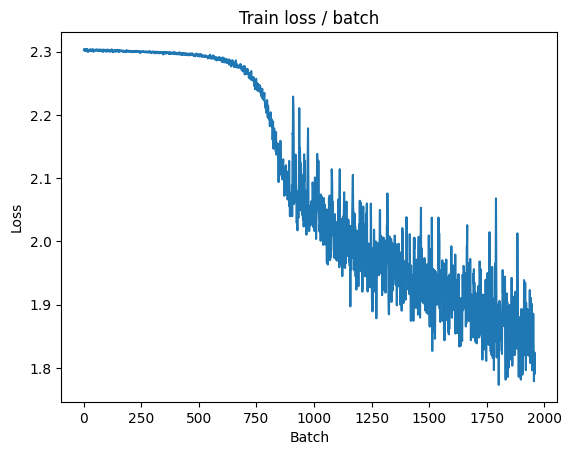


===============> Total time 7s	Avg loss 1.8345	Avg Prec@1 34.39 %	Avg Prec@5 84.18 %

[EVAL Batch 000/020]	Time 0.277s (0.277s)	Loss 1.8557 (1.8557)	Prec@1  30.9 ( 30.9)	Prec@5  84.6 ( 84.6)

===============> Total time 1s	Avg loss 1.8054	Avg Prec@1 35.56 %	Avg Prec@5 85.14 %



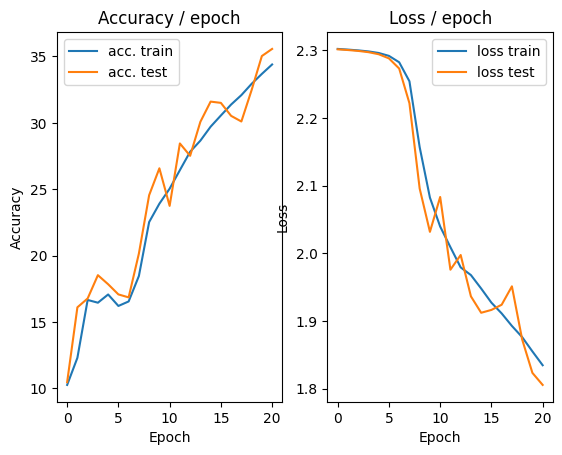

=== EPOCH 22 =====

[TRAIN Batch 000/098]	Time 0.424s (0.424s)	Loss 1.7769 (1.7769)	Prec@1  38.1 ( 38.1)	Prec@5  86.7 ( 86.7)


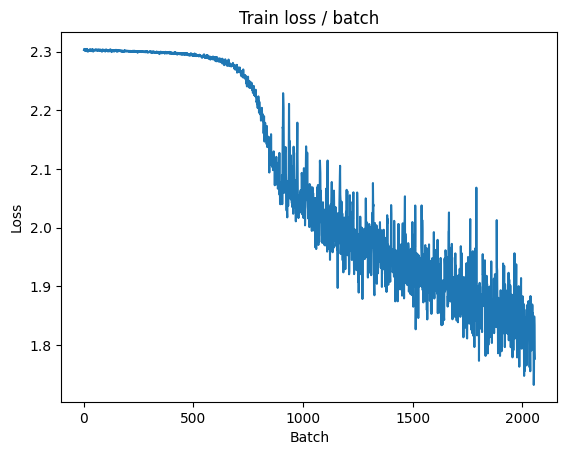


===============> Total time 8s	Avg loss 1.8156	Avg Prec@1 35.21 %	Avg Prec@5 84.72 %

[EVAL Batch 000/020]	Time 0.276s (0.276s)	Loss 1.9347 (1.9347)	Prec@1  30.5 ( 30.5)	Prec@5  82.0 ( 82.0)

===============> Total time 1s	Avg loss 1.8655	Avg Prec@1 33.74 %	Avg Prec@5 82.83 %



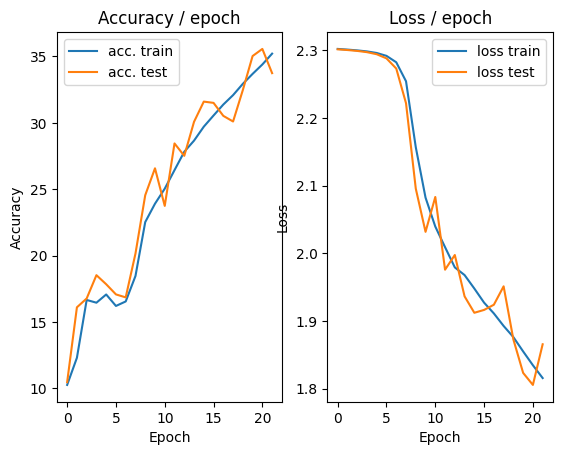

=== EPOCH 23 =====

[TRAIN Batch 000/098]	Time 0.292s (0.292s)	Loss 1.9470 (1.9470)	Prec@1  28.3 ( 28.3)	Prec@5  79.1 ( 79.1)


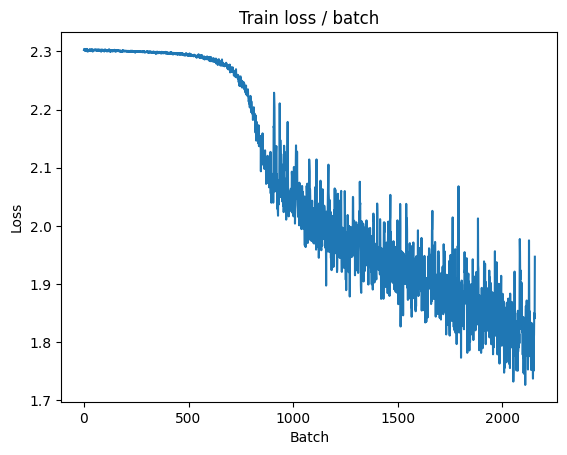


===============> Total time 8s	Avg loss 1.7905	Avg Prec@1 36.06 %	Avg Prec@5 85.20 %

[EVAL Batch 000/020]	Time 0.266s (0.266s)	Loss 1.8447 (1.8447)	Prec@1  32.2 ( 32.2)	Prec@5  83.8 ( 83.8)

===============> Total time 1s	Avg loss 1.8061	Avg Prec@1 36.27 %	Avg Prec@5 84.46 %



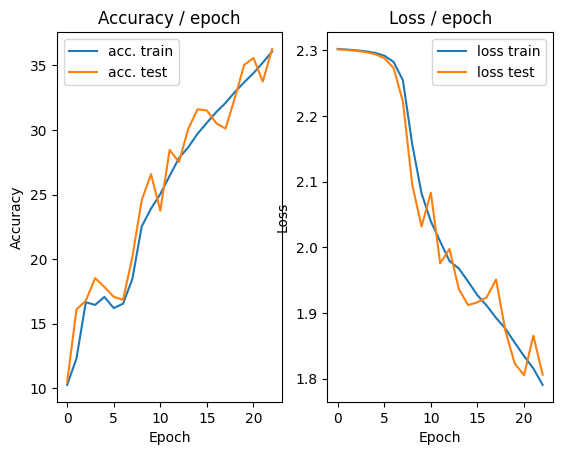

=== EPOCH 24 =====

[TRAIN Batch 000/098]	Time 0.288s (0.288s)	Loss 1.8660 (1.8660)	Prec@1  29.9 ( 29.9)	Prec@5  83.0 ( 83.0)


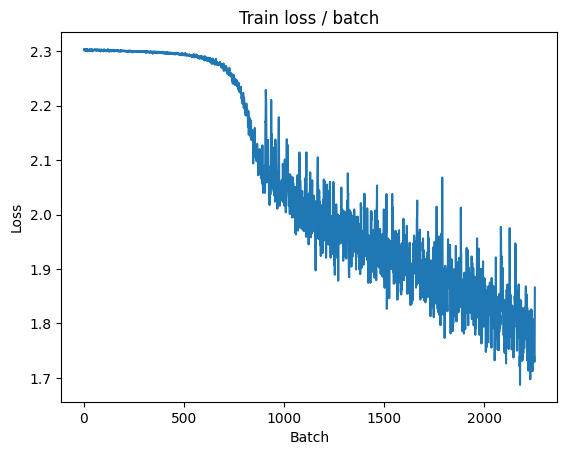


===============> Total time 8s	Avg loss 1.7682	Avg Prec@1 36.92 %	Avg Prec@5 85.79 %

[EVAL Batch 000/020]	Time 0.276s (0.276s)	Loss 1.7830 (1.7830)	Prec@1  34.8 ( 34.8)	Prec@5  85.7 ( 85.7)

===============> Total time 1s	Avg loss 1.7237	Avg Prec@1 38.89 %	Avg Prec@5 86.78 %



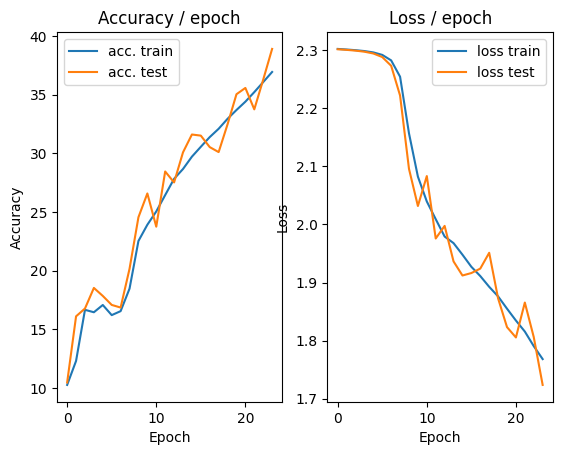

=== EPOCH 25 =====

[TRAIN Batch 000/098]	Time 0.304s (0.304s)	Loss 1.6910 (1.6910)	Prec@1  39.1 ( 39.1)	Prec@5  87.5 ( 87.5)


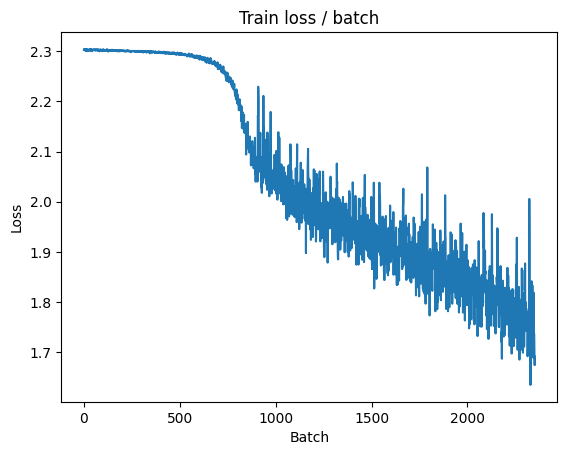


===============> Total time 8s	Avg loss 1.7475	Avg Prec@1 37.61 %	Avg Prec@5 86.26 %

[EVAL Batch 000/020]	Time 0.309s (0.309s)	Loss 1.7743 (1.7743)	Prec@1  35.0 ( 35.0)	Prec@5  86.5 ( 86.5)

===============> Total time 1s	Avg loss 1.7232	Avg Prec@1 39.10 %	Avg Prec@5 87.34 %



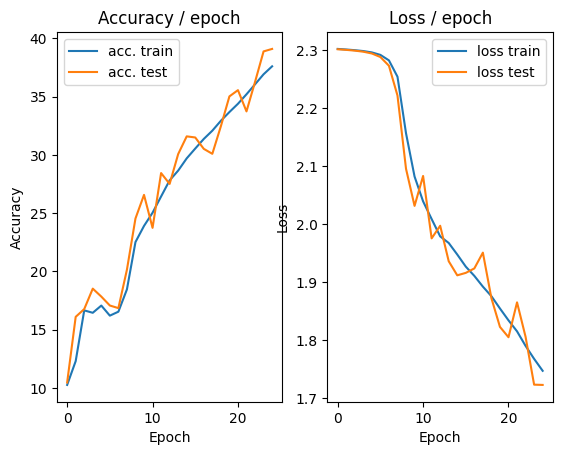

=== EPOCH 26 =====

[TRAIN Batch 000/098]	Time 0.301s (0.301s)	Loss 1.6750 (1.6750)	Prec@1  41.0 ( 41.0)	Prec@5  86.7 ( 86.7)


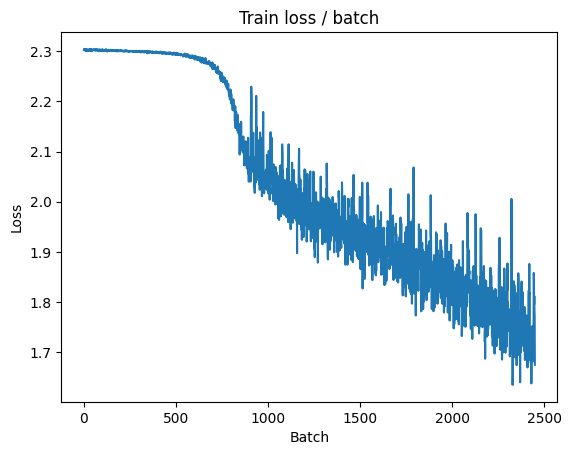


===============> Total time 7s	Avg loss 1.7234	Avg Prec@1 38.28 %	Avg Prec@5 86.88 %

[EVAL Batch 000/020]	Time 0.459s (0.459s)	Loss 1.7271 (1.7271)	Prec@1  36.1 ( 36.1)	Prec@5  87.3 ( 87.3)

===============> Total time 2s	Avg loss 1.6735	Avg Prec@1 40.50 %	Avg Prec@5 88.37 %



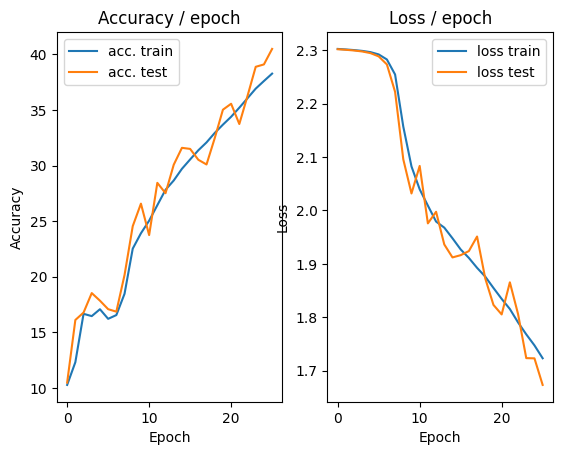

=== EPOCH 27 =====

[TRAIN Batch 000/098]	Time 0.311s (0.311s)	Loss 1.7209 (1.7209)	Prec@1  40.2 ( 40.2)	Prec@5  86.9 ( 86.9)


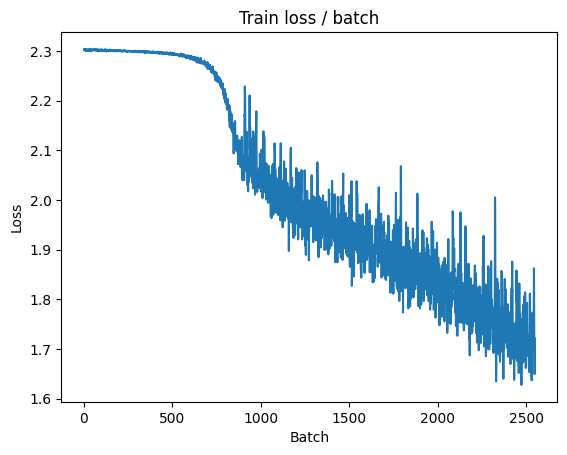


===============> Total time 7s	Avg loss 1.6983	Avg Prec@1 39.24 %	Avg Prec@5 87.53 %

[EVAL Batch 000/020]	Time 0.265s (0.265s)	Loss 1.7571 (1.7571)	Prec@1  36.3 ( 36.3)	Prec@5  87.3 ( 87.3)

===============> Total time 1s	Avg loss 1.6998	Avg Prec@1 38.72 %	Avg Prec@5 87.36 %



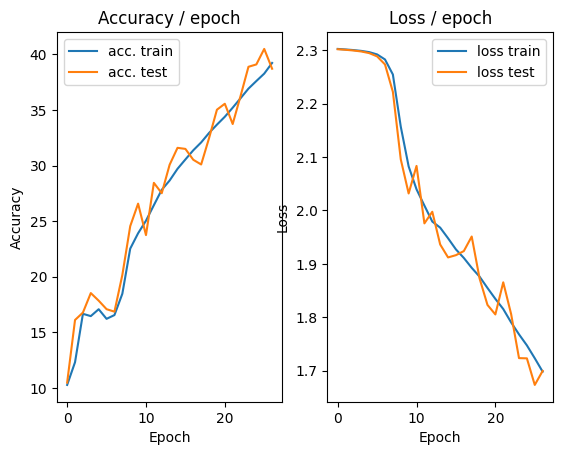

=== EPOCH 28 =====

[TRAIN Batch 000/098]	Time 0.443s (0.443s)	Loss 1.7186 (1.7186)	Prec@1  36.7 ( 36.7)	Prec@5  87.7 ( 87.7)


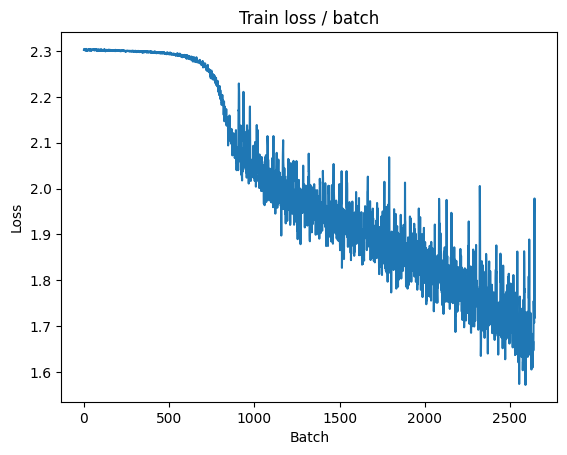


===============> Total time 8s	Avg loss 1.6830	Avg Prec@1 39.84 %	Avg Prec@5 87.88 %

[EVAL Batch 000/020]	Time 0.260s (0.260s)	Loss 1.7349 (1.7349)	Prec@1  36.7 ( 36.7)	Prec@5  87.3 ( 87.3)

===============> Total time 1s	Avg loss 1.6666	Avg Prec@1 39.91 %	Avg Prec@5 87.99 %



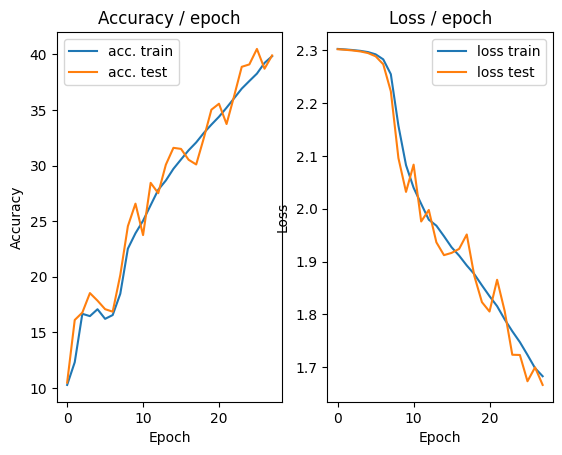

=== EPOCH 29 =====

[TRAIN Batch 000/098]	Time 0.343s (0.343s)	Loss 1.7033 (1.7033)	Prec@1  35.4 ( 35.4)	Prec@5  88.5 ( 88.5)


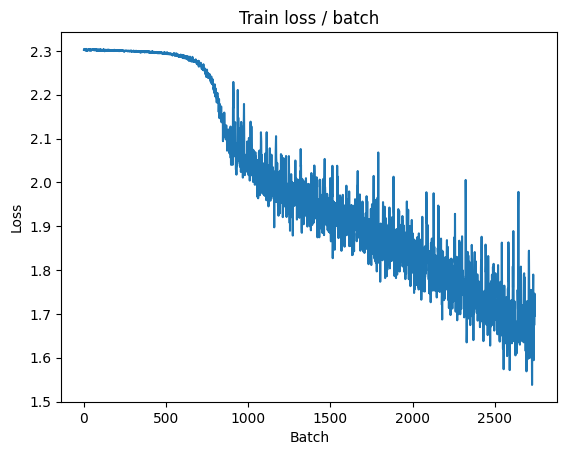


===============> Total time 8s	Avg loss 1.6553	Avg Prec@1 40.60 %	Avg Prec@5 88.49 %

[EVAL Batch 000/020]	Time 0.256s (0.256s)	Loss 1.6770 (1.6770)	Prec@1  37.3 ( 37.3)	Prec@5  88.1 ( 88.1)

===============> Total time 1s	Avg loss 1.6218	Avg Prec@1 42.37 %	Avg Prec@5 89.51 %



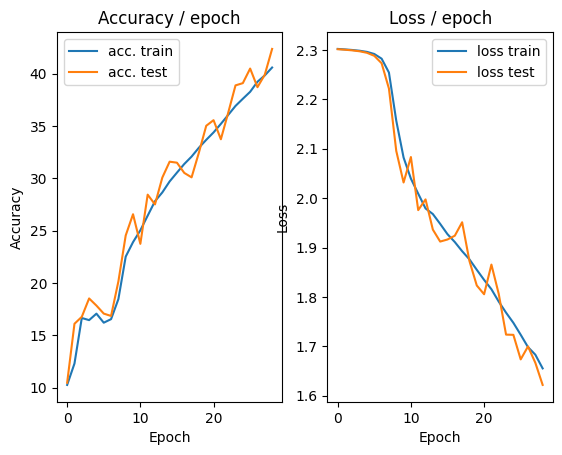

=== EPOCH 30 =====

[TRAIN Batch 000/098]	Time 0.324s (0.324s)	Loss 1.6130 (1.6130)	Prec@1  45.1 ( 45.1)	Prec@5  90.8 ( 90.8)


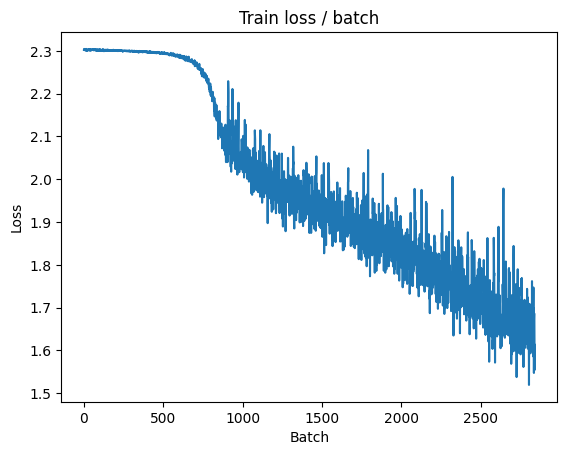


===============> Total time 8s	Avg loss 1.6405	Avg Prec@1 41.15 %	Avg Prec@5 88.65 %

[EVAL Batch 000/020]	Time 0.276s (0.276s)	Loss 1.6689 (1.6689)	Prec@1  36.1 ( 36.1)	Prec@5  87.9 ( 87.9)

===============> Total time 1s	Avg loss 1.6151	Avg Prec@1 42.02 %	Avg Prec@5 89.31 %



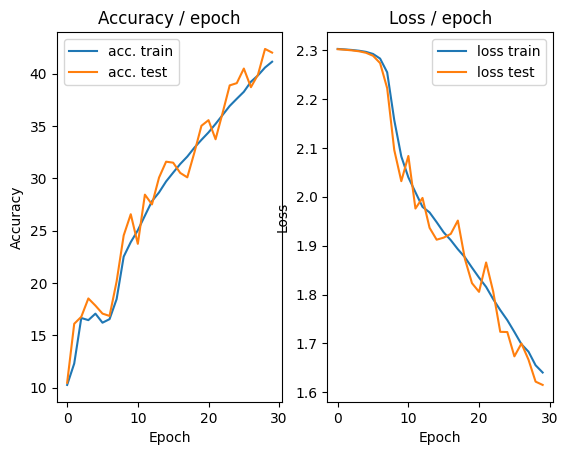

=== EPOCH 31 =====

[TRAIN Batch 000/098]	Time 0.297s (0.297s)	Loss 1.6157 (1.6157)	Prec@1  40.4 ( 40.4)	Prec@5  90.0 ( 90.0)


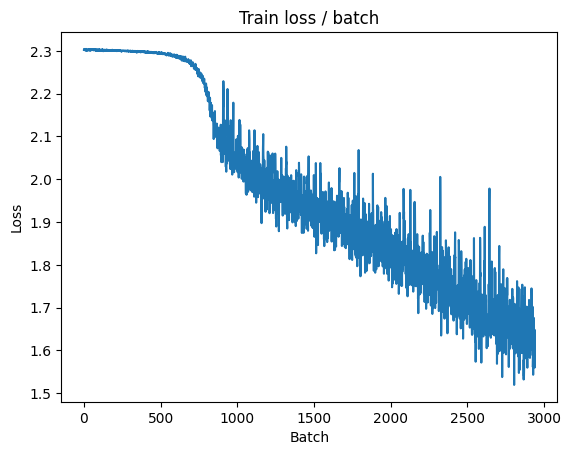


===============> Total time 9s	Avg loss 1.6202	Avg Prec@1 41.84 %	Avg Prec@5 89.25 %

[EVAL Batch 000/020]	Time 0.270s (0.270s)	Loss 1.6666 (1.6666)	Prec@1  36.9 ( 36.9)	Prec@5  86.9 ( 86.9)

===============> Total time 1s	Avg loss 1.6114	Avg Prec@1 42.48 %	Avg Prec@5 89.31 %



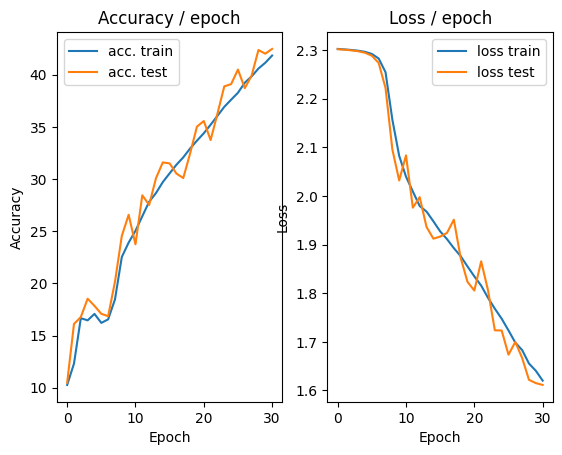

=== EPOCH 32 =====

[TRAIN Batch 000/098]	Time 0.319s (0.319s)	Loss 1.6624 (1.6624)	Prec@1  41.4 ( 41.4)	Prec@5  86.7 ( 86.7)


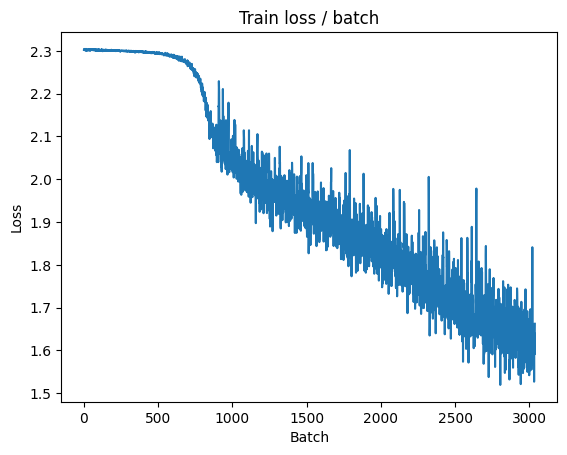


===============> Total time 9s	Avg loss 1.6082	Avg Prec@1 42.51 %	Avg Prec@5 89.31 %

[EVAL Batch 000/020]	Time 0.446s (0.446s)	Loss 1.6220 (1.6220)	Prec@1  38.3 ( 38.3)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.5789	Avg Prec@1 43.65 %	Avg Prec@5 90.01 %



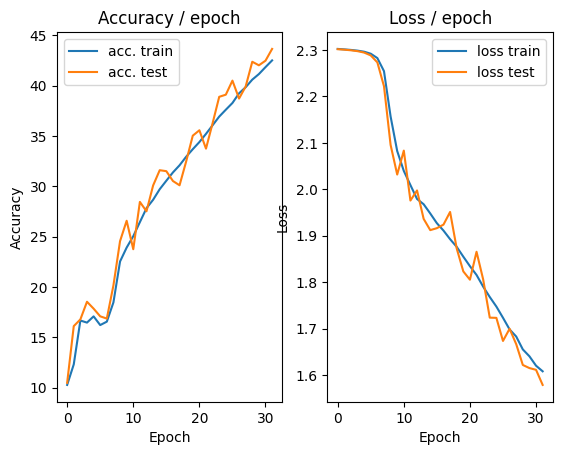

=== EPOCH 33 =====

[TRAIN Batch 000/098]	Time 0.328s (0.328s)	Loss 1.5424 (1.5424)	Prec@1  46.1 ( 46.1)	Prec@5  91.0 ( 91.0)


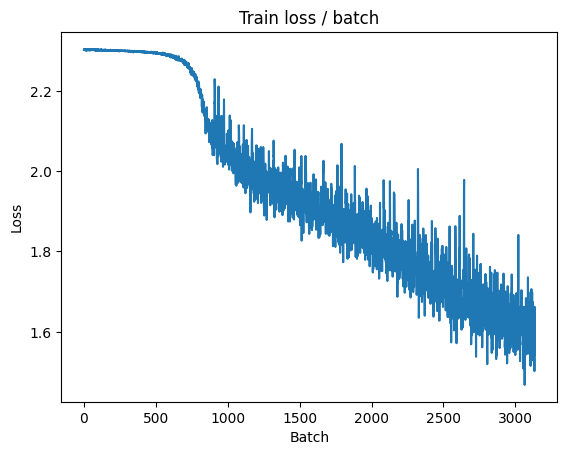


===============> Total time 7s	Avg loss 1.5933	Avg Prec@1 43.04 %	Avg Prec@5 89.76 %

[EVAL Batch 000/020]	Time 0.291s (0.291s)	Loss 1.6311 (1.6311)	Prec@1  38.9 ( 38.9)	Prec@5  89.1 ( 89.1)

===============> Total time 2s	Avg loss 1.5881	Avg Prec@1 43.36 %	Avg Prec@5 89.88 %



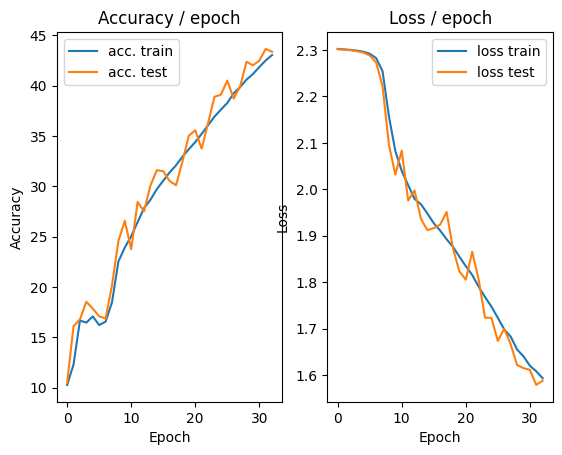

=== EPOCH 34 =====

[TRAIN Batch 000/098]	Time 0.401s (0.401s)	Loss 1.5933 (1.5933)	Prec@1  42.0 ( 42.0)	Prec@5  91.6 ( 91.6)


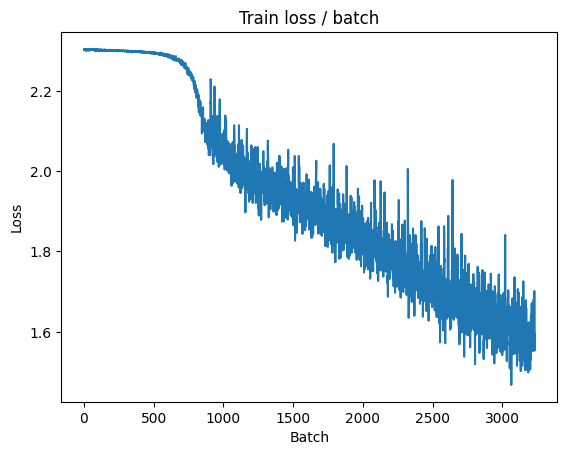


===============> Total time 7s	Avg loss 1.5714	Avg Prec@1 43.81 %	Avg Prec@5 90.15 %

[EVAL Batch 000/020]	Time 0.297s (0.297s)	Loss 1.6035 (1.6035)	Prec@1  40.4 ( 40.4)	Prec@5  89.3 ( 89.3)

===============> Total time 1s	Avg loss 1.5641	Avg Prec@1 43.51 %	Avg Prec@5 90.08 %



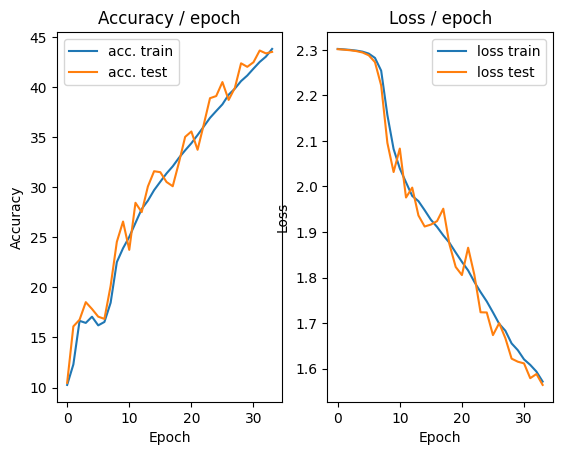

=== EPOCH 35 =====

[TRAIN Batch 000/098]	Time 0.292s (0.292s)	Loss 1.6181 (1.6181)	Prec@1  42.2 ( 42.2)	Prec@5  90.4 ( 90.4)


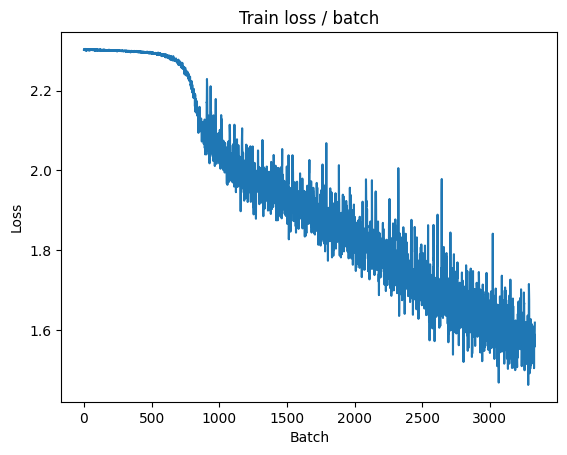


===============> Total time 8s	Avg loss 1.5600	Avg Prec@1 44.02 %	Avg Prec@5 90.51 %

[EVAL Batch 000/020]	Time 0.278s (0.278s)	Loss 1.6750 (1.6750)	Prec@1  36.7 ( 36.7)	Prec@5  87.1 ( 87.1)

===============> Total time 1s	Avg loss 1.6319	Avg Prec@1 41.63 %	Avg Prec@5 89.05 %



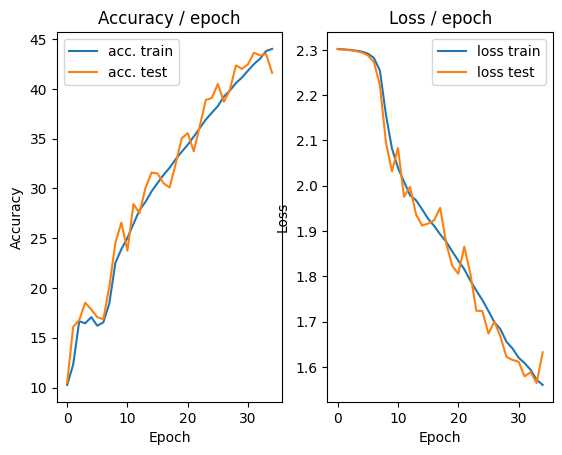

=== EPOCH 36 =====

[TRAIN Batch 000/098]	Time 0.307s (0.307s)	Loss 1.6665 (1.6665)	Prec@1  40.2 ( 40.2)	Prec@5  88.7 ( 88.7)


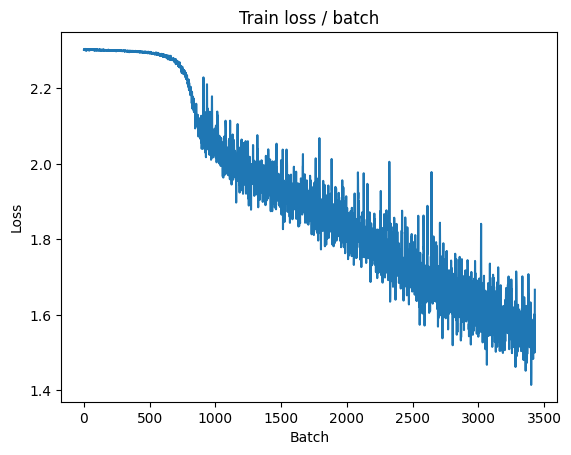


===============> Total time 8s	Avg loss 1.5519	Avg Prec@1 44.48 %	Avg Prec@5 90.55 %

[EVAL Batch 000/020]	Time 0.300s (0.300s)	Loss 1.5434 (1.5434)	Prec@1  42.4 ( 42.4)	Prec@5  92.0 ( 92.0)

===============> Total time 1s	Avg loss 1.5135	Avg Prec@1 45.98 %	Avg Prec@5 91.20 %



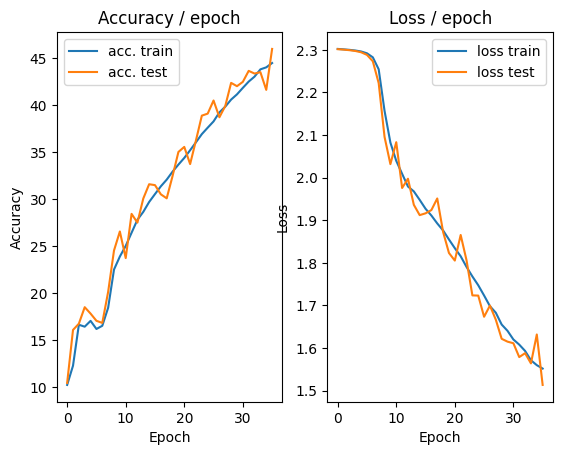

=== EPOCH 37 =====

[TRAIN Batch 000/098]	Time 0.351s (0.351s)	Loss 1.5463 (1.5463)	Prec@1  44.9 ( 44.9)	Prec@5  90.8 ( 90.8)


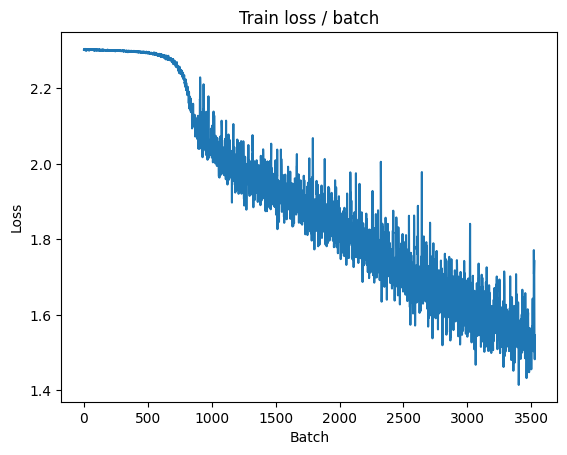


===============> Total time 8s	Avg loss 1.5324	Avg Prec@1 45.11 %	Avg Prec@5 90.85 %

[EVAL Batch 000/020]	Time 0.284s (0.284s)	Loss 1.5256 (1.5256)	Prec@1  44.1 ( 44.1)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.4950	Avg Prec@1 46.59 %	Avg Prec@5 91.52 %



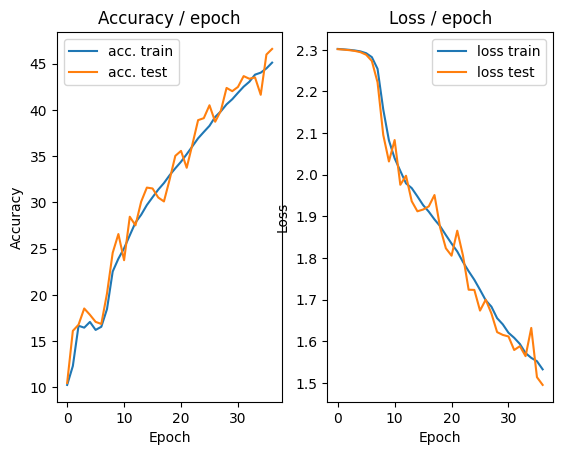

=== EPOCH 38 =====

[TRAIN Batch 000/098]	Time 0.337s (0.337s)	Loss 1.5322 (1.5322)	Prec@1  45.5 ( 45.5)	Prec@5  91.6 ( 91.6)


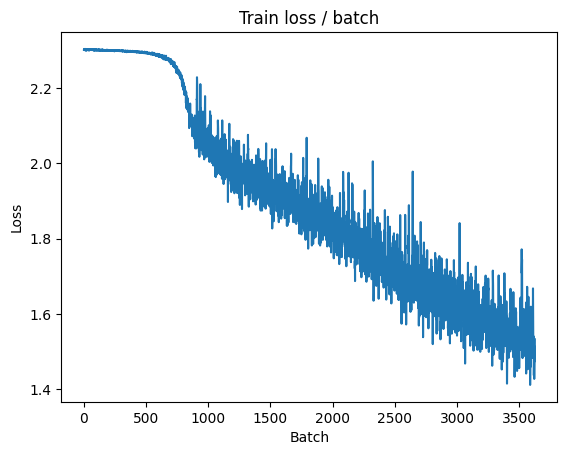


===============> Total time 8s	Avg loss 1.5194	Avg Prec@1 45.66 %	Avg Prec@5 91.04 %

[EVAL Batch 000/020]	Time 0.499s (0.499s)	Loss 1.5486 (1.5486)	Prec@1  44.7 ( 44.7)	Prec@5  91.0 ( 91.0)

===============> Total time 1s	Avg loss 1.5088	Avg Prec@1 46.37 %	Avg Prec@5 90.99 %



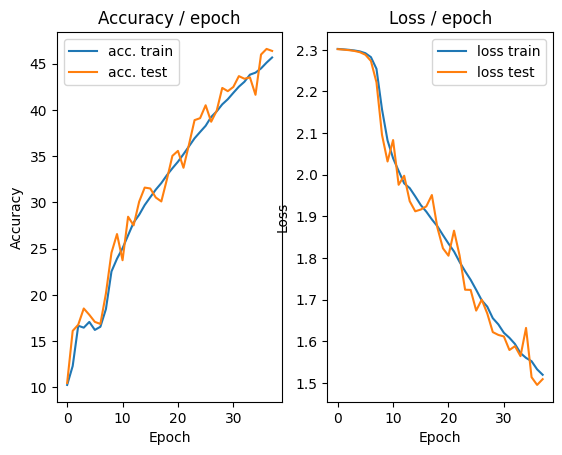

=== EPOCH 39 =====

[TRAIN Batch 000/098]	Time 0.338s (0.338s)	Loss 1.5231 (1.5231)	Prec@1  42.2 ( 42.2)	Prec@5  91.4 ( 91.4)


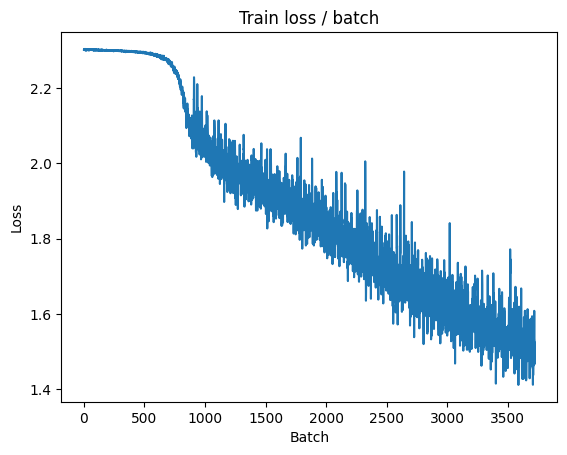


===============> Total time 7s	Avg loss 1.5094	Avg Prec@1 46.03 %	Avg Prec@5 91.20 %

[EVAL Batch 000/020]	Time 0.268s (0.268s)	Loss 1.5025 (1.5025)	Prec@1  44.1 ( 44.1)	Prec@5  92.6 ( 92.6)

===============> Total time 1s	Avg loss 1.4727	Avg Prec@1 46.87 %	Avg Prec@5 91.71 %



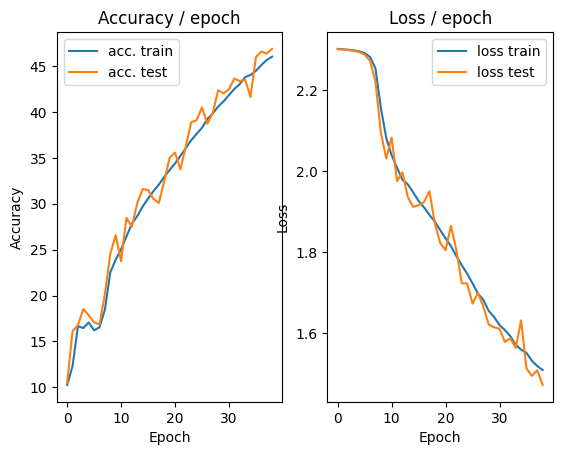

=== EPOCH 40 =====

[TRAIN Batch 000/098]	Time 0.477s (0.477s)	Loss 1.4616 (1.4616)	Prec@1  45.3 ( 45.3)	Prec@5  92.4 ( 92.4)


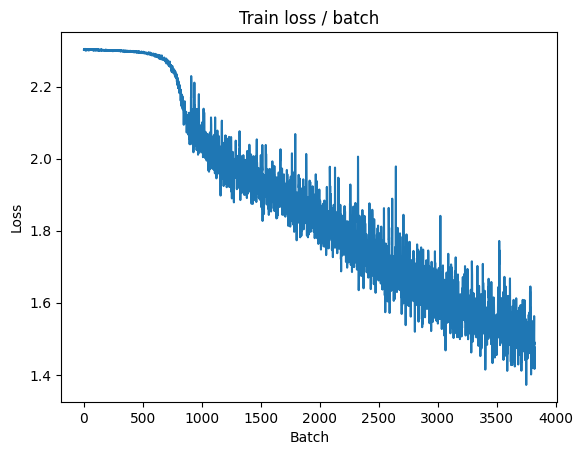


===============> Total time 8s	Avg loss 1.5000	Avg Prec@1 46.47 %	Avg Prec@5 91.29 %

[EVAL Batch 000/020]	Time 0.292s (0.292s)	Loss 1.5436 (1.5436)	Prec@1  42.6 ( 42.6)	Prec@5  90.8 ( 90.8)

===============> Total time 1s	Avg loss 1.5254	Avg Prec@1 45.23 %	Avg Prec@5 90.37 %



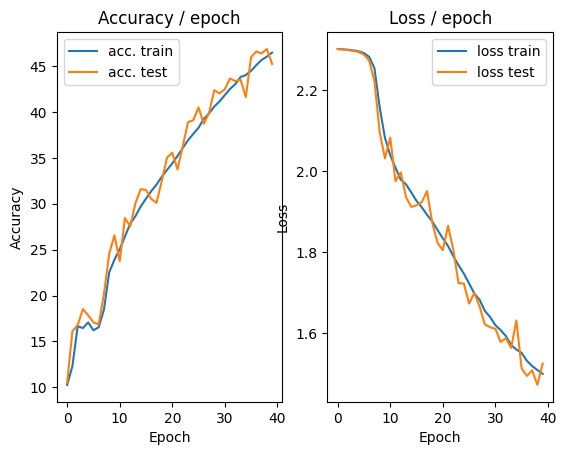

=== EPOCH 41 =====

[TRAIN Batch 000/098]	Time 0.296s (0.296s)	Loss 1.5041 (1.5041)	Prec@1  47.1 ( 47.1)	Prec@5  90.6 ( 90.6)


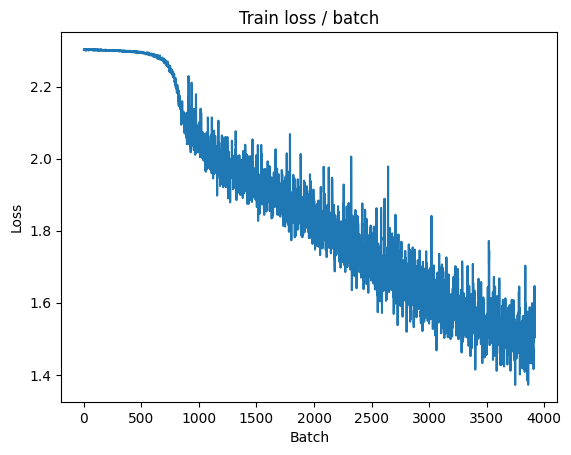


===============> Total time 8s	Avg loss 1.4853	Avg Prec@1 46.78 %	Avg Prec@5 91.57 %

[EVAL Batch 000/020]	Time 0.290s (0.290s)	Loss 1.4858 (1.4858)	Prec@1  46.3 ( 46.3)	Prec@5  92.6 ( 92.6)

===============> Total time 1s	Avg loss 1.4579	Avg Prec@1 47.62 %	Avg Prec@5 91.93 %



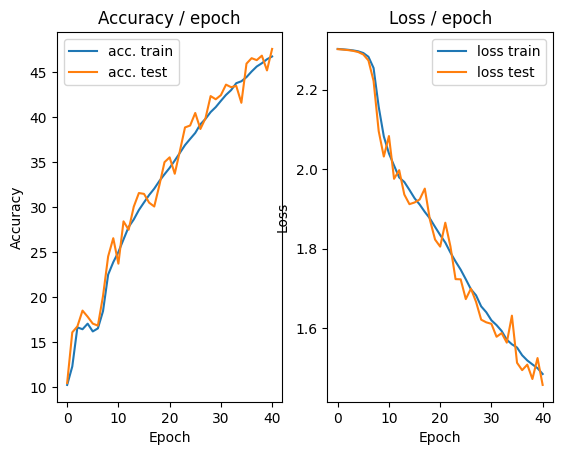

=== EPOCH 42 =====

[TRAIN Batch 000/098]	Time 0.347s (0.347s)	Loss 1.4425 (1.4425)	Prec@1  48.6 ( 48.6)	Prec@5  91.2 ( 91.2)


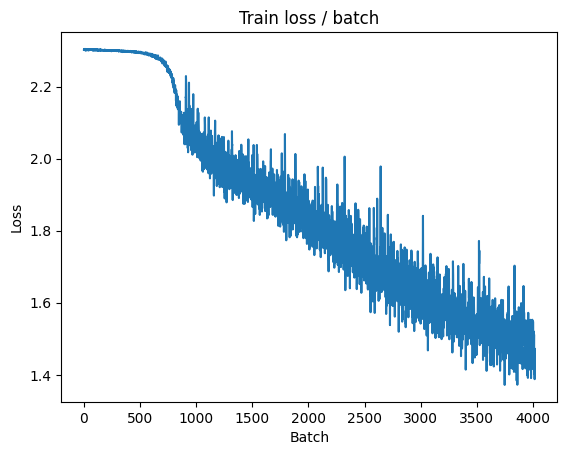


===============> Total time 8s	Avg loss 1.4785	Avg Prec@1 47.22 %	Avg Prec@5 91.66 %

[EVAL Batch 000/020]	Time 0.299s (0.299s)	Loss 1.5211 (1.5211)	Prec@1  42.4 ( 42.4)	Prec@5  92.0 ( 92.0)

===============> Total time 1s	Avg loss 1.4874	Avg Prec@1 46.36 %	Avg Prec@5 91.62 %



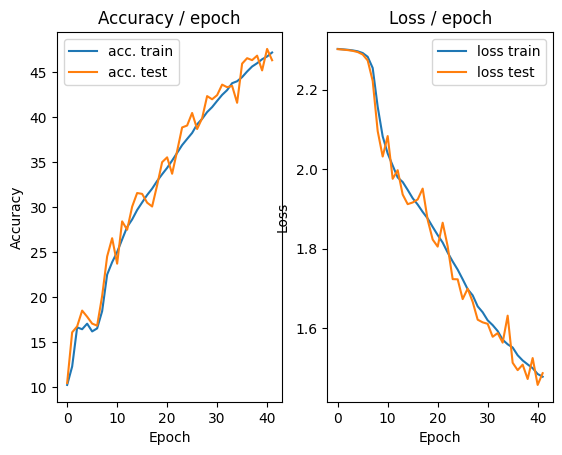

=== EPOCH 43 =====

[TRAIN Batch 000/098]	Time 0.337s (0.337s)	Loss 1.5566 (1.5566)	Prec@1  45.5 ( 45.5)	Prec@5  91.8 ( 91.8)


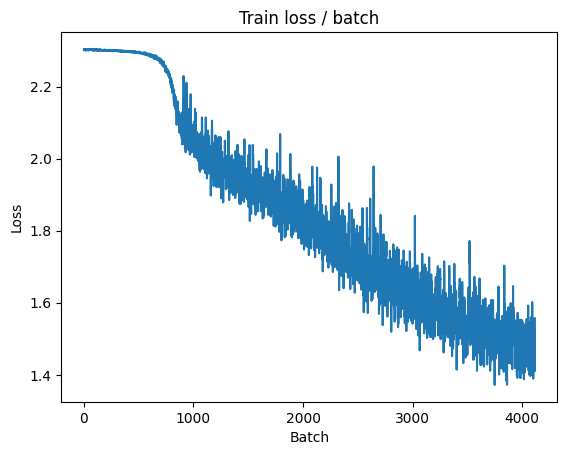


===============> Total time 8s	Avg loss 1.4612	Avg Prec@1 47.82 %	Avg Prec@5 91.99 %

[EVAL Batch 000/020]	Time 0.287s (0.287s)	Loss 1.5059 (1.5059)	Prec@1  43.4 ( 43.4)	Prec@5  91.8 ( 91.8)

===============> Total time 1s	Avg loss 1.4832	Avg Prec@1 46.86 %	Avg Prec@5 91.37 %



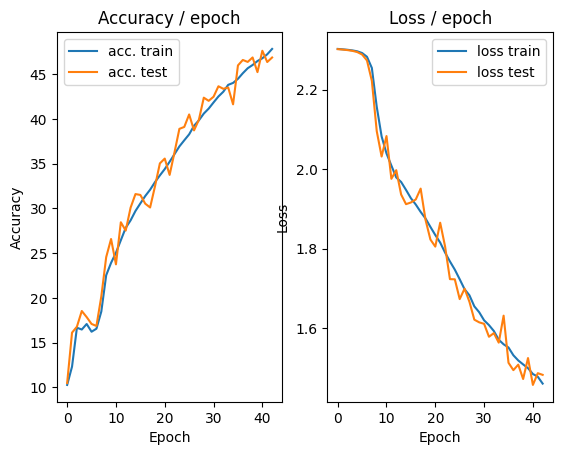

=== EPOCH 44 =====

[TRAIN Batch 000/098]	Time 0.342s (0.342s)	Loss 1.4255 (1.4255)	Prec@1  46.9 ( 46.9)	Prec@5  93.4 ( 93.4)


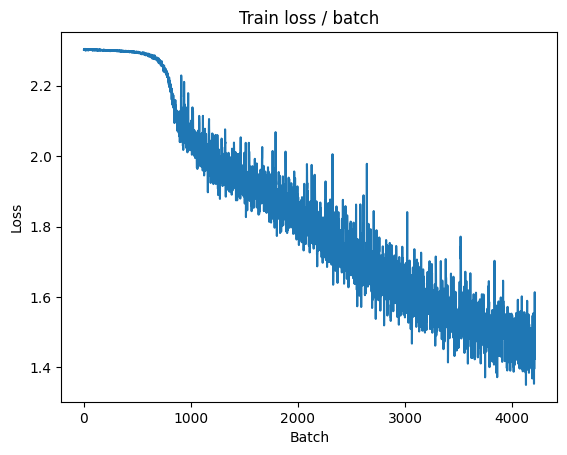


===============> Total time 8s	Avg loss 1.4603	Avg Prec@1 47.73 %	Avg Prec@5 91.88 %

[EVAL Batch 000/020]	Time 0.357s (0.357s)	Loss 1.4757 (1.4757)	Prec@1  45.7 ( 45.7)	Prec@5  92.4 ( 92.4)

===============> Total time 2s	Avg loss 1.4431	Avg Prec@1 48.19 %	Avg Prec@5 92.25 %



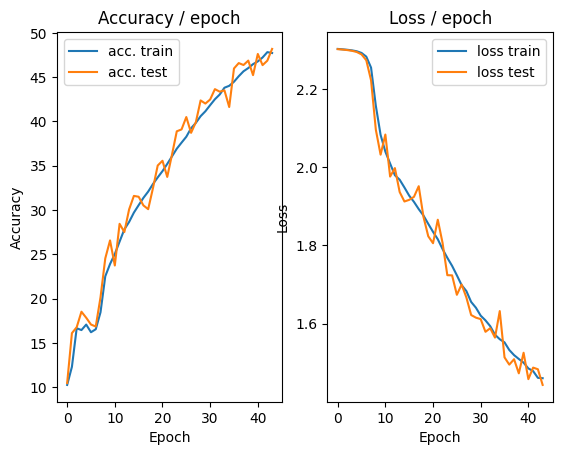

=== EPOCH 45 =====

[TRAIN Batch 000/098]	Time 0.335s (0.335s)	Loss 1.4132 (1.4132)	Prec@1  46.7 ( 46.7)	Prec@5  95.5 ( 95.5)


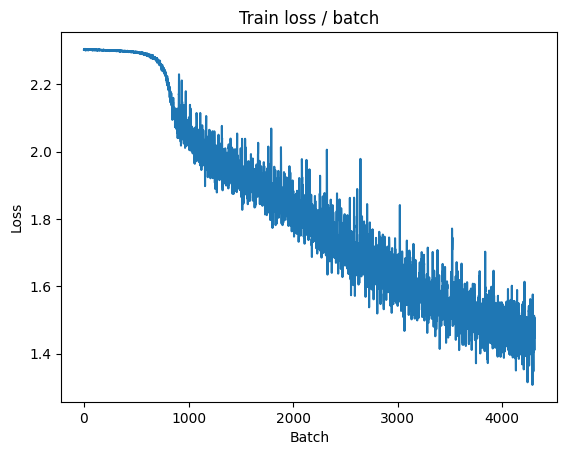


===============> Total time 7s	Avg loss 1.4378	Avg Prec@1 48.85 %	Avg Prec@5 92.24 %

[EVAL Batch 000/020]	Time 0.295s (0.295s)	Loss 1.4544 (1.4544)	Prec@1  45.9 ( 45.9)	Prec@5  91.6 ( 91.6)

===============> Total time 1s	Avg loss 1.4434	Avg Prec@1 48.43 %	Avg Prec@5 92.01 %



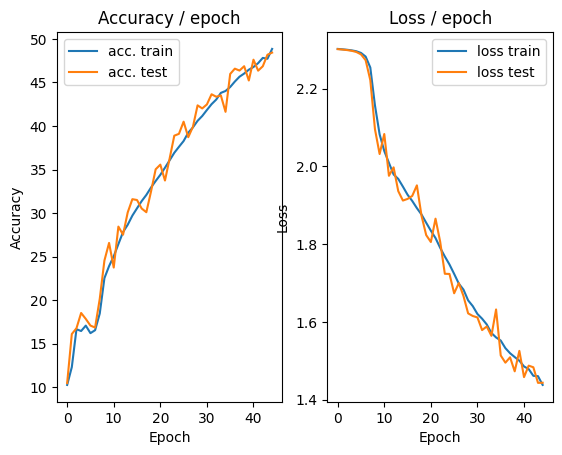

=== EPOCH 46 =====

[TRAIN Batch 000/098]	Time 0.437s (0.437s)	Loss 1.4007 (1.4007)	Prec@1  49.8 ( 49.8)	Prec@5  92.2 ( 92.2)


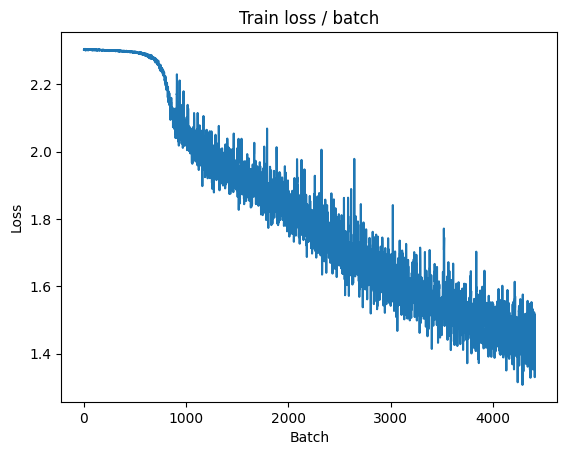


===============> Total time 8s	Avg loss 1.4412	Avg Prec@1 48.58 %	Avg Prec@5 92.17 %

[EVAL Batch 000/020]	Time 0.277s (0.277s)	Loss 1.4566 (1.4566)	Prec@1  46.9 ( 46.9)	Prec@5  92.4 ( 92.4)

===============> Total time 1s	Avg loss 1.4297	Avg Prec@1 49.09 %	Avg Prec@5 92.34 %



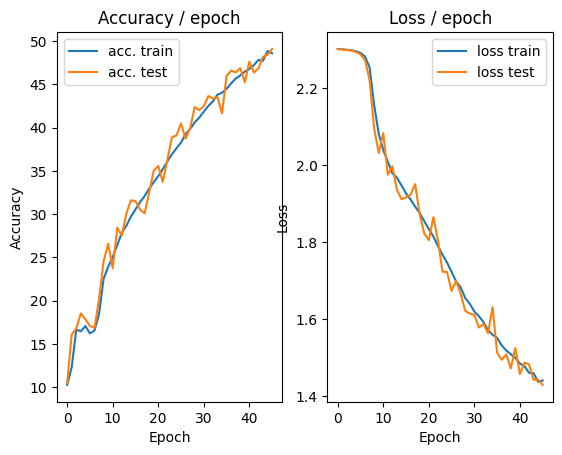

=== EPOCH 47 =====

[TRAIN Batch 000/098]	Time 0.358s (0.358s)	Loss 1.3639 (1.3639)	Prec@1  53.3 ( 53.3)	Prec@5  93.8 ( 93.8)


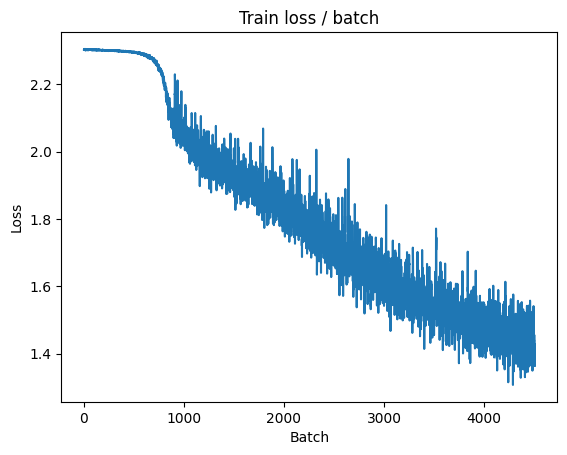


===============> Total time 8s	Avg loss 1.4328	Avg Prec@1 48.97 %	Avg Prec@5 92.19 %

[EVAL Batch 000/020]	Time 0.293s (0.293s)	Loss 1.4194 (1.4194)	Prec@1  47.3 ( 47.3)	Prec@5  92.8 ( 92.8)

===============> Total time 1s	Avg loss 1.4101	Avg Prec@1 49.17 %	Avg Prec@5 92.60 %



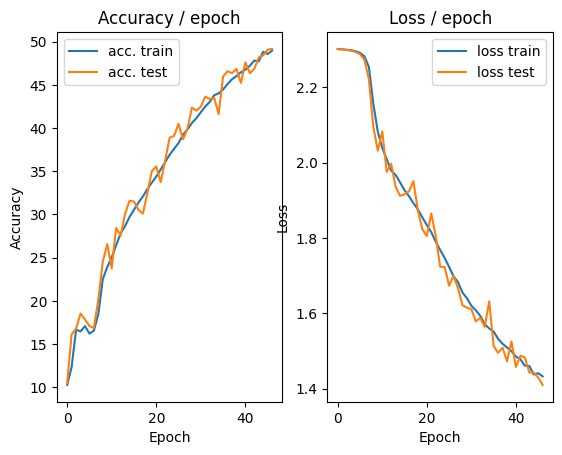

=== EPOCH 48 =====

[TRAIN Batch 000/098]	Time 0.355s (0.355s)	Loss 1.4101 (1.4101)	Prec@1  49.2 ( 49.2)	Prec@5  91.8 ( 91.8)


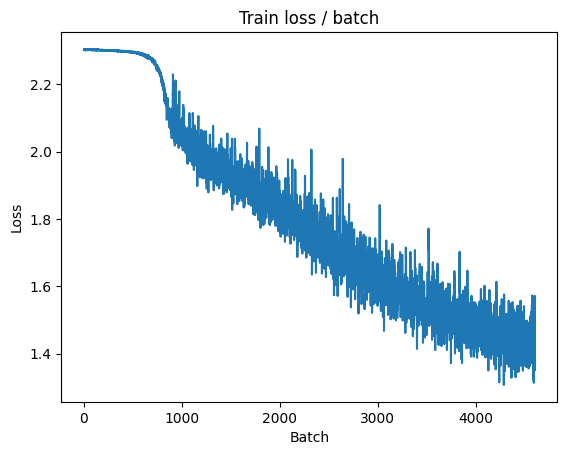


===============> Total time 9s	Avg loss 1.4150	Avg Prec@1 49.53 %	Avg Prec@5 92.53 %

[EVAL Batch 000/020]	Time 0.266s (0.266s)	Loss 1.4517 (1.4517)	Prec@1  47.9 ( 47.9)	Prec@5  93.2 ( 93.2)

===============> Total time 1s	Avg loss 1.4169	Avg Prec@1 49.02 %	Avg Prec@5 92.35 %



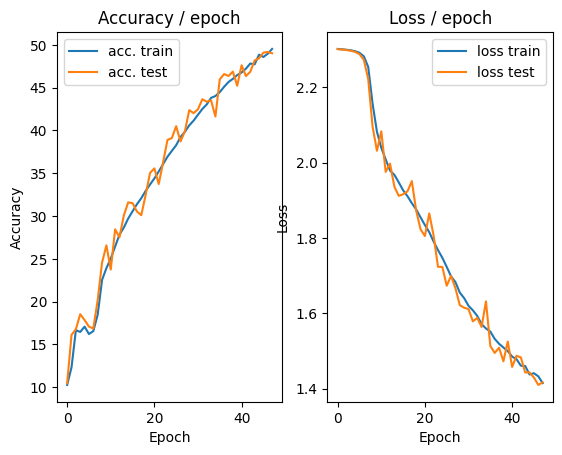

=== EPOCH 49 =====

[TRAIN Batch 000/098]	Time 0.365s (0.365s)	Loss 1.4618 (1.4618)	Prec@1  48.6 ( 48.6)	Prec@5  90.4 ( 90.4)


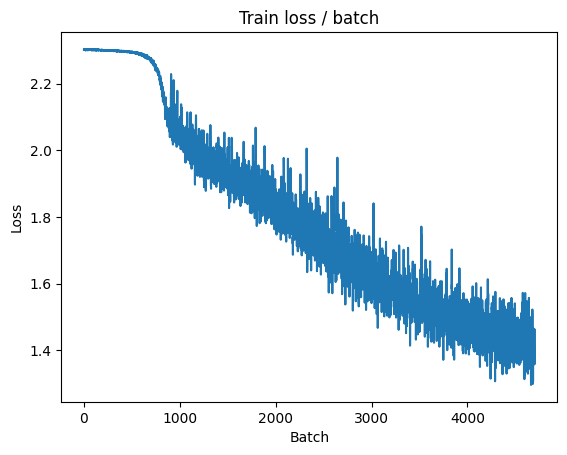


===============> Total time 8s	Avg loss 1.4161	Avg Prec@1 49.52 %	Avg Prec@5 92.53 %

[EVAL Batch 000/020]	Time 0.287s (0.287s)	Loss 1.4206 (1.4206)	Prec@1  48.4 ( 48.4)	Prec@5  92.8 ( 92.8)

===============> Total time 1s	Avg loss 1.3903	Avg Prec@1 50.13 %	Avg Prec@5 92.73 %



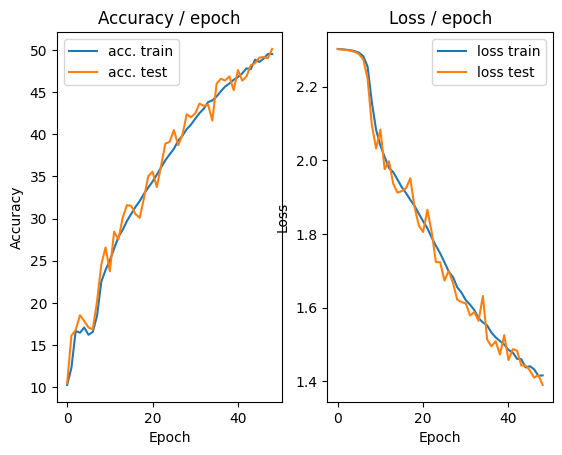

=== EPOCH 50 =====

[TRAIN Batch 000/098]	Time 0.322s (0.322s)	Loss 1.4342 (1.4342)	Prec@1  47.1 ( 47.1)	Prec@5  91.2 ( 91.2)


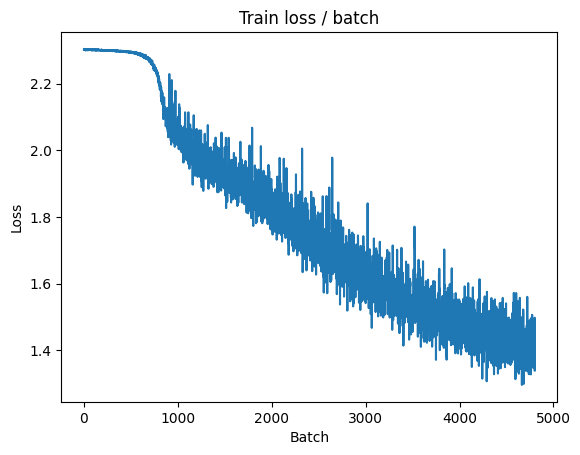


===============> Total time 7s	Avg loss 1.3984	Avg Prec@1 50.06 %	Avg Prec@5 92.83 %

[EVAL Batch 000/020]	Time 0.462s (0.462s)	Loss 1.4133 (1.4133)	Prec@1  50.0 ( 50.0)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.3853	Avg Prec@1 50.71 %	Avg Prec@5 92.87 %



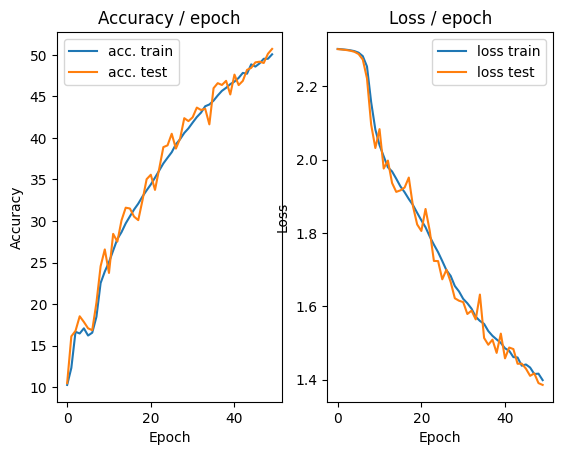

In [ ]:
main(512, 0.01, 50, cuda=True)#50 epoch, lr 0.01, batch size 512